In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense


import matplotlib.pyplot as plt

from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

from sklearn.model_selection import train_test_split
import datetime, os

In [2]:
import os

current_working_directory = os.getcwd()
if(current_working_directory=='/content'):
    from google.colab import drive
    drive.mount('/content/drive')
    path='/content/drive/My Drive/SRM/Colab Notebooks/Kaggle/'
else:
    path='G:/My Drive/SRM/Colab Notebooks/Kaggle/'
print(path)

G:/My Drive/SRM/Colab Notebooks/Kaggle/


In [3]:
train = pd.read_csv(path+'playground-series-s3e20/train.csv', index_col=['ID_LAT_LON_YEAR_WEEK'])
train

,latitude,longitude,year,week_no,SulphurDioxide_SO2_column_number_density,SulphurDioxide_SO2_column_number_density_amf,SulphurDioxide_SO2_slant_column_number_density,SulphurDioxide_cloud_fraction,SulphurDioxide_sensor_azimuth_angle,SulphurDioxide_sensor_zenith_angle,...,Cloud_cloud_top_height,Cloud_cloud_base_pressure,Cloud_cloud_base_height,Cloud_cloud_optical_depth,Cloud_surface_albedo,Cloud_sensor_azimuth_angle,Cloud_sensor_zenith_angle,Cloud_solar_azimuth_angle,Cloud_solar_zenith_angle,emission
ID_LAT_LON_YEAR_WEEK,,,,,,,,,,,,,,,,,,,,,
ID_-0.510_29.290_2019_00,-0.510,29.290,2019,0,-0.000108,0.603019,-0.000065,0.255668,-98.593887,50.843559,...,3664.436218,61085.809570,2615.120483,15.568533,0.272292,-12.628986,35.632416,-138.786423,30.752140,3.750994
ID_-0.510_29.290_2019_01,-0.510,29.290,2019,1,0.000021,0.728214,0.000014,0.130988,16.592861,39.137194,...,3651.190311,66969.478735,3174.572424,8.690601,0.256830,30.359375,39.557633,-145.183930,27.251779,4.025176
ID_-0.510_29.290_2019_02,-0.510,29.290,2019,2,0.000514,0.748199,0.000385,0.110018,72.795837,52.868816,...,4216.986492,60068.894448,3516.282669,21.103410,0.251101,15.377883,30.401823,-142.519545,26.193296,4.231381
ID_-0.510_29.290_2019_03,-0.510,29.290,2019,3,NaN,NaN,NaN,NaN,NaN,NaN,...,5228.507736,51064.547339,4180.973322,15.386899,0.262043,-11.293399,24.380357,-132.665828,28.829155,4.305286
ID_-0.510_29.290_2019_04,-0.510,29.290,2019,4,-0.000079,0.676296,-0.000048,0.121164,4.121269,35.515587,...,3980.598120,63751.125781,3355.710107,8.114694,0.235847,38.532263,37.392979,-141.509805,22.204612,4.347317
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ID_-3.299_30.301_2021_48,-3.299,30.301,2021,48,0.000284,1.195643,0.000340,0.191313,72.820518,55.988022,...,5459.185355,60657.101913,4590.879504,20.245954,0.304797,-35.140368,40.113533,-129.935508,32.095214,29.404171
ID_-3.299_30.301_2021_49,-3.299,30.301,2021,49,0.000083,1.130868,0.000063,0.177222,-12.856753,19.435339,...,5606.449457,60168.191528,4659.130378,6.104610,0.314015,4.667058,47.528435,-134.252871,30.771469,29.186497
ID_-3.299_30.301_2021_50,-3.299,30.301,2021,50,NaN,NaN,NaN,NaN,NaN,NaN,...,6222.646776,56596.027209,5222.646823,14.817885,0.288058,-0.340922,35.328098,-134.731723,30.716166,29.131205


In [4]:
train[train['emission']>500]['year'].value_counts()

2019    203
2021    174
2020    137
Name: year, dtype: int64

In [5]:
col = list(train.columns)

In [6]:
new_cols = [
'latitude',
'longitude',
'year',
'week_no',
'SO2_col_no_density',
'SO2_col_no_density_amf',
'SO2_slant_col_no_density',
'SO2_cloud_fraction',
'SO2_sen_azi_ang',
'SO2_sen_zen_ang',
'SO2_sol_azi_ang',
'SO2_sol_zen_ang',
'SO2_col_no_density_15km',
'CO_col_no_density',
'CO_H2O_col_no_density',
'CO_cloud_alt',
'CO_sen_alt',
'CO_sen_azi_ang',
'CO_sen_zen_ang',
'CO_sol_azi_ang',
'CO_sol_zen_ang',
'NO2_col_no_density',
'NO2_TropoS_NO2_col_no_density',
'NO2_StratoS_NO2_col_no_density',
'NO2_slant_col_no_density',
'NO2_tropopause_pressure',
'NO2_absorbing_aerosol_index',
'NO2_cloud_fraction',
'NO2_sen_alt',
'NO2_sen_azi_ang',
'NO2_sen_zen_ang',
'NO2_sol_azi_ang',
'NO2_sol_zen_ang',
'HCHO_TropoS_HCHO_col_no_density',
'HCHO_TropoS_HCHO_col_no_density_amf',
'HCHO_slant_col_no_density',
'HCHO_cloud_fraction',
'HCHO_sol_zen_ang',
'HCHO_sol_azi_ang',
'HCHO_sen_zen_ang',
'HCHO_sen_azi_ang',
'UVAI_absorbing_aerosol_index',
'UVAI_sen_alt',
'UVAI_sen_azi_ang',
'UVAI_sen_zen_ang',
'UVAI_sol_azi_ang',
'UVAI_sol_zen_ang',
'O3_O3_col_no_density',
'O3_O3_col_no_density_amf',
'O3_O3_slant_col_no_density',
'O3_O3_effective_temp',
'O3_cloud_fraction',
'O3_sen_azi_ang',
'O3_sen_zen_ang',
'O3_sol_azi_ang',
'O3_sol_zen_ang',
'UVALH_aerosol_height',
'UVALH_aerosol_pressure',
'UVALH_aerosol_optical_depth',
'UVALH_sen_zen_ang',
'UVALH_sen_azi_ang',
'UVALH_sol_azi_ang',
'UVALH_sol_zen_ang',
'Cloud_fraction',
'Cloud_top_pressure',
'Cloud_top_height',
'Cloud_base_pressure',
'Cloud_base_height',
'Cloud_optical_depth',
'Cloud_surface_albedo',
'Cloud_sen_azi_ang',
'Cloud_sen_zen_ang',
'Cloud_sol_azi_ang',
'Cloud_sol_zen_ang',
'emission'
]

In [7]:
col_desc = dict(zip(new_cols,col))

In [8]:
train.columns = new_cols
train

,latitude,longitude,year,week_no,SO2_col_no_density,SO2_col_no_density_amf,SO2_slant_col_no_density,SO2_cloud_fraction,SO2_sen_azi_ang,SO2_sen_zen_ang,...,Cloud_top_height,Cloud_base_pressure,Cloud_base_height,Cloud_optical_depth,Cloud_surface_albedo,Cloud_sen_azi_ang,Cloud_sen_zen_ang,Cloud_sol_azi_ang,Cloud_sol_zen_ang,emission
ID_LAT_LON_YEAR_WEEK,,,,,,,,,,,,,,,,,,,,,
ID_-0.510_29.290_2019_00,-0.510,29.290,2019,0,-0.000108,0.603019,-0.000065,0.255668,-98.593887,50.843559,...,3664.436218,61085.809570,2615.120483,15.568533,0.272292,-12.628986,35.632416,-138.786423,30.752140,3.750994
ID_-0.510_29.290_2019_01,-0.510,29.290,2019,1,0.000021,0.728214,0.000014,0.130988,16.592861,39.137194,...,3651.190311,66969.478735,3174.572424,8.690601,0.256830,30.359375,39.557633,-145.183930,27.251779,4.025176
ID_-0.510_29.290_2019_02,-0.510,29.290,2019,2,0.000514,0.748199,0.000385,0.110018,72.795837,52.868816,...,4216.986492,60068.894448,3516.282669,21.103410,0.251101,15.377883,30.401823,-142.519545,26.193296,4.231381
ID_-0.510_29.290_2019_03,-0.510,29.290,2019,3,NaN,NaN,NaN,NaN,NaN,NaN,...,5228.507736,51064.547339,4180.973322,15.386899,0.262043,-11.293399,24.380357,-132.665828,28.829155,4.305286
ID_-0.510_29.290_2019_04,-0.510,29.290,2019,4,-0.000079,0.676296,-0.000048,0.121164,4.121269,35.515587,...,3980.598120,63751.125781,3355.710107,8.114694,0.235847,38.532263,37.392979,-141.509805,22.204612,4.347317
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ID_-3.299_30.301_2021_48,-3.299,30.301,2021,48,0.000284,1.195643,0.000340,0.191313,72.820518,55.988022,...,5459.185355,60657.101913,4590.879504,20.245954,0.304797,-35.140368,40.113533,-129.935508,32.095214,29.404171
ID_-3.299_30.301_2021_49,-3.299,30.301,2021,49,0.000083,1.130868,0.000063,0.177222,-12.856753,19.435339,...,5606.449457,60168.191528,4659.130378,6.104610,0.314015,4.667058,47.528435,-134.252871,30.771469,29.186497
ID_-3.299_30.301_2021_50,-3.299,30.301,2021,50,NaN,NaN,NaN,NaN,NaN,NaN,...,6222.646776,56596.027209,5222.646823,14.817885,0.288058,-0.340922,35.328098,-134.731723,30.716166,29.131205


In [9]:
train_null_count = train.isnull().sum()

train_null_count[train_null_count > len(train)*0.3].index

Index(['UVALH_aerosol_height', 'UVALH_aerosol_pressure',
       'UVALH_aerosol_optical_depth', 'UVALH_sen_zen_ang', 'UVALH_sen_azi_ang',
       'UVALH_sol_azi_ang', 'UVALH_sol_zen_ang'],
      dtype='object')

In [10]:
for i in (['UVALH_aerosol_height', 'UVALH_aerosol_pressure',
       'UVALH_aerosol_optical_depth', 'UVALH_sen_zen_ang', 'UVALH_sen_azi_ang',
       'UVALH_sol_azi_ang', 'UVALH_sol_zen_ang']):
    print('Column: ',i,'\tTotal: ', len(train[i]), '\tNull Counts: ',train[i].isnull().sum())

Column:  UVALH_aerosol_height 	Total:  79023 	Null Counts:  78584
Column:  UVALH_aerosol_pressure 	Total:  79023 	Null Counts:  78584
Column:  UVALH_aerosol_optical_depth 	Total:  79023 	Null Counts:  78584
Column:  UVALH_sen_zen_ang 	Total:  79023 	Null Counts:  78584
Column:  UVALH_sen_azi_ang 	Total:  79023 	Null Counts:  78584
Column:  UVALH_sol_azi_ang 	Total:  79023 	Null Counts:  78584
Column:  UVALH_sol_zen_ang 	Total:  79023 	Null Counts:  78584


In [11]:
test = pd.read_csv(path+'/playground-series-s3e20/test.csv', index_col=['ID_LAT_LON_YEAR_WEEK'])
test

,latitude,longitude,year,week_no,SulphurDioxide_SO2_column_number_density,SulphurDioxide_SO2_column_number_density_amf,SulphurDioxide_SO2_slant_column_number_density,SulphurDioxide_cloud_fraction,SulphurDioxide_sensor_azimuth_angle,SulphurDioxide_sensor_zenith_angle,...,Cloud_cloud_top_pressure,Cloud_cloud_top_height,Cloud_cloud_base_pressure,Cloud_cloud_base_height,Cloud_cloud_optical_depth,Cloud_surface_albedo,Cloud_sensor_azimuth_angle,Cloud_sensor_zenith_angle,Cloud_solar_azimuth_angle,Cloud_solar_zenith_angle
ID_LAT_LON_YEAR_WEEK,,,,,,,,,,,,,,,,,,,,,
ID_-0.510_29.290_2022_00,-0.510,29.290,2022,0,NaN,NaN,NaN,NaN,NaN,NaN,...,36022.027344,8472.313477,41047.937500,7472.313477,7.935617,0.240773,-100.113792,33.697044,-133.047546,33.779583
ID_-0.510_29.290_2022_01,-0.510,29.290,2022,1,0.000456,0.691164,0.000316,0.000000,76.239196,15.600607,...,48539.737242,6476.147323,54915.708579,5476.147161,11.448437,0.293119,-30.510319,42.402593,-138.632822,31.012380
ID_-0.510_29.290_2022_02,-0.510,29.290,2022,2,0.000161,0.605107,0.000106,0.079870,-42.055341,39.889060,...,34133.080469,8984.795703,39006.093750,7984.795703,10.753179,0.267130,39.087361,45.936480,-144.784988,26.743361
ID_-0.510_29.290_2022_03,-0.510,29.290,2022,3,0.000350,0.696917,0.000243,0.201028,72.169566,58.862543,...,50854.991076,6014.724059,57646.368368,5014.724115,11.764556,0.304679,-24.465127,42.140419,-135.027891,29.604774
ID_-0.510_29.290_2022_04,-0.510,29.290,2022,4,-0.000317,0.580527,-0.000184,0.204352,76.190865,15.646016,...,46594.685145,6849.280477,52896.541873,5849.280394,13.065317,0.284221,-12.907850,30.122641,-135.500119,26.276807
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ID_-3.299_30.301_2022_44,-3.299,30.301,2022,44,-0.000618,0.745549,-0.000461,0.234492,72.306198,61.114494,...,48839.430415,6260.120033,55483.459980,5260.120056,30.398508,0.180046,-25.528588,45.284576,-116.521412,29.992562
ID_-3.299_30.301_2022_45,-3.299,30.301,2022,45,NaN,NaN,NaN,NaN,NaN,NaN,...,47042.694849,6678.843299,53589.917383,5678.951521,19.223844,0.177833,-13.380005,43.770351,-122.405759,29.017975
ID_-3.299_30.301_2022_46,-3.299,30.301,2022,46,NaN,NaN,NaN,NaN,NaN,NaN,...,55337.148173,5336.282475,62646.761340,4336.282491,13.801194,0.219471,-5.072065,33.226455,-124.530639,30.187472


In [12]:
test.columns = new_cols[:-1]
test

,latitude,longitude,year,week_no,SO2_col_no_density,SO2_col_no_density_amf,SO2_slant_col_no_density,SO2_cloud_fraction,SO2_sen_azi_ang,SO2_sen_zen_ang,...,Cloud_top_pressure,Cloud_top_height,Cloud_base_pressure,Cloud_base_height,Cloud_optical_depth,Cloud_surface_albedo,Cloud_sen_azi_ang,Cloud_sen_zen_ang,Cloud_sol_azi_ang,Cloud_sol_zen_ang
ID_LAT_LON_YEAR_WEEK,,,,,,,,,,,,,,,,,,,,,
ID_-0.510_29.290_2022_00,-0.510,29.290,2022,0,NaN,NaN,NaN,NaN,NaN,NaN,...,36022.027344,8472.313477,41047.937500,7472.313477,7.935617,0.240773,-100.113792,33.697044,-133.047546,33.779583
ID_-0.510_29.290_2022_01,-0.510,29.290,2022,1,0.000456,0.691164,0.000316,0.000000,76.239196,15.600607,...,48539.737242,6476.147323,54915.708579,5476.147161,11.448437,0.293119,-30.510319,42.402593,-138.632822,31.012380
ID_-0.510_29.290_2022_02,-0.510,29.290,2022,2,0.000161,0.605107,0.000106,0.079870,-42.055341,39.889060,...,34133.080469,8984.795703,39006.093750,7984.795703,10.753179,0.267130,39.087361,45.936480,-144.784988,26.743361
ID_-0.510_29.290_2022_03,-0.510,29.290,2022,3,0.000350,0.696917,0.000243,0.201028,72.169566,58.862543,...,50854.991076,6014.724059,57646.368368,5014.724115,11.764556,0.304679,-24.465127,42.140419,-135.027891,29.604774
ID_-0.510_29.290_2022_04,-0.510,29.290,2022,4,-0.000317,0.580527,-0.000184,0.204352,76.190865,15.646016,...,46594.685145,6849.280477,52896.541873,5849.280394,13.065317,0.284221,-12.907850,30.122641,-135.500119,26.276807
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ID_-3.299_30.301_2022_44,-3.299,30.301,2022,44,-0.000618,0.745549,-0.000461,0.234492,72.306198,61.114494,...,48839.430415,6260.120033,55483.459980,5260.120056,30.398508,0.180046,-25.528588,45.284576,-116.521412,29.992562
ID_-3.299_30.301_2022_45,-3.299,30.301,2022,45,NaN,NaN,NaN,NaN,NaN,NaN,...,47042.694849,6678.843299,53589.917383,5678.951521,19.223844,0.177833,-13.380005,43.770351,-122.405759,29.017975
ID_-3.299_30.301_2022_46,-3.299,30.301,2022,46,NaN,NaN,NaN,NaN,NaN,NaN,...,55337.148173,5336.282475,62646.761340,4336.282491,13.801194,0.219471,-5.072065,33.226455,-124.530639,30.187472


In [13]:
#Dropping insiginificant columns:
train.drop(labels=['UVALH_aerosol_height', 'UVALH_aerosol_pressure',
       'UVALH_aerosol_optical_depth', 'UVALH_sen_zen_ang', 'UVALH_sen_azi_ang',
       'UVALH_sol_azi_ang', 'UVALH_sol_zen_ang'], axis=1,inplace=True)

In [14]:
#Dropping insiginificant columns:
test.drop(labels=['UVALH_aerosol_height', 'UVALH_aerosol_pressure',
       'UVALH_aerosol_optical_depth', 'UVALH_sen_zen_ang', 'UVALH_sen_azi_ang',
       'UVALH_sol_azi_ang', 'UVALH_sol_zen_ang'], axis=1,inplace=True)

test.info()

<class 'pandas.core.frame.DataFrame'>
Index: 24353 entries, ID_-0.510_29.290_2022_00 to ID_-3.299_30.301_2022_48
Data columns (total 67 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   latitude                             24353 non-null  float64
 1   longitude                            24353 non-null  float64
 2   year                                 24353 non-null  int64  
 3   week_no                              24353 non-null  int64  
 4   SO2_col_no_density                   18211 non-null  float64
 5   SO2_col_no_density_amf               18211 non-null  float64
 6   SO2_slant_col_no_density             18211 non-null  float64
 7   SO2_cloud_fraction                   18211 non-null  float64
 8   SO2_sen_azi_ang                      18211 non-null  float64
 9   SO2_sen_zen_ang                      18211 non-null  float64
 10  SO2_sol_azi_ang                      18211 non-null  floa

In [15]:
for i in train.columns:
    train[i].fillna(train[i].mean(), inplace=True)

In [16]:
for i in test.columns:
    test[i].fillna(test[i].mean(), inplace=True)

In [17]:
train.isnull().sum().sum(), test.isnull().sum().sum()

(0, 0)

In [18]:
lat_val_train = train['latitude'].values
lon_val_train = train['longitude'].values

lat_val_test = test['latitude'].values
lon_val_test = test['longitude'].values

lat_lon_train = []
lat_lon_test = []


In [19]:
(len(lat_val_train), len(lon_val_train), len(lat_val_test), len(lon_val_test))

(79023, 79023, 24353, 24353)

In [20]:
for m in range(0,len(lat_val_train)):
    lat_lon_train.append(str(lat_val_train[m])+'_'+str(lon_val_train[m]))
    
for n in range(0,len(lat_val_test)):
    lat_lon_test.append(str(lat_val_test[n])+'_'+str(lon_val_test[n]))

In [21]:
train['lat_lon_train'] = lat_lon_train
test['lat_lon_test'] = lat_lon_test

In [22]:
test

,latitude,longitude,year,week_no,SO2_col_no_density,SO2_col_no_density_amf,SO2_slant_col_no_density,SO2_cloud_fraction,SO2_sen_azi_ang,SO2_sen_zen_ang,...,Cloud_top_height,Cloud_base_pressure,Cloud_base_height,Cloud_optical_depth,Cloud_surface_albedo,Cloud_sen_azi_ang,Cloud_sen_zen_ang,Cloud_sol_azi_ang,Cloud_sol_zen_ang,lat_lon_test
ID_LAT_LON_YEAR_WEEK,,,,,,,,,,,,,,,,,,,,,
ID_-0.510_29.290_2022_00,-0.510,29.290,2022,0,0.000014,0.792570,0.000009,0.139218,9.298052,36.174307,...,8472.313477,41047.937500,7472.313477,7.935617,0.240773,-100.113792,33.697044,-133.047546,33.779583,-0.51_29.29
ID_-0.510_29.290_2022_01,-0.510,29.290,2022,1,0.000456,0.691164,0.000316,0.000000,76.239196,15.600607,...,6476.147323,54915.708579,5476.147161,11.448437,0.293119,-30.510319,42.402593,-138.632822,31.012380,-0.51_29.29
ID_-0.510_29.290_2022_02,-0.510,29.290,2022,2,0.000161,0.605107,0.000106,0.079870,-42.055341,39.889060,...,8984.795703,39006.093750,7984.795703,10.753179,0.267130,39.087361,45.936480,-144.784988,26.743361,-0.51_29.29
ID_-0.510_29.290_2022_03,-0.510,29.290,2022,3,0.000350,0.696917,0.000243,0.201028,72.169566,58.862543,...,6014.724059,57646.368368,5014.724115,11.764556,0.304679,-24.465127,42.140419,-135.027891,29.604774,-0.51_29.29
ID_-0.510_29.290_2022_04,-0.510,29.290,2022,4,-0.000317,0.580527,-0.000184,0.204352,76.190865,15.646016,...,6849.280477,52896.541873,5849.280394,13.065317,0.284221,-12.907850,30.122641,-135.500119,26.276807,-0.51_29.29
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ID_-3.299_30.301_2022_44,-3.299,30.301,2022,44,-0.000618,0.745549,-0.000461,0.234492,72.306198,61.114494,...,6260.120033,55483.459980,5260.120056,30.398508,0.180046,-25.528588,45.284576,-116.521412,29.992562,-3.299_30.301
ID_-3.299_30.301_2022_45,-3.299,30.301,2022,45,0.000014,0.792570,0.000009,0.139218,9.298052,36.174307,...,6678.843299,53589.917383,5678.951521,19.223844,0.177833,-13.380005,43.770351,-122.405759,29.017975,-3.299_30.301
ID_-3.299_30.301_2022_46,-3.299,30.301,2022,46,0.000014,0.792570,0.000009,0.139218,9.298052,36.174307,...,5336.282475,62646.761340,4336.282491,13.801194,0.219471,-5.072065,33.226455,-124.530639,30.187472,-3.299_30.301


In [23]:
len(set(lat_lon_train)), len(set(lat_lon_test)) 

lat_lon_train_set = set(lat_lon_train)
lat_lon_test_set = set(lat_lon_test)

In [24]:
train[train['lat_lon_train']=='-0.51_29.29'].head()

,latitude,longitude,year,week_no,SO2_col_no_density,SO2_col_no_density_amf,SO2_slant_col_no_density,SO2_cloud_fraction,SO2_sen_azi_ang,SO2_sen_zen_ang,...,Cloud_base_pressure,Cloud_base_height,Cloud_optical_depth,Cloud_surface_albedo,Cloud_sen_azi_ang,Cloud_sen_zen_ang,Cloud_sol_azi_ang,Cloud_sol_zen_ang,emission,lat_lon_train
ID_LAT_LON_YEAR_WEEK,,,,,,,,,,,,,,,,,,,,,
ID_-0.510_29.290_2019_00,-0.51,29.29,2019,0,-0.000108,0.603019,-0.000065,0.255668,-98.593887,50.843559,...,61085.809570,2615.120483,15.568533,0.272292,-12.628986,35.632416,-138.786423,30.752140,3.750994,-0.51_29.29
ID_-0.510_29.290_2019_01,-0.51,29.29,2019,1,0.000021,0.728214,0.000014,0.130988,16.592861,39.137194,...,66969.478735,3174.572424,8.690601,0.256830,30.359375,39.557633,-145.183930,27.251779,4.025176,-0.51_29.29
ID_-0.510_29.290_2019_02,-0.51,29.29,2019,2,0.000514,0.748199,0.000385,0.110018,72.795837,52.868816,...,60068.894448,3516.282669,21.103410,0.251101,15.377883,30.401823,-142.519545,26.193296,4.231381,-0.51_29.29
ID_-0.510_29.290_2019_03,-0.51,29.29,2019,3,0.000048,0.834848,0.000035,0.158418,-7.925870,37.436189,...,51064.547339,4180.973322,15.386899,0.262043,-11.293399,24.380357,-132.665828,28.829155,4.305286,-0.51_29.29
ID_-0.510_29.290_2019_04,-0.51,29.29,2019,4,-0.000079,0.676296,-0.000048,0.121164,4.121269,35.515587,...,63751.125781,3355.710107,8.114694,0.235847,38.532263,37.392979,-141.509805,22.204612,4.347317,-0.51_29.29


In [25]:
test[test['lat_lon_test']=='-0.51_29.29'].head()

,latitude,longitude,year,week_no,SO2_col_no_density,SO2_col_no_density_amf,SO2_slant_col_no_density,SO2_cloud_fraction,SO2_sen_azi_ang,SO2_sen_zen_ang,...,Cloud_top_height,Cloud_base_pressure,Cloud_base_height,Cloud_optical_depth,Cloud_surface_albedo,Cloud_sen_azi_ang,Cloud_sen_zen_ang,Cloud_sol_azi_ang,Cloud_sol_zen_ang,lat_lon_test
ID_LAT_LON_YEAR_WEEK,,,,,,,,,,,,,,,,,,,,,
ID_-0.510_29.290_2022_00,-0.51,29.29,2022,0,0.000014,0.792570,0.000009,0.139218,9.298052,36.174307,...,8472.313477,41047.937500,7472.313477,7.935617,0.240773,-100.113792,33.697044,-133.047546,33.779583,-0.51_29.29
ID_-0.510_29.290_2022_01,-0.51,29.29,2022,1,0.000456,0.691164,0.000316,0.000000,76.239196,15.600607,...,6476.147323,54915.708579,5476.147161,11.448437,0.293119,-30.510319,42.402593,-138.632822,31.012380,-0.51_29.29
ID_-0.510_29.290_2022_02,-0.51,29.29,2022,2,0.000161,0.605107,0.000106,0.079870,-42.055341,39.889060,...,8984.795703,39006.093750,7984.795703,10.753179,0.267130,39.087361,45.936480,-144.784988,26.743361,-0.51_29.29
ID_-0.510_29.290_2022_03,-0.51,29.29,2022,3,0.000350,0.696917,0.000243,0.201028,72.169566,58.862543,...,6014.724059,57646.368368,5014.724115,11.764556,0.304679,-24.465127,42.140419,-135.027891,29.604774,-0.51_29.29
ID_-0.510_29.290_2022_04,-0.51,29.29,2022,4,-0.000317,0.580527,-0.000184,0.204352,76.190865,15.646016,...,6849.280477,52896.541873,5849.280394,13.065317,0.284221,-12.907850,30.122641,-135.500119,26.276807,-0.51_29.29


In [26]:
i='-0.51_29.29'
test[test['lat_lon_test']==i].head()

,latitude,longitude,year,week_no,SO2_col_no_density,SO2_col_no_density_amf,SO2_slant_col_no_density,SO2_cloud_fraction,SO2_sen_azi_ang,SO2_sen_zen_ang,...,Cloud_top_height,Cloud_base_pressure,Cloud_base_height,Cloud_optical_depth,Cloud_surface_albedo,Cloud_sen_azi_ang,Cloud_sen_zen_ang,Cloud_sol_azi_ang,Cloud_sol_zen_ang,lat_lon_test
ID_LAT_LON_YEAR_WEEK,,,,,,,,,,,,,,,,,,,,,
ID_-0.510_29.290_2022_00,-0.51,29.29,2022,0,0.000014,0.792570,0.000009,0.139218,9.298052,36.174307,...,8472.313477,41047.937500,7472.313477,7.935617,0.240773,-100.113792,33.697044,-133.047546,33.779583,-0.51_29.29
ID_-0.510_29.290_2022_01,-0.51,29.29,2022,1,0.000456,0.691164,0.000316,0.000000,76.239196,15.600607,...,6476.147323,54915.708579,5476.147161,11.448437,0.293119,-30.510319,42.402593,-138.632822,31.012380,-0.51_29.29
ID_-0.510_29.290_2022_02,-0.51,29.29,2022,2,0.000161,0.605107,0.000106,0.079870,-42.055341,39.889060,...,8984.795703,39006.093750,7984.795703,10.753179,0.267130,39.087361,45.936480,-144.784988,26.743361,-0.51_29.29
ID_-0.510_29.290_2022_03,-0.51,29.29,2022,3,0.000350,0.696917,0.000243,0.201028,72.169566,58.862543,...,6014.724059,57646.368368,5014.724115,11.764556,0.304679,-24.465127,42.140419,-135.027891,29.604774,-0.51_29.29
ID_-0.510_29.290_2022_04,-0.51,29.29,2022,4,-0.000317,0.580527,-0.000184,0.204352,76.190865,15.646016,...,6849.280477,52896.541873,5849.280394,13.065317,0.284221,-12.907850,30.122641,-135.500119,26.276807,-0.51_29.29


In [27]:
Y1_df = pd.DataFrame()

In [28]:
Y1_df.shape

(0, 0)

In [31]:
def LSTMModel(train, test):
    
    for i in lat_lon_train_set:  #['-0.51_29.29']:#
        print("LAT_LONG: ", i)
        X1 = train[train['lat_lon_train']==i]
        Y1 = test[test['lat_lon_test']==i]
        
        # X1 = train[train['lat_lon_train']=='-0.51_29.29']
        # Y1 = test[test['lat_lon_test']=='-0.51_29.29']

        X = X1.drop(labels=['emission', 'lat_lon_train'], axis = 1)
        Y = X1['emission']

        Y1_test_xyz = Y1.drop(labels=['lat_lon_test'], axis=1)

        n_samples=len(X)
        time_steps = 67


        # Split data into training and testing sets
        split_ratio = 0.8
        split_index = int(n_samples * split_ratio)
        X_train, X_test = X[:split_index], X[split_index:]
        y_train, y_test = Y[:split_index], Y[split_index:]

        # Build the LSTM model
        # model = Sequential([
        #     LSTM(units=50, activation='relu', input_shape=(time_steps, 1)),
        #     Dense(units=1)
        # ])

        # Define the model
        model = Sequential()
        model.add(LSTM(50, input_shape=(time_steps,1)))
        model.add(Dense(25, activation='relu'))
        model.add(Dense(1, activation='linear'))

        # Compile the model
        model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mse', 'accuracy'])




        # Compile the model
        #model.compile(optimizer='adam', loss='mean_squared_error')

        #model.summary()

        # Train the model
        history = model.fit(X_train, y_train, epochs=50, batch_size=50, validation_data=(X_test, y_test))

        # Plot training and validation loss
        plt.plot(history.history['loss'], label='Training Loss')
        plt.plot(history.history['val_loss'], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.legend()
        plt.show()

        # Predict on the test data
        y_pred = model.predict(X_test)

        # Plot true vs. predicted values
        plt.plot(y_test, label='True Values')
        plt.plot(y_pred, label='Predicted Values')
        plt.xlabel('Time')
        plt.ylabel('Value')
        plt.legend()
        plt.show()

        print(Y1_test_xyz.shape)
        Y1_test_pred = model.predict(Y1_test_xyz)
        Y1_test_pred = [i[0] for i in Y1_test_pred]
        df_temp = pd.DataFrame(Y1_test_pred, columns=['emission'], index=Y1_test_xyz.index)
        global Y1_df
        Y1_df = pd.concat([Y1_df, df_temp], axis=0)


LAT_LONG:  -2.329_30.071
Epoch 1/50
3/3 [==============================] - 2s 259ms/step - loss: 3701.3503 - mse: 3701.3503 - accuracy: 0.0000e+00 - val_loss: 3585.9863 - val_mse: 3585.9863 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 34ms/step - loss: 3670.7888 - mse: 3670.7888 - accuracy: 0.0000e+00 - val_loss: 3556.2969 - val_mse: 3556.2969 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 29ms/step - loss: 3641.6282 - mse: 3641.6282 - accuracy: 0.0000e+00 - val_loss: 3527.0569 - val_mse: 3527.0569 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 3614.4768 - mse: 3614.4768 - accuracy: 0.0000e+00 - val_loss: 3502.4221 - val_mse: 3502.4221 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 35ms/step - loss: 3590.1462 - mse: 3590.1462 - accuracy: 0.0000e+00 - val_loss: 3475.9648 - val_mse: 3475.9648 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

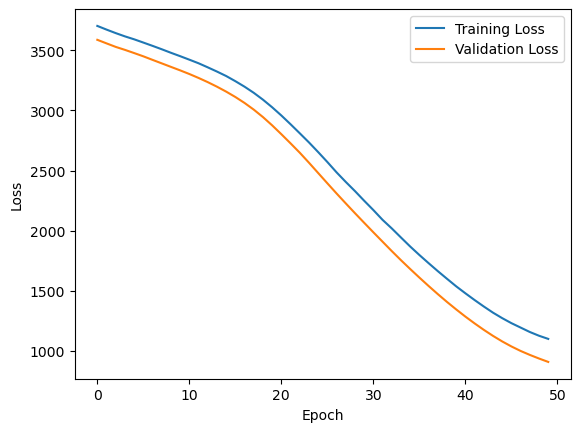

1/1 [==============================] - 0s 252ms/step


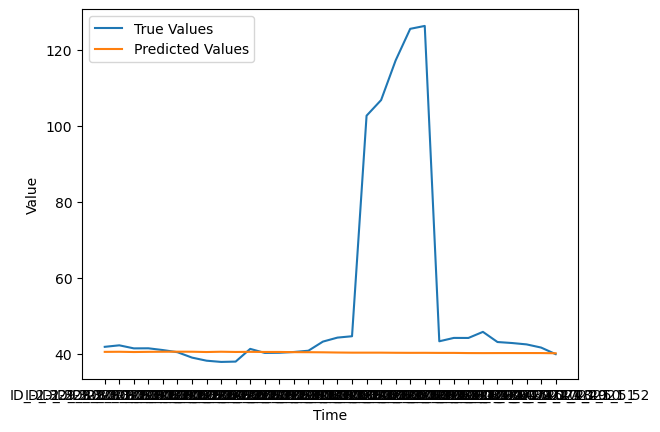

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.196_30.404
Epoch 1/50
3/3 [==============================] - 2s 197ms/step - loss: 22254.8984 - mse: 22254.8984 - accuracy: 0.0000e+00 - val_loss: 23203.9062 - val_mse: 23203.9062 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 22142.3184 - mse: 22142.3184 - accuracy: 0.0000e+00 - val_loss: 23090.1094 - val_mse: 23090.1094 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 22036.9688 - mse: 22036.9688 - accuracy: 0.0000e+00 - val_loss: 22993.1543 - val_mse: 22993.1543 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 21949.9570 - mse: 21949.9531 - accuracy: 0.0000e+00 - val_loss: 22921.5312 - val_mse: 22921.5312 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 21879.9512 - mse: 21879.9512 - accuracy: 0.0000e+00 - val_loss:

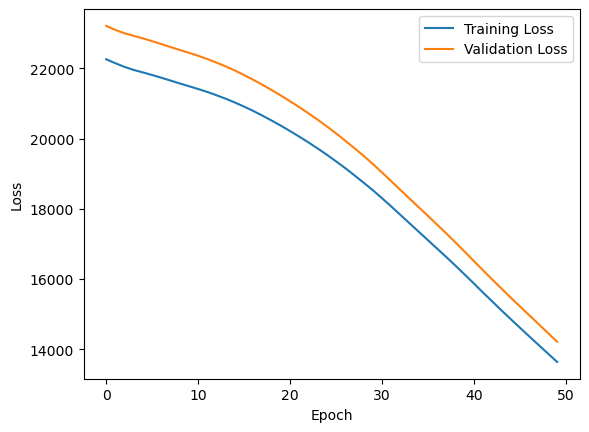

1/1 [==============================] - 0s 249ms/step


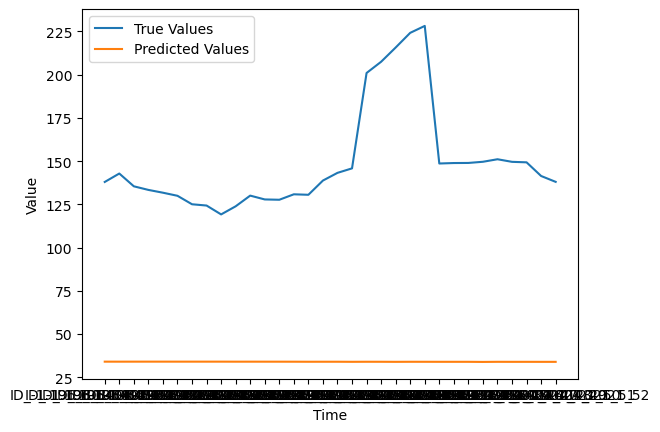

(49, 67)
2/2 [==============================] - 1s 6ms/step
LAT_LONG:  -1.116_29.684
Epoch 1/50
3/3 [==============================] - 2s 194ms/step - loss: 130.7174 - mse: 130.7174 - accuracy: 0.0000e+00 - val_loss: 141.8633 - val_mse: 141.8633 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 125.1197 - mse: 125.1197 - accuracy: 0.0000e+00 - val_loss: 136.3330 - val_mse: 136.3330 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 120.1758 - mse: 120.1758 - accuracy: 0.0000e+00 - val_loss: 131.2262 - val_mse: 131.2262 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 115.3289 - mse: 115.3289 - accuracy: 0.0000e+00 - val_loss: 125.9717 - val_mse: 125.9717 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 110.3641 - mse: 110.3641 - accuracy: 0.0000e+00 - val_loss: 120.4725 - val_mse: 120.4725 - val_

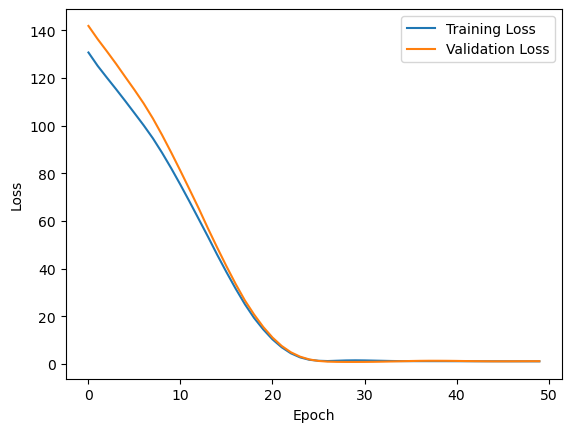

1/1 [==============================] - 0s 257ms/step


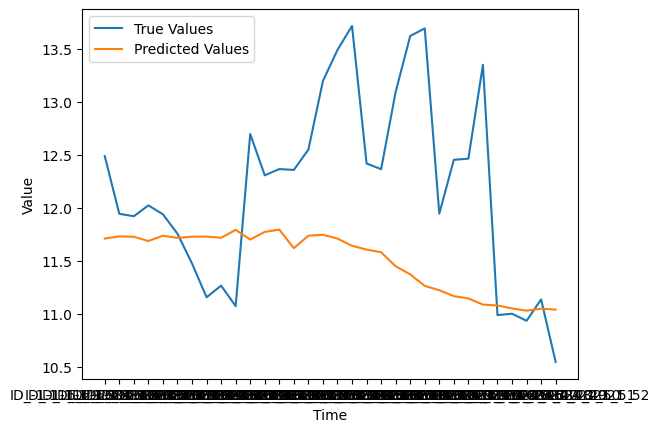

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.26_30.84
Epoch 1/50
3/3 [==============================] - 2s 190ms/step - loss: 5013.8706 - mse: 5013.8706 - accuracy: 0.0000e+00 - val_loss: 4841.8535 - val_mse: 4841.8535 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 4963.4902 - mse: 4963.4902 - accuracy: 0.0000e+00 - val_loss: 4793.1675 - val_mse: 4793.1675 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 33ms/step - loss: 4917.5649 - mse: 4917.5649 - accuracy: 0.0000e+00 - val_loss: 4755.2617 - val_mse: 4755.2617 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 4879.8154 - mse: 4879.8154 - accuracy: 0.0000e+00 - val_loss: 4716.6338 - val_mse: 4716.6338 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 4841.4673 - mse: 4841.4673 - accuracy: 0.0000e+00 - val_loss: 4679.8652 - val_mse

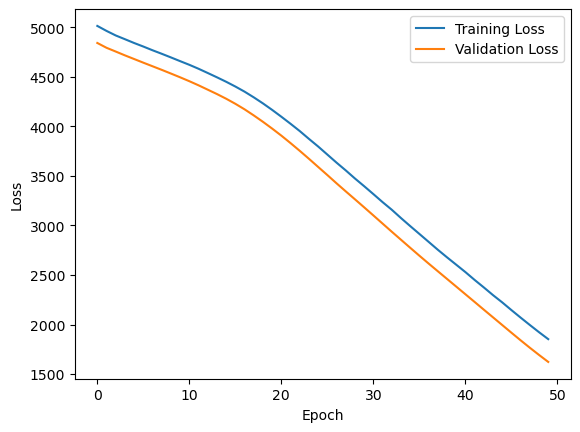

1/1 [==============================] - 0s 245ms/step


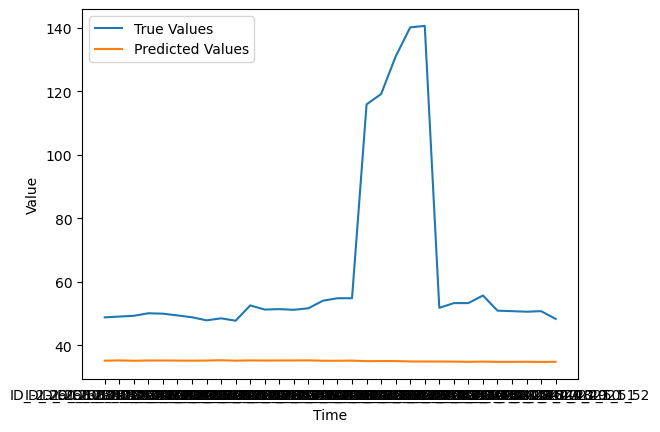

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -0.989_30.411
Epoch 1/50
3/3 [==============================] - 2s 229ms/step - loss: 1172.4149 - mse: 1172.4149 - accuracy: 0.0000e+00 - val_loss: 1272.4355 - val_mse: 1272.4355 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 1147.8770 - mse: 1147.8770 - accuracy: 0.0000e+00 - val_loss: 1247.7177 - val_mse: 1247.7177 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 40ms/step - loss: 1124.7169 - mse: 1124.7169 - accuracy: 0.0000e+00 - val_loss: 1225.1920 - val_mse: 1225.1920 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 37ms/step - loss: 1102.9462 - mse: 1102.9462 - accuracy: 0.0000e+00 - val_loss: 1202.8862 - val_mse: 1202.8862 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 32ms/step - loss: 1081.0570 - mse: 1081.0570 - accuracy: 0.0000e+00 - val_loss: 1179.5372 - val_m

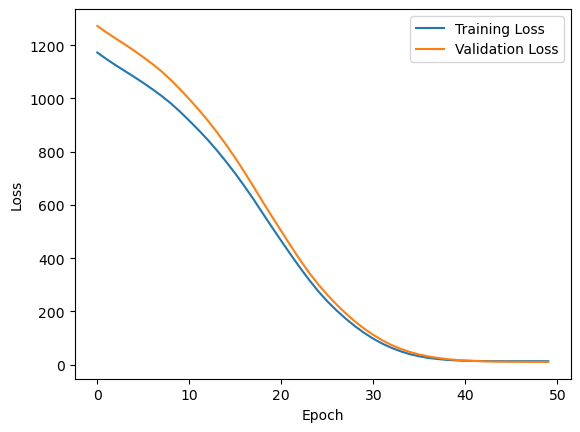

1/1 [==============================] - 0s 320ms/step


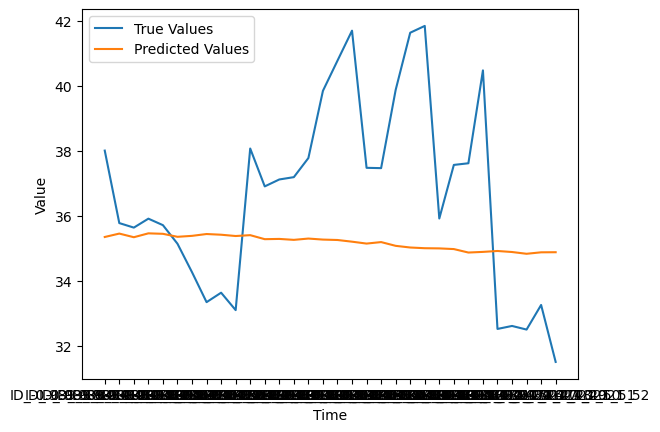

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.371_29.629
Epoch 1/50
3/3 [==============================] - 2s 209ms/step - loss: 71037.1406 - mse: 71037.1406 - accuracy: 0.0000e+00 - val_loss: 74724.9062 - val_mse: 74724.9062 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 70928.7266 - mse: 70928.7266 - accuracy: 0.0000e+00 - val_loss: 74627.7656 - val_mse: 74627.7656 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 32ms/step - loss: 70833.2344 - mse: 70833.2344 - accuracy: 0.0000e+00 - val_loss: 74534.2031 - val_mse: 74534.2031 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 36ms/step - loss: 70746.4375 - mse: 70746.4375 - accuracy: 0.0000e+00 - val_loss: 74452.3828 - val_mse: 74452.3828 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 34ms/step - loss: 70665.9922 - mse: 70666.0000 - accuracy: 0.0000e+00 - val_loss:

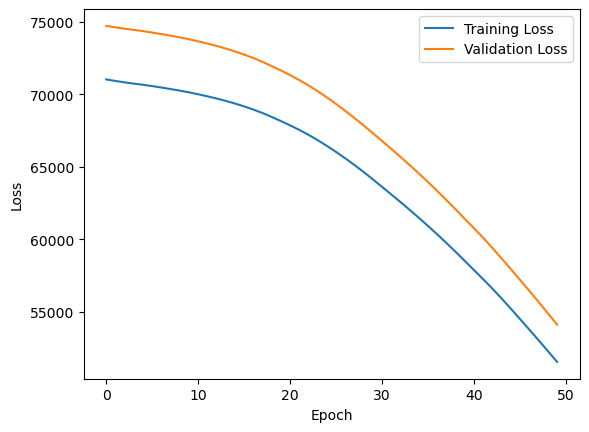

1/1 [==============================] - 0s 290ms/step


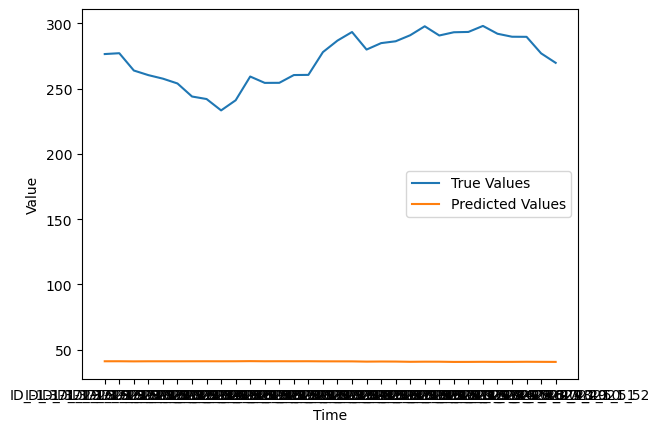

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.065_30.235
Epoch 1/50
3/3 [==============================] - 2s 219ms/step - loss: 8960.4023 - mse: 8960.4014 - accuracy: 0.0000e+00 - val_loss: 8877.4785 - val_mse: 8877.4785 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 32ms/step - loss: 8896.1494 - mse: 8896.1494 - accuracy: 0.0000e+00 - val_loss: 8819.9512 - val_mse: 8819.9512 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 35ms/step - loss: 8839.5498 - mse: 8839.5498 - accuracy: 0.0000e+00 - val_loss: 8767.7656 - val_mse: 8767.7656 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 42ms/step - loss: 8787.9424 - mse: 8787.9424 - accuracy: 0.0000e+00 - val_loss: 8719.4443 - val_mse: 8719.4443 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 39ms/step - loss: 8739.9941 - mse: 8739.9941 - accuracy: 0.0000e+00 - val_loss: 8671.3369 - val_m

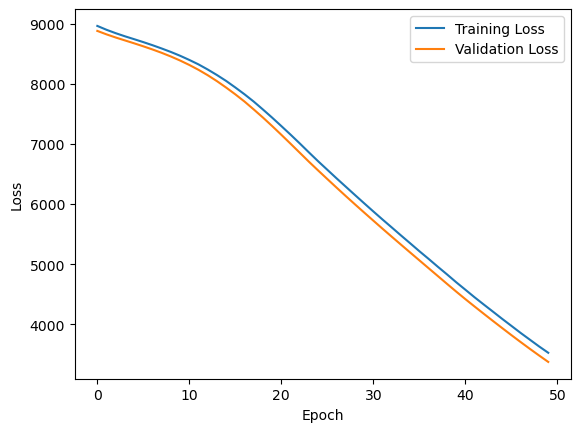

1/1 [==============================] - 1s 806ms/step


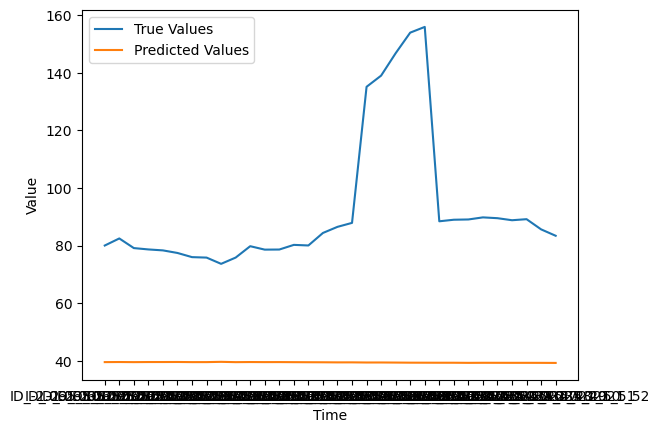

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.931_29.569
Epoch 1/50
3/3 [==============================] - 2s 208ms/step - loss: 9206.4014 - mse: 9206.4004 - accuracy: 0.0000e+00 - val_loss: 8133.5605 - val_mse: 8133.5605 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 44ms/step - loss: 9156.4619 - mse: 9156.4619 - accuracy: 0.0000e+00 - val_loss: 8083.6245 - val_mse: 8083.6245 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 32ms/step - loss: 9104.1709 - mse: 9104.1719 - accuracy: 0.0000e+00 - val_loss: 8035.3950 - val_mse: 8035.3950 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 9053.9941 - mse: 9053.9941 - accuracy: 0.0000e+00 - val_loss: 7985.1587 - val_mse: 7985.1587 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 9000.3955 - mse: 9000.3955 - accuracy: 0.0000e+00 - val_loss: 7932.3843 - val_m

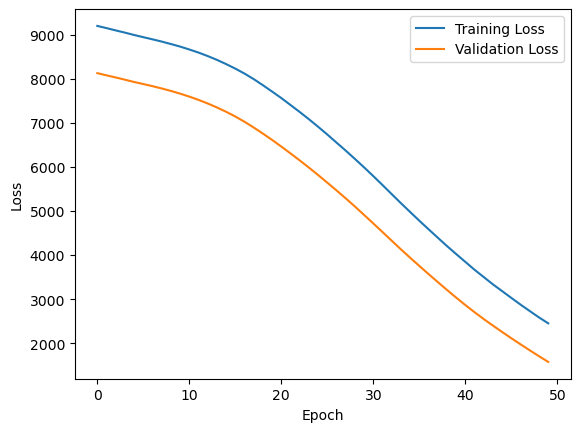

1/1 [==============================] - 0s 288ms/step


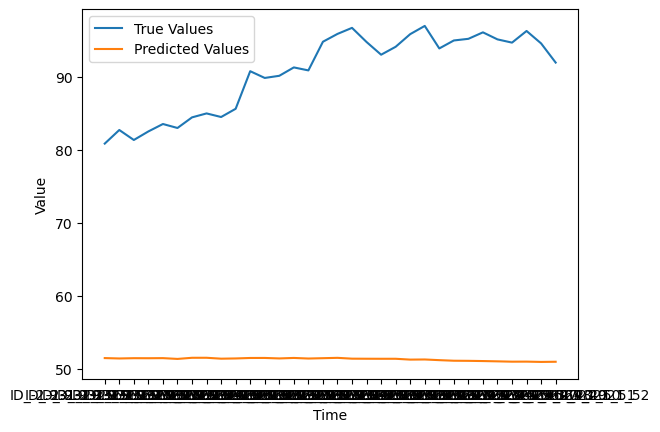

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -2.734_29.766
Epoch 1/50
3/3 [==============================] - 2s 240ms/step - loss: 12714.1152 - mse: 12714.1152 - accuracy: 0.0000e+00 - val_loss: 13162.2051 - val_mse: 13162.2051 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 32ms/step - loss: 12625.3330 - mse: 12625.3330 - accuracy: 0.0000e+00 - val_loss: 13070.6855 - val_mse: 13070.6855 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 35ms/step - loss: 12536.8887 - mse: 12536.8887 - accuracy: 0.0000e+00 - val_loss: 12983.6270 - val_mse: 12983.6270 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 12453.3545 - mse: 12453.3545 - accuracy: 0.0000e+00 - val_loss: 12902.3281 - val_mse: 12902.3281 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 39ms/step - loss: 12376.2041 - mse: 12376.2041 - accuracy: 0.0000e+00 - val_loss:

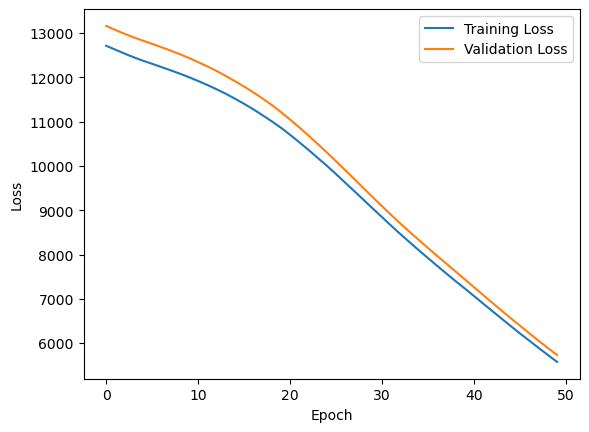

1/1 [==============================] - 0s 287ms/step


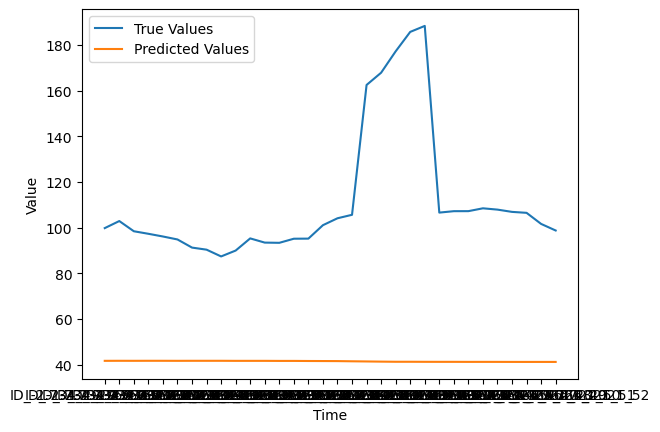

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.048_30.252
Epoch 1/50
3/3 [==============================] - 2s 208ms/step - loss: 91205.9688 - mse: 91205.9688 - accuracy: 0.0000e+00 - val_loss: 96229.9141 - val_mse: 96229.9141 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 31ms/step - loss: 91052.4844 - mse: 91052.4844 - accuracy: 0.0000e+00 - val_loss: 96081.3906 - val_mse: 96081.3906 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 52ms/step - loss: 90911.4141 - mse: 90911.4141 - accuracy: 0.0000e+00 - val_loss: 95936.4609 - val_mse: 95936.4609 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 90768.0938 - mse: 90768.0938 - accuracy: 0.0000e+00 - val_loss: 95787.7109 - val_mse: 95787.7109 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 34ms/step - loss: 90626.2500 - mse: 90626.2500 - accuracy: 0.0000e+00 - val_loss:

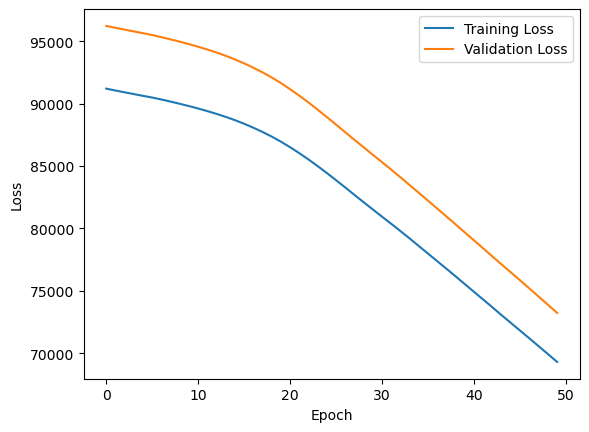

1/1 [==============================] - 0s 297ms/step


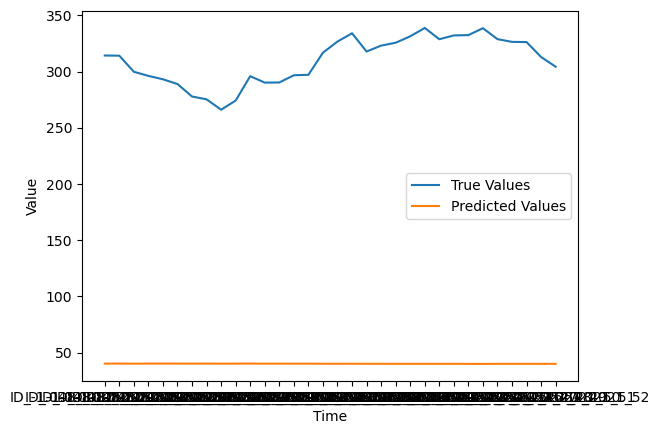

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.523_30.677
Epoch 1/50
3/3 [==============================] - 2s 206ms/step - loss: 3297.0098 - mse: 3297.0098 - accuracy: 0.0000e+00 - val_loss: 3437.6431 - val_mse: 3437.6431 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 35ms/step - loss: 3267.9487 - mse: 3267.9487 - accuracy: 0.0000e+00 - val_loss: 3411.2310 - val_mse: 3411.2310 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 32ms/step - loss: 3245.0667 - mse: 3245.0667 - accuracy: 0.0000e+00 - val_loss: 3388.3086 - val_mse: 3388.3086 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 3223.3875 - mse: 3223.3875 - accuracy: 0.0000e+00 - val_loss: 3366.5940 - val_mse: 3366.5940 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 3202.4846 - mse: 3202.4846 - accuracy: 0.0000e+00 - val_loss: 3343.8328 - val_m

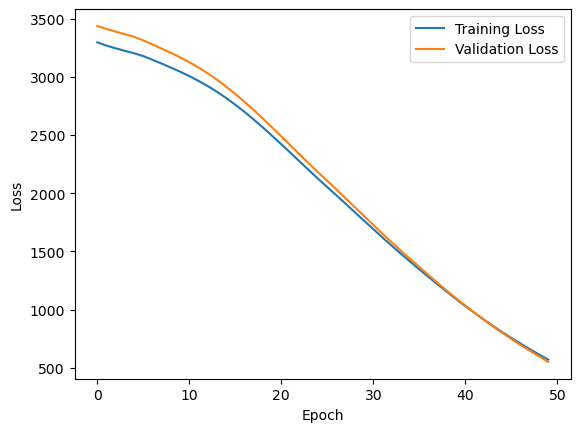

1/1 [==============================] - 0s 285ms/step


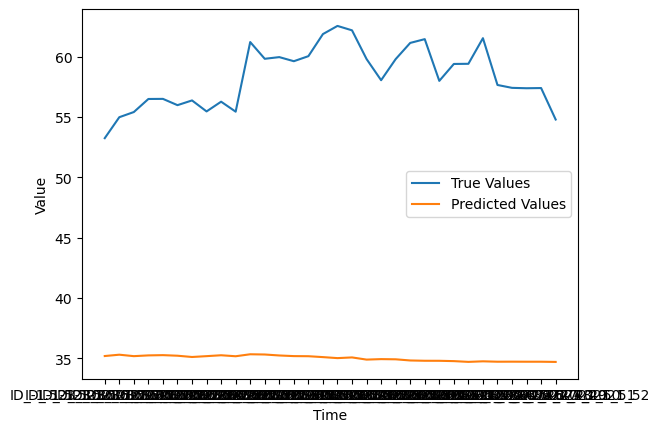

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.902_28.398
Epoch 1/50
3/3 [==============================] - 2s 203ms/step - loss: 2.5475 - mse: 2.5475 - accuracy: 0.0000e+00 - val_loss: 1.4778 - val_mse: 1.4778 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 1.9533 - mse: 1.9533 - accuracy: 0.0000e+00 - val_loss: 0.9995 - val_mse: 0.9995 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 1.4692 - mse: 1.4692 - accuracy: 0.0000e+00 - val_loss: 0.6269 - val_mse: 0.6269 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 1.0704 - mse: 1.0704 - accuracy: 0.0000e+00 - val_loss: 0.3656 - val_mse: 0.3656 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 32ms/step - loss: 0.7939 - mse: 0.7939 - accuracy: 0.0000e+00 - val_loss: 0.1871 - val_mse: 0.1871 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

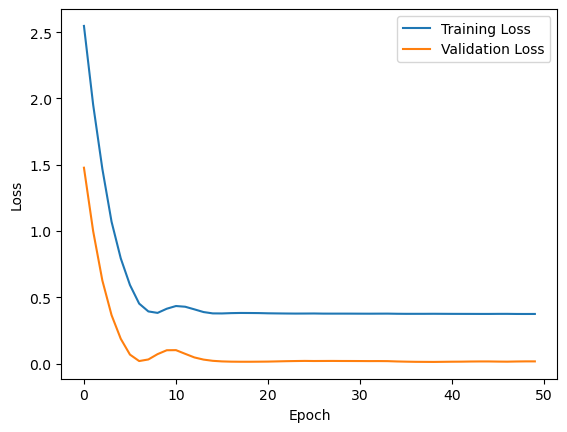

1/1 [==============================] - 0s 283ms/step


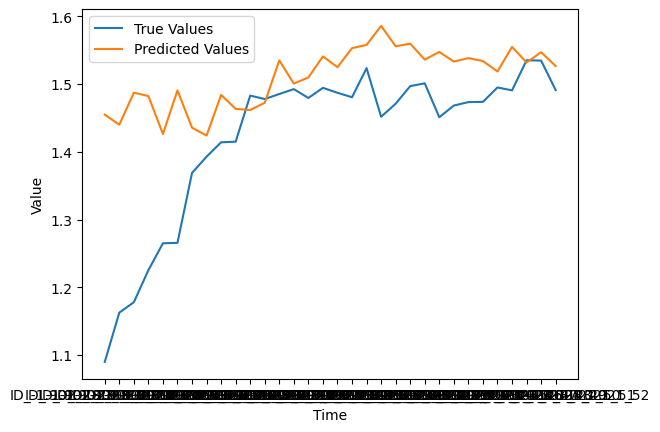

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -0.785_29.115
Epoch 1/50
3/3 [==============================] - 2s 219ms/step - loss: 1076.0743 - mse: 1076.0743 - accuracy: 0.0000e+00 - val_loss: 1096.4070 - val_mse: 1096.4070 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 1057.0471 - mse: 1057.0471 - accuracy: 0.0000e+00 - val_loss: 1076.5061 - val_mse: 1076.5061 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 32ms/step - loss: 1037.8455 - mse: 1037.8453 - accuracy: 0.0000e+00 - val_loss: 1058.3440 - val_mse: 1058.3440 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 34ms/step - loss: 1020.5684 - mse: 1020.5684 - accuracy: 0.0000e+00 - val_loss: 1041.5435 - val_mse: 1041.5435 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 36ms/step - loss: 1004.1968 - mse: 1004.1968 - accuracy: 0.0000e+00 - val_loss: 1025.2292 - val_m

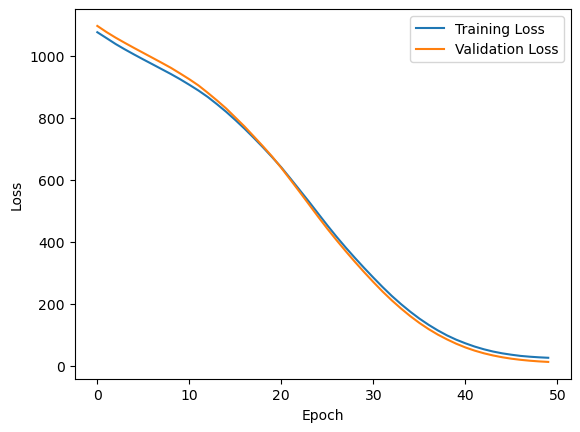

1/1 [==============================] - 0s 277ms/step


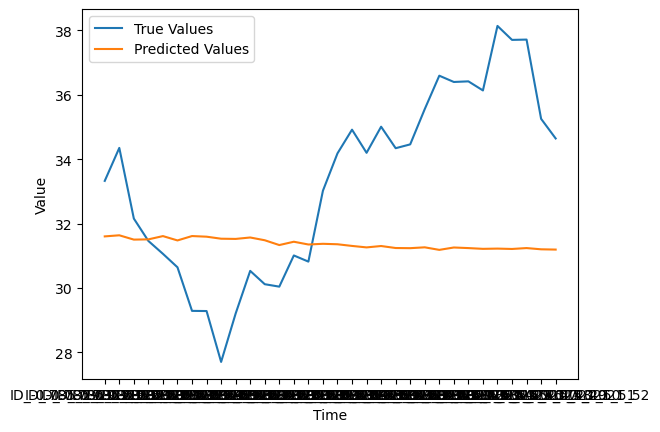

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -0.935_29.765
Epoch 1/50
3/3 [==============================] - 2s 206ms/step - loss: 624.0858 - mse: 624.0858 - accuracy: 0.0000e+00 - val_loss: 653.8990 - val_mse: 653.8990 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 32ms/step - loss: 597.1196 - mse: 597.1196 - accuracy: 0.0000e+00 - val_loss: 625.7799 - val_mse: 625.7799 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 37ms/step - loss: 571.4456 - mse: 571.4456 - accuracy: 0.0000e+00 - val_loss: 601.1008 - val_mse: 601.1008 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 36ms/step - loss: 548.1127 - mse: 548.1127 - accuracy: 0.0000e+00 - val_loss: 576.1973 - val_mse: 576.1973 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 524.0374 - mse: 524.0374 - accuracy: 0.0000e+00 - val_loss: 550.8281 - val_mse: 550.8281 - val_

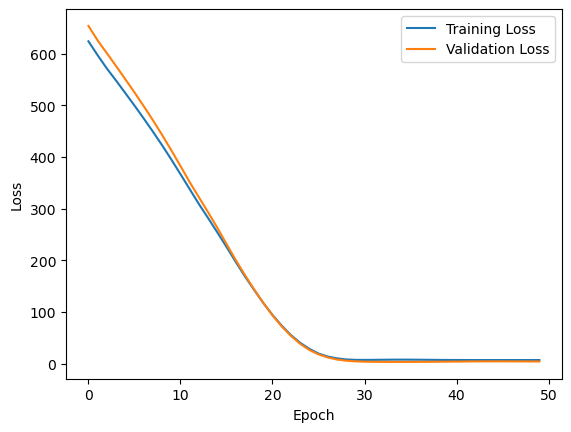

1/1 [==============================] - 0s 334ms/step


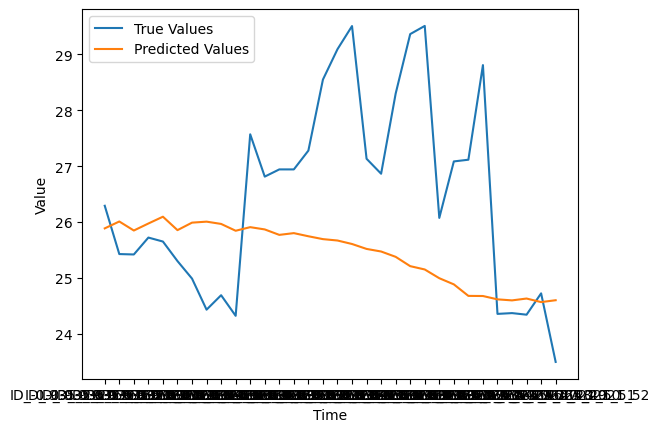

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.664_30.336
Epoch 1/50
3/3 [==============================] - 3s 201ms/step - loss: 14616.7139 - mse: 14616.7139 - accuracy: 0.0000e+00 - val_loss: 14059.9609 - val_mse: 14059.9609 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 14569.0840 - mse: 14569.0840 - accuracy: 0.0000e+00 - val_loss: 14025.4844 - val_mse: 14025.4844 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 33ms/step - loss: 14537.3486 - mse: 14537.3486 - accuracy: 0.0000e+00 - val_loss: 13995.3418 - val_mse: 13995.3418 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 14507.2314 - mse: 14507.2314 - accuracy: 0.0000e+00 - val_loss: 13965.4395 - val_mse: 13965.4395 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 38ms/step - loss: 14476.6182 - mse: 14476.6182 - accuracy: 0.0000e+00 - val_loss:

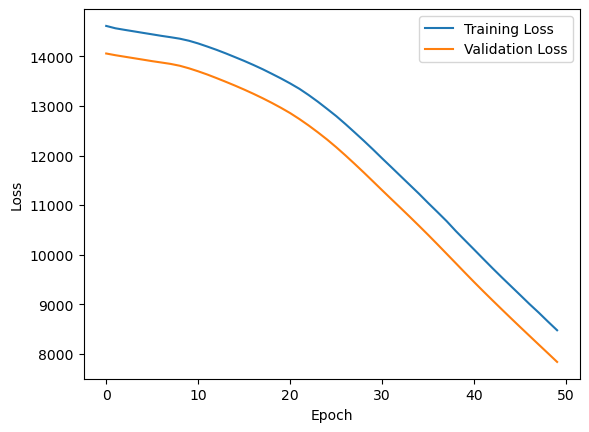

1/1 [==============================] - 0s 342ms/step


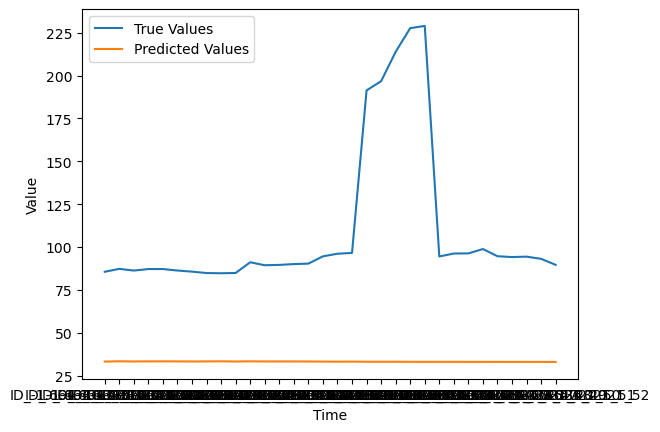

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.179_30.621
Epoch 1/50
3/3 [==============================] - 2s 206ms/step - loss: 3321.0574 - mse: 3321.0574 - accuracy: 0.0000e+00 - val_loss: 2999.9390 - val_mse: 2999.9390 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 3277.5923 - mse: 3277.5923 - accuracy: 0.0000e+00 - val_loss: 2960.9995 - val_mse: 2960.9995 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 35ms/step - loss: 3239.5903 - mse: 3239.5903 - accuracy: 0.0000e+00 - val_loss: 2927.8813 - val_mse: 2927.8813 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 41ms/step - loss: 3207.8445 - mse: 3207.8445 - accuracy: 0.0000e+00 - val_loss: 2901.9272 - val_mse: 2901.9272 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 38ms/step - loss: 3182.9741 - mse: 3182.9741 - accuracy: 0.0000e+00 - val_loss: 2878.3447 - val_m

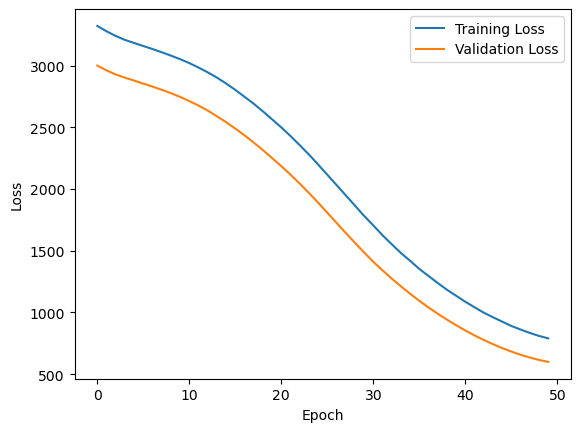

1/1 [==============================] - 0s 330ms/step


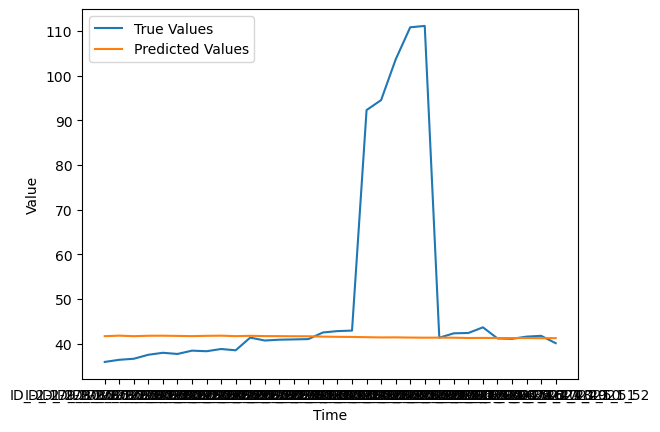

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -2.119_29.281
Epoch 1/50
3/3 [==============================] - 2s 388ms/step - loss: 12002.6709 - mse: 12002.6709 - accuracy: 0.0000e+00 - val_loss: 12276.2285 - val_mse: 12276.2285 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 11937.4365 - mse: 11937.4365 - accuracy: 0.0000e+00 - val_loss: 12212.2080 - val_mse: 12212.2080 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 35ms/step - loss: 11873.6934 - mse: 11873.6934 - accuracy: 0.0000e+00 - val_loss: 12150.0547 - val_mse: 12150.0547 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 35ms/step - loss: 11814.2168 - mse: 11814.2168 - accuracy: 0.0000e+00 - val_loss: 12091.9580 - val_mse: 12091.9580 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 34ms/step - loss: 11761.7002 - mse: 11761.7002 - accuracy: 0.0000e+00 - val_loss:

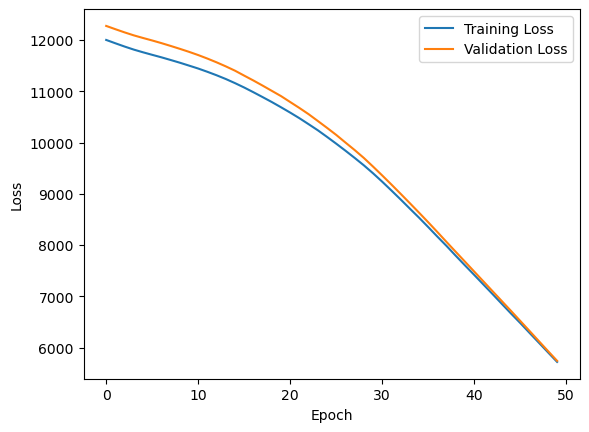

1/1 [==============================] - 0s 331ms/step


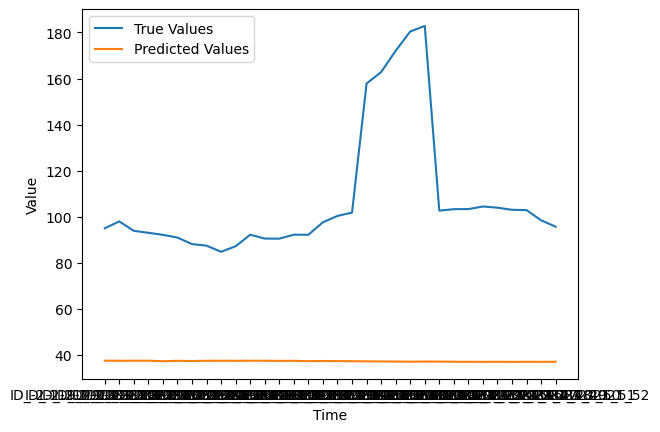

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -0.702_29.798
Epoch 1/50
3/3 [==============================] - 2s 222ms/step - loss: 8457.5195 - mse: 8457.5195 - accuracy: 0.0000e+00 - val_loss: 9265.2783 - val_mse: 9265.2783 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 32ms/step - loss: 8407.3076 - mse: 8407.3076 - accuracy: 0.0000e+00 - val_loss: 9214.9980 - val_mse: 9214.9980 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 8361.2354 - mse: 8361.2354 - accuracy: 0.0000e+00 - val_loss: 9168.4434 - val_mse: 9168.4434 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 8318.6562 - mse: 8318.6562 - accuracy: 0.0000e+00 - val_loss: 9123.1543 - val_mse: 9123.1543 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 8274.0889 - mse: 8274.0889 - accuracy: 0.0000e+00 - val_loss: 9073.1426 - val_m

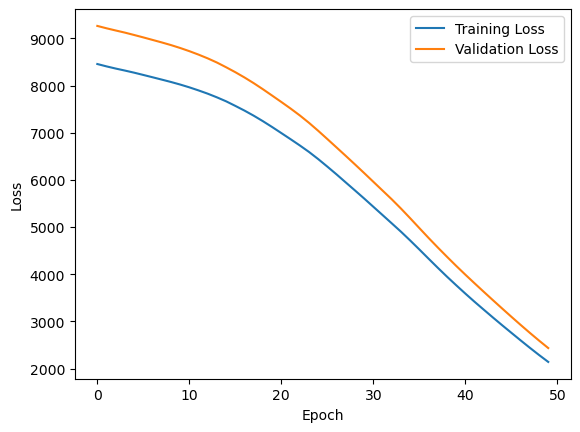

1/1 [==============================] - 0s 272ms/step


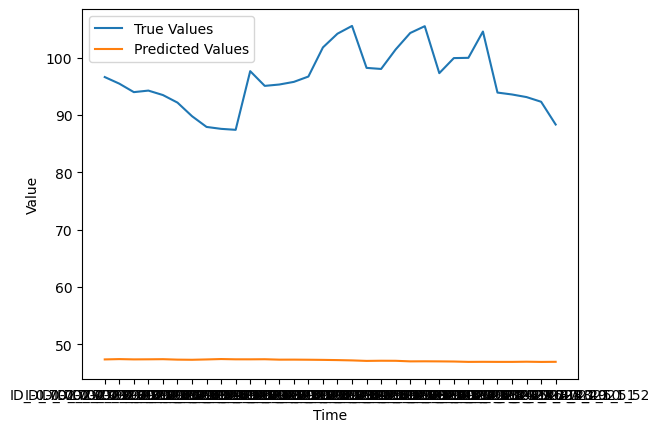

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.272_29.128
Epoch 1/50
3/3 [==============================] - 2s 217ms/step - loss: 4262.2930 - mse: 4262.2930 - accuracy: 0.0000e+00 - val_loss: 4400.0596 - val_mse: 4400.0596 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 35ms/step - loss: 4229.0073 - mse: 4229.0073 - accuracy: 0.0000e+00 - val_loss: 4370.3535 - val_mse: 4370.3535 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 4200.7007 - mse: 4200.7007 - accuracy: 0.0000e+00 - val_loss: 4341.6475 - val_mse: 4341.6475 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 4173.8564 - mse: 4173.8564 - accuracy: 0.0000e+00 - val_loss: 4314.0527 - val_mse: 4314.0527 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 4147.2173 - mse: 4147.2168 - accuracy: 0.0000e+00 - val_loss: 4286.0615 - val_m

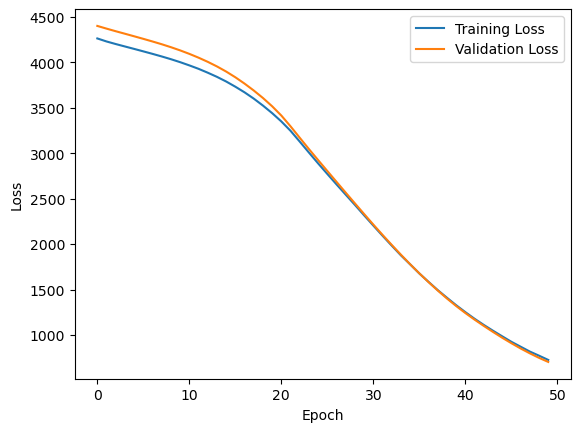

1/1 [==============================] - 0s 301ms/step


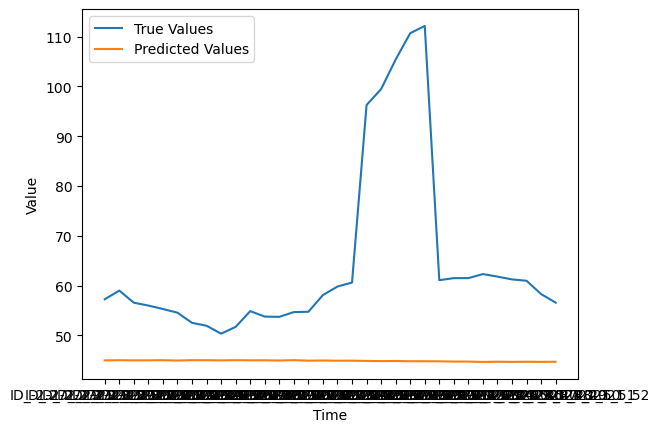

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -1.77_31.03
Epoch 1/50
3/3 [==============================] - 2s 212ms/step - loss: 10.0735 - mse: 10.0735 - accuracy: 0.0000e+00 - val_loss: 9.5483 - val_mse: 9.5483 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 48ms/step - loss: 8.4842 - mse: 8.4842 - accuracy: 0.0000e+00 - val_loss: 8.2125 - val_mse: 8.2125 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 36ms/step - loss: 7.2385 - mse: 7.2385 - accuracy: 0.0000e+00 - val_loss: 7.1006 - val_mse: 7.1006 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 35ms/step - loss: 6.2165 - mse: 6.2165 - accuracy: 0.0000e+00 - val_loss: 6.1326 - val_mse: 6.1326 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 34ms/step - loss: 5.3068 - mse: 5.3068 - accuracy: 0.0000e+00 - val_loss: 5.2139 - val_mse: 5.2139 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

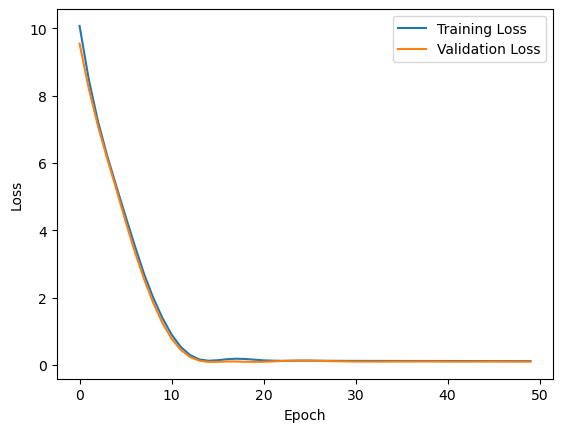

1/1 [==============================] - 0s 347ms/step


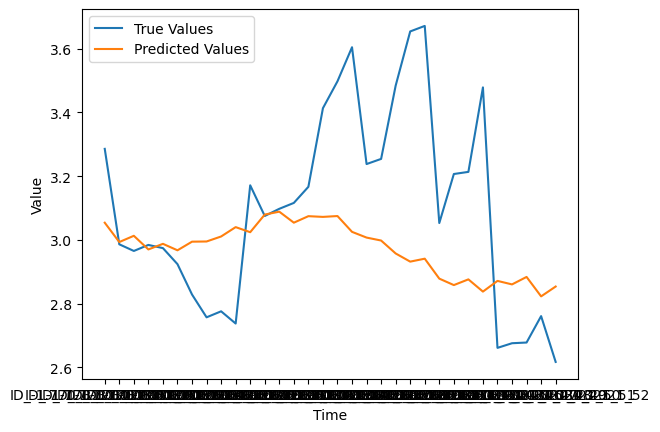

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.961_28.939
Epoch 1/50
3/3 [==============================] - 2s 237ms/step - loss: 114.2630 - mse: 114.2630 - accuracy: 0.0000e+00 - val_loss: 109.7640 - val_mse: 109.7640 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 44ms/step - loss: 105.7102 - mse: 105.7102 - accuracy: 0.0000e+00 - val_loss: 102.0974 - val_mse: 102.0974 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 36ms/step - loss: 98.2686 - mse: 98.2686 - accuracy: 0.0000e+00 - val_loss: 94.8007 - val_mse: 94.8007 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 35ms/step - loss: 91.0289 - mse: 91.0289 - accuracy: 0.0000e+00 - val_loss: 87.5512 - val_mse: 87.5512 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 35ms/step - loss: 83.8871 - mse: 83.8871 - accuracy: 0.0000e+00 - val_loss: 80.3379 - val_mse: 80.3379 - val_accuracy: 0.

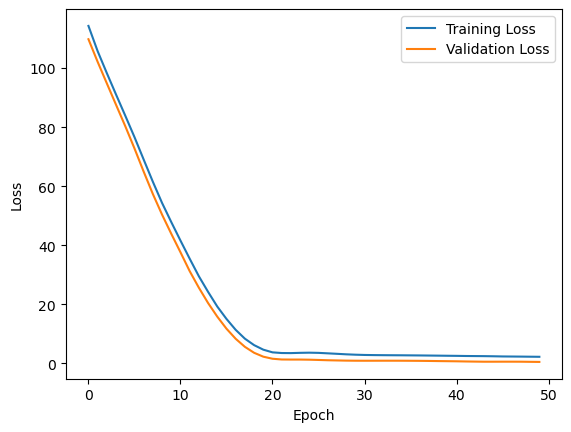

1/1 [==============================] - 0s 327ms/step


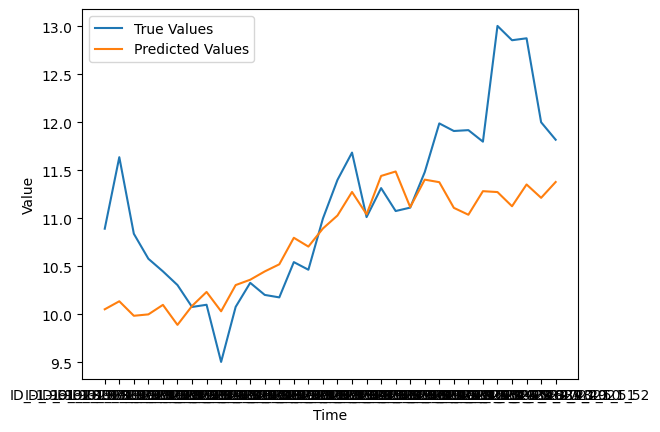

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.845_29.355
Epoch 1/50
3/3 [==============================] - 2s 408ms/step - loss: 3627.7117 - mse: 3627.7117 - accuracy: 0.0000e+00 - val_loss: 3672.6094 - val_mse: 3672.6094 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 37ms/step - loss: 3590.0161 - mse: 3590.0161 - accuracy: 0.0000e+00 - val_loss: 3633.2095 - val_mse: 3633.2095 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 38ms/step - loss: 3550.2300 - mse: 3550.2300 - accuracy: 0.0000e+00 - val_loss: 3590.2932 - val_mse: 3590.2932 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 34ms/step - loss: 3508.3696 - mse: 3508.3696 - accuracy: 0.0000e+00 - val_loss: 3547.7871 - val_mse: 3547.7871 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 35ms/step - loss: 3467.8611 - mse: 3467.8611 - accuracy: 0.0000e+00 - val_loss: 3507.1582 - val_m

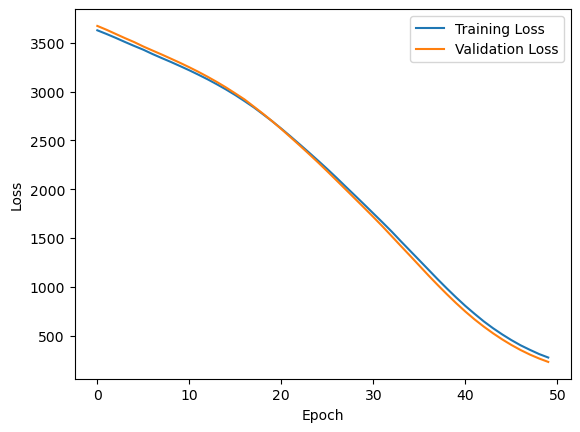

1/1 [==============================] - 0s 310ms/step


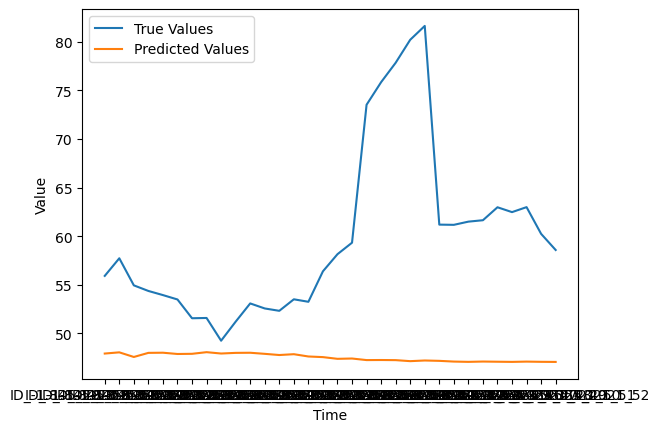

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -1.068_31.532
Epoch 1/50
3/3 [==============================] - 2s 213ms/step - loss: 69570.5625 - mse: 69570.5625 - accuracy: 0.0000e+00 - val_loss: 70753.5938 - val_mse: 70753.5938 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 34ms/step - loss: 69355.7734 - mse: 69355.7656 - accuracy: 0.0000e+00 - val_loss: 70533.1562 - val_mse: 70533.1562 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 32ms/step - loss: 69129.2031 - mse: 69129.2031 - accuracy: 0.0000e+00 - val_loss: 70300.3906 - val_mse: 70300.3906 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 35ms/step - loss: 68895.4219 - mse: 68895.4219 - accuracy: 0.0000e+00 - val_loss: 70061.2188 - val_mse: 70061.2188 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 37ms/step - loss: 68650.1562 - mse: 68650.1562 - accuracy: 0.0000e+00 - val_loss:

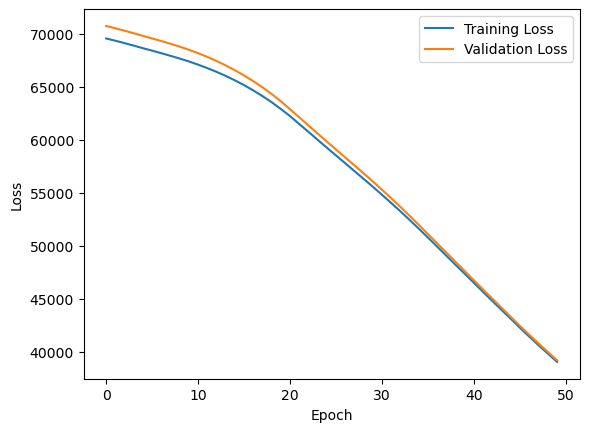

1/1 [==============================] - 0s 284ms/step


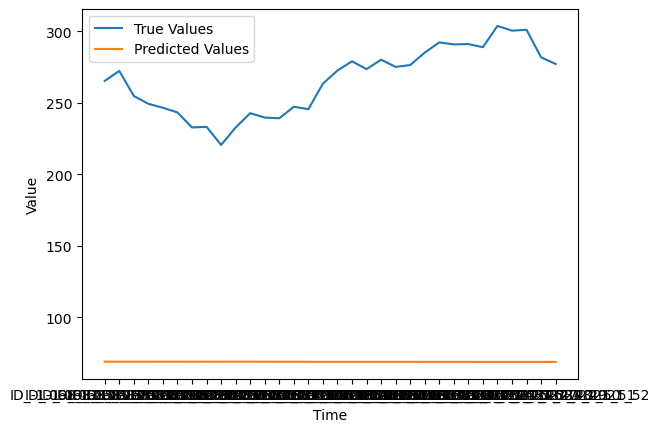

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.743_29.457
Epoch 1/50
3/3 [==============================] - 2s 229ms/step - loss: 33990.0859 - mse: 33990.0859 - accuracy: 0.0000e+00 - val_loss: 34603.3203 - val_mse: 34603.3203 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 38ms/step - loss: 33884.1172 - mse: 33884.1172 - accuracy: 0.0000e+00 - val_loss: 34496.3125 - val_mse: 34496.3125 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 39ms/step - loss: 33781.6406 - mse: 33781.6406 - accuracy: 0.0000e+00 - val_loss: 34396.9453 - val_mse: 34396.9453 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 34ms/step - loss: 33685.4375 - mse: 33685.4375 - accuracy: 0.0000e+00 - val_loss: 34297.6367 - val_mse: 34297.6367 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 35ms/step - loss: 33590.0078 - mse: 33590.0117 - accuracy: 0.0000e+00 - val_loss:

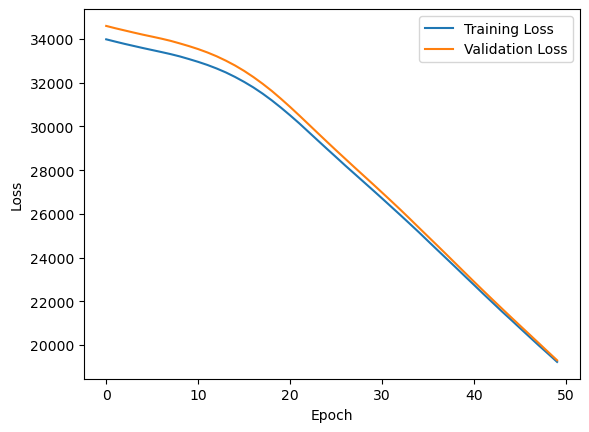

1/1 [==============================] - 0s 286ms/step


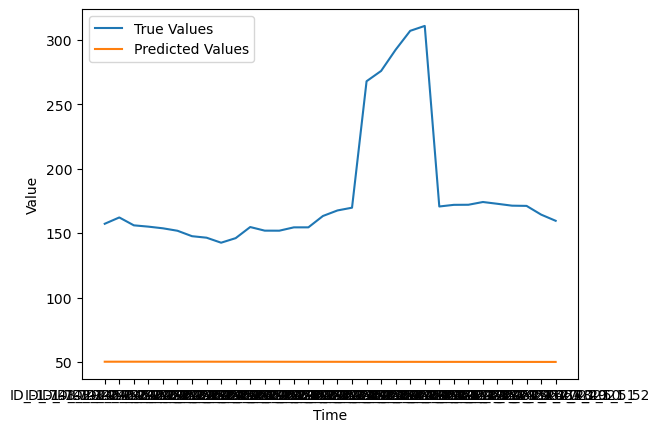

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.059_28.741
Epoch 1/50
3/3 [==============================] - 3s 202ms/step - loss: 0.7141 - mse: 0.7141 - accuracy: 0.0000e+00 - val_loss: 0.0848 - val_mse: 0.0848 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 0.3947 - mse: 0.3947 - accuracy: 0.0000e+00 - val_loss: 0.0101 - val_mse: 0.0101 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 33ms/step - loss: 0.3068 - mse: 0.3068 - accuracy: 0.0000e+00 - val_loss: 0.0750 - val_mse: 0.0750 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 0.3465 - mse: 0.3465 - accuracy: 0.0000e+00 - val_loss: 0.1399 - val_mse: 0.1399 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 37ms/step - loss: 0.3733 - mse: 0.3733 - accuracy: 0.0000e+00 - val_loss: 0.1305 - val_mse: 0.1305 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

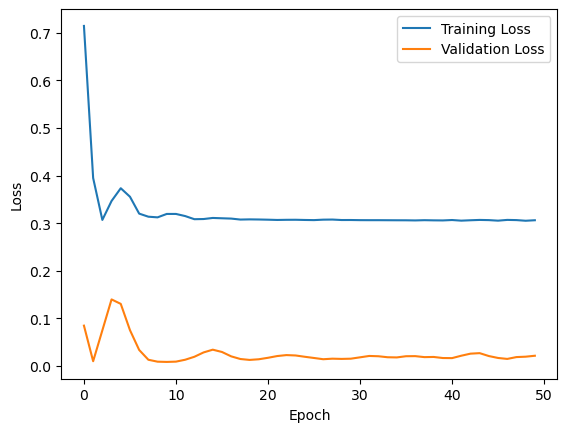

1/1 [==============================] - 0s 327ms/step


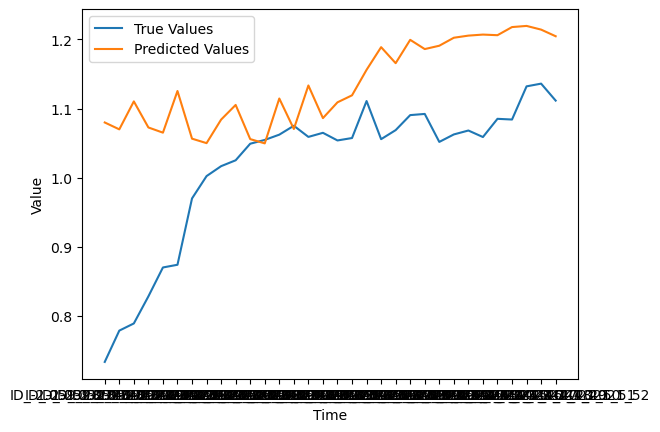

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -0.615_30.885
Epoch 1/50
3/3 [==============================] - 2s 218ms/step - loss: 7192.9990 - mse: 7192.9990 - accuracy: 0.0000e+00 - val_loss: 7589.7305 - val_mse: 7589.7305 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 31ms/step - loss: 7127.0791 - mse: 7127.0791 - accuracy: 0.0000e+00 - val_loss: 7525.2256 - val_mse: 7525.2256 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 34ms/step - loss: 7065.7310 - mse: 7065.7310 - accuracy: 0.0000e+00 - val_loss: 7466.4795 - val_mse: 7466.4795 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 34ms/step - loss: 7009.0034 - mse: 7009.0034 - accuracy: 0.0000e+00 - val_loss: 7408.7676 - val_mse: 7408.7676 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 6951.4497 - mse: 6951.4497 - accuracy: 0.0000e+00 - val_loss: 7348.1104 - val_m

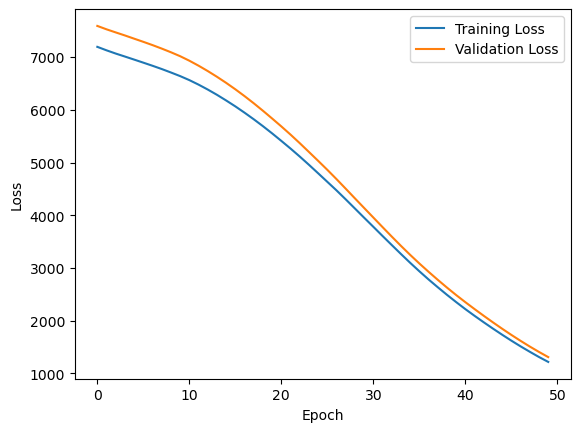

1/1 [==============================] - 0s 282ms/step


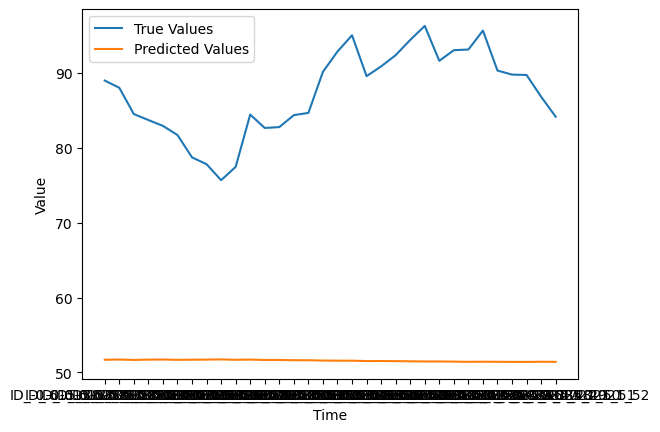

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -2.136_30.264
Epoch 1/50
3/3 [==============================] - 2s 207ms/step - loss: 13355.7090 - mse: 13355.7090 - accuracy: 0.0000e+00 - val_loss: 13420.0430 - val_mse: 13420.0430 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 31ms/step - loss: 13280.2559 - mse: 13280.2559 - accuracy: 0.0000e+00 - val_loss: 13349.2715 - val_mse: 13349.2715 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 32ms/step - loss: 13211.8818 - mse: 13211.8818 - accuracy: 0.0000e+00 - val_loss: 13279.5996 - val_mse: 13279.5996 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 13141.0986 - mse: 13141.0986 - accuracy: 0.0000e+00 - val_loss: 13209.3184 - val_mse: 13209.3184 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 41ms/step - loss: 13073.3438 - mse: 13073.3438 - accuracy: 0.0000e+00 - val_loss:

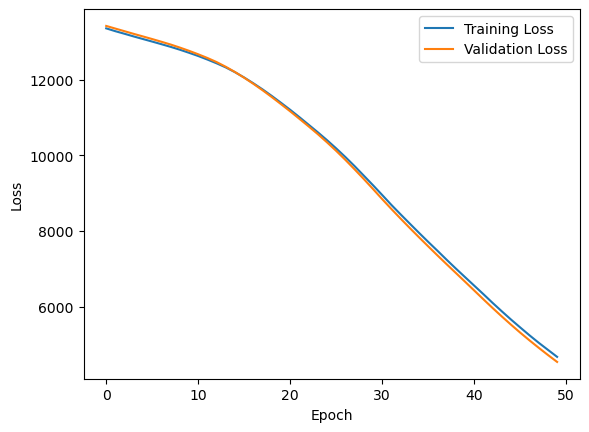

1/1 [==============================] - 0s 458ms/step


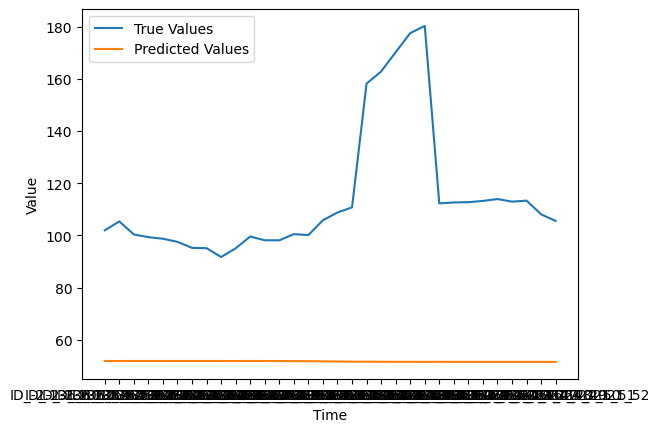

(49, 67)
2/2 [==============================] - 2s 8ms/step
LAT_LONG:  -0.829_30.471
Epoch 1/50
3/3 [==============================] - 2s 302ms/step - loss: 1.9930 - mse: 1.9930 - accuracy: 0.0000e+00 - val_loss: 1.5365 - val_mse: 1.5365 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 82ms/step - loss: 1.2567 - mse: 1.2567 - accuracy: 0.0000e+00 - val_loss: 0.9897 - val_mse: 0.9897 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 39ms/step - loss: 0.8079 - mse: 0.8079 - accuracy: 0.0000e+00 - val_loss: 0.6659 - val_mse: 0.6659 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 37ms/step - loss: 0.5277 - mse: 0.5277 - accuracy: 0.0000e+00 - val_loss: 0.4260 - val_mse: 0.4260 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 39ms/step - loss: 0.3179 - mse: 0.3179 - accuracy: 0.0000e+00 - val_loss: 0.2500 - val_mse: 0.2500 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

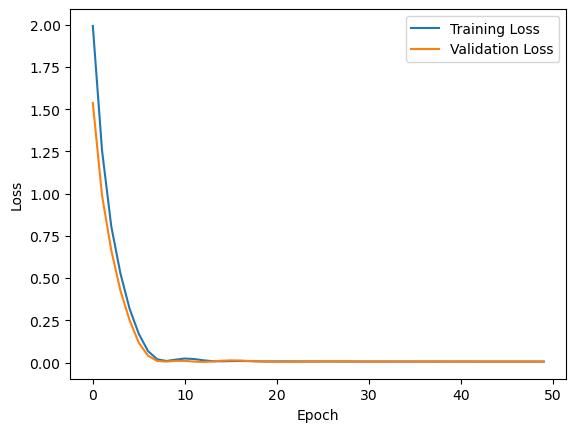

1/1 [==============================] - 0s 277ms/step


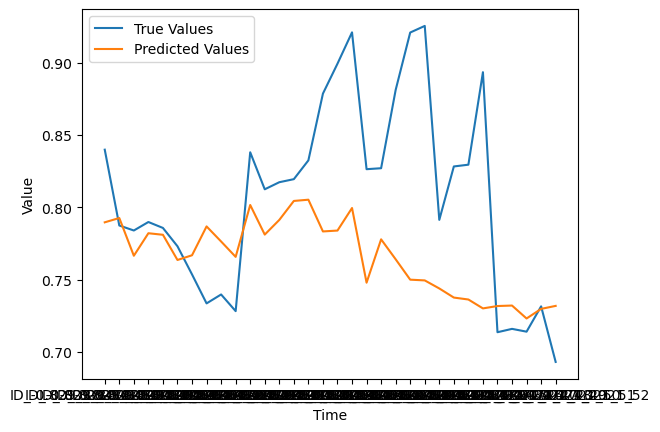

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.639_31.061
Epoch 1/50
3/3 [==============================] - 2s 243ms/step - loss: 28918.5312 - mse: 28918.5312 - accuracy: 0.0000e+00 - val_loss: 30281.9648 - val_mse: 30281.9648 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 39ms/step - loss: 28828.5664 - mse: 28828.5664 - accuracy: 0.0000e+00 - val_loss: 30199.0898 - val_mse: 30199.0898 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 39ms/step - loss: 28751.6191 - mse: 28751.6191 - accuracy: 0.0000e+00 - val_loss: 30127.0215 - val_mse: 30127.0215 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 35ms/step - loss: 28680.8496 - mse: 28680.8496 - accuracy: 0.0000e+00 - val_loss: 30066.0430 - val_mse: 30066.0430 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 36ms/step - loss: 28617.7871 - mse: 28617.7871 - accuracy: 0.0000e+00 - val_loss:

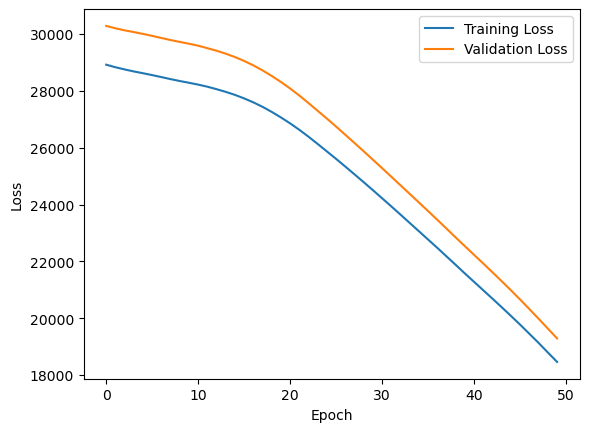

1/1 [==============================] - 0s 382ms/step


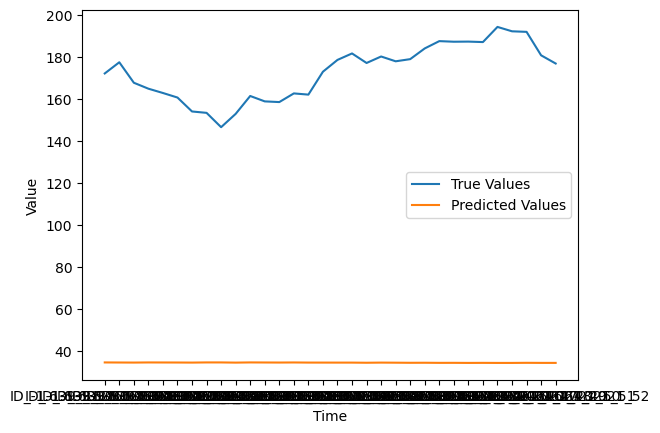

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -1.203_31.397
Epoch 1/50
3/3 [==============================] - 3s 240ms/step - loss: 81141.9375 - mse: 81141.9375 - accuracy: 0.0000e+00 - val_loss: 82743.2344 - val_mse: 82743.2344 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 32ms/step - loss: 80943.2422 - mse: 80943.2422 - accuracy: 0.0000e+00 - val_loss: 82580.7812 - val_mse: 82580.7812 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 57ms/step - loss: 80789.3047 - mse: 80789.3047 - accuracy: 0.0000e+00 - val_loss: 82428.9297 - val_mse: 82428.9297 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 50ms/step - loss: 80642.0938 - mse: 80642.0938 - accuracy: 0.0000e+00 - val_loss: 82294.7500 - val_mse: 82294.7500 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 40ms/step - loss: 80509.0625 - mse: 80509.0625 - accuracy: 0.0000e+00 - val_loss:

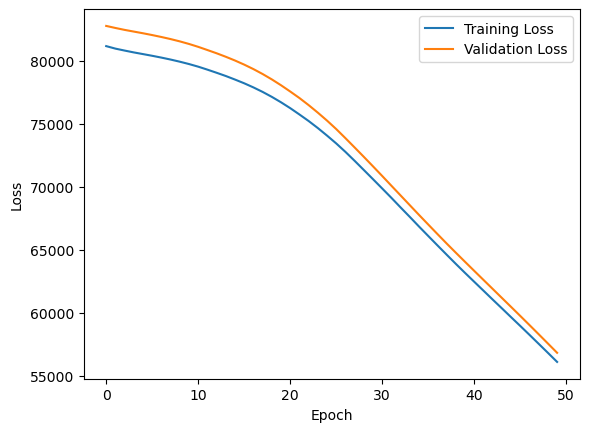

1/1 [==============================] - 0s 319ms/step


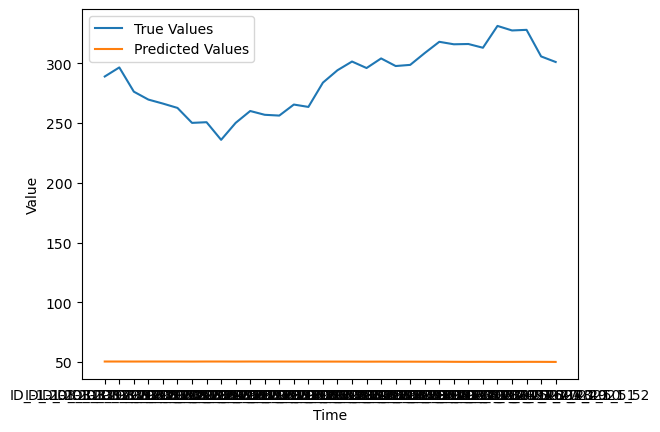

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -2.589_28.311
Epoch 1/50
3/3 [==============================] - 2s 204ms/step - loss: 0.2888 - mse: 0.2888 - accuracy: 0.0000e+00 - val_loss: 0.2428 - val_mse: 0.2428 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 34ms/step - loss: 0.0958 - mse: 0.0958 - accuracy: 0.0000e+00 - val_loss: 0.0625 - val_mse: 0.0625 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 40ms/step - loss: 0.0170 - mse: 0.0170 - accuracy: 0.0000e+00 - val_loss: 0.0056 - val_mse: 0.0056 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 36ms/step - loss: 0.0285 - mse: 0.0285 - accuracy: 0.0000e+00 - val_loss: 0.0065 - val_mse: 0.0065 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 37ms/step - loss: 0.0445 - mse: 0.0445 - accuracy: 0.0000e+00 - val_loss: 0.0044 - val_mse: 0.0044 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

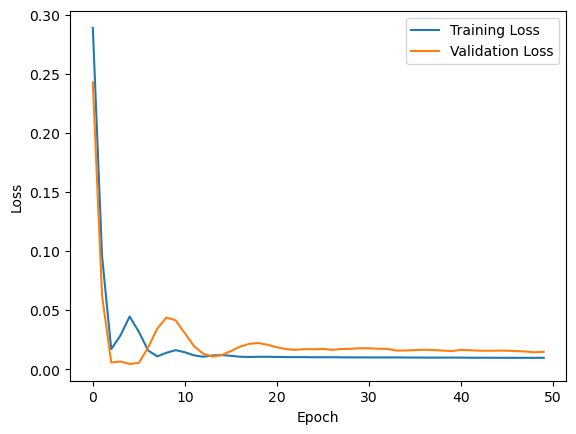

1/1 [==============================] - 0s 301ms/step


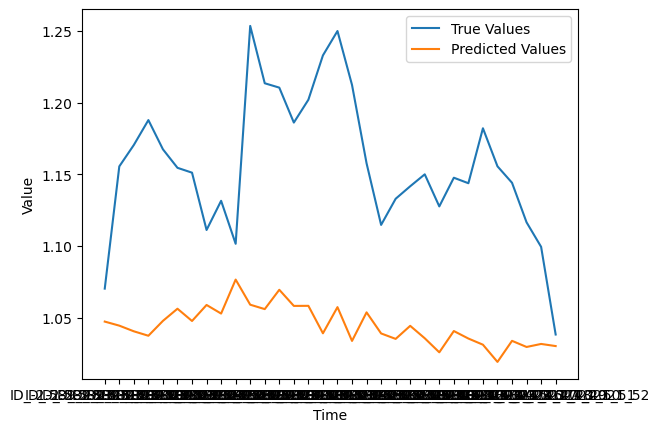

(49, 67)
2/2 [==============================] - 0s 9ms/step
LAT_LONG:  -2.712_29.488
Epoch 1/50
3/3 [==============================] - 2s 248ms/step - loss: 2152.5054 - mse: 2152.5054 - accuracy: 0.0000e+00 - val_loss: 2262.9302 - val_mse: 2262.9302 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 42ms/step - loss: 2132.9026 - mse: 2132.9026 - accuracy: 0.0000e+00 - val_loss: 2239.5728 - val_mse: 2239.5728 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 41ms/step - loss: 2108.7759 - mse: 2108.7759 - accuracy: 0.0000e+00 - val_loss: 2213.0342 - val_mse: 2213.0342 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 37ms/step - loss: 2082.7920 - mse: 2082.7920 - accuracy: 0.0000e+00 - val_loss: 2186.0576 - val_mse: 2186.0576 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 36ms/step - loss: 2056.8042 - mse: 2056.8042 - accuracy: 0.0000e+00 - val_loss: 2159.1152 - val_m

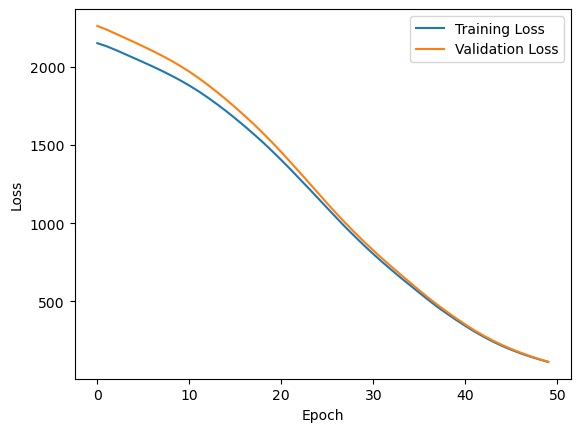

1/1 [==============================] - 1s 578ms/step


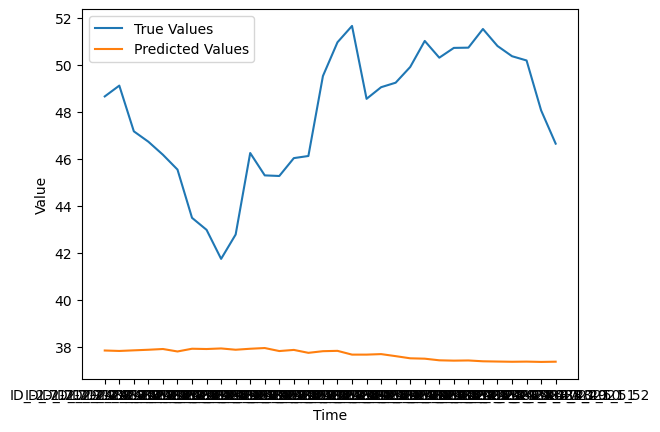

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -1.51_29.89
Epoch 1/50
3/3 [==============================] - 3s 468ms/step - loss: 32732.0566 - mse: 32732.0566 - accuracy: 0.0000e+00 - val_loss: 34672.9219 - val_mse: 34672.9219 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 60ms/step - loss: 32605.3848 - mse: 32605.3867 - accuracy: 0.0000e+00 - val_loss: 34538.6641 - val_mse: 34538.6641 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 51ms/step - loss: 32471.9668 - mse: 32471.9668 - accuracy: 0.0000e+00 - val_loss: 34397.1562 - val_mse: 34397.1562 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 34ms/step - loss: 32334.0078 - mse: 32334.0078 - accuracy: 0.0000e+00 - val_loss: 34255.4688 - val_mse: 34255.4688 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 34ms/step - loss: 32199.0117 - mse: 32199.0117 - accuracy: 0.0000e+00 - val_loss: 3

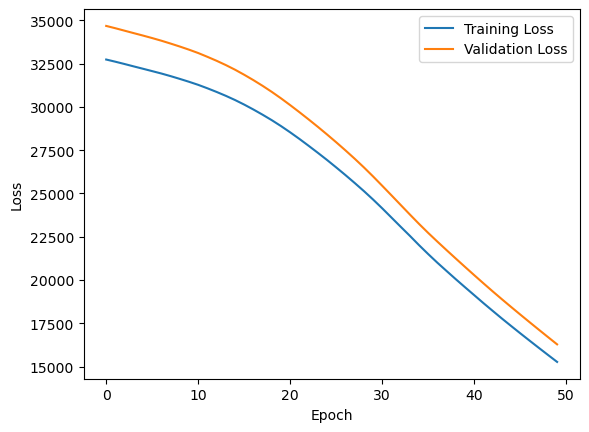

1/1 [==============================] - 0s 333ms/step


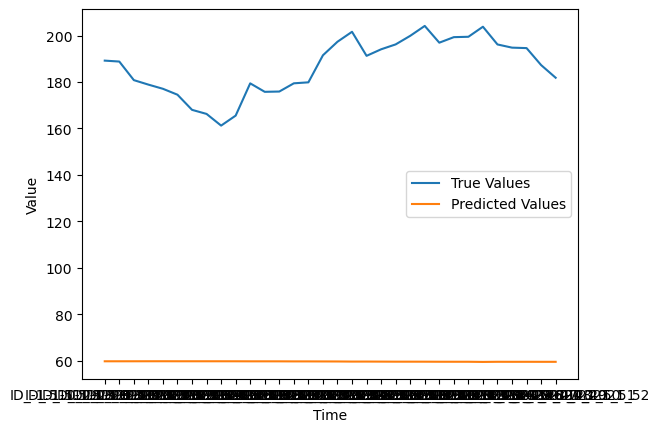

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -3.136_30.364
Epoch 1/50
3/3 [==============================] - 2s 258ms/step - loss: 272.0828 - mse: 272.0828 - accuracy: 0.0000e+00 - val_loss: 288.2305 - val_mse: 288.2305 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 84ms/step - loss: 259.8546 - mse: 259.8546 - accuracy: 0.0000e+00 - val_loss: 276.6884 - val_mse: 276.6884 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 80ms/step - loss: 249.7308 - mse: 249.7308 - accuracy: 0.0000e+00 - val_loss: 267.0037 - val_mse: 267.0037 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 94ms/step - loss: 240.2513 - mse: 240.2513 - accuracy: 0.0000e+00 - val_loss: 257.1622 - val_mse: 257.1622 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 52ms/step - loss: 231.6513 - mse: 231.6513 - accuracy: 0.0000e+00 - val_loss: 248.7065 - val_mse: 248.7065 - val_

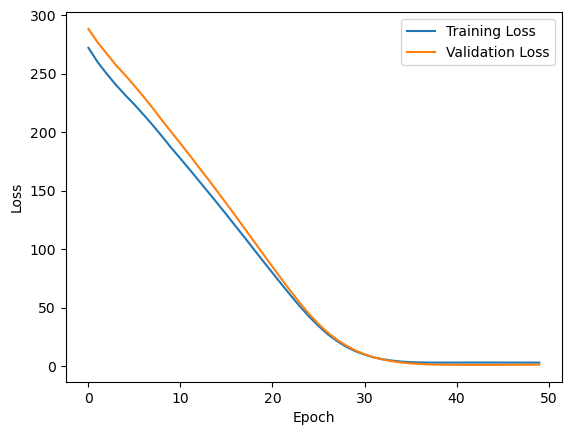

1/1 [==============================] - 0s 437ms/step


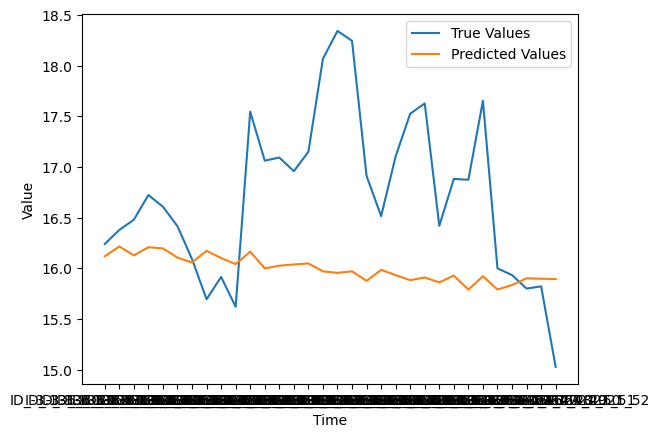

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.429_30.171
Epoch 1/50
3/3 [==============================] - 2s 425ms/step - loss: 13335.3975 - mse: 13335.3975 - accuracy: 0.0000e+00 - val_loss: 13877.3398 - val_mse: 13877.3398 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 37ms/step - loss: 13278.2441 - mse: 13278.2441 - accuracy: 0.0000e+00 - val_loss: 13820.0010 - val_mse: 13820.0010 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 33ms/step - loss: 13222.5664 - mse: 13222.5664 - accuracy: 0.0000e+00 - val_loss: 13762.8457 - val_mse: 13762.8457 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 53ms/step - loss: 13167.0361 - mse: 13167.0361 - accuracy: 0.0000e+00 - val_loss: 13706.2764 - val_mse: 13706.2764 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 34ms/step - loss: 13112.2559 - mse: 13112.2559 - accuracy: 0.0000e+00 - val_loss:

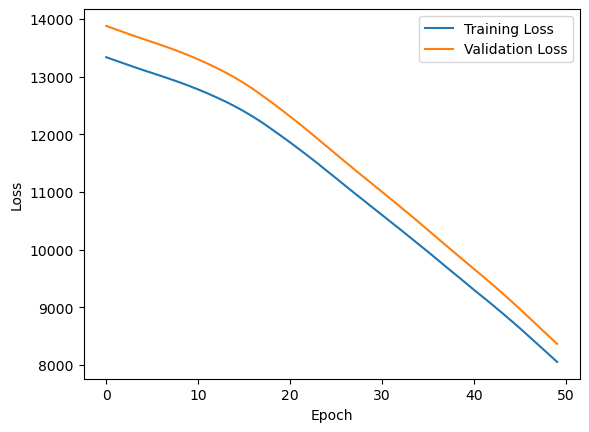

1/1 [==============================] - 1s 820ms/step


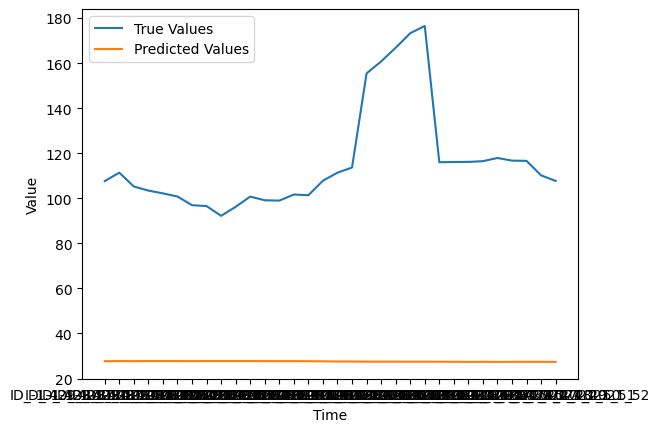

(49, 67)
2/2 [==============================] - 0s 9ms/step
LAT_LONG:  -1.211_30.389
Epoch 1/50
3/3 [==============================] - 2s 230ms/step - loss: 23353.9883 - mse: 23353.9883 - accuracy: 0.0000e+00 - val_loss: 24182.4922 - val_mse: 24182.4922 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 53ms/step - loss: 23311.3477 - mse: 23311.3477 - accuracy: 0.0000e+00 - val_loss: 24155.3027 - val_mse: 24155.3027 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 38ms/step - loss: 23289.6094 - mse: 23289.6094 - accuracy: 0.0000e+00 - val_loss: 24138.0332 - val_mse: 24138.0332 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 57ms/step - loss: 23273.9297 - mse: 23273.9297 - accuracy: 0.0000e+00 - val_loss: 24123.4688 - val_mse: 24123.4688 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 86ms/step - loss: 23259.5137 - mse: 23259.5137 - accuracy: 0.0000e+00 - val_loss:

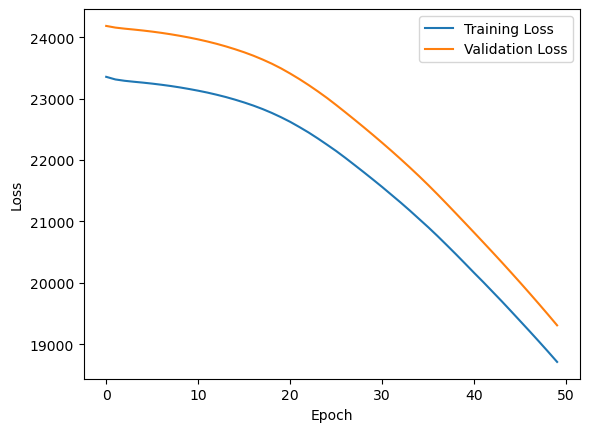

1/1 [==============================] - 0s 391ms/step


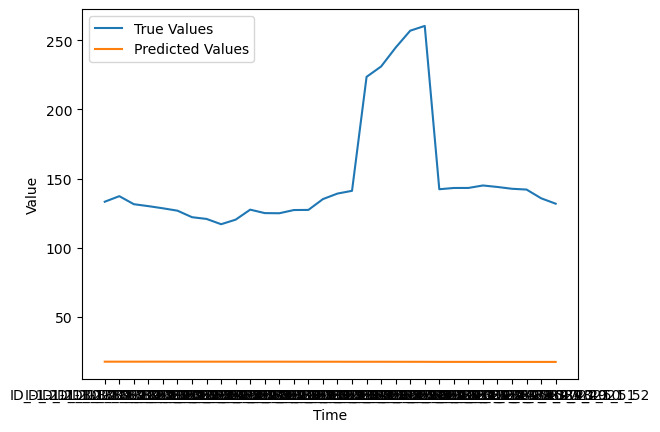

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.125_30.375
Epoch 1/50
3/3 [==============================] - 2s 251ms/step - loss: 13543.8066 - mse: 13543.8066 - accuracy: 0.0000e+00 - val_loss: 13048.9688 - val_mse: 13048.9688 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 44ms/step - loss: 13475.4668 - mse: 13475.4668 - accuracy: 0.0000e+00 - val_loss: 12991.8213 - val_mse: 12991.8213 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 45ms/step - loss: 13420.5605 - mse: 13420.5605 - accuracy: 0.0000e+00 - val_loss: 12945.7871 - val_mse: 12945.7871 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 31ms/step - loss: 13374.3662 - mse: 13374.3662 - accuracy: 0.0000e+00 - val_loss: 12899.7754 - val_mse: 12899.7754 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 34ms/step - loss: 13327.2715 - mse: 13327.2715 - accuracy: 0.0000e+00 - val_loss:

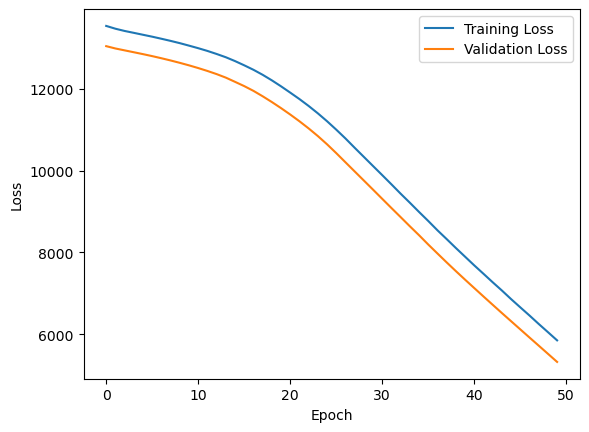

1/1 [==============================] - 0s 313ms/step


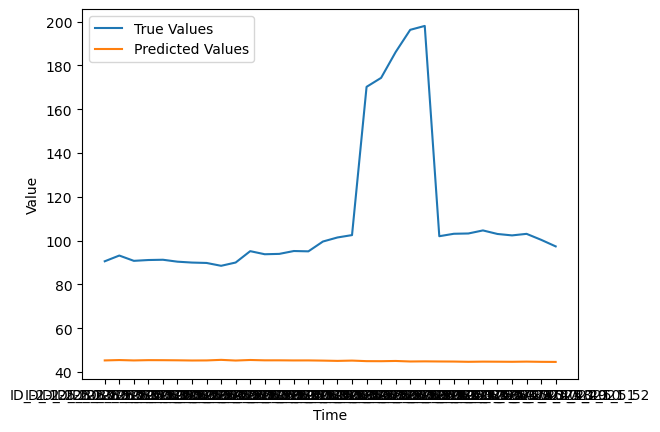

(49, 67)
2/2 [==============================] - 0s 11ms/step
LAT_LONG:  -0.965_29.735
Epoch 1/50
3/3 [==============================] - 3s 212ms/step - loss: 1208.1793 - mse: 1208.1793 - accuracy: 0.0000e+00 - val_loss: 1269.6437 - val_mse: 1269.6437 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 1189.6368 - mse: 1189.6368 - accuracy: 0.0000e+00 - val_loss: 1250.1787 - val_mse: 1250.1787 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 32ms/step - loss: 1170.7418 - mse: 1170.7418 - accuracy: 0.0000e+00 - val_loss: 1230.4368 - val_mse: 1230.4368 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 1151.6522 - mse: 1151.6522 - accuracy: 0.0000e+00 - val_loss: 1210.4878 - val_mse: 1210.4878 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 32ms/step - loss: 1132.2020 - mse: 1132.2020 - accuracy: 0.0000e+00 - val_loss: 1189.9734 - val_

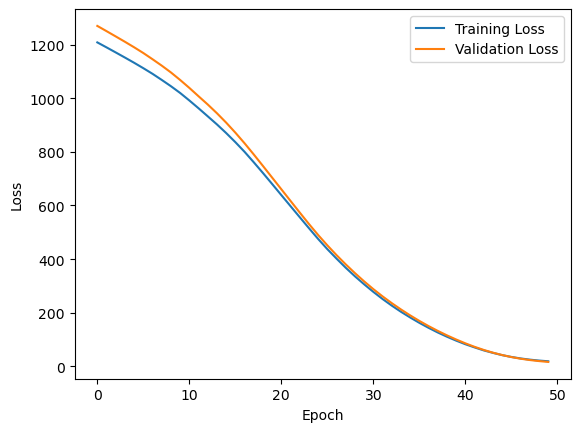

1/1 [==============================] - 0s 326ms/step


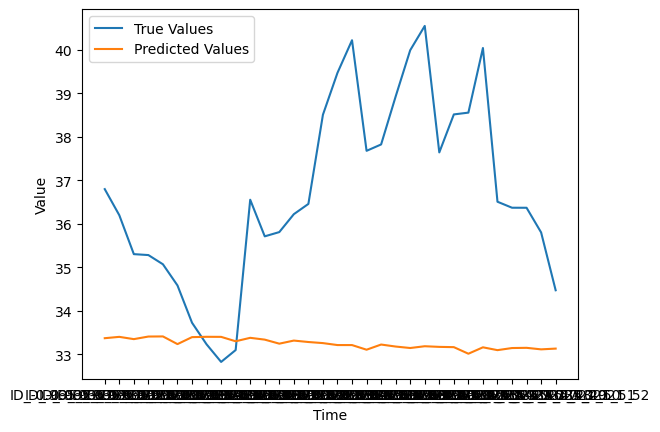

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.346_31.254
Epoch 1/50
3/3 [==============================] - 2s 209ms/step - loss: 227959.8438 - mse: 227959.8438 - accuracy: 0.0000e+00 - val_loss: 234758.1250 - val_mse: 234758.1250 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 43ms/step - loss: 227636.5000 - mse: 227636.5000 - accuracy: 0.0000e+00 - val_loss: 234437.4375 - val_mse: 234437.4375 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 227322.6562 - mse: 227322.6562 - accuracy: 0.0000e+00 - val_loss: 234109.7188 - val_mse: 234109.7188 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 31ms/step - loss: 226998.9844 - mse: 226998.9844 - accuracy: 0.0000e+00 - val_loss: 233767.8125 - val_mse: 233767.8125 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 32ms/step - loss: 226659.7969 - mse: 226659.7969 - accuracy: 0.00

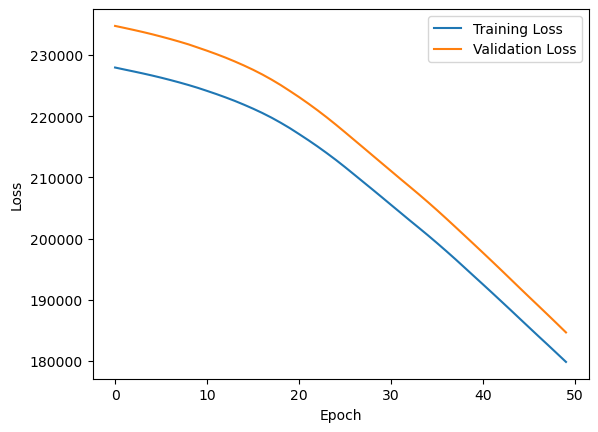

1/1 [==============================] - 0s 299ms/step


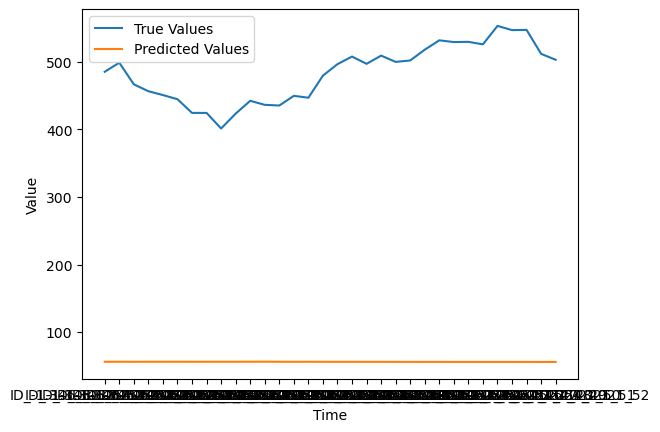

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.808_29.892
Epoch 1/50
3/3 [==============================] - 5s 706ms/step - loss: 12750.3994 - mse: 12750.3994 - accuracy: 0.0000e+00 - val_loss: 13048.8887 - val_mse: 13048.8887 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 53ms/step - loss: 12644.9111 - mse: 12644.9111 - accuracy: 0.0000e+00 - val_loss: 12946.2148 - val_mse: 12946.2148 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 48ms/step - loss: 12552.9785 - mse: 12552.9785 - accuracy: 0.0000e+00 - val_loss: 12865.2910 - val_mse: 12865.2910 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 52ms/step - loss: 12476.9521 - mse: 12476.9521 - accuracy: 0.0000e+00 - val_loss: 12791.8467 - val_mse: 12791.8467 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 46ms/step - loss: 12407.0537 - mse: 12407.0537 - accuracy: 0.0000e+00 - val_loss:

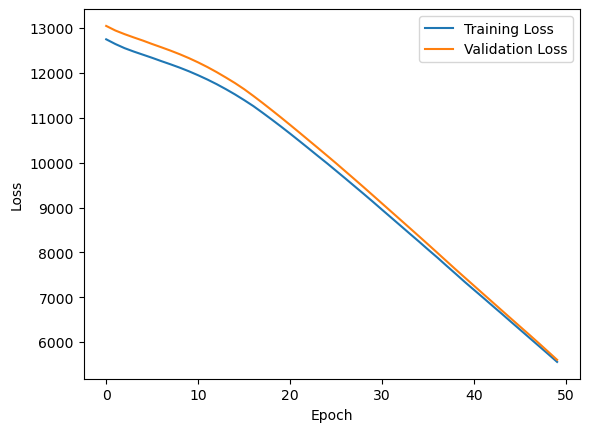

1/1 [==============================] - 1s 680ms/step


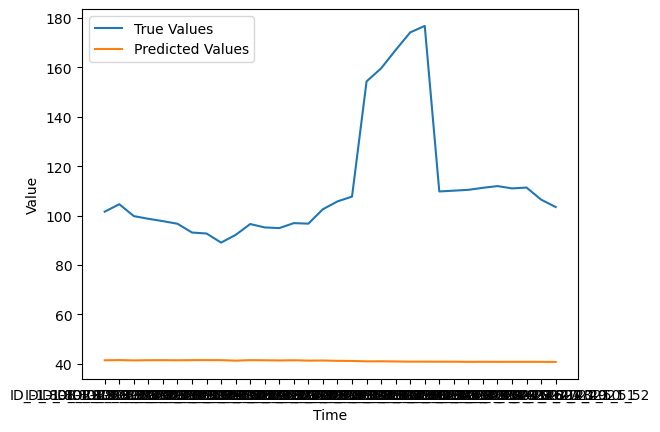

(49, 67)
2/2 [==============================] - 2s 12ms/step
LAT_LONG:  -2.018_28.882
Epoch 1/50
3/3 [==============================] - 2s 220ms/step - loss: 8.6942 - mse: 8.6942 - accuracy: 0.0000e+00 - val_loss: 5.9526 - val_mse: 5.9526 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 32ms/step - loss: 7.4308 - mse: 7.4308 - accuracy: 0.0000e+00 - val_loss: 5.0078 - val_mse: 5.0078 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 6.4415 - mse: 6.4415 - accuracy: 0.0000e+00 - val_loss: 4.1644 - val_mse: 4.1644 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 36ms/step - loss: 5.5570 - mse: 5.5570 - accuracy: 0.0000e+00 - val_loss: 3.4153 - val_mse: 3.4153 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 35ms/step - loss: 4.7711 - mse: 4.7711 - accuracy: 0.0000e+00 - val_loss: 2.7394 - val_mse: 2.7394 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [==

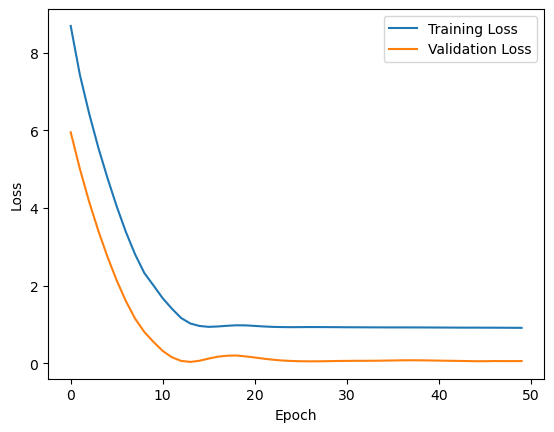

1/1 [==============================] - 0s 353ms/step


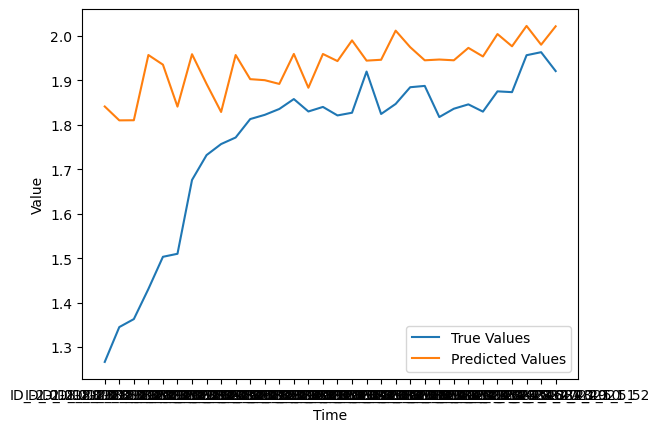

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.766_30.734
Epoch 1/50
3/3 [==============================] - 2s 224ms/step - loss: 0.1130 - mse: 0.1130 - accuracy: 0.0000e+00 - val_loss: 0.0642 - val_mse: 0.0642 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 65ms/step - loss: 0.0612 - mse: 0.0612 - accuracy: 0.0000e+00 - val_loss: 0.0757 - val_mse: 0.0757 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 38ms/step - loss: 0.0753 - mse: 0.0753 - accuracy: 0.0000e+00 - val_loss: 0.0654 - val_mse: 0.0654 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 35ms/step - loss: 0.0602 - mse: 0.0602 - accuracy: 0.0000e+00 - val_loss: 0.0601 - val_mse: 0.0601 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 0.0531 - mse: 0.0531 - accuracy: 0.0000e+00 - val_loss: 0.0704 - val_mse: 0.0704 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

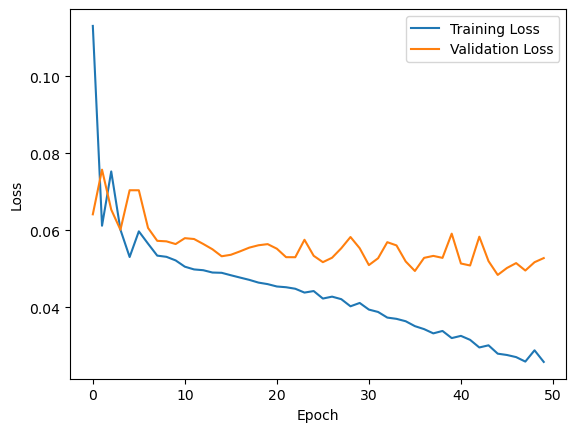

1/1 [==============================] - 0s 379ms/step


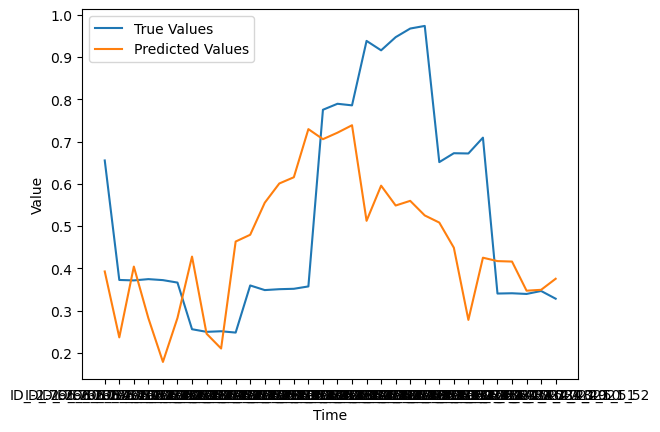

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -1.4_30.0
Epoch 1/50
3/3 [==============================] - 3s 213ms/step - loss: 13977.5156 - mse: 13977.5156 - accuracy: 0.0000e+00 - val_loss: 14387.4102 - val_mse: 14387.4102 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 35ms/step - loss: 13919.4912 - mse: 13919.4912 - accuracy: 0.0000e+00 - val_loss: 14334.0625 - val_mse: 14334.0625 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 33ms/step - loss: 13868.3232 - mse: 13868.3232 - accuracy: 0.0000e+00 - val_loss: 14284.5840 - val_mse: 14284.5840 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 37ms/step - loss: 13821.9736 - mse: 13821.9736 - accuracy: 0.0000e+00 - val_loss: 14240.6680 - val_mse: 14240.6680 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 36ms/step - loss: 13779.4238 - mse: 13779.4238 - accuracy: 0.0000e+00 - val_loss: 141

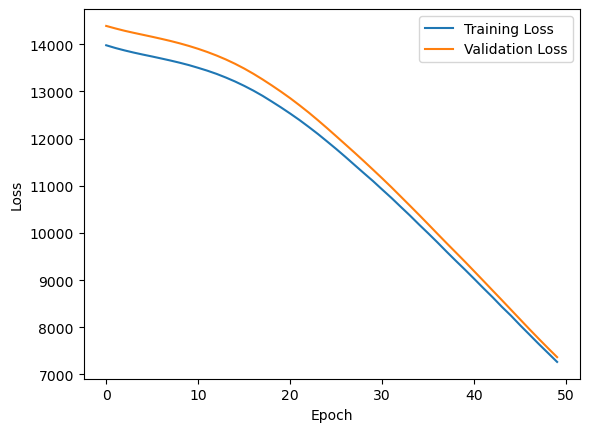

1/1 [==============================] - 0s 327ms/step


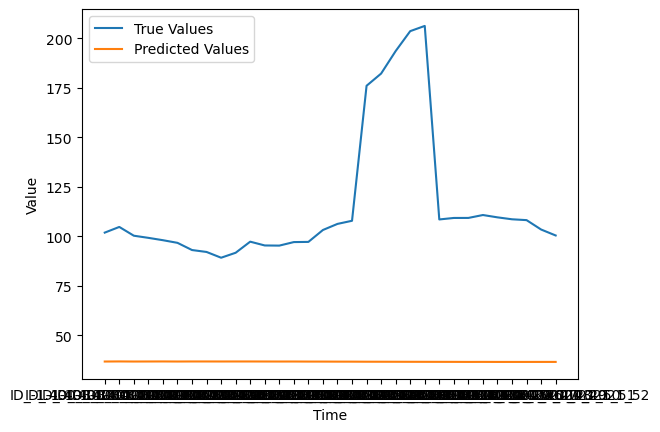

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.597_29.603
Epoch 1/50
3/3 [==============================] - 3s 222ms/step - loss: 13096.6768 - mse: 13096.6768 - accuracy: 0.0000e+00 - val_loss: 13575.6074 - val_mse: 13575.6074 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 13008.1484 - mse: 13008.1484 - accuracy: 0.0000e+00 - val_loss: 13487.6123 - val_mse: 13487.6123 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 35ms/step - loss: 12922.5869 - mse: 12922.5869 - accuracy: 0.0000e+00 - val_loss: 13404.0127 - val_mse: 13404.0127 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 34ms/step - loss: 12843.6973 - mse: 12843.6973 - accuracy: 0.0000e+00 - val_loss: 13331.6143 - val_mse: 13331.6143 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 32ms/step - loss: 12778.1377 - mse: 12778.1377 - accuracy: 0.0000e+00 - val_loss:

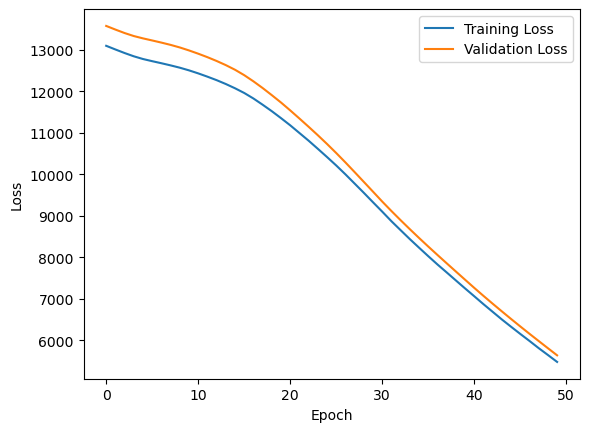

1/1 [==============================] - 0s 359ms/step


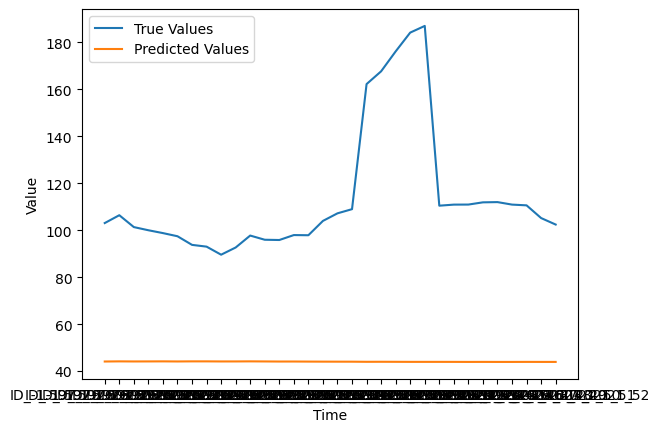

(49, 67)
2/2 [==============================] - 1s 7ms/step
LAT_LONG:  -0.598_29.102
Epoch 1/50
3/3 [==============================] - 2s 239ms/step - loss: 0.1942 - mse: 0.1942 - accuracy: 0.0000e+00 - val_loss: 0.0865 - val_mse: 0.0865 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 37ms/step - loss: 0.0645 - mse: 0.0645 - accuracy: 0.0000e+00 - val_loss: 0.0162 - val_mse: 0.0162 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 41ms/step - loss: 0.0100 - mse: 0.0100 - accuracy: 0.0000e+00 - val_loss: 0.0030 - val_mse: 0.0030 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 35ms/step - loss: 0.0056 - mse: 0.0056 - accuracy: 0.0000e+00 - val_loss: 0.0120 - val_mse: 0.0120 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 36ms/step - loss: 0.0140 - mse: 0.0140 - accuracy: 0.0000e+00 - val_loss: 0.0152 - val_mse: 0.0152 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

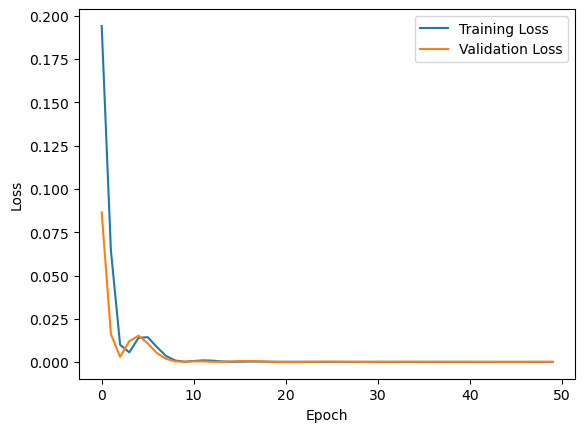

1/1 [==============================] - 1s 1s/step


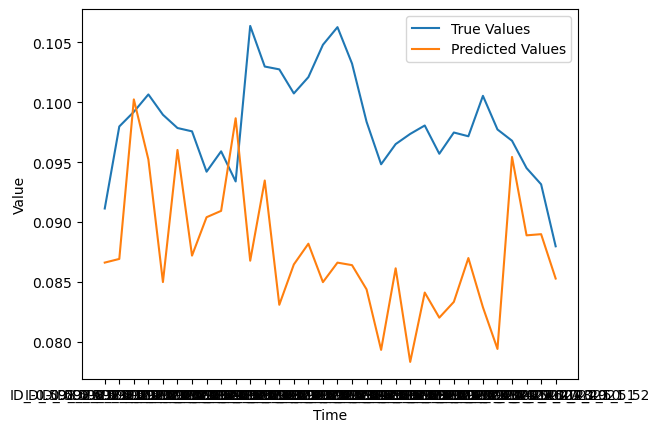

(49, 67)
2/2 [==============================] - 1s 6ms/step
LAT_LONG:  -1.413_30.287
Epoch 1/50
3/3 [==============================] - 3s 254ms/step - loss: 22801.3887 - mse: 22801.3887 - accuracy: 0.0000e+00 - val_loss: 23419.9102 - val_mse: 23419.9102 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 54ms/step - loss: 22710.4746 - mse: 22710.4746 - accuracy: 0.0000e+00 - val_loss: 23329.8672 - val_mse: 23329.8672 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 39ms/step - loss: 22625.6465 - mse: 22625.6465 - accuracy: 0.0000e+00 - val_loss: 23250.4688 - val_mse: 23250.4688 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 38ms/step - loss: 22548.9316 - mse: 22548.9316 - accuracy: 0.0000e+00 - val_loss: 23173.7441 - val_mse: 23173.7441 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 41ms/step - loss: 22474.8984 - mse: 22474.8984 - accuracy: 0.0000e+00 - val_loss:

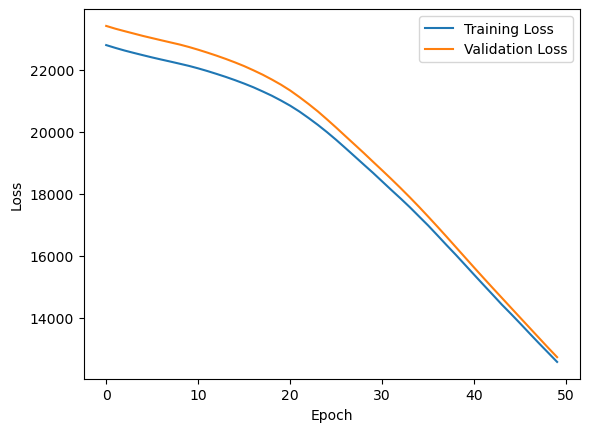

1/1 [==============================] - 0s 483ms/step


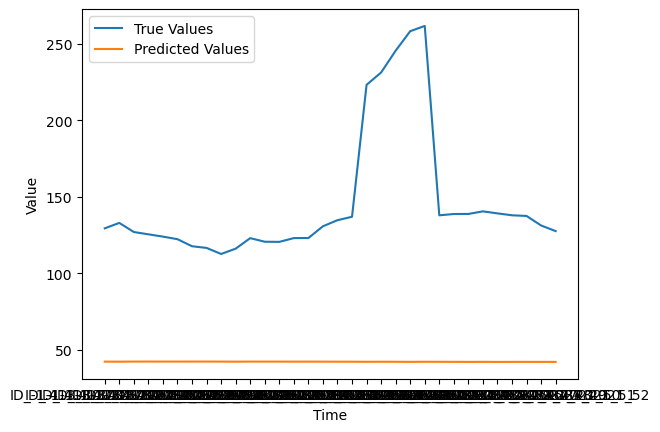

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.143_30.957
Epoch 1/50
3/3 [==============================] - 2s 221ms/step - loss: 117.2422 - mse: 117.2422 - accuracy: 0.0000e+00 - val_loss: 127.7958 - val_mse: 127.7958 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 36ms/step - loss: 110.2727 - mse: 110.2727 - accuracy: 0.0000e+00 - val_loss: 120.8299 - val_mse: 120.8299 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 34ms/step - loss: 104.2297 - mse: 104.2297 - accuracy: 0.0000e+00 - val_loss: 115.3159 - val_mse: 115.3159 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 31ms/step - loss: 99.9404 - mse: 99.9404 - accuracy: 0.0000e+00 - val_loss: 111.2034 - val_mse: 111.2034 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 32ms/step - loss: 96.2614 - mse: 96.2614 - accuracy: 0.0000e+00 - val_loss: 107.1515 - val_mse: 107.1515 - val_accu

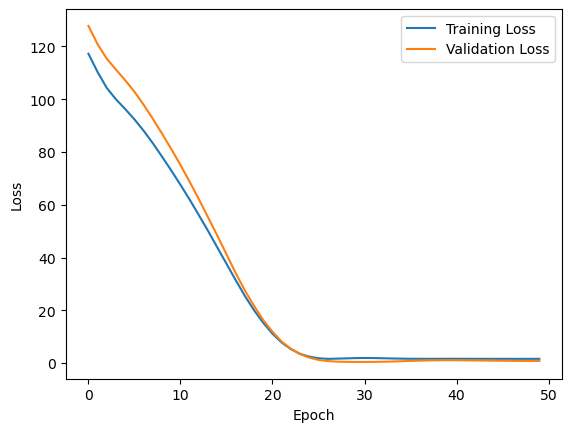

1/1 [==============================] - 0s 306ms/step


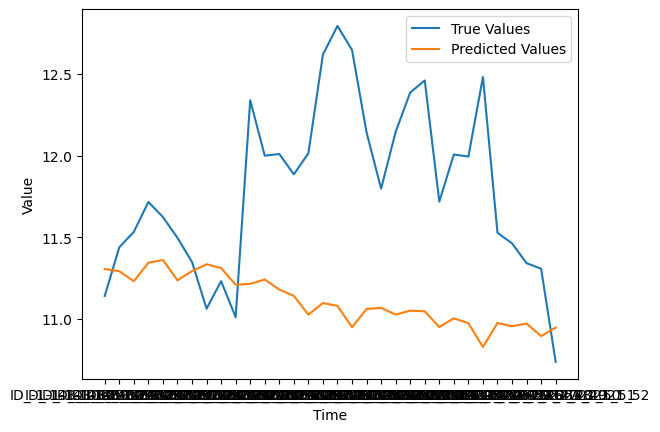

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.792_30.408
Epoch 1/50
3/3 [==============================] - 4s 352ms/step - loss: 4355.5503 - mse: 4355.5503 - accuracy: 0.0000e+00 - val_loss: 2810.9343 - val_mse: 2810.9343 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 35ms/step - loss: 4315.4917 - mse: 4315.4917 - accuracy: 0.0000e+00 - val_loss: 2783.1477 - val_mse: 2783.1477 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 64ms/step - loss: 4284.6221 - mse: 4284.6221 - accuracy: 0.0000e+00 - val_loss: 2754.7197 - val_mse: 2754.7197 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 36ms/step - loss: 4252.6113 - mse: 4252.6113 - accuracy: 0.0000e+00 - val_loss: 2725.2302 - val_mse: 2725.2302 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 34ms/step - loss: 4219.1279 - mse: 4219.1279 - accuracy: 0.0000e+00 - val_loss: 2693.7114 - val_m

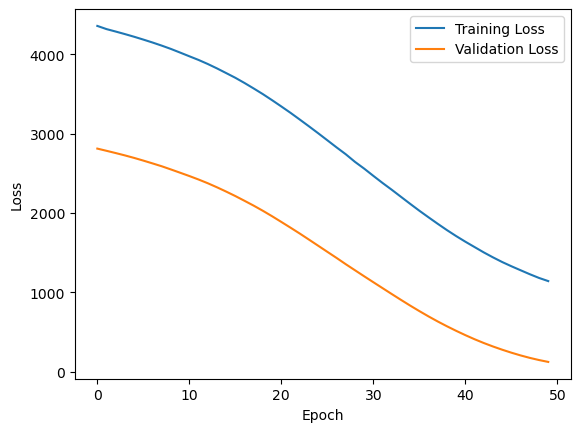

1/1 [==============================] - 0s 310ms/step


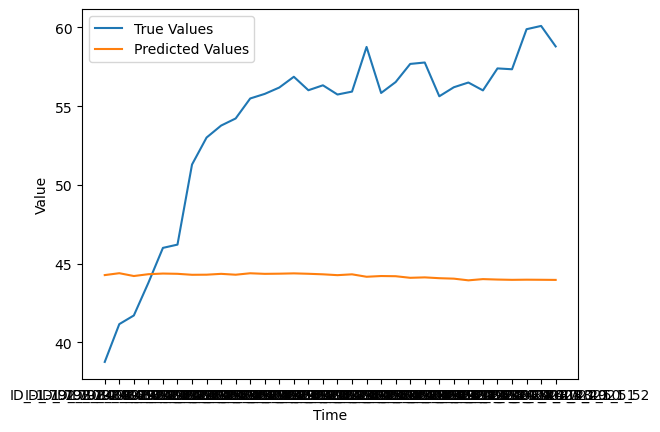

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -2.262_30.838
Epoch 1/50
3/3 [==============================] - 3s 334ms/step - loss: 846.5715 - mse: 846.5715 - accuracy: 0.0000e+00 - val_loss: 811.5975 - val_mse: 811.5975 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 45ms/step - loss: 835.9377 - mse: 835.9377 - accuracy: 0.0000e+00 - val_loss: 801.6186 - val_mse: 801.6186 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 70ms/step - loss: 826.1406 - mse: 826.1406 - accuracy: 0.0000e+00 - val_loss: 791.7336 - val_mse: 791.7336 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 35ms/step - loss: 816.5654 - mse: 816.5654 - accuracy: 0.0000e+00 - val_loss: 782.0909 - val_mse: 782.0909 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 47ms/step - loss: 806.7745 - mse: 806.7745 - accuracy: 0.0000e+00 - val_loss: 772.3039 - val_mse: 772.3039 - val_

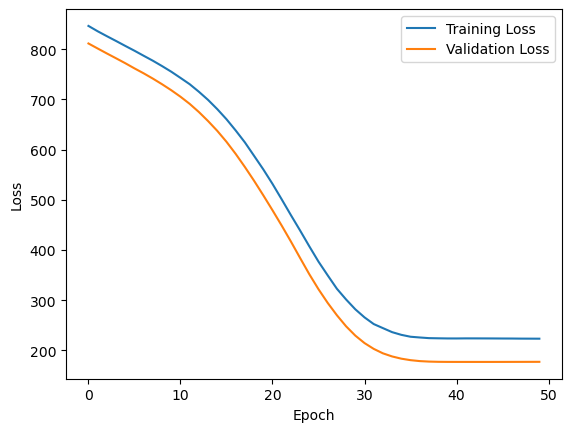

1/1 [==============================] - 0s 381ms/step


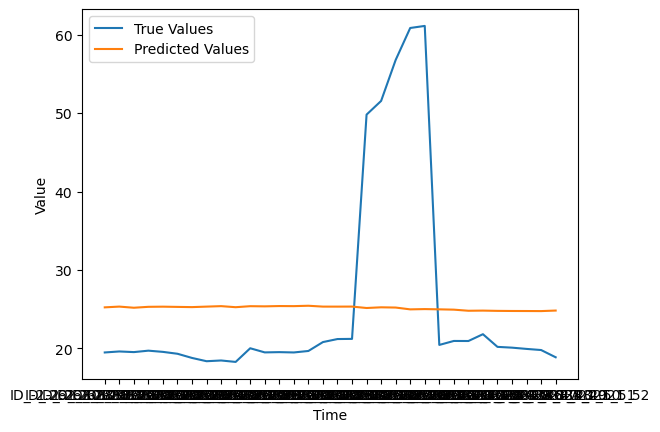

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -0.801_29.499
Epoch 1/50
3/3 [==============================] - 2s 250ms/step - loss: 0.0172 - mse: 0.0172 - accuracy: 0.0000e+00 - val_loss: 0.0050 - val_mse: 0.0050 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 36ms/step - loss: 0.0129 - mse: 0.0129 - accuracy: 0.0000e+00 - val_loss: 0.0020 - val_mse: 0.0020 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 38ms/step - loss: 0.0035 - mse: 0.0035 - accuracy: 0.0000e+00 - val_loss: 0.0071 - val_mse: 0.0071 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 36ms/step - loss: 0.0046 - mse: 0.0046 - accuracy: 0.0000e+00 - val_loss: 0.0091 - val_mse: 0.0091 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 47ms/step - loss: 0.0037 - mse: 0.0037 - accuracy: 0.0000e+00 - val_loss: 0.0022 - val_mse: 0.0022 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

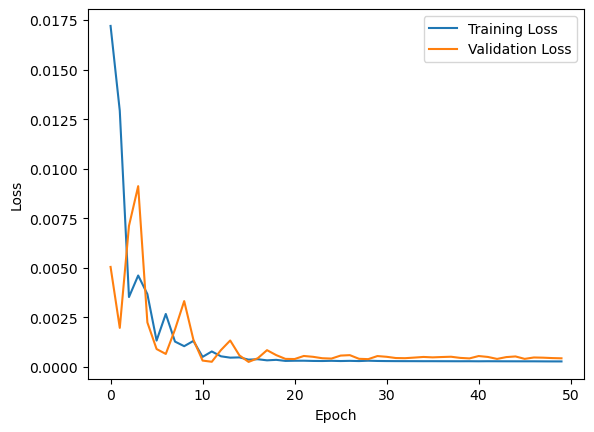

1/1 [==============================] - 0s 307ms/step


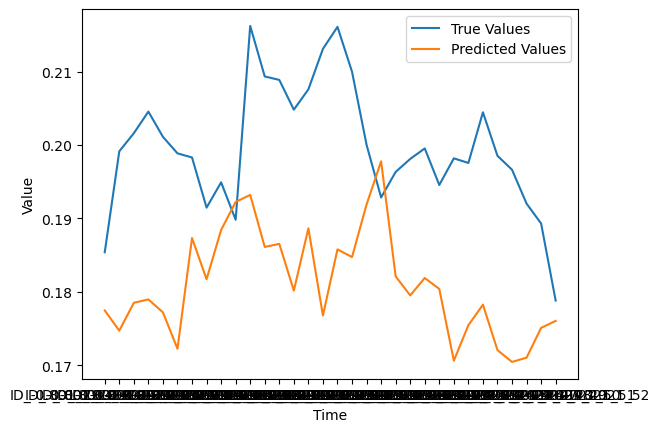

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -0.986_30.214
Epoch 1/50
3/3 [==============================] - 3s 235ms/step - loss: 29.7223 - mse: 29.7223 - accuracy: 0.0000e+00 - val_loss: 28.9231 - val_mse: 28.9231 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 42ms/step - loss: 25.5446 - mse: 25.5446 - accuracy: 0.0000e+00 - val_loss: 24.7342 - val_mse: 24.7342 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 64ms/step - loss: 21.5925 - mse: 21.5925 - accuracy: 0.0000e+00 - val_loss: 20.7514 - val_mse: 20.7514 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 36ms/step - loss: 17.8548 - mse: 17.8548 - accuracy: 0.0000e+00 - val_loss: 17.1533 - val_mse: 17.1533 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 34ms/step - loss: 14.5731 - mse: 14.5732 - accuracy: 0.0000e+00 - val_loss: 13.9756 - val_mse: 13.9756 - val_accuracy: 0.0000e+00

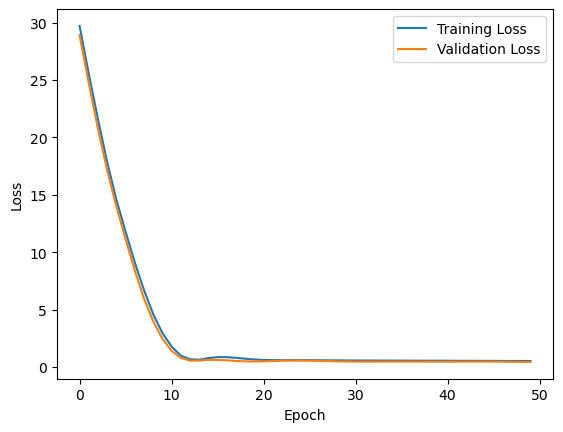

1/1 [==============================] - 0s 273ms/step


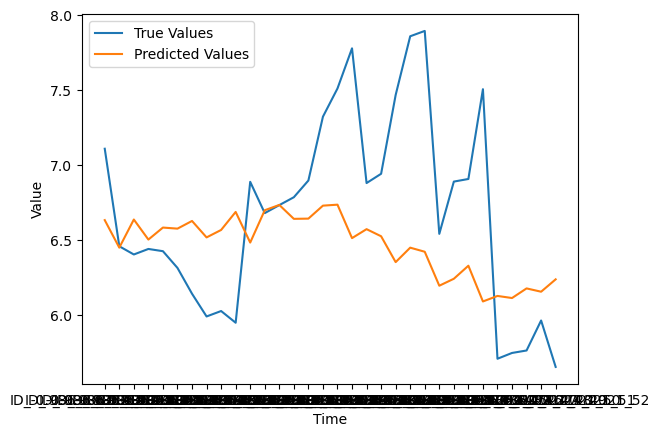

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.834_30.466
Epoch 1/50
3/3 [==============================] - 2s 225ms/step - loss: 1283.4838 - mse: 1283.4838 - accuracy: 0.0000e+00 - val_loss: 1371.6396 - val_mse: 1371.6396 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 48ms/step - loss: 1269.7037 - mse: 1269.7037 - accuracy: 0.0000e+00 - val_loss: 1359.8835 - val_mse: 1359.8835 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 36ms/step - loss: 1258.0930 - mse: 1258.0930 - accuracy: 0.0000e+00 - val_loss: 1347.2949 - val_mse: 1347.2949 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 1246.1339 - mse: 1246.1339 - accuracy: 0.0000e+00 - val_loss: 1335.8916 - val_mse: 1335.8916 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 1235.2070 - mse: 1235.2070 - accuracy: 0.0000e+00 - val_loss: 1324.5776 - val_m

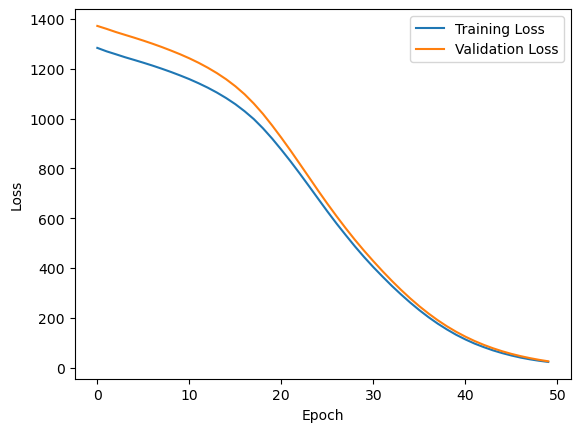

1/1 [==============================] - 0s 319ms/step


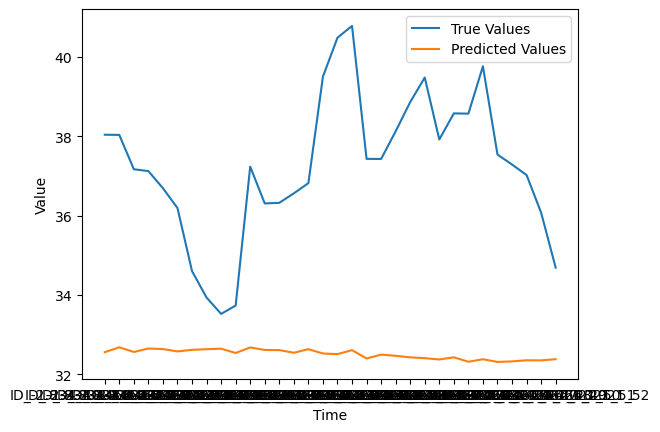

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -2.924_29.976
Epoch 1/50
3/3 [==============================] - 2s 231ms/step - loss: 6410.4038 - mse: 6410.4038 - accuracy: 0.0000e+00 - val_loss: 6934.1616 - val_mse: 6934.1616 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 6364.0405 - mse: 6364.0405 - accuracy: 0.0000e+00 - val_loss: 6889.3301 - val_mse: 6889.3301 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 6321.8550 - mse: 6321.8550 - accuracy: 0.0000e+00 - val_loss: 6842.0176 - val_mse: 6842.0176 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 6277.1655 - mse: 6277.1655 - accuracy: 0.0000e+00 - val_loss: 6804.1860 - val_mse: 6804.1860 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 70ms/step - loss: 6241.7026 - mse: 6241.7026 - accuracy: 0.0000e+00 - val_loss: 6767.3843 - val_m

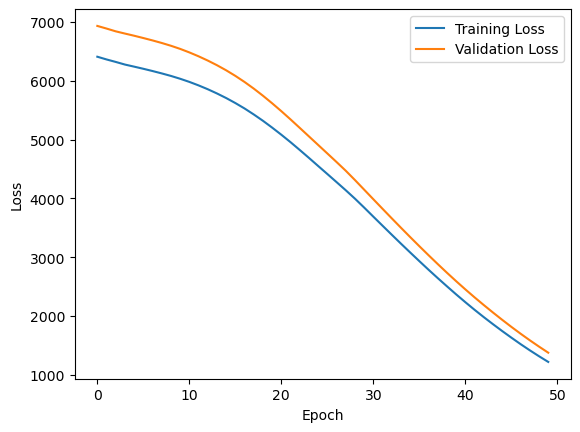

1/1 [==============================] - 0s 297ms/step


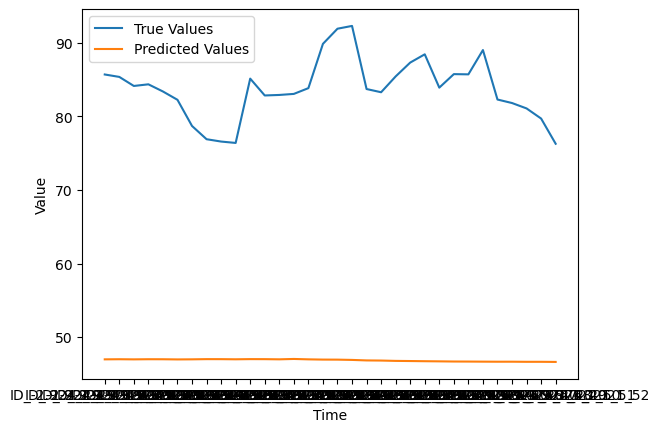

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -3.299_30.301
Epoch 1/50
3/3 [==============================] - 2s 200ms/step - loss: 803.5747 - mse: 803.5747 - accuracy: 0.0000e+00 - val_loss: 825.7095 - val_mse: 825.7095 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 785.7739 - mse: 785.7739 - accuracy: 0.0000e+00 - val_loss: 807.1600 - val_mse: 807.1600 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 767.7763 - mse: 767.7763 - accuracy: 0.0000e+00 - val_loss: 788.8596 - val_mse: 788.8596 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 31ms/step - loss: 750.0280 - mse: 750.0280 - accuracy: 0.0000e+00 - val_loss: 770.6721 - val_mse: 770.6721 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 36ms/step - loss: 732.8381 - mse: 732.8381 - accuracy: 0.0000e+00 - val_loss: 754.2979 - val_mse: 754.2979 - val_

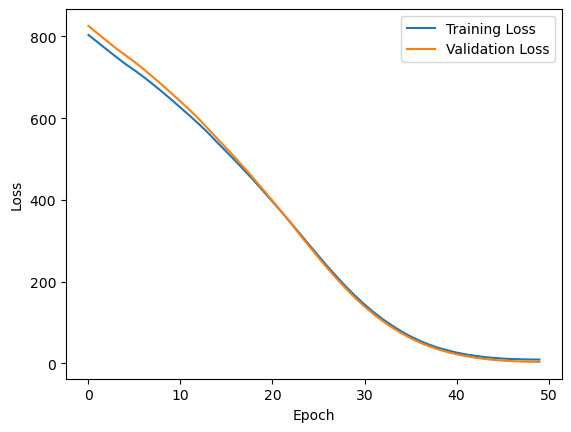

1/1 [==============================] - 0s 255ms/step


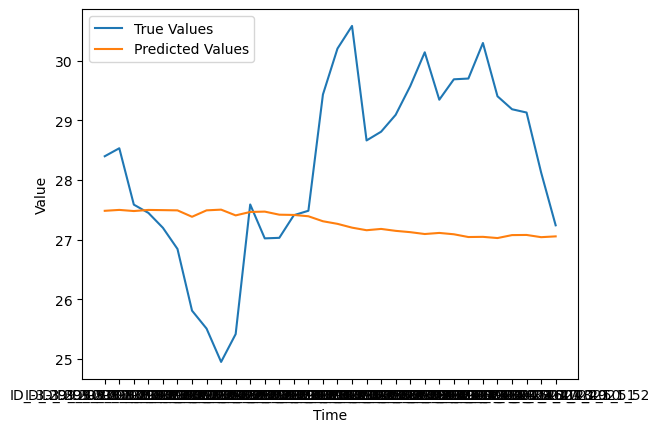

(49, 67)
2/2 [==============================] - 0s 18ms/step
LAT_LONG:  -2.302_29.198
Epoch 1/50
3/3 [==============================] - 2s 231ms/step - loss: 65428.9102 - mse: 65428.9141 - accuracy: 0.0000e+00 - val_loss: 68476.5781 - val_mse: 68476.5781 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 59ms/step - loss: 65319.8516 - mse: 65319.8516 - accuracy: 0.0000e+00 - val_loss: 68371.6328 - val_mse: 68371.6328 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 65214.0703 - mse: 65214.0703 - accuracy: 0.0000e+00 - val_loss: 68264.0469 - val_mse: 68264.0469 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 65110.3516 - mse: 65110.3516 - accuracy: 0.0000e+00 - val_loss: 68162.3906 - val_mse: 68162.3906 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 65009.3789 - mse: 65009.3789 - accuracy: 0.0000e+00 - val_loss

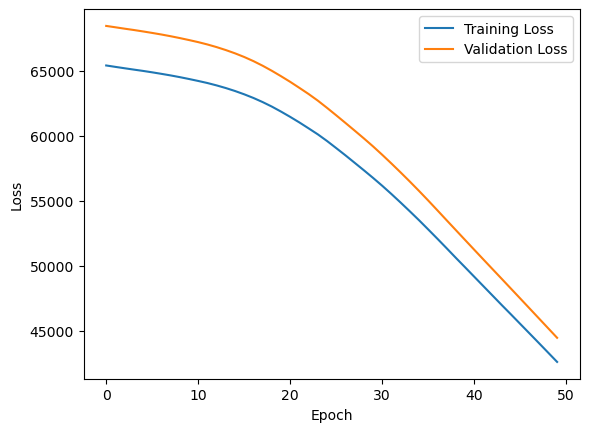

1/1 [==============================] - 0s 244ms/step


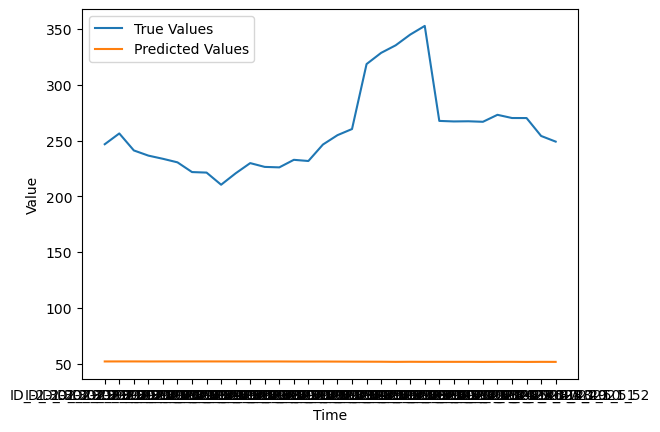

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.828_29.872
Epoch 1/50
3/3 [==============================] - 2s 206ms/step - loss: 2782.2678 - mse: 2782.2678 - accuracy: 0.0000e+00 - val_loss: 2946.5371 - val_mse: 2946.5371 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 2745.9121 - mse: 2745.9121 - accuracy: 0.0000e+00 - val_loss: 2911.5320 - val_mse: 2911.5320 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 2713.0088 - mse: 2713.0088 - accuracy: 0.0000e+00 - val_loss: 2879.3438 - val_mse: 2879.3438 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 2683.1921 - mse: 2683.1921 - accuracy: 0.0000e+00 - val_loss: 2850.6309 - val_mse: 2850.6309 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 2655.9983 - mse: 2655.9983 - accuracy: 0.0000e+00 - val_loss: 2824.6968 - val_m

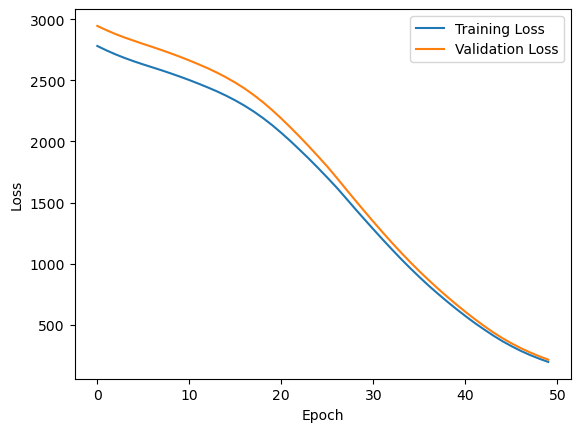

1/1 [==============================] - 0s 266ms/step


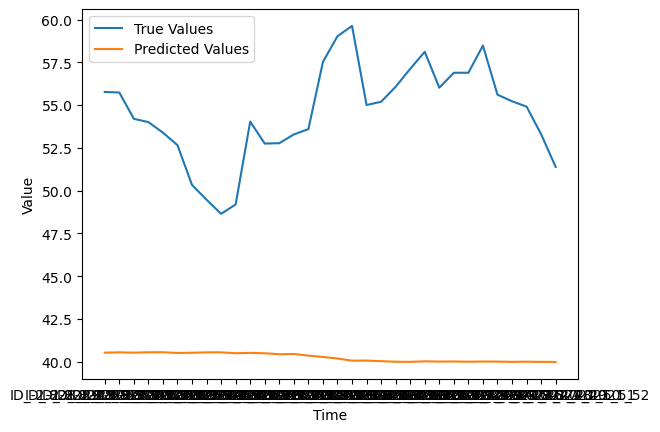

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.365_30.535
Epoch 1/50
3/3 [==============================] - 2s 187ms/step - loss: 4719.7759 - mse: 4719.7759 - accuracy: 0.0000e+00 - val_loss: 4531.8335 - val_mse: 4531.8335 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 4654.6846 - mse: 4654.6846 - accuracy: 0.0000e+00 - val_loss: 4468.8135 - val_mse: 4468.8135 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 4592.6602 - mse: 4592.6602 - accuracy: 0.0000e+00 - val_loss: 4412.2881 - val_mse: 4412.2881 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 4539.9043 - mse: 4539.9043 - accuracy: 0.0000e+00 - val_loss: 4365.4355 - val_mse: 4365.4355 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 4494.3945 - mse: 4494.3945 - accuracy: 0.0000e+00 - val_loss: 4324.3027 - val_m

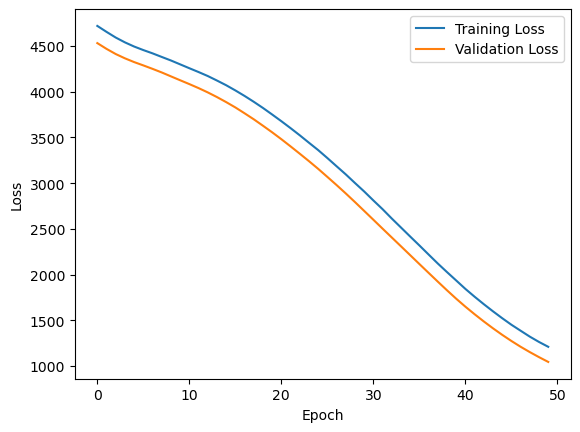

1/1 [==============================] - 0s 273ms/step


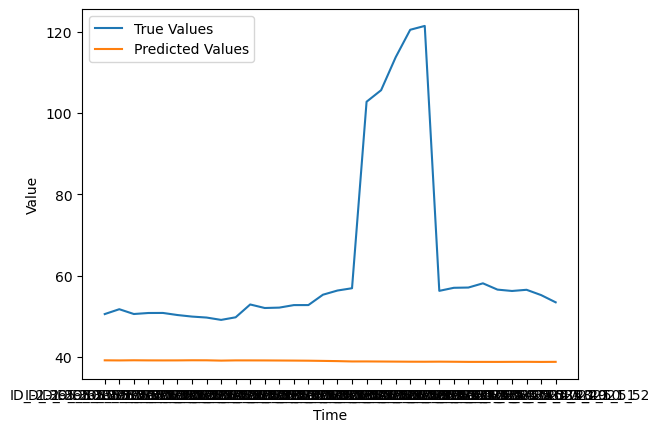

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.528_31.372
Epoch 1/50
3/3 [==============================] - 2s 222ms/step - loss: 1619.2079 - mse: 1619.2079 - accuracy: 0.0000e+00 - val_loss: 1897.7802 - val_mse: 1897.7802 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 1598.0863 - mse: 1598.0863 - accuracy: 0.0000e+00 - val_loss: 1875.2292 - val_mse: 1875.2292 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 1576.9767 - mse: 1576.9767 - accuracy: 0.0000e+00 - val_loss: 1854.2292 - val_mse: 1854.2292 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 1558.4645 - mse: 1558.4645 - accuracy: 0.0000e+00 - val_loss: 1835.8313 - val_mse: 1835.8313 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 1540.7084 - mse: 1540.7084 - accuracy: 0.0000e+00 - val_loss: 1815.6526 - val_m

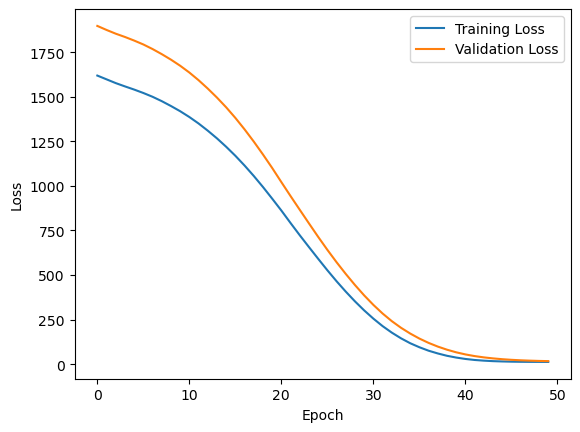

1/1 [==============================] - 0s 243ms/step


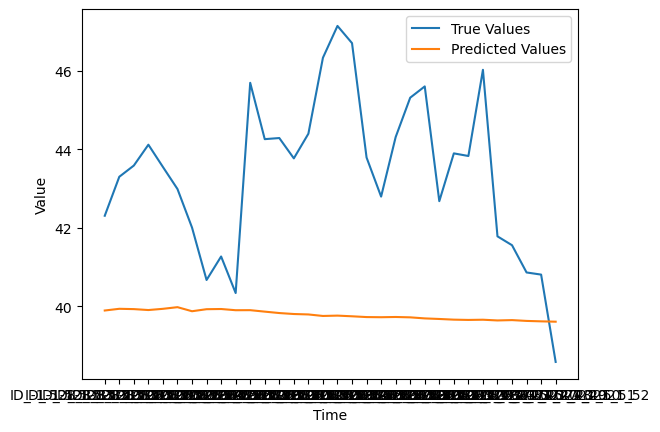

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.841_28.659
Epoch 1/50
3/3 [==============================] - 2s 185ms/step - loss: 1892.7394 - mse: 1892.7394 - accuracy: 0.0000e+00 - val_loss: 2106.9895 - val_mse: 2106.9895 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 31ms/step - loss: 1866.8214 - mse: 1866.8214 - accuracy: 0.0000e+00 - val_loss: 2082.6094 - val_mse: 2082.6094 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 1843.5652 - mse: 1843.5652 - accuracy: 0.0000e+00 - val_loss: 2058.1177 - val_mse: 2058.1177 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 1820.2095 - mse: 1820.2095 - accuracy: 0.0000e+00 - val_loss: 2034.4199 - val_mse: 2034.4199 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 1797.4557 - mse: 1797.4557 - accuracy: 0.0000e+00 - val_loss: 2012.7052 - val_m

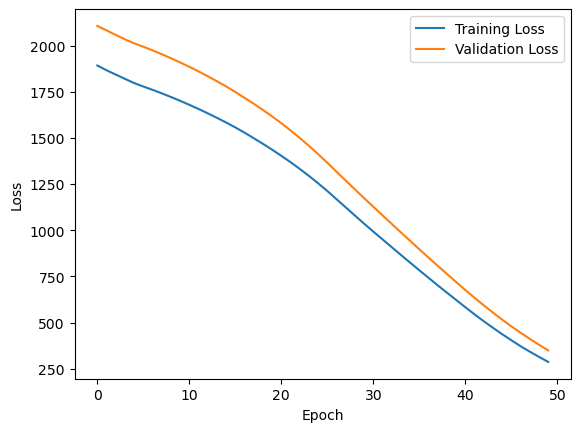

1/1 [==============================] - 0s 336ms/step


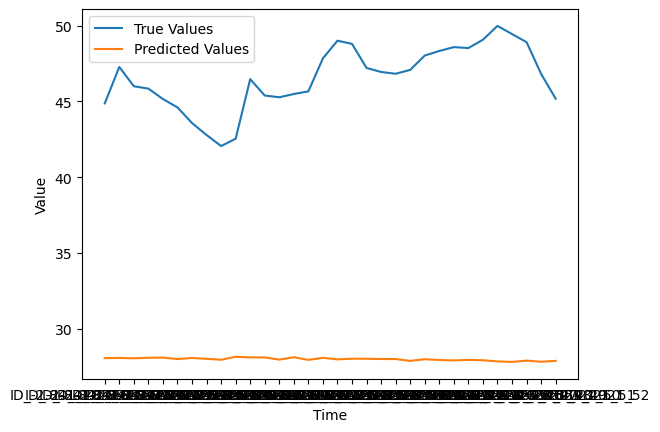

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.659_29.641
Epoch 1/50
3/3 [==============================] - 2s 218ms/step - loss: 56077.6641 - mse: 56077.6641 - accuracy: 0.0000e+00 - val_loss: 58652.9453 - val_mse: 58652.9453 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 32ms/step - loss: 55945.5703 - mse: 55945.5703 - accuracy: 0.0000e+00 - val_loss: 58514.0781 - val_mse: 58514.0781 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 33ms/step - loss: 55811.0156 - mse: 55811.0156 - accuracy: 0.0000e+00 - val_loss: 58386.0312 - val_mse: 58386.0312 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 55686.7930 - mse: 55686.7930 - accuracy: 0.0000e+00 - val_loss: 58247.6406 - val_mse: 58247.6406 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 55545.2148 - mse: 55545.2148 - accuracy: 0.0000e+00 - val_loss:

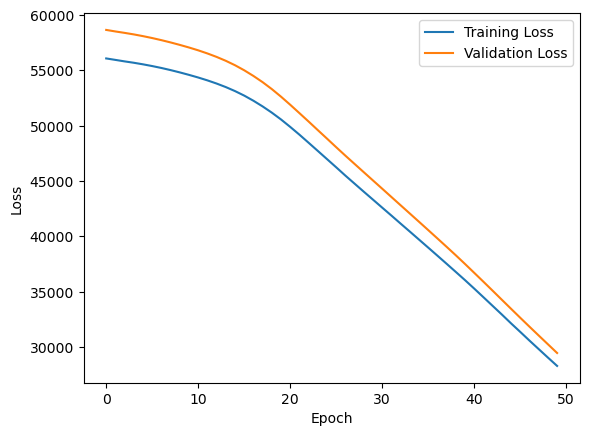

1/1 [==============================] - 0s 244ms/step


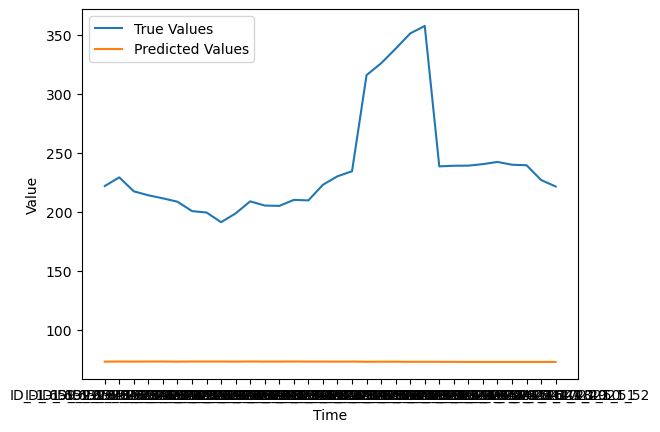

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.097_29.903
Epoch 1/50
3/3 [==============================] - 2s 205ms/step - loss: 2169.7561 - mse: 2169.7561 - accuracy: 0.0000e+00 - val_loss: 2384.7314 - val_mse: 2384.7314 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 32ms/step - loss: 2142.2554 - mse: 2142.2554 - accuracy: 0.0000e+00 - val_loss: 2356.5173 - val_mse: 2356.5173 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 33ms/step - loss: 2115.5886 - mse: 2115.5886 - accuracy: 0.0000e+00 - val_loss: 2329.0564 - val_mse: 2329.0564 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 2089.5710 - mse: 2089.5710 - accuracy: 0.0000e+00 - val_loss: 2302.4871 - val_mse: 2302.4871 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 2064.3428 - mse: 2064.3428 - accuracy: 0.0000e+00 - val_loss: 2276.1648 - val_m

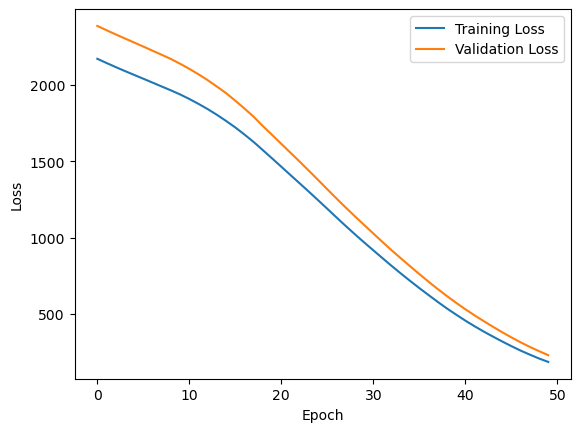

1/1 [==============================] - 0s 266ms/step


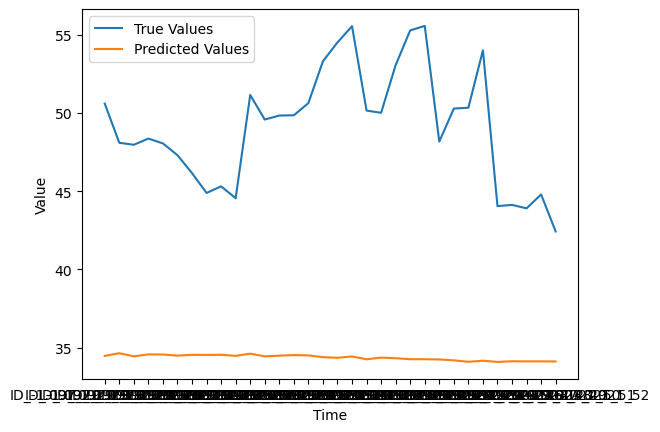

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -1.617_30.683
Epoch 1/50
3/3 [==============================] - 2s 192ms/step - loss: 67742.0859 - mse: 67742.0859 - accuracy: 0.0000e+00 - val_loss: 74735.1719 - val_mse: 74735.1719 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 35ms/step - loss: 67608.3516 - mse: 67608.3516 - accuracy: 0.0000e+00 - val_loss: 74609.7031 - val_mse: 74609.7031 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 33ms/step - loss: 67488.6953 - mse: 67488.6953 - accuracy: 0.0000e+00 - val_loss: 74488.7031 - val_mse: 74488.7031 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 67374.3906 - mse: 67374.3906 - accuracy: 0.0000e+00 - val_loss: 74371.4688 - val_mse: 74371.4688 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 67264.4844 - mse: 67264.4844 - accuracy: 0.0000e+00 - val_loss:

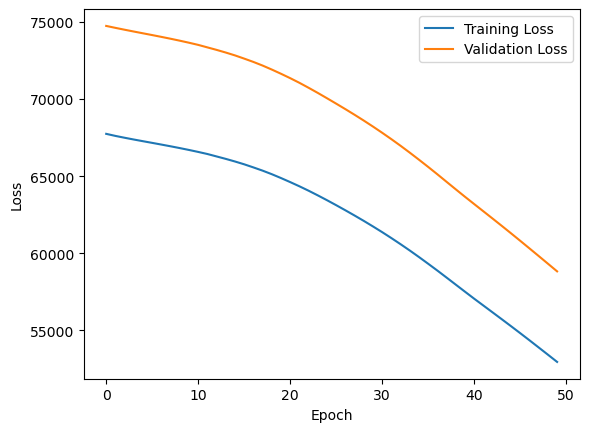

1/1 [==============================] - 0s 307ms/step


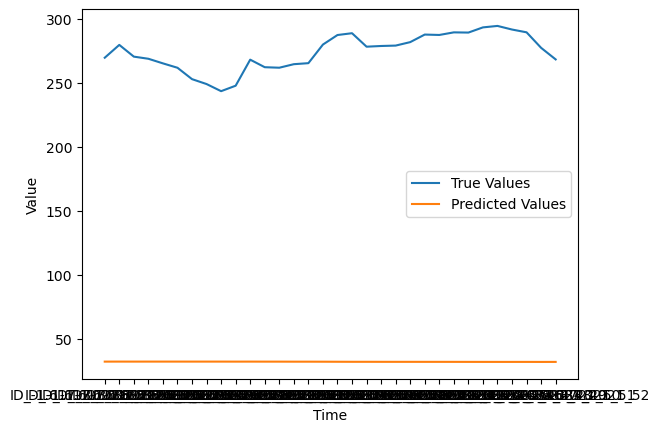

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.815_30.285
Epoch 1/50
3/3 [==============================] - 3s 271ms/step - loss: 1369.9147 - mse: 1369.9147 - accuracy: 0.0000e+00 - val_loss: 1470.3802 - val_mse: 1470.3802 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 44ms/step - loss: 1339.9871 - mse: 1339.9871 - accuracy: 0.0000e+00 - val_loss: 1439.7585 - val_mse: 1439.7585 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 36ms/step - loss: 1310.6222 - mse: 1310.6222 - accuracy: 0.0000e+00 - val_loss: 1411.1832 - val_mse: 1411.1832 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 38ms/step - loss: 1284.4448 - mse: 1284.4448 - accuracy: 0.0000e+00 - val_loss: 1386.4150 - val_mse: 1386.4150 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 39ms/step - loss: 1261.3267 - mse: 1261.3267 - accuracy: 0.0000e+00 - val_loss: 1362.4281 - val_m

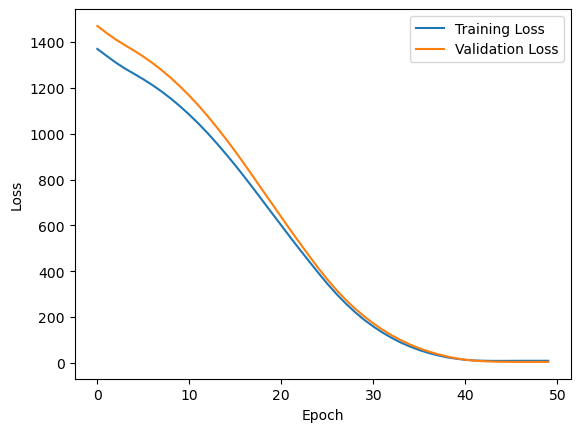

1/1 [==============================] - 0s 324ms/step


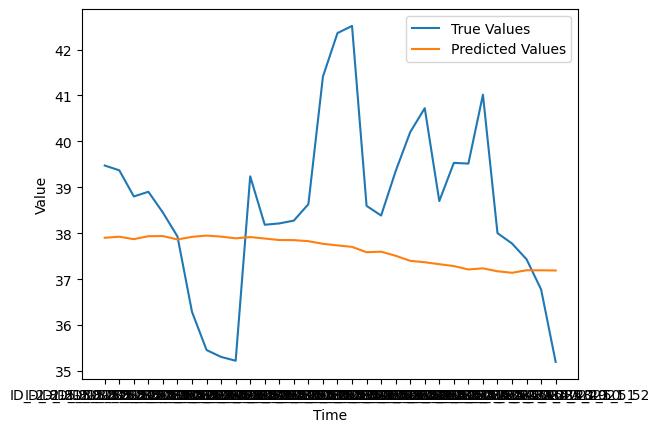

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -0.915_28.985
Epoch 1/50
3/3 [==============================] - 3s 546ms/step - loss: 0.0537 - mse: 0.0537 - accuracy: 0.0000e+00 - val_loss: 0.0227 - val_mse: 0.0227 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 99ms/step - loss: 0.0166 - mse: 0.0166 - accuracy: 0.0000e+00 - val_loss: 0.0035 - val_mse: 0.0035 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 109ms/step - loss: 0.0058 - mse: 0.0058 - accuracy: 0.0000e+00 - val_loss: 0.0042 - val_mse: 0.0042 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 53ms/step - loss: 0.0089 - mse: 0.0089 - accuracy: 0.0000e+00 - val_loss: 0.0077 - val_mse: 0.0077 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 48ms/step - loss: 0.0114 - mse: 0.0114 - accuracy: 0.0000e+00 - val_loss: 0.0058 - val_mse: 0.0058 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [==

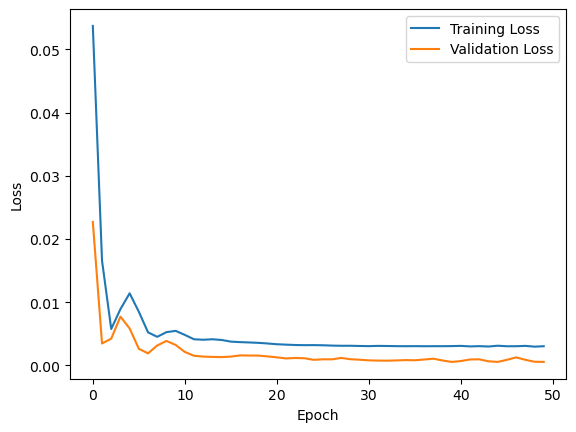

1/1 [==============================] - 0s 420ms/step


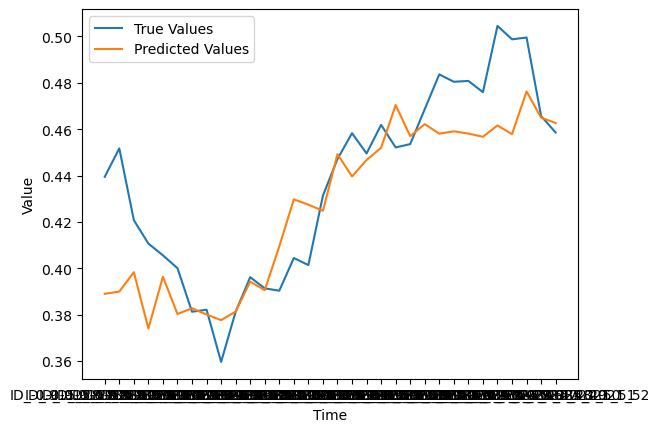

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.244_29.856
Epoch 1/50
3/3 [==============================] - 3s 289ms/step - loss: 45183.0625 - mse: 45183.0625 - accuracy: 0.0000e+00 - val_loss: 47836.4844 - val_mse: 47836.4844 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 51ms/step - loss: 45054.0547 - mse: 45054.0547 - accuracy: 0.0000e+00 - val_loss: 47720.6992 - val_mse: 47720.6992 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 50ms/step - loss: 44953.3047 - mse: 44953.3047 - accuracy: 0.0000e+00 - val_loss: 47643.8867 - val_mse: 47643.8867 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 61ms/step - loss: 44880.3594 - mse: 44880.3594 - accuracy: 0.0000e+00 - val_loss: 47564.0625 - val_mse: 47564.0625 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 69ms/step - loss: 44800.5859 - mse: 44800.5859 - accuracy: 0.0000e+00 - val_loss:

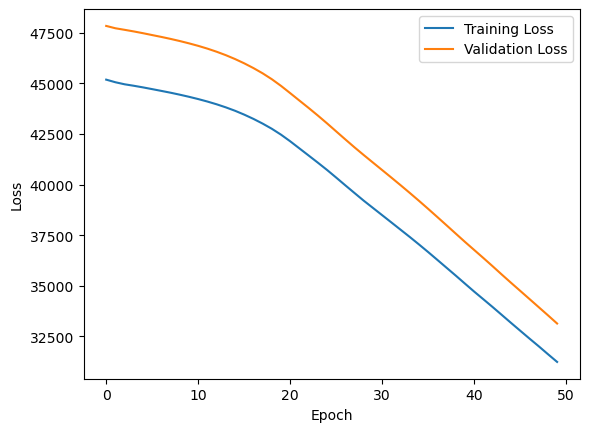

1/1 [==============================] - 1s 614ms/step


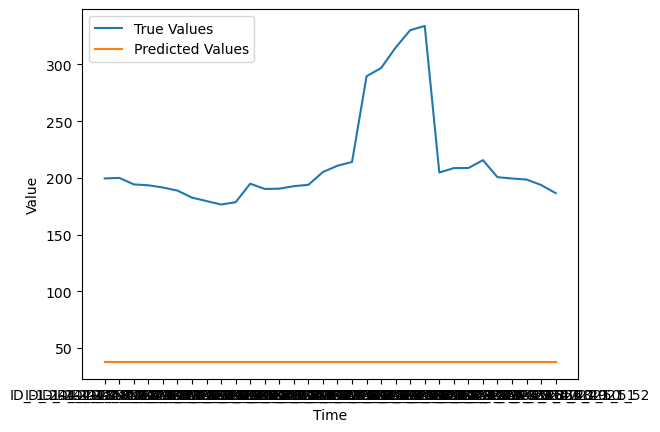

(49, 67)
2/2 [==============================] - 1s 9ms/step
LAT_LONG:  -1.981_31.219
Epoch 1/50
3/3 [==============================] - 4s 316ms/step - loss: 0.0157 - mse: 0.0157 - accuracy: 0.0000e+00 - val_loss: 0.0152 - val_mse: 0.0152 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 36ms/step - loss: 0.0148 - mse: 0.0148 - accuracy: 0.0000e+00 - val_loss: 0.0078 - val_mse: 0.0078 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 42ms/step - loss: 0.0074 - mse: 0.0074 - accuracy: 0.0000e+00 - val_loss: 0.0103 - val_mse: 0.0103 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 41ms/step - loss: 0.0081 - mse: 0.0081 - accuracy: 0.0000e+00 - val_loss: 0.0047 - val_mse: 0.0047 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 47ms/step - loss: 0.0058 - mse: 0.0058 - accuracy: 0.0000e+00 - val_loss: 0.0067 - val_mse: 0.0067 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

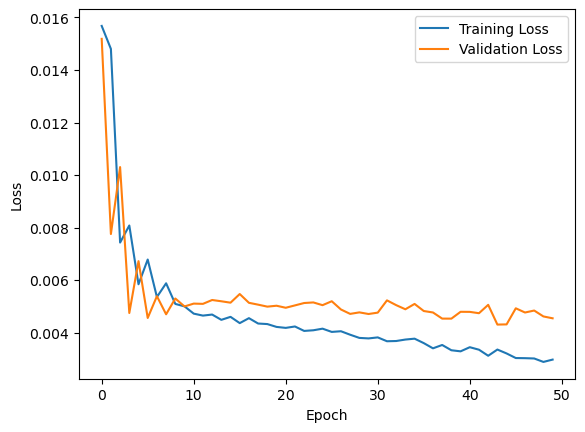

1/1 [==============================] - 0s 290ms/step


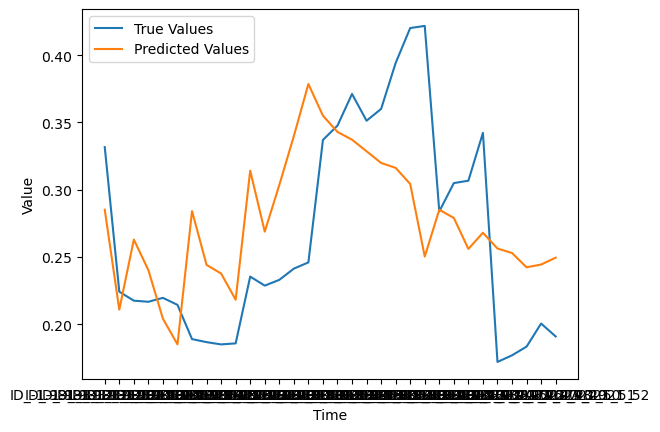

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -2.859_29.441
Epoch 1/50
3/3 [==============================] - 2s 230ms/step - loss: 1101.4429 - mse: 1101.4429 - accuracy: 0.0000e+00 - val_loss: 1063.0753 - val_mse: 1063.0753 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 45ms/step - loss: 1082.8424 - mse: 1082.8424 - accuracy: 0.0000e+00 - val_loss: 1043.7654 - val_mse: 1043.7654 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 39ms/step - loss: 1062.6993 - mse: 1062.6995 - accuracy: 0.0000e+00 - val_loss: 1023.0327 - val_mse: 1023.0327 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 41ms/step - loss: 1041.3765 - mse: 1041.3765 - accuracy: 0.0000e+00 - val_loss: 1000.9963 - val_mse: 1000.9963 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 44ms/step - loss: 1019.2764 - mse: 1019.2764 - accuracy: 0.0000e+00 - val_loss: 979.3082 - val_ms

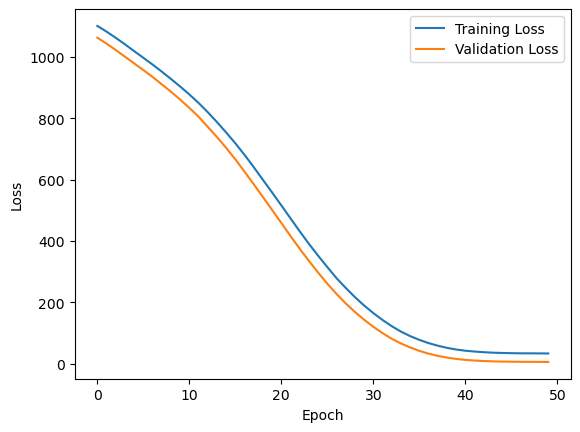

1/1 [==============================] - 0s 313ms/step


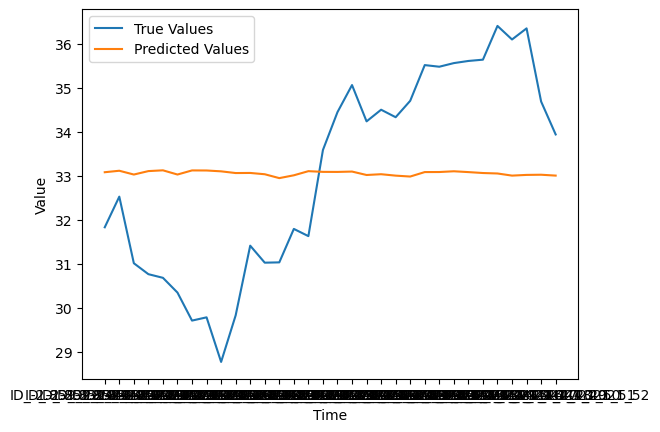

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.944_29.356
Epoch 1/50
3/3 [==============================] - 3s 284ms/step - loss: 341.8723 - mse: 341.8723 - accuracy: 0.0000e+00 - val_loss: 344.6726 - val_mse: 344.6726 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 34ms/step - loss: 331.9951 - mse: 331.9951 - accuracy: 0.0000e+00 - val_loss: 336.1655 - val_mse: 336.1655 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 41ms/step - loss: 324.2521 - mse: 324.2521 - accuracy: 0.0000e+00 - val_loss: 329.6819 - val_mse: 329.6819 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 36ms/step - loss: 318.2137 - mse: 318.2137 - accuracy: 0.0000e+00 - val_loss: 323.7576 - val_mse: 323.7576 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 35ms/step - loss: 312.3698 - mse: 312.3698 - accuracy: 0.0000e+00 - val_loss: 317.8286 - val_mse: 317.8286 - val_

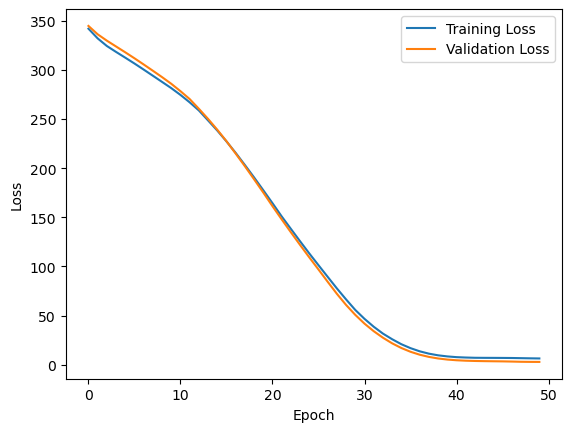

1/1 [==============================] - 0s 307ms/step


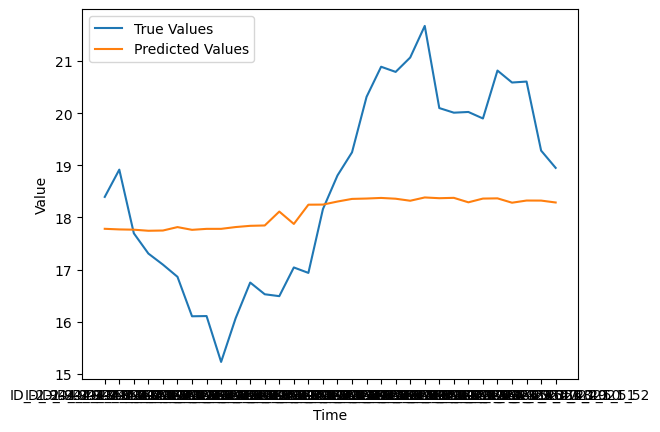

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.427_30.073
Epoch 1/50
3/3 [==============================] - 2s 232ms/step - loss: 4874.0747 - mse: 4874.0747 - accuracy: 0.0000e+00 - val_loss: 5027.3389 - val_mse: 5027.3389 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 53ms/step - loss: 4831.5190 - mse: 4831.5190 - accuracy: 0.0000e+00 - val_loss: 4983.5083 - val_mse: 4983.5083 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 47ms/step - loss: 4787.3975 - mse: 4787.3975 - accuracy: 0.0000e+00 - val_loss: 4939.2764 - val_mse: 4939.2764 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 38ms/step - loss: 4746.8027 - mse: 4746.8027 - accuracy: 0.0000e+00 - val_loss: 4900.1699 - val_mse: 4900.1699 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 35ms/step - loss: 4707.9697 - mse: 4707.9697 - accuracy: 0.0000e+00 - val_loss: 4854.4370 - val_m

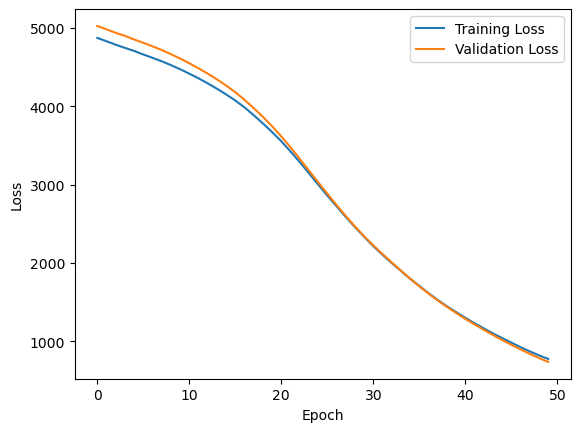

1/1 [==============================] - 0s 404ms/step


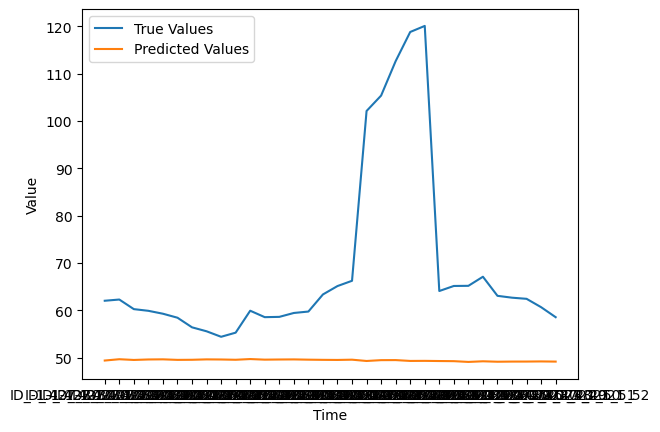

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -1.606_30.294
Epoch 1/50
3/3 [==============================] - 2s 231ms/step - loss: 2296.0500 - mse: 2296.0500 - accuracy: 0.0000e+00 - val_loss: 2298.2256 - val_mse: 2298.2256 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 55ms/step - loss: 2268.4258 - mse: 2268.4258 - accuracy: 0.0000e+00 - val_loss: 2272.9272 - val_mse: 2272.9272 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 33ms/step - loss: 2244.8042 - mse: 2244.8042 - accuracy: 0.0000e+00 - val_loss: 2249.9036 - val_mse: 2249.9036 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 39ms/step - loss: 2222.4558 - mse: 2222.4558 - accuracy: 0.0000e+00 - val_loss: 2228.5508 - val_mse: 2228.5508 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 37ms/step - loss: 2203.1526 - mse: 2203.1526 - accuracy: 0.0000e+00 - val_loss: 2210.6492 - val_m

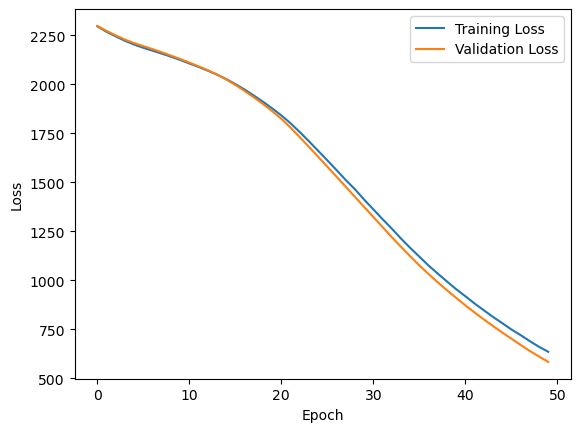

1/1 [==============================] - 0s 418ms/step


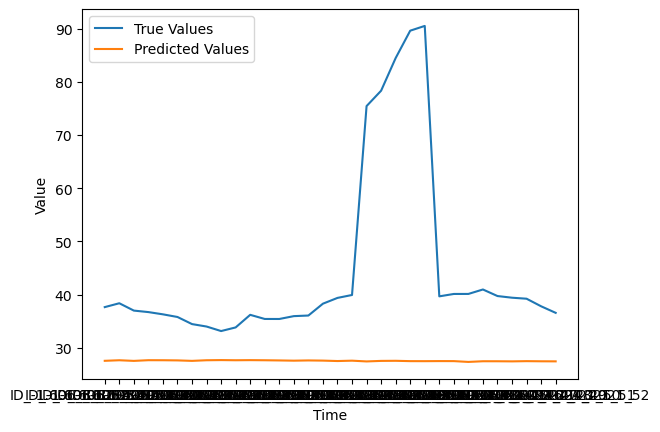

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -2.123_31.277
Epoch 1/50
3/3 [==============================] - 3s 437ms/step - loss: 65.5827 - mse: 65.5827 - accuracy: 0.0000e+00 - val_loss: 67.6958 - val_mse: 67.6958 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 38ms/step - loss: 58.2287 - mse: 58.2287 - accuracy: 0.0000e+00 - val_loss: 60.5669 - val_mse: 60.5669 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 53ms/step - loss: 51.7817 - mse: 51.7817 - accuracy: 0.0000e+00 - val_loss: 54.4369 - val_mse: 54.4369 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 46ms/step - loss: 46.1394 - mse: 46.1394 - accuracy: 0.0000e+00 - val_loss: 48.7727 - val_mse: 48.7727 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 62ms/step - loss: 40.9260 - mse: 40.9260 - accuracy: 0.0000e+00 - val_loss: 43.6961 - val_mse: 43.6961 - val_accuracy: 0.0000e+00

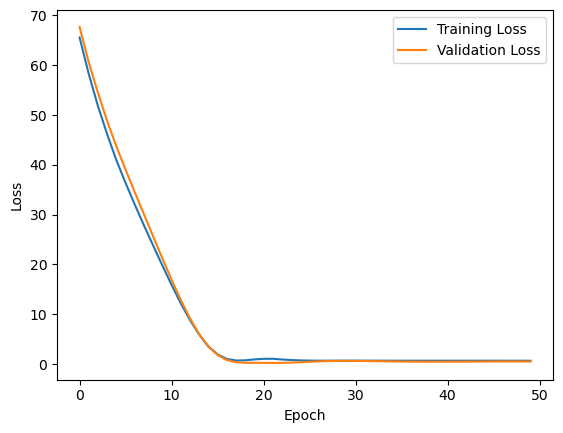

1/1 [==============================] - 0s 474ms/step


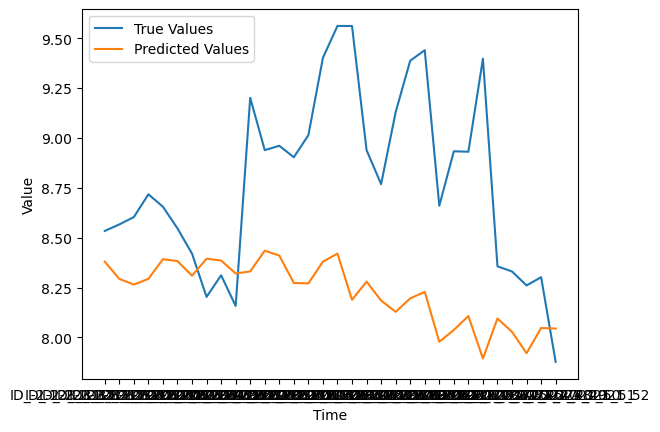

(49, 67)
2/2 [==============================] - 0s 9ms/step
LAT_LONG:  -2.719_30.981
Epoch 1/50
3/3 [==============================] - 2s 223ms/step - loss: 24204.6777 - mse: 24204.6777 - accuracy: 0.0000e+00 - val_loss: 25119.0000 - val_mse: 25119.0000 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 39ms/step - loss: 24092.8613 - mse: 24092.8613 - accuracy: 0.0000e+00 - val_loss: 25003.1738 - val_mse: 25003.1738 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 33ms/step - loss: 23976.8438 - mse: 23976.8438 - accuracy: 0.0000e+00 - val_loss: 24880.6016 - val_mse: 24880.6016 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 34ms/step - loss: 23860.6426 - mse: 23860.6426 - accuracy: 0.0000e+00 - val_loss: 24775.1289 - val_mse: 24775.1289 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 36ms/step - loss: 23758.8418 - mse: 23758.8418 - accuracy: 0.0000e+00 - val_loss:

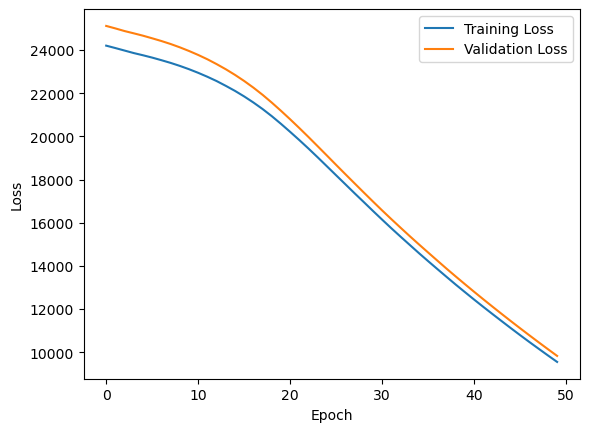

1/1 [==============================] - 0s 360ms/step


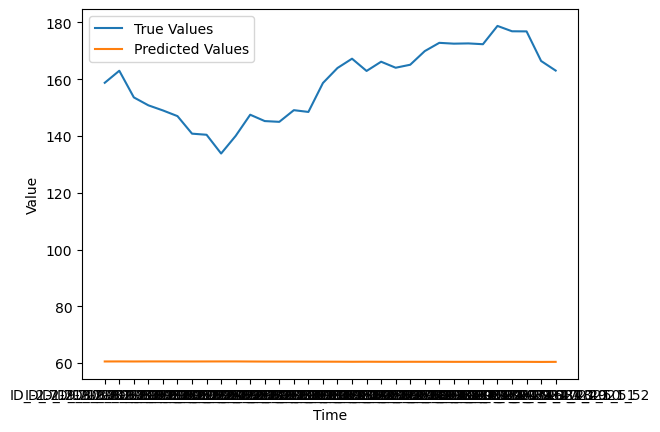

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -1.214_30.786
Epoch 1/50
3/3 [==============================] - 2s 207ms/step - loss: 27186.4570 - mse: 27186.4570 - accuracy: 0.0000e+00 - val_loss: 28358.1445 - val_mse: 28358.1445 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 27143.1895 - mse: 27143.1895 - accuracy: 0.0000e+00 - val_loss: 28327.9180 - val_mse: 28327.9180 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 33ms/step - loss: 27116.0859 - mse: 27116.0859 - accuracy: 0.0000e+00 - val_loss: 28300.6602 - val_mse: 28300.6602 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 27089.8125 - mse: 27089.8125 - accuracy: 0.0000e+00 - val_loss: 28273.0938 - val_mse: 28273.0938 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 36ms/step - loss: 27062.2031 - mse: 27062.2031 - accuracy: 0.0000e+00 - val_loss:

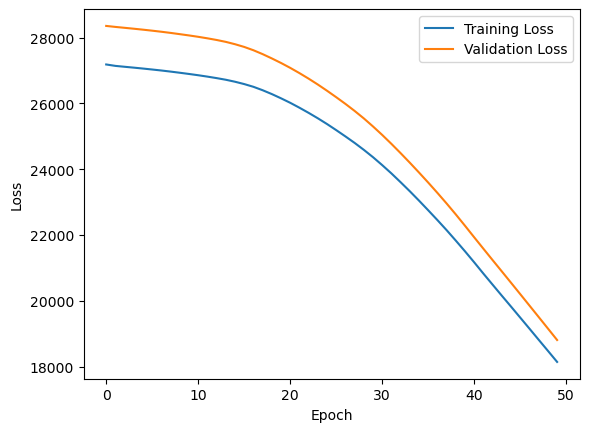

1/1 [==============================] - 0s 480ms/step


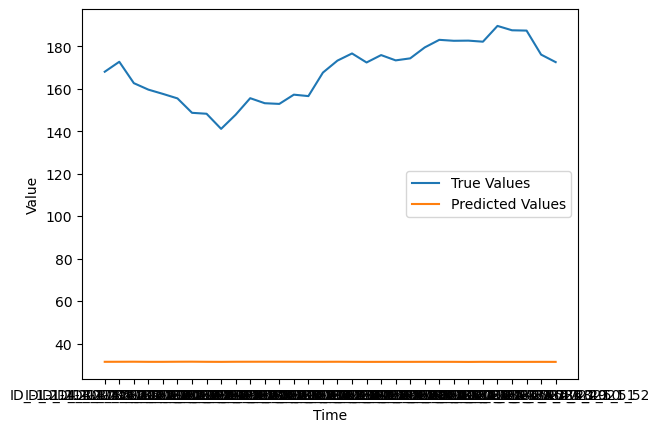

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.289_29.711
Epoch 1/50
3/3 [==============================] - 3s 216ms/step - loss: 46747.8711 - mse: 46747.8711 - accuracy: 0.0000e+00 - val_loss: 47536.8594 - val_mse: 47536.8594 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 34ms/step - loss: 46643.6523 - mse: 46643.6523 - accuracy: 0.0000e+00 - val_loss: 47442.9805 - val_mse: 47442.9805 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 34ms/step - loss: 46555.4492 - mse: 46555.4492 - accuracy: 0.0000e+00 - val_loss: 47371.5547 - val_mse: 47371.5547 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 46485.1094 - mse: 46485.1094 - accuracy: 0.0000e+00 - val_loss: 47304.5742 - val_mse: 47304.5742 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 46419.0312 - mse: 46419.0312 - accuracy: 0.0000e+00 - val_loss:

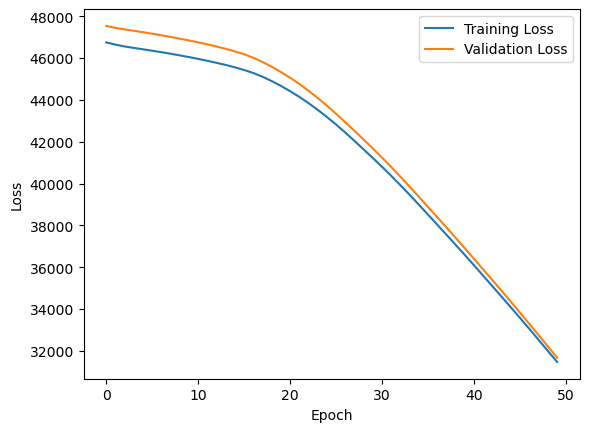

1/1 [==============================] - 0s 448ms/step


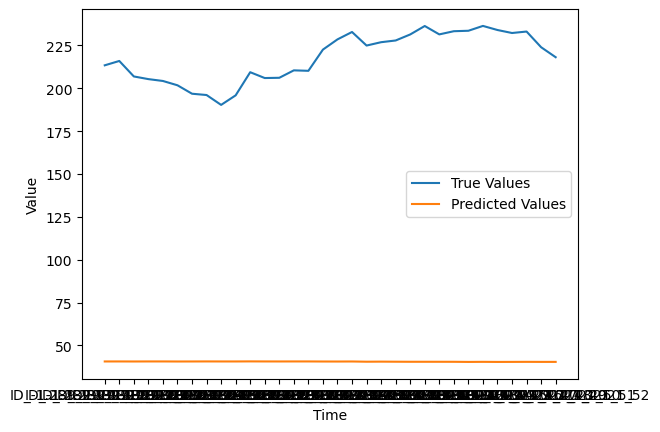

(49, 67)
2/2 [==============================] - 1s 11ms/step
LAT_LONG:  -2.282_29.018
Epoch 1/50
3/3 [==============================] - 3s 247ms/step - loss: 1377.8761 - mse: 1377.8761 - accuracy: 0.0000e+00 - val_loss: 1400.7444 - val_mse: 1400.7444 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 63ms/step - loss: 1352.5707 - mse: 1352.5707 - accuracy: 0.0000e+00 - val_loss: 1381.4371 - val_mse: 1381.4371 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 57ms/step - loss: 1336.7183 - mse: 1336.7183 - accuracy: 0.0000e+00 - val_loss: 1370.5615 - val_mse: 1370.5615 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 56ms/step - loss: 1327.0366 - mse: 1327.0366 - accuracy: 0.0000e+00 - val_loss: 1361.6498 - val_mse: 1361.6498 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 45ms/step - loss: 1318.4950 - mse: 1318.4950 - accuracy: 0.0000e+00 - val_loss: 1352.6738 - val_

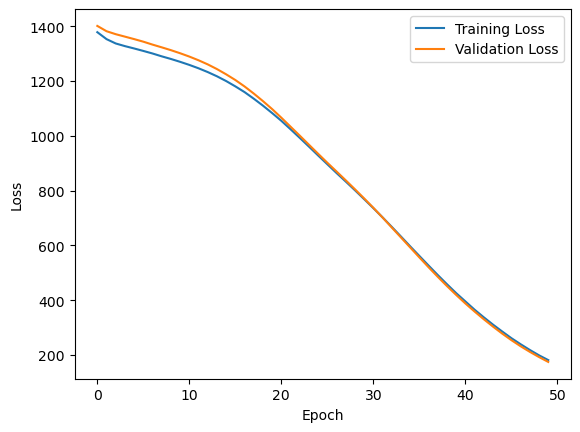

1/1 [==============================] - 0s 412ms/step


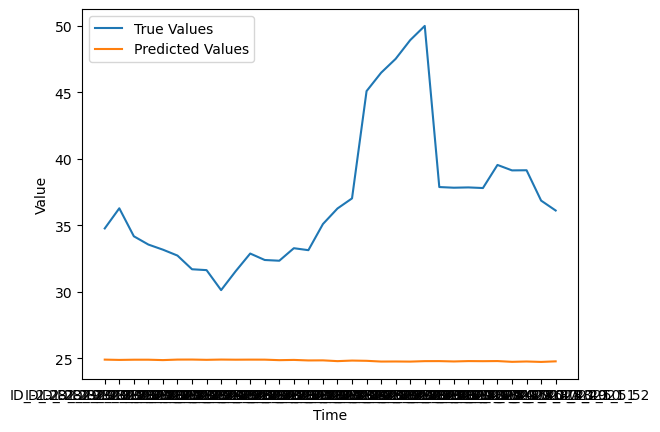

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -2.859_29.041
Epoch 1/50
3/3 [==============================] - 3s 237ms/step - loss: 0.0262 - mse: 0.0262 - accuracy: 1.0000 - val_loss: 9.0061e-04 - val_mse: 9.0061e-04 - val_accuracy: 1.0000
Epoch 2/50
3/3 [==============================] - 0s 36ms/step - loss: 0.0050 - mse: 0.0050 - accuracy: 1.0000 - val_loss: 0.0049 - val_mse: 0.0049 - val_accuracy: 1.0000
Epoch 3/50
3/3 [==============================] - 0s 37ms/step - loss: 0.0070 - mse: 0.0070 - accuracy: 1.0000 - val_loss: 7.4945e-04 - val_mse: 7.4945e-04 - val_accuracy: 1.0000
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 0.0013 - mse: 0.0013 - accuracy: 1.0000 - val_loss: 0.0023 - val_mse: 0.0023 - val_accuracy: 1.0000
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 0.0022 - mse: 0.0022 - accuracy: 1.0000 - val_loss: 0.0046 - val_mse: 0.0046 - val_accuracy: 1.0000
Epoch 6/50
3/3 [===========================

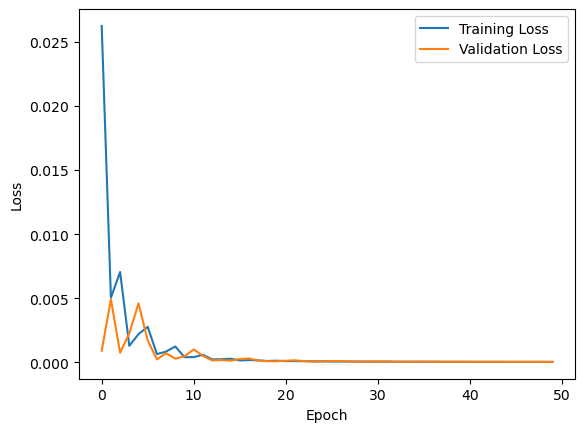

1/1 [==============================] - 0s 357ms/step


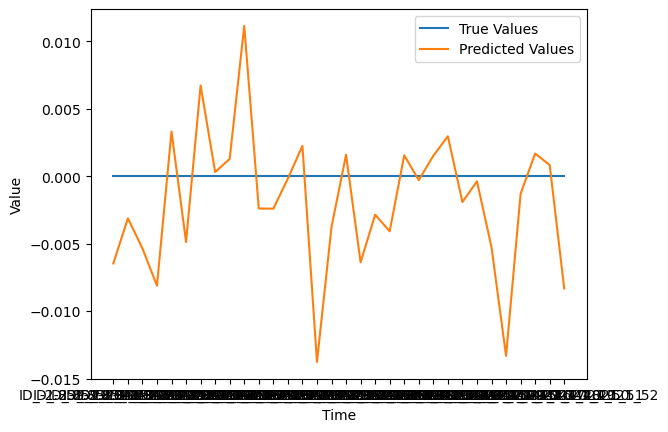

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -0.933_29.267
Epoch 1/50
3/3 [==============================] - 2s 226ms/step - loss: 14.6170 - mse: 14.6170 - accuracy: 0.0000e+00 - val_loss: 14.0638 - val_mse: 14.0638 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 37ms/step - loss: 12.5507 - mse: 12.5507 - accuracy: 0.0000e+00 - val_loss: 12.4179 - val_mse: 12.4179 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 34ms/step - loss: 11.0566 - mse: 11.0566 - accuracy: 0.0000e+00 - val_loss: 11.0231 - val_mse: 11.0231 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 9.7936 - mse: 9.7936 - accuracy: 0.0000e+00 - val_loss: 9.8119 - val_mse: 9.8119 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 32ms/step - loss: 8.6810 - mse: 8.6810 - accuracy: 0.0000e+00 - val_loss: 8.6918 - val_mse: 8.6918 - val_accuracy: 0.0000e+00
Epoch 6

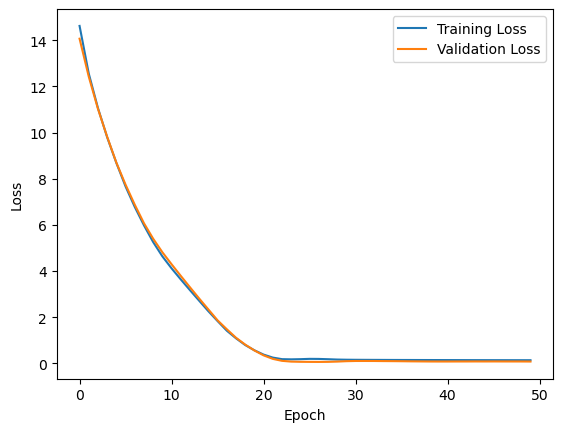

1/1 [==============================] - 0s 453ms/step


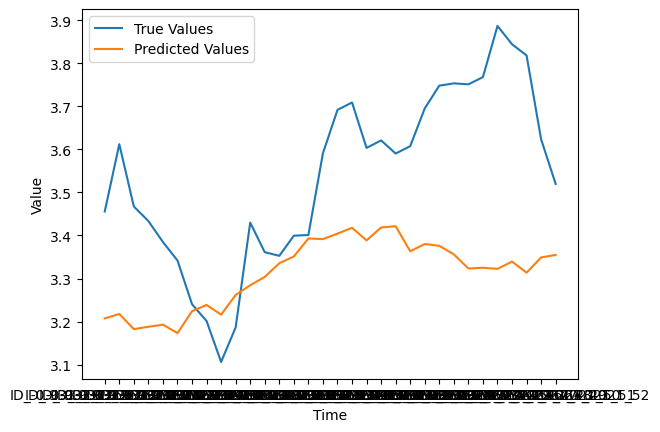

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -0.972_30.628
Epoch 1/50
3/3 [==============================] - 2s 222ms/step - loss: 3834.0127 - mse: 3834.0127 - accuracy: 0.0000e+00 - val_loss: 4187.4722 - val_mse: 4187.4722 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 34ms/step - loss: 3796.4534 - mse: 3796.4534 - accuracy: 0.0000e+00 - val_loss: 4148.4941 - val_mse: 4148.4941 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 37ms/step - loss: 3759.8149 - mse: 3759.8149 - accuracy: 0.0000e+00 - val_loss: 4110.2637 - val_mse: 4110.2637 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 39ms/step - loss: 3723.5930 - mse: 3723.5930 - accuracy: 0.0000e+00 - val_loss: 4075.2947 - val_mse: 4075.2947 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 3691.0305 - mse: 3691.0305 - accuracy: 0.0000e+00 - val_loss: 4040.1768 - val_m

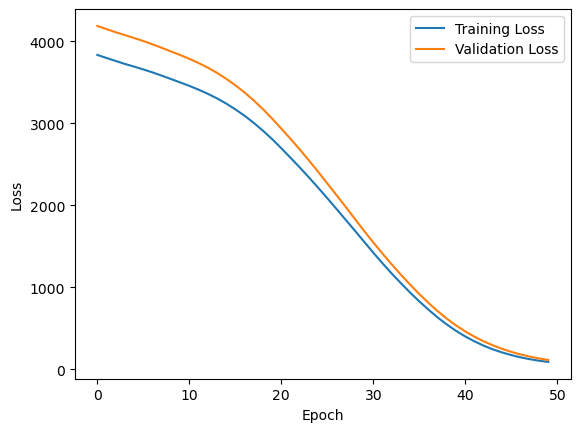

1/1 [==============================] - 0s 371ms/step


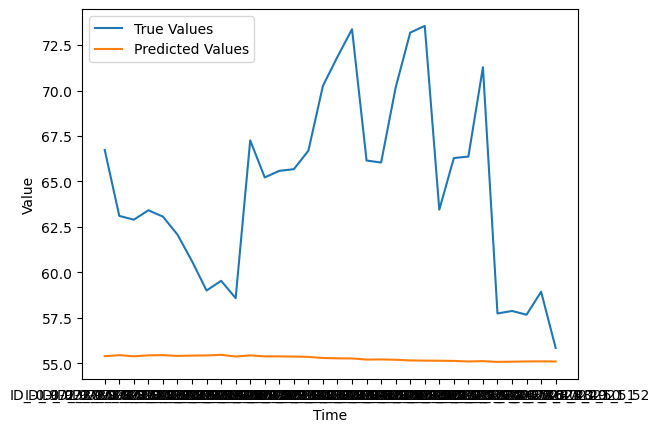

(49, 67)
2/2 [==============================] - 0s 9ms/step
LAT_LONG:  -2.407_29.393
Epoch 1/50
3/3 [==============================] - 3s 221ms/step - loss: 6.0213 - mse: 6.0213 - accuracy: 0.0000e+00 - val_loss: 3.0734 - val_mse: 3.0734 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 35ms/step - loss: 4.6850 - mse: 4.6850 - accuracy: 0.0000e+00 - val_loss: 2.0355 - val_mse: 2.0355 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 32ms/step - loss: 3.4754 - mse: 3.4754 - accuracy: 0.0000e+00 - val_loss: 1.1440 - val_mse: 1.1440 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 2.5295 - mse: 2.5295 - accuracy: 0.0000e+00 - val_loss: 0.5785 - val_mse: 0.5785 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 35ms/step - loss: 1.9177 - mse: 1.9177 - accuracy: 0.0000e+00 - val_loss: 0.2494 - val_mse: 0.2494 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

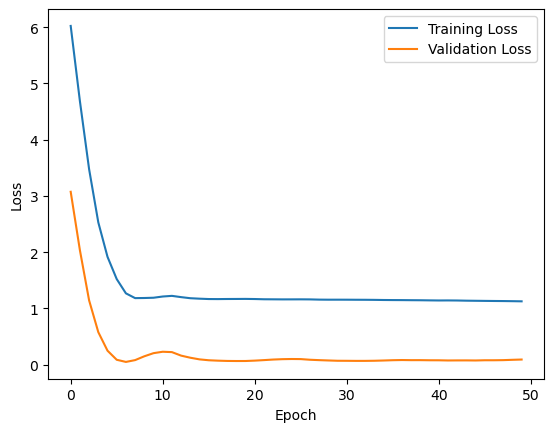

1/1 [==============================] - 0s 411ms/step


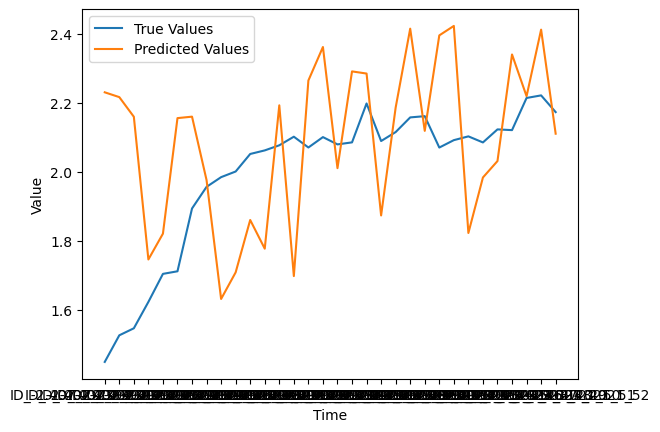

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -0.859_30.441
Epoch 1/50
3/3 [==============================] - 2s 211ms/step - loss: 2399.6233 - mse: 2399.6233 - accuracy: 0.0000e+00 - val_loss: 2625.1245 - val_mse: 2625.1245 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 38ms/step - loss: 2370.1609 - mse: 2370.1609 - accuracy: 0.0000e+00 - val_loss: 2596.3105 - val_mse: 2596.3105 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 35ms/step - loss: 2345.4446 - mse: 2345.4446 - accuracy: 0.0000e+00 - val_loss: 2573.6614 - val_mse: 2573.6614 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 2324.0879 - mse: 2324.0876 - accuracy: 0.0000e+00 - val_loss: 2549.7505 - val_mse: 2549.7505 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 2301.7202 - mse: 2301.7202 - accuracy: 0.0000e+00 - val_loss: 2524.7690 - val_m

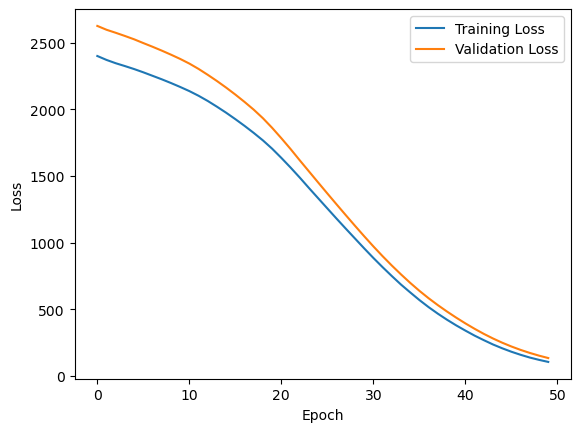

1/1 [==============================] - 0s 359ms/step


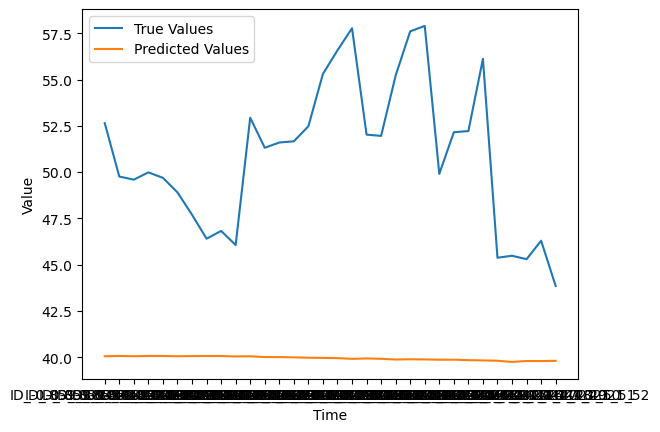

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.342_30.158
Epoch 1/50
3/3 [==============================] - 2s 208ms/step - loss: 17497.7324 - mse: 17497.7324 - accuracy: 0.0000e+00 - val_loss: 17298.1074 - val_mse: 17298.1074 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 32ms/step - loss: 17426.7266 - mse: 17426.7266 - accuracy: 0.0000e+00 - val_loss: 17227.6113 - val_mse: 17227.6113 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 33ms/step - loss: 17349.8340 - mse: 17349.8320 - accuracy: 0.0000e+00 - val_loss: 17146.4844 - val_mse: 17146.4844 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 17273.3105 - mse: 17273.3105 - accuracy: 0.0000e+00 - val_loss: 17072.9453 - val_mse: 17072.9453 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 35ms/step - loss: 17200.0312 - mse: 17200.0312 - accuracy: 0.0000e+00 - val_loss:

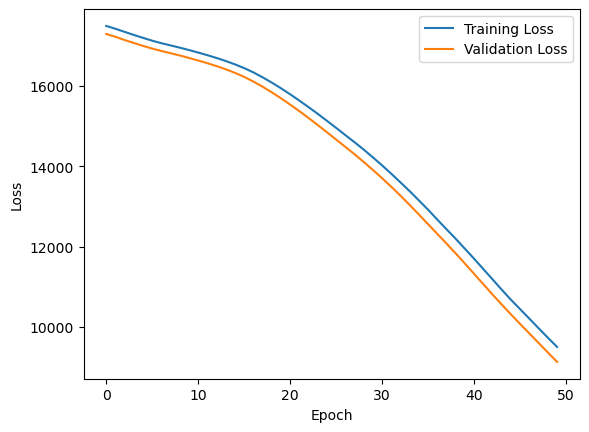

1/1 [==============================] - 0s 345ms/step


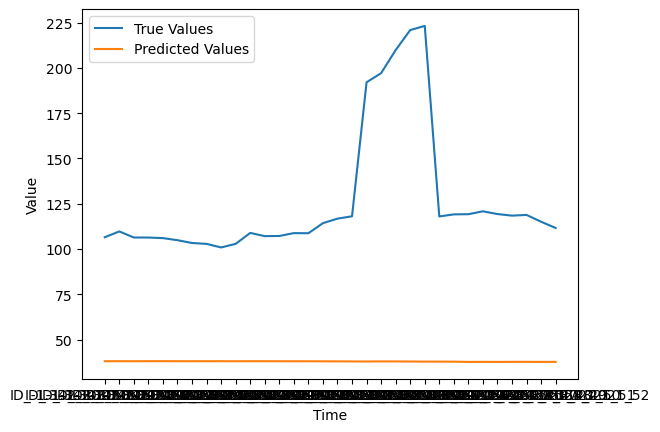

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.82_31.28
Epoch 1/50
3/3 [==============================] - 2s 220ms/step - loss: 136.4504 - mse: 136.4504 - accuracy: 0.0000e+00 - val_loss: 133.9037 - val_mse: 133.9037 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 34ms/step - loss: 130.5554 - mse: 130.5554 - accuracy: 0.0000e+00 - val_loss: 128.4963 - val_mse: 128.4963 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 33ms/step - loss: 125.6449 - mse: 125.6449 - accuracy: 0.0000e+00 - val_loss: 123.9983 - val_mse: 123.9983 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 121.2794 - mse: 121.2794 - accuracy: 0.0000e+00 - val_loss: 119.5198 - val_mse: 119.5198 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 116.8142 - mse: 116.8142 - accuracy: 0.0000e+00 - val_loss: 114.9312 - val_mse: 114.9312 - val_ac

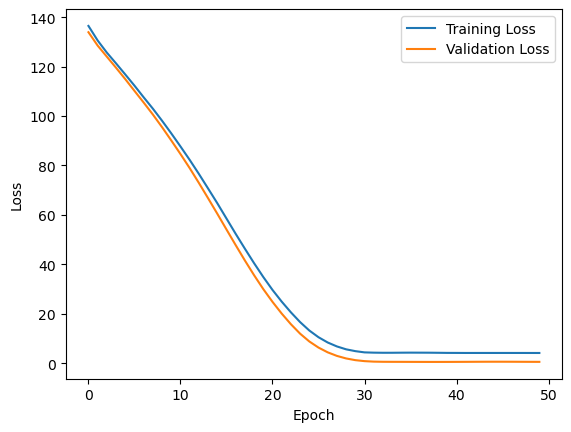

1/1 [==============================] - 0s 378ms/step


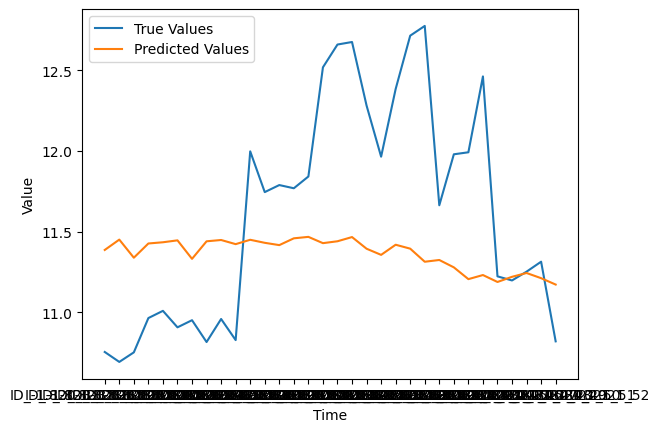

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -2.521_29.179
Epoch 1/50
3/3 [==============================] - 2s 238ms/step - loss: 31935.7734 - mse: 31935.7734 - accuracy: 0.0000e+00 - val_loss: 32741.4805 - val_mse: 32741.4805 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 31887.2109 - mse: 31887.2109 - accuracy: 0.0000e+00 - val_loss: 32702.4648 - val_mse: 32702.4648 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 34ms/step - loss: 31852.8691 - mse: 31852.8691 - accuracy: 0.0000e+00 - val_loss: 32669.6211 - val_mse: 32669.6211 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 31821.5723 - mse: 31821.5742 - accuracy: 0.0000e+00 - val_loss: 32639.7422 - val_mse: 32639.7422 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 32ms/step - loss: 31791.8867 - mse: 31791.8867 - accuracy: 0.0000e+00 - val_loss:

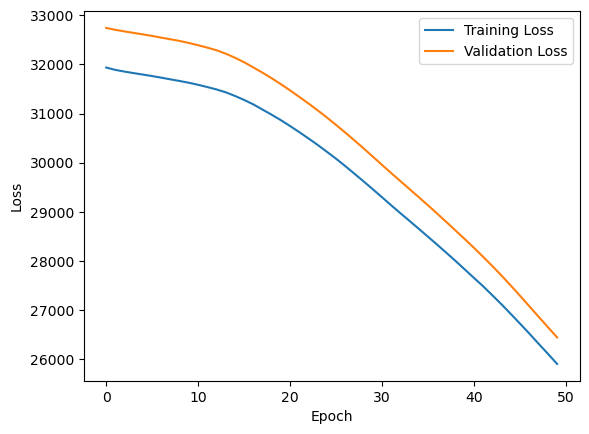

1/1 [==============================] - 0s 416ms/step


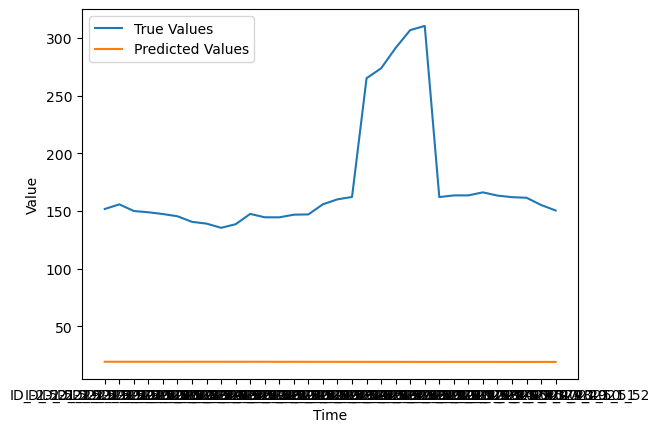

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -3.054_29.046
Epoch 1/50
3/3 [==============================] - 3s 207ms/step - loss: 3806.5737 - mse: 3806.5737 - accuracy: 0.0000e+00 - val_loss: 4077.8962 - val_mse: 4077.8962 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 3768.8354 - mse: 3768.8354 - accuracy: 0.0000e+00 - val_loss: 4037.3030 - val_mse: 4037.3030 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 33ms/step - loss: 3727.0823 - mse: 3727.0823 - accuracy: 0.0000e+00 - val_loss: 3992.2576 - val_mse: 3992.2576 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 3682.4846 - mse: 3682.4846 - accuracy: 0.0000e+00 - val_loss: 3943.5945 - val_mse: 3943.5945 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 3633.0325 - mse: 3633.0325 - accuracy: 0.0000e+00 - val_loss: 3884.9319 - val_m

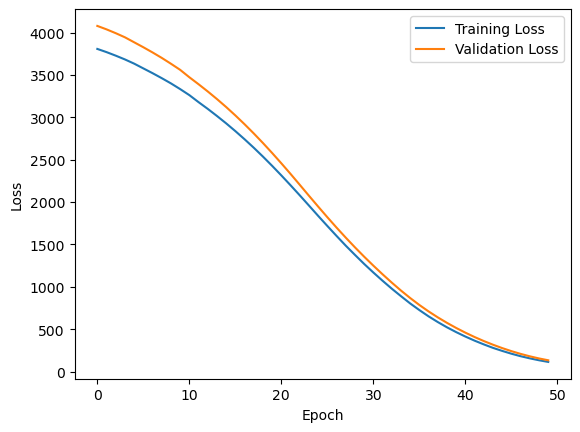

1/1 [==============================] - 0s 405ms/step


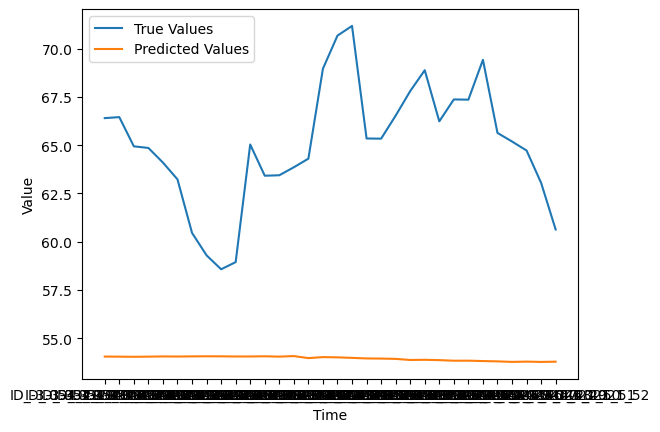

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.258_30.042
Epoch 1/50
3/3 [==============================] - 3s 238ms/step - loss: 25227.8965 - mse: 25227.8965 - accuracy: 0.0000e+00 - val_loss: 26997.4414 - val_mse: 26997.4414 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 34ms/step - loss: 25136.7637 - mse: 25136.7637 - accuracy: 0.0000e+00 - val_loss: 26914.2031 - val_mse: 26914.2031 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 32ms/step - loss: 25063.0176 - mse: 25063.0176 - accuracy: 0.0000e+00 - val_loss: 26841.6406 - val_mse: 26841.6406 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 24991.7402 - mse: 24991.7402 - accuracy: 0.0000e+00 - val_loss: 26765.9473 - val_mse: 26765.9473 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 24917.6875 - mse: 24917.6875 - accuracy: 0.0000e+00 - val_loss:

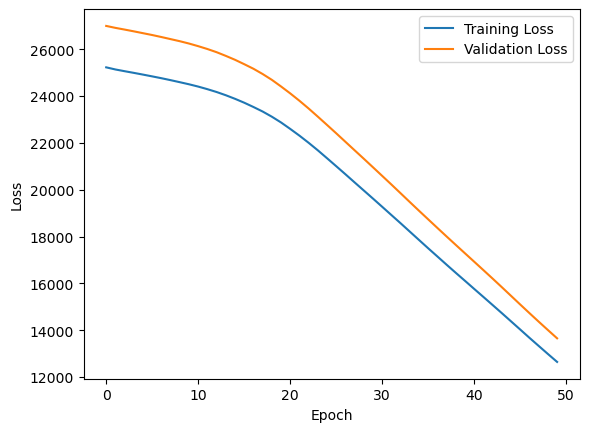

1/1 [==============================] - 2s 2s/step


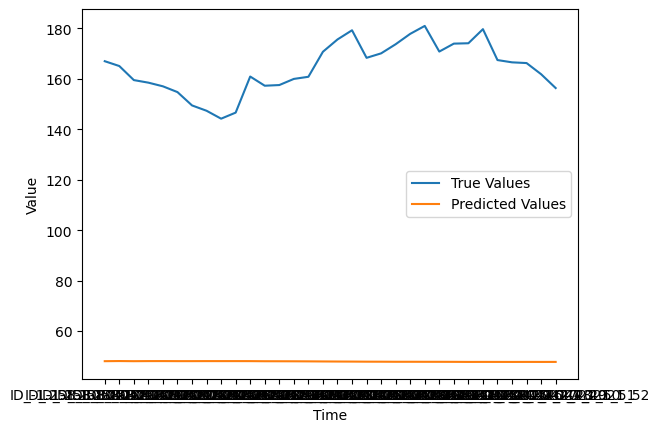

(49, 67)
2/2 [==============================] - 1s 7ms/step
LAT_LONG:  -1.368_30.932
Epoch 1/50
3/3 [==============================] - 2s 233ms/step - loss: 4331.5498 - mse: 4331.5503 - accuracy: 0.0000e+00 - val_loss: 4419.6826 - val_mse: 4419.6826 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 38ms/step - loss: 4274.5322 - mse: 4274.5322 - accuracy: 0.0000e+00 - val_loss: 4368.2285 - val_mse: 4368.2285 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 35ms/step - loss: 4228.4268 - mse: 4228.4268 - accuracy: 0.0000e+00 - val_loss: 4335.5020 - val_mse: 4335.5020 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 31ms/step - loss: 4199.5859 - mse: 4199.5859 - accuracy: 0.0000e+00 - val_loss: 4312.7734 - val_mse: 4312.7734 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 4178.1963 - mse: 4178.1963 - accuracy: 0.0000e+00 - val_loss: 4291.2461 - val_m

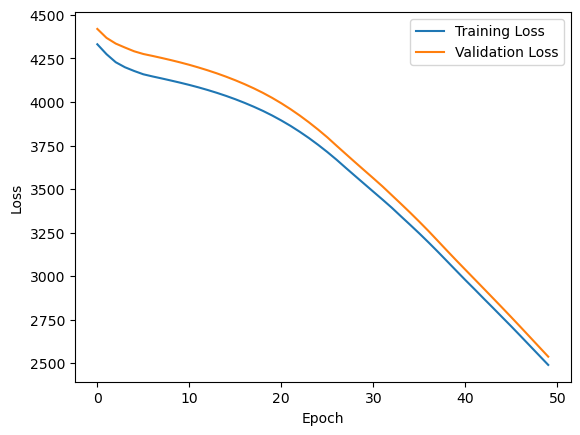

1/1 [==============================] - 0s 413ms/step


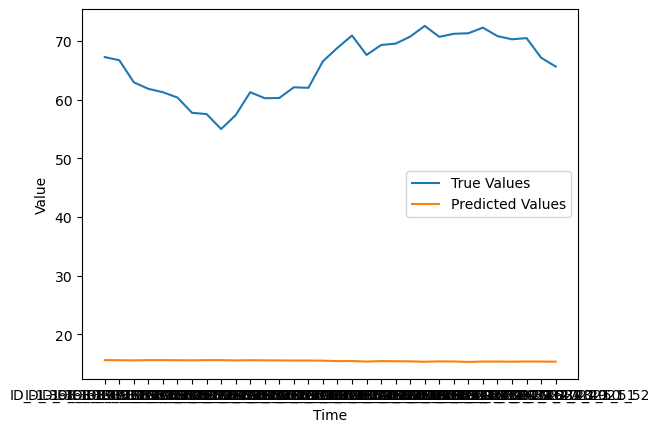

(49, 67)
2/2 [==============================] - 1s 6ms/step
LAT_LONG:  -1.355_30.245
Epoch 1/50
3/3 [==============================] - 3s 224ms/step - loss: 18283.1777 - mse: 18283.1797 - accuracy: 0.0000e+00 - val_loss: 18299.8320 - val_mse: 18299.8320 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 35ms/step - loss: 18215.8848 - mse: 18215.8848 - accuracy: 0.0000e+00 - val_loss: 18230.9062 - val_mse: 18230.9062 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 32ms/step - loss: 18146.2285 - mse: 18146.2285 - accuracy: 0.0000e+00 - val_loss: 18159.8164 - val_mse: 18159.8164 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 18077.2656 - mse: 18077.2656 - accuracy: 0.0000e+00 - val_loss: 18088.1133 - val_mse: 18088.1133 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 34ms/step - loss: 18005.8926 - mse: 18005.8926 - accuracy: 0.0000e+00 - val_loss:

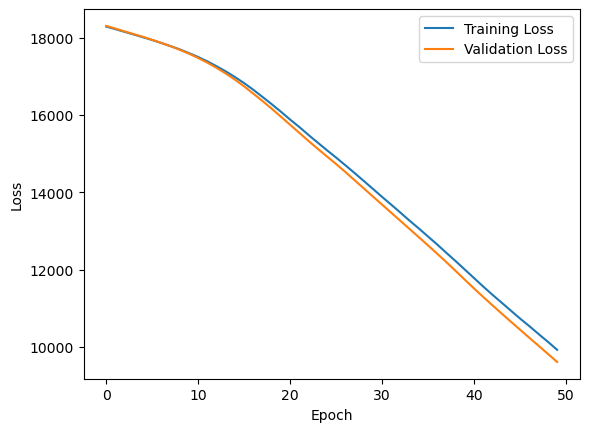

1/1 [==============================] - 0s 394ms/step


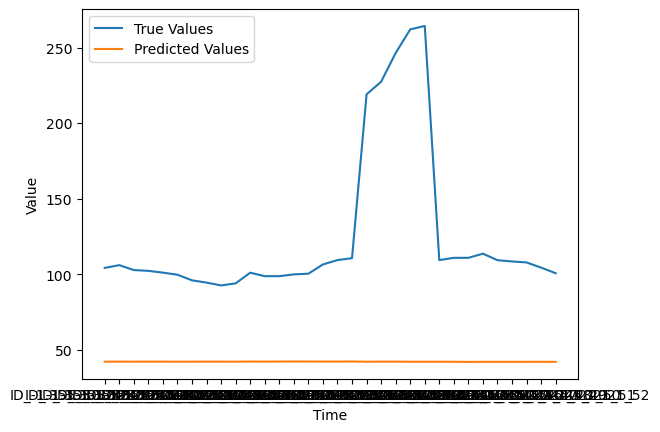

(49, 67)
2/2 [==============================] - 1s 6ms/step
LAT_LONG:  -2.427_28.673
Epoch 1/50
3/3 [==============================] - 2s 239ms/step - loss: 1063.8215 - mse: 1063.8214 - accuracy: 0.0000e+00 - val_loss: 1068.4230 - val_mse: 1068.4230 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 37ms/step - loss: 1050.4238 - mse: 1050.4237 - accuracy: 0.0000e+00 - val_loss: 1055.5820 - val_mse: 1055.5820 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 37ms/step - loss: 1038.6082 - mse: 1038.6082 - accuracy: 0.0000e+00 - val_loss: 1045.8954 - val_mse: 1045.8954 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 37ms/step - loss: 1029.6195 - mse: 1029.6195 - accuracy: 0.0000e+00 - val_loss: 1036.5139 - val_mse: 1036.5139 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 34ms/step - loss: 1020.3643 - mse: 1020.3644 - accuracy: 0.0000e+00 - val_loss: 1027.0564 - val_m

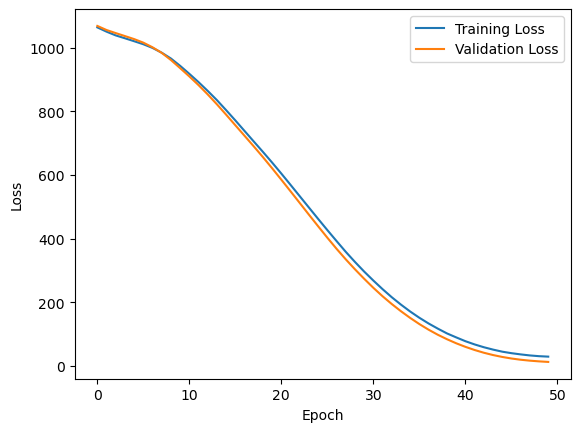

1/1 [==============================] - 0s 361ms/step


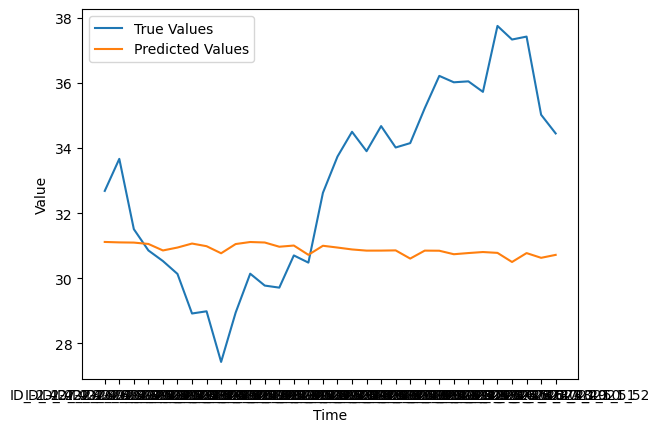

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.223_29.377
Epoch 1/50
3/3 [==============================] - 3s 215ms/step - loss: 0.1758 - mse: 0.1758 - accuracy: 0.0000e+00 - val_loss: 0.0691 - val_mse: 0.0691 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 47ms/step - loss: 0.0481 - mse: 0.0481 - accuracy: 0.0000e+00 - val_loss: 0.0085 - val_mse: 0.0085 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 34ms/step - loss: 0.0048 - mse: 0.0048 - accuracy: 0.0000e+00 - val_loss: 6.2352e-04 - val_mse: 6.2352e-04 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 37ms/step - loss: 0.0022 - mse: 0.0022 - accuracy: 0.0000e+00 - val_loss: 0.0078 - val_mse: 0.0078 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 0.0086 - mse: 0.0086 - accuracy: 0.0000e+00 - val_loss: 0.0116 - val_mse: 0.0116 - val_accuracy: 0.0000e+00
Epoch 6/50


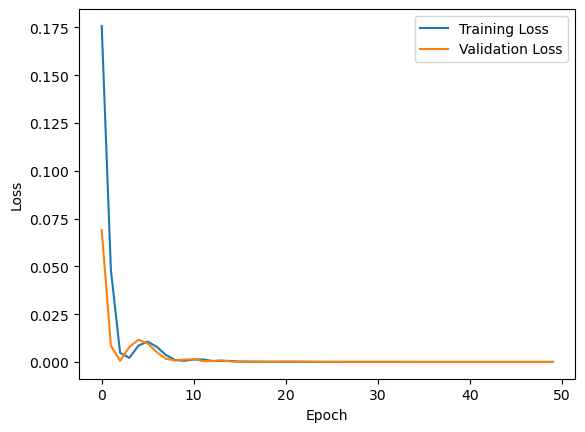

1/1 [==============================] - 0s 366ms/step


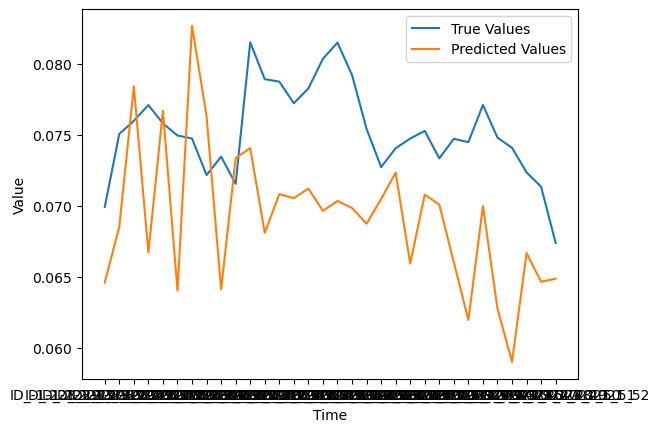

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -2.819_29.981
Epoch 1/50
3/3 [==============================] - 2s 217ms/step - loss: 1120.6404 - mse: 1120.6404 - accuracy: 0.0000e+00 - val_loss: 1228.2518 - val_mse: 1228.2518 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 36ms/step - loss: 1107.2010 - mse: 1107.2010 - accuracy: 0.0000e+00 - val_loss: 1214.5841 - val_mse: 1214.5841 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 36ms/step - loss: 1094.1216 - mse: 1094.1217 - accuracy: 0.0000e+00 - val_loss: 1201.1755 - val_mse: 1201.1755 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 36ms/step - loss: 1081.1329 - mse: 1081.1331 - accuracy: 0.0000e+00 - val_loss: 1187.8726 - val_mse: 1187.8726 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 35ms/step - loss: 1067.9291 - mse: 1067.9291 - accuracy: 0.0000e+00 - val_loss: 1173.5105 - val_m

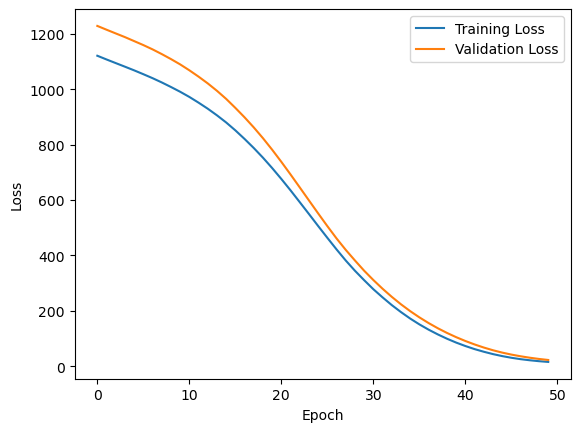

1/1 [==============================] - 1s 512ms/step


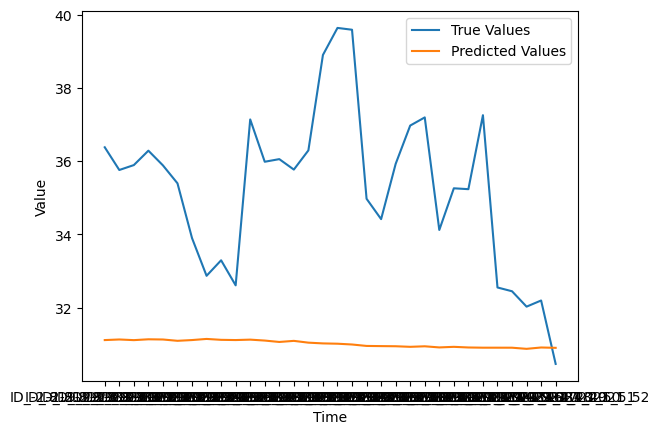

(49, 67)
2/2 [==============================] - 1s 12ms/step
LAT_LONG:  -0.905_29.495
Epoch 1/50
3/3 [==============================] - 3s 221ms/step - loss: 7.5717 - mse: 7.5717 - accuracy: 0.0000e+00 - val_loss: 6.4328 - val_mse: 6.4328 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 31ms/step - loss: 6.0271 - mse: 6.0271 - accuracy: 0.0000e+00 - val_loss: 5.2742 - val_mse: 5.2742 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 4.9307 - mse: 4.9307 - accuracy: 0.0000e+00 - val_loss: 4.3044 - val_mse: 4.3044 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 4.0033 - mse: 4.0033 - accuracy: 0.0000e+00 - val_loss: 3.4267 - val_mse: 3.4267 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 32ms/step - loss: 3.1809 - mse: 3.1809 - accuracy: 0.0000e+00 - val_loss: 2.6402 - val_mse: 2.6402 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [==

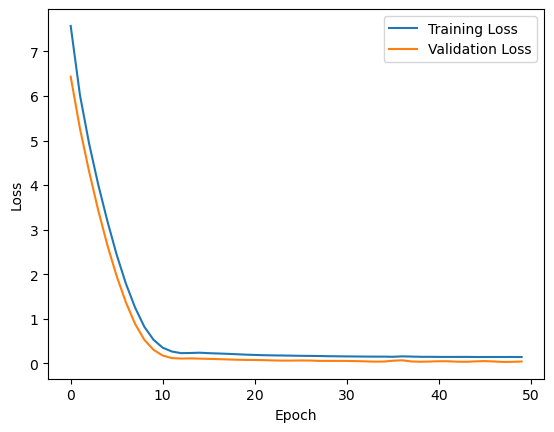

1/1 [==============================] - 1s 653ms/step


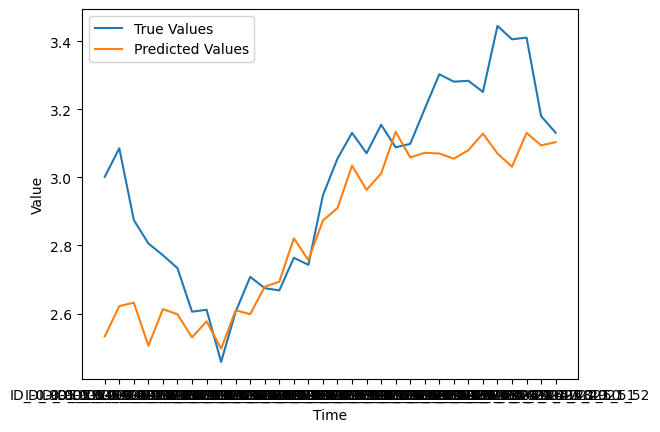

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.117_29.883
Epoch 1/50
3/3 [==============================] - 3s 220ms/step - loss: 3118.9180 - mse: 3118.9180 - accuracy: 0.0000e+00 - val_loss: 3407.9438 - val_mse: 3407.9438 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 36ms/step - loss: 3084.4094 - mse: 3084.4094 - accuracy: 0.0000e+00 - val_loss: 3375.4492 - val_mse: 3375.4492 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 36ms/step - loss: 3055.7175 - mse: 3055.7175 - accuracy: 0.0000e+00 - val_loss: 3345.7881 - val_mse: 3345.7881 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 37ms/step - loss: 3032.6562 - mse: 3032.6562 - accuracy: 0.0000e+00 - val_loss: 3330.1721 - val_mse: 3330.1721 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 36ms/step - loss: 3017.5115 - mse: 3017.5115 - accuracy: 0.0000e+00 - val_loss: 3312.1411 - val_m

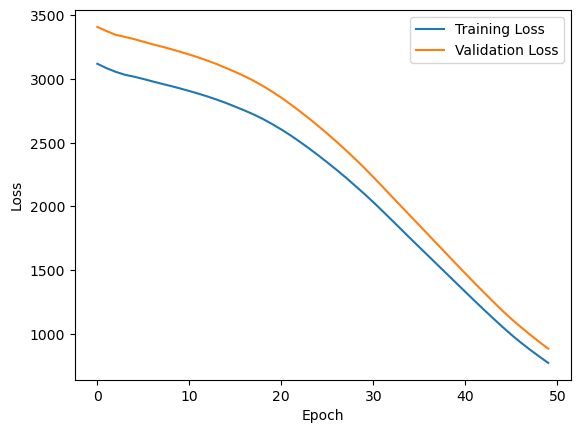

1/1 [==============================] - 0s 402ms/step


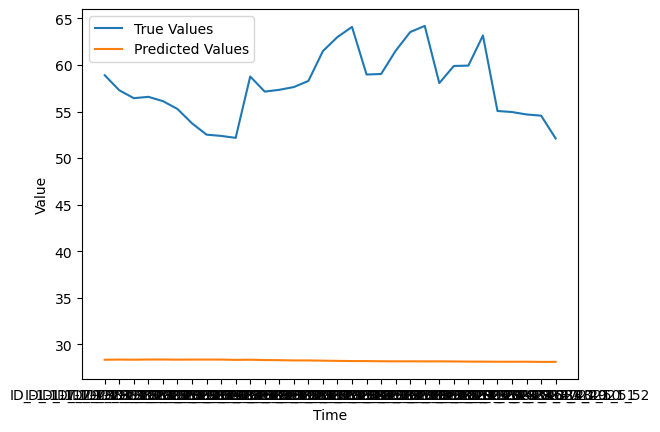

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -1.839_28.761
Epoch 1/50
3/3 [==============================] - 2s 215ms/step - loss: 0.1095 - mse: 0.1095 - accuracy: 1.0000 - val_loss: 0.0294 - val_mse: 0.0294 - val_accuracy: 1.0000
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 0.0116 - mse: 0.0116 - accuracy: 1.0000 - val_loss: 0.0085 - val_mse: 0.0085 - val_accuracy: 1.0000
Epoch 3/50
3/3 [==============================] - 0s 42ms/step - loss: 0.0173 - mse: 0.0173 - accuracy: 1.0000 - val_loss: 0.0223 - val_mse: 0.0223 - val_accuracy: 1.0000
Epoch 4/50
3/3 [==============================] - 0s 34ms/step - loss: 0.0259 - mse: 0.0259 - accuracy: 1.0000 - val_loss: 0.0133 - val_mse: 0.0133 - val_accuracy: 1.0000
Epoch 5/50
3/3 [==============================] - 0s 34ms/step - loss: 0.0128 - mse: 0.0128 - accuracy: 1.0000 - val_loss: 0.0033 - val_mse: 0.0033 - val_accuracy: 1.0000
Epoch 6/50
3/3 [==============================] - 0s 31ms/s

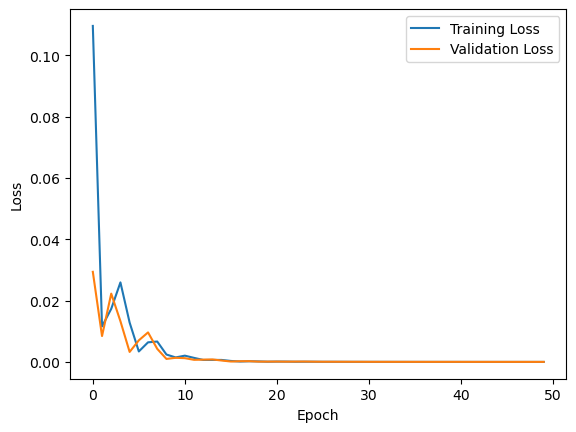

1/1 [==============================] - 1s 503ms/step


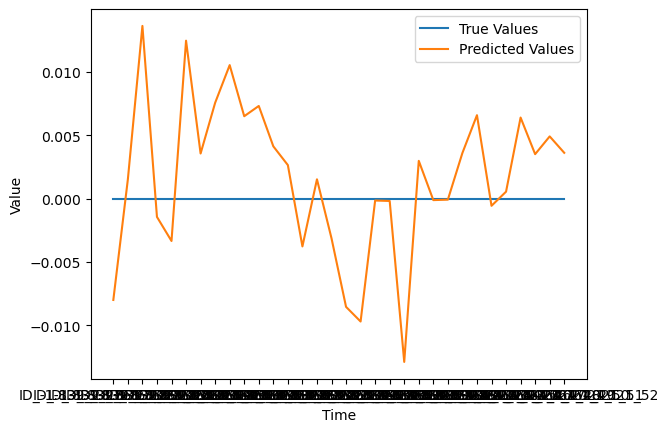

(49, 67)
2/2 [==============================] - 0s 14ms/step
LAT_LONG:  -0.938_29.262
Epoch 1/50
3/3 [==============================] - 2s 232ms/step - loss: 1149.4451 - mse: 1149.4451 - accuracy: 0.0000e+00 - val_loss: 1168.8374 - val_mse: 1168.8374 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 38ms/step - loss: 1134.3767 - mse: 1134.3767 - accuracy: 0.0000e+00 - val_loss: 1153.0425 - val_mse: 1153.0425 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 40ms/step - loss: 1117.8910 - mse: 1117.8910 - accuracy: 0.0000e+00 - val_loss: 1135.2858 - val_mse: 1135.2858 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 51ms/step - loss: 1101.1753 - mse: 1101.1753 - accuracy: 0.0000e+00 - val_loss: 1119.4940 - val_mse: 1119.4940 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 41ms/step - loss: 1085.6487 - mse: 1085.6487 - accuracy: 0.0000e+00 - val_loss: 1103.9443 - val_

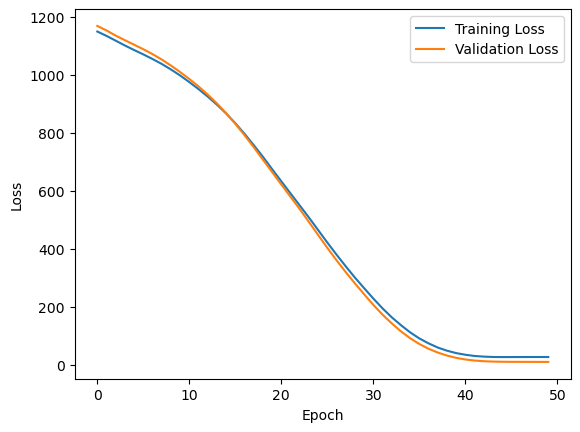

1/1 [==============================] - 1s 895ms/step


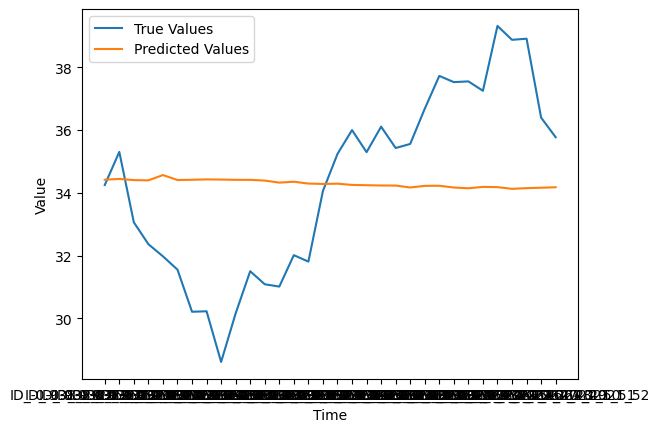

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.497_30.603
Epoch 1/50
3/3 [==============================] - 2s 206ms/step - loss: 495.9622 - mse: 495.9622 - accuracy: 0.0000e+00 - val_loss: 577.3611 - val_mse: 577.3611 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 38ms/step - loss: 482.6779 - mse: 482.6779 - accuracy: 0.0000e+00 - val_loss: 562.7664 - val_mse: 562.7664 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 35ms/step - loss: 470.2861 - mse: 470.2861 - accuracy: 0.0000e+00 - val_loss: 550.4041 - val_mse: 550.4041 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 459.2193 - mse: 459.2193 - accuracy: 0.0000e+00 - val_loss: 538.4077 - val_mse: 538.4077 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 448.1605 - mse: 448.1605 - accuracy: 0.0000e+00 - val_loss: 526.2202 - val_mse: 526.2202 - val_

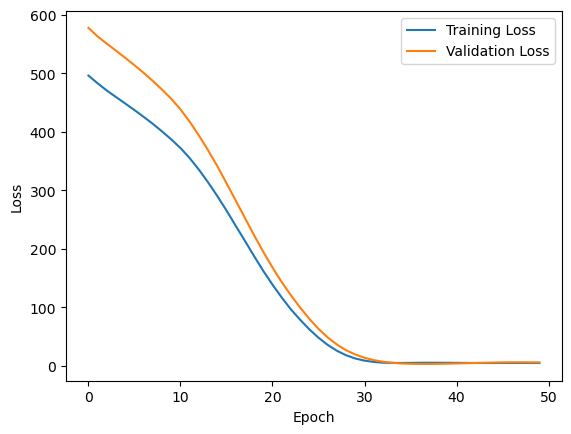

1/1 [==============================] - 0s 481ms/step


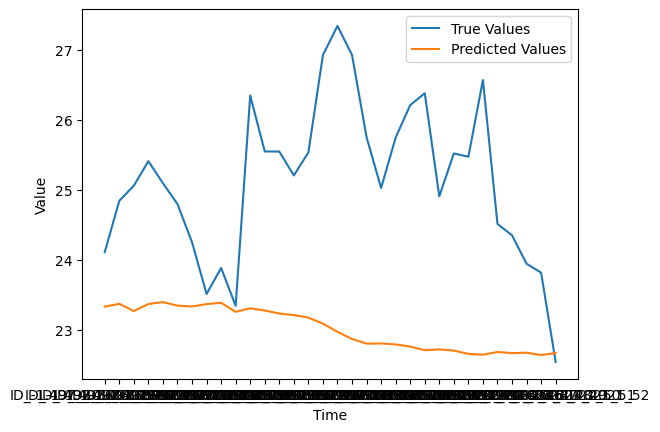

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.9_29.5
Epoch 1/50
3/3 [==============================] - 2s 243ms/step - loss: 53854.0859 - mse: 53854.0859 - accuracy: 0.0000e+00 - val_loss: 55782.6445 - val_mse: 55782.6445 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 53833.9023 - mse: 53833.9023 - accuracy: 0.0000e+00 - val_loss: 55771.3555 - val_mse: 55771.3555 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 35ms/step - loss: 53824.9180 - mse: 53824.9180 - accuracy: 0.0000e+00 - val_loss: 55765.0391 - val_mse: 55765.0391 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 53814.3828 - mse: 53814.3828 - accuracy: 0.0000e+00 - val_loss: 55745.5352 - val_mse: 55745.5352 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 53789.2734 - mse: 53789.2734 - accuracy: 0.0000e+00 - val_loss: 557

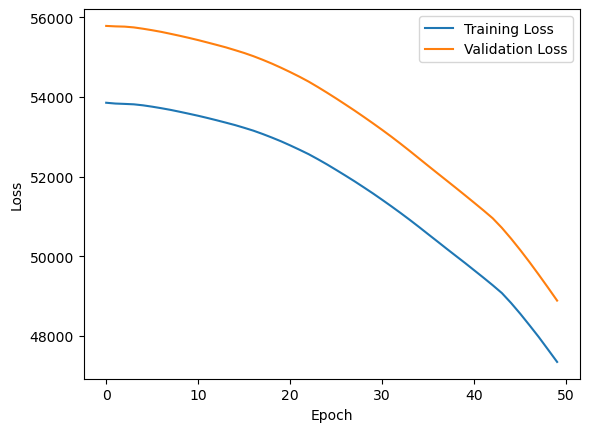

1/1 [==============================] - 0s 346ms/step


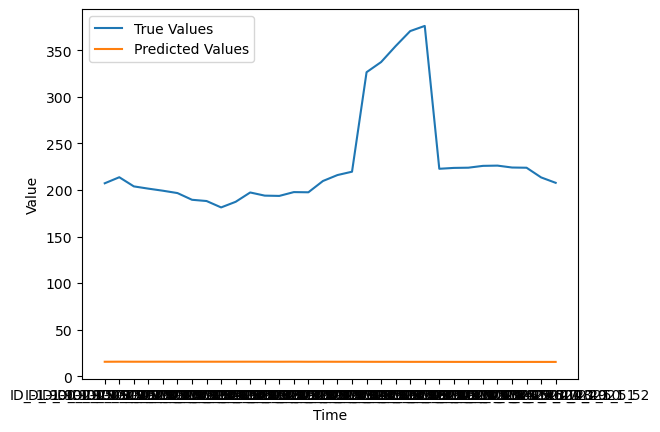

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.045_30.455
Epoch 1/50
3/3 [==============================] - 3s 214ms/step - loss: 27498.2402 - mse: 27498.2402 - accuracy: 0.0000e+00 - val_loss: 28691.0742 - val_mse: 28691.0742 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 35ms/step - loss: 27344.3887 - mse: 27344.3887 - accuracy: 0.0000e+00 - val_loss: 28531.8086 - val_mse: 28531.8086 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 36ms/step - loss: 27199.3828 - mse: 27199.3828 - accuracy: 0.0000e+00 - val_loss: 28403.2793 - val_mse: 28403.2793 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 27076.6270 - mse: 27076.6270 - accuracy: 0.0000e+00 - val_loss: 28279.0117 - val_mse: 28279.0117 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 26956.7383 - mse: 26956.7383 - accuracy: 0.0000e+00 - val_loss:

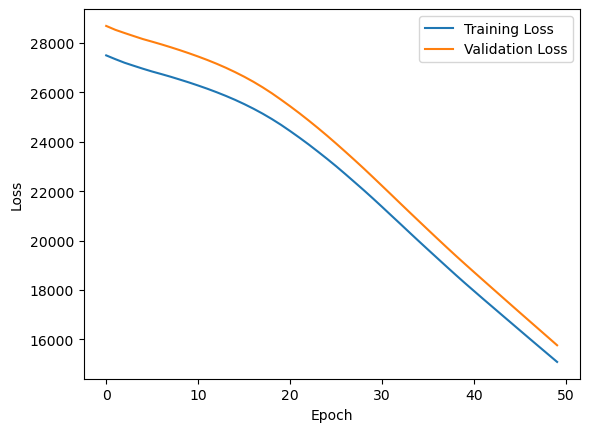

1/1 [==============================] - 0s 386ms/step


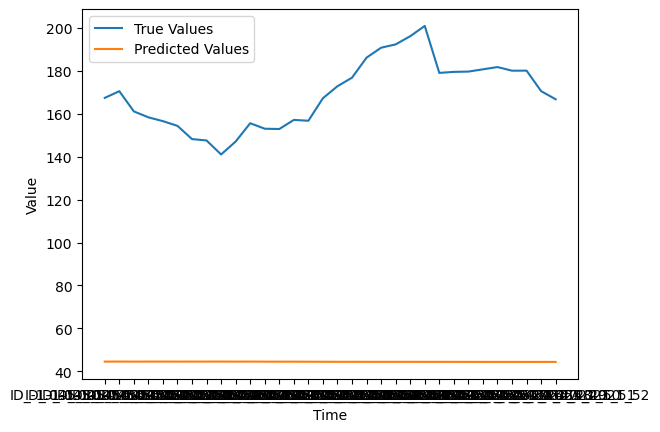

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.51_30.19
Epoch 1/50
3/3 [==============================] - 2s 272ms/step - loss: 57267.5195 - mse: 57267.5195 - accuracy: 0.0000e+00 - val_loss: 59943.2188 - val_mse: 59943.2188 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 38ms/step - loss: 57076.2539 - mse: 57076.2539 - accuracy: 0.0000e+00 - val_loss: 59755.8398 - val_mse: 59755.8398 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 33ms/step - loss: 56911.4492 - mse: 56911.4492 - accuracy: 0.0000e+00 - val_loss: 59617.8828 - val_mse: 59617.8828 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 37ms/step - loss: 56791.7266 - mse: 56791.7266 - accuracy: 0.0000e+00 - val_loss: 59507.6797 - val_mse: 59507.6797 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 37ms/step - loss: 56689.0859 - mse: 56689.0859 - accuracy: 0.0000e+00 - val_loss: 5

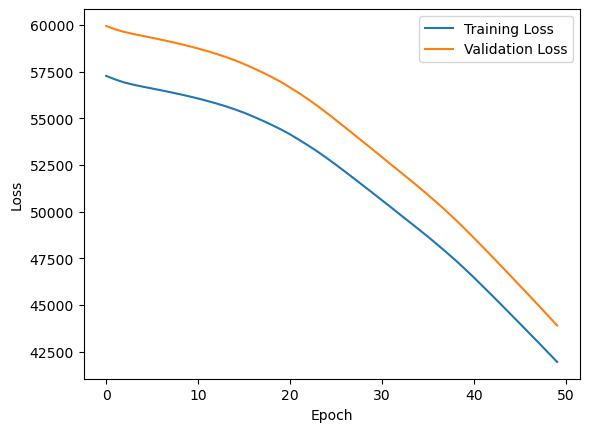

1/1 [==============================] - 1s 509ms/step


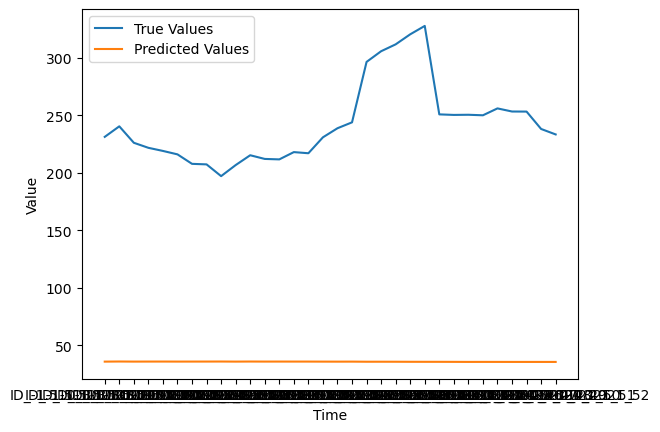

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -1.682_29.218
Epoch 1/50
3/3 [==============================] - 2s 213ms/step - loss: 0.0334 - mse: 0.0334 - accuracy: 1.0000 - val_loss: 0.0014 - val_mse: 0.0014 - val_accuracy: 1.0000
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 0.0018 - mse: 0.0018 - accuracy: 1.0000 - val_loss: 0.0081 - val_mse: 0.0081 - val_accuracy: 1.0000
Epoch 3/50
3/3 [==============================] - 0s 33ms/step - loss: 0.0100 - mse: 0.0100 - accuracy: 1.0000 - val_loss: 0.0085 - val_mse: 0.0085 - val_accuracy: 1.0000
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 0.0068 - mse: 0.0068 - accuracy: 1.0000 - val_loss: 0.0013 - val_mse: 0.0013 - val_accuracy: 1.0000
Epoch 5/50
3/3 [==============================] - 0s 36ms/step - loss: 7.0678e-04 - mse: 7.0678e-04 - accuracy: 1.0000 - val_loss: 9.8216e-04 - val_mse: 9.8216e-04 - val_accuracy: 1.0000
Epoch 6/50
3/3 [===========================

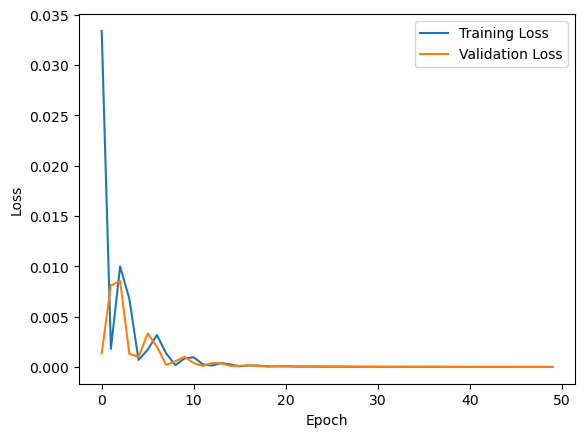

1/1 [==============================] - 0s 364ms/step


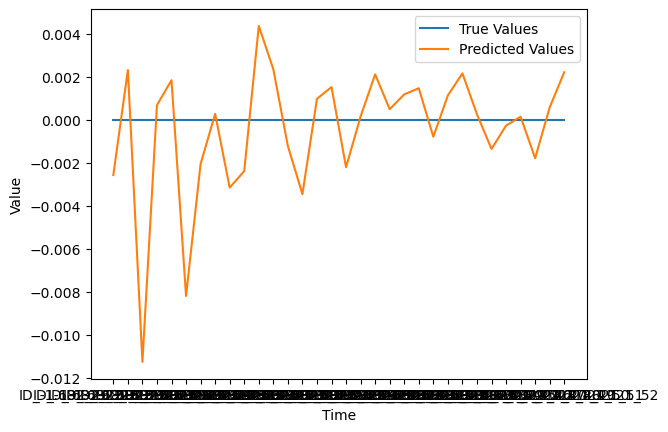

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.923_29.777
Epoch 1/50
3/3 [==============================] - 2s 255ms/step - loss: 18641.4023 - mse: 18641.4023 - accuracy: 0.0000e+00 - val_loss: 18962.9922 - val_mse: 18962.9922 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 54ms/step - loss: 18531.2129 - mse: 18531.2129 - accuracy: 0.0000e+00 - val_loss: 18856.3477 - val_mse: 18856.3477 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 43ms/step - loss: 18426.6836 - mse: 18426.6836 - accuracy: 0.0000e+00 - val_loss: 18750.4336 - val_mse: 18750.4336 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 42ms/step - loss: 18325.0195 - mse: 18325.0195 - accuracy: 0.0000e+00 - val_loss: 18654.4590 - val_mse: 18654.4590 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 39ms/step - loss: 18239.3262 - mse: 18239.3262 - accuracy: 0.0000e+00 - val_loss:

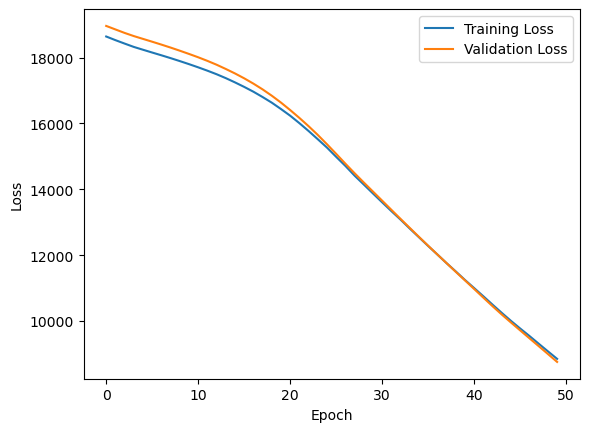

1/1 [==============================] - 0s 401ms/step


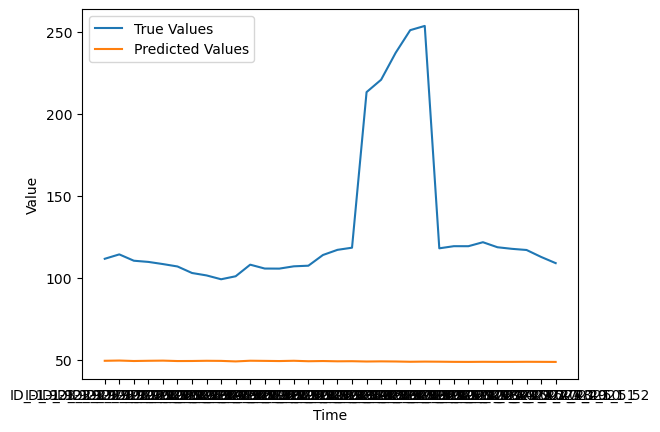

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.583_29.617
Epoch 1/50
3/3 [==============================] - 2s 213ms/step - loss: 16279.6611 - mse: 16279.6611 - accuracy: 0.0000e+00 - val_loss: 16902.5645 - val_mse: 16902.5645 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 34ms/step - loss: 16210.5840 - mse: 16210.5840 - accuracy: 0.0000e+00 - val_loss: 16844.6035 - val_mse: 16844.6035 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 32ms/step - loss: 16160.0928 - mse: 16160.0928 - accuracy: 0.0000e+00 - val_loss: 16805.8301 - val_mse: 16805.8301 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 16125.4941 - mse: 16125.4941 - accuracy: 0.0000e+00 - val_loss: 16779.3398 - val_mse: 16779.3398 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 16101.8057 - mse: 16101.8057 - accuracy: 0.0000e+00 - val_loss:

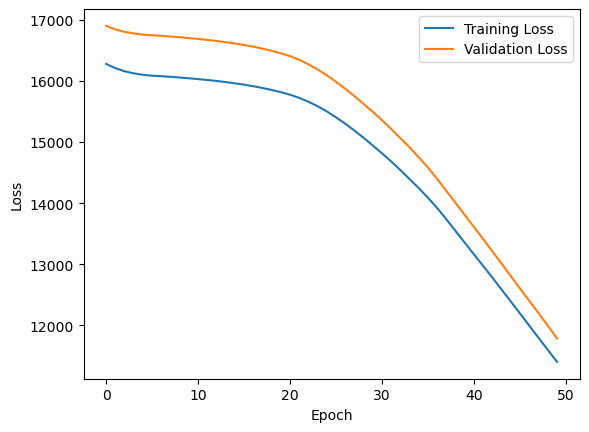

1/1 [==============================] - 0s 380ms/step


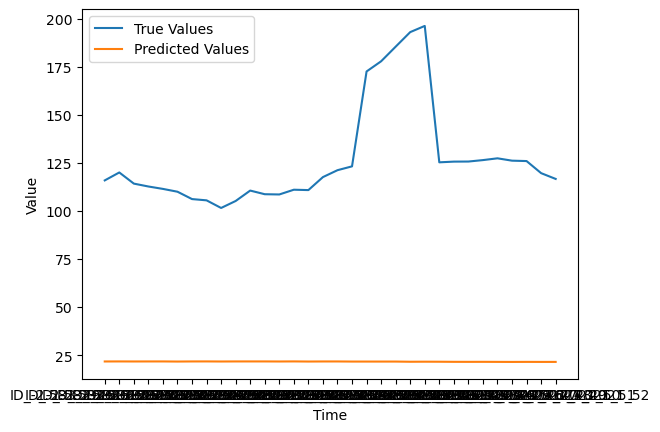

(49, 67)
2/2 [==============================] - 0s 9ms/step
LAT_LONG:  -2.656_30.944
Epoch 1/50
3/3 [==============================] - 3s 207ms/step - loss: 1941.0093 - mse: 1941.0093 - accuracy: 0.0000e+00 - val_loss: 2036.6023 - val_mse: 2036.6023 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 37ms/step - loss: 1912.7335 - mse: 1912.7335 - accuracy: 0.0000e+00 - val_loss: 2012.1761 - val_mse: 2012.1761 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 34ms/step - loss: 1890.6425 - mse: 1890.6425 - accuracy: 0.0000e+00 - val_loss: 1991.8533 - val_mse: 1991.8533 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 1871.2515 - mse: 1871.2515 - accuracy: 0.0000e+00 - val_loss: 1970.3801 - val_mse: 1970.3801 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 35ms/step - loss: 1850.3157 - mse: 1850.3157 - accuracy: 0.0000e+00 - val_loss: 1946.8824 - val_m

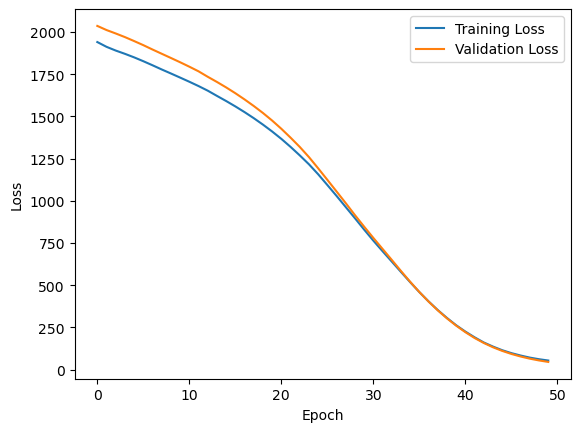

1/1 [==============================] - 0s 390ms/step


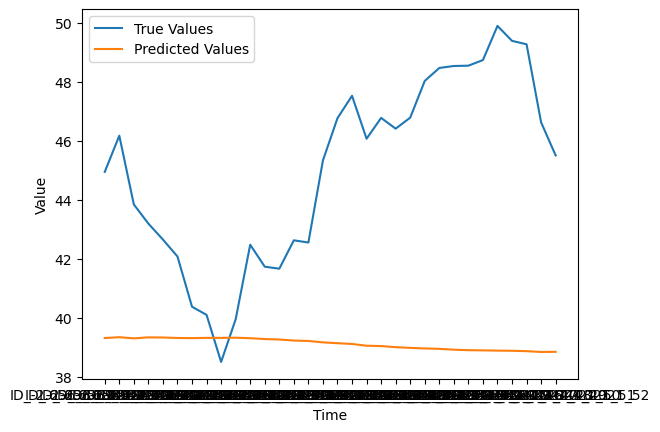

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -3.016_30.584
Epoch 1/50
3/3 [==============================] - 2s 223ms/step - loss: 35.5261 - mse: 35.5261 - accuracy: 0.0000e+00 - val_loss: 30.5658 - val_mse: 30.5658 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 36ms/step - loss: 32.6239 - mse: 32.6239 - accuracy: 0.0000e+00 - val_loss: 27.8434 - val_mse: 27.8434 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 29.9502 - mse: 29.9502 - accuracy: 0.0000e+00 - val_loss: 25.4350 - val_mse: 25.4350 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 34ms/step - loss: 27.4631 - mse: 27.4631 - accuracy: 0.0000e+00 - val_loss: 23.1125 - val_mse: 23.1125 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 35ms/step - loss: 25.0683 - mse: 25.0683 - accuracy: 0.0000e+00 - val_loss: 20.8377 - val_mse: 20.8377 - val_accuracy: 0.0000e+00

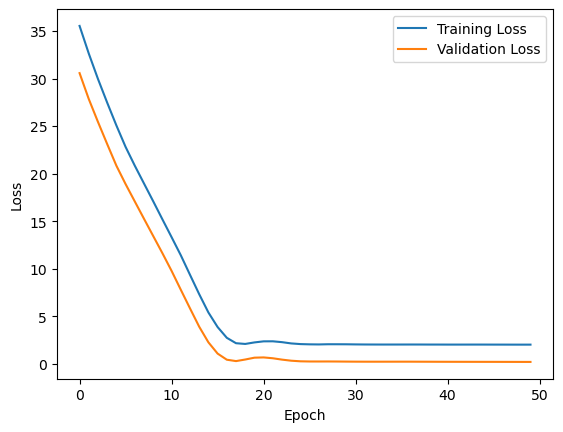

1/1 [==============================] - 0s 388ms/step


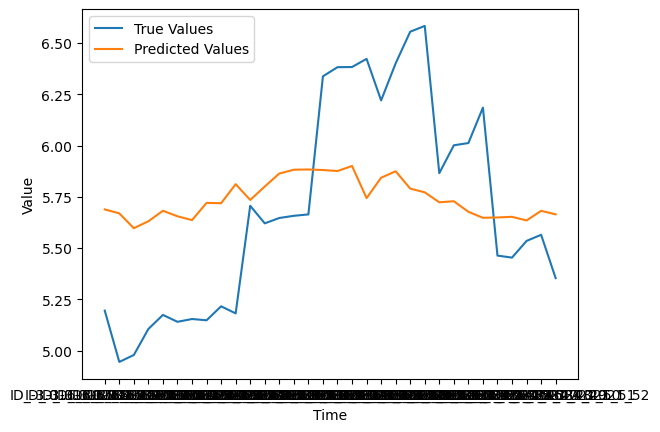

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -1.641_31.259
Epoch 1/50
3/3 [==============================] - 2s 238ms/step - loss: 95714.4688 - mse: 95714.4688 - accuracy: 0.0000e+00 - val_loss: 99438.3750 - val_mse: 99438.3750 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 35ms/step - loss: 95453.3828 - mse: 95453.3828 - accuracy: 0.0000e+00 - val_loss: 99182.0625 - val_mse: 99182.0625 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 36ms/step - loss: 95209.0000 - mse: 95209.0000 - accuracy: 0.0000e+00 - val_loss: 98945.1094 - val_mse: 98945.1094 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 94982.1406 - mse: 94982.1406 - accuracy: 0.0000e+00 - val_loss: 98717.6641 - val_mse: 98717.6641 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 34ms/step - loss: 94761.3750 - mse: 94761.3750 - accuracy: 0.0000e+00 - val_loss:

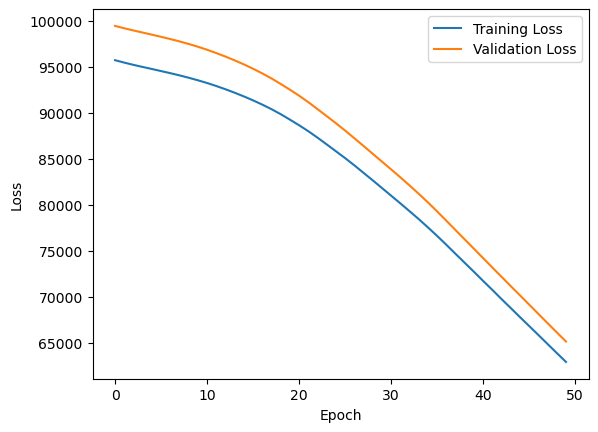

1/1 [==============================] - 0s 385ms/step


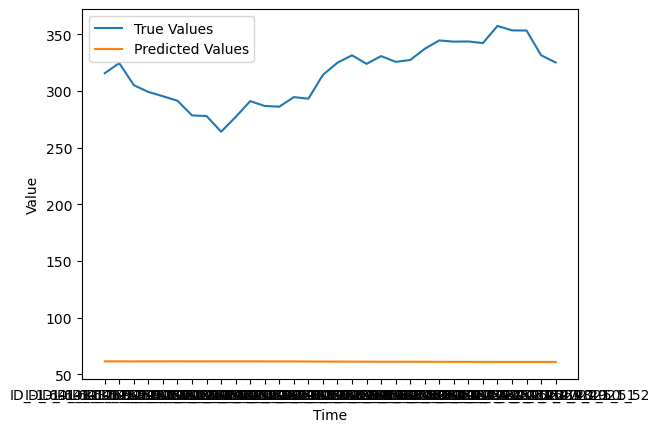

(49, 67)
2/2 [==============================] - 1s 6ms/step
LAT_LONG:  -3.174_29.926
Epoch 1/50
3/3 [==============================] - 2s 223ms/step - loss: 1934.6882 - mse: 1934.6882 - accuracy: 0.0000e+00 - val_loss: 2054.6592 - val_mse: 2054.6592 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 1907.4896 - mse: 1907.4896 - accuracy: 0.0000e+00 - val_loss: 2027.1765 - val_mse: 2027.1765 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 35ms/step - loss: 1880.4425 - mse: 1880.4425 - accuracy: 0.0000e+00 - val_loss: 1998.7958 - val_mse: 1998.7958 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 49ms/step - loss: 1852.3580 - mse: 1852.3580 - accuracy: 0.0000e+00 - val_loss: 1968.9636 - val_mse: 1968.9636 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 1823.1156 - mse: 1823.1156 - accuracy: 0.0000e+00 - val_loss: 1937.6404 - val_m

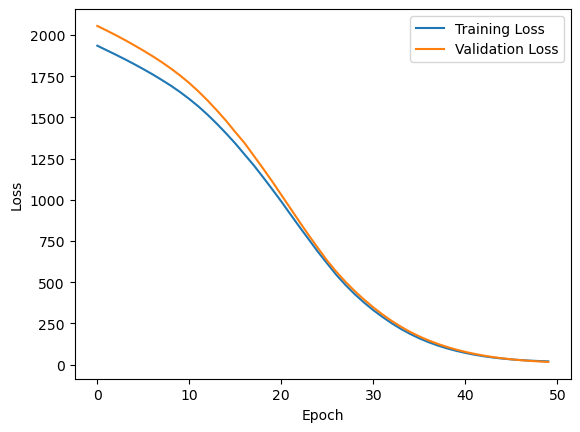

1/1 [==============================] - 0s 398ms/step


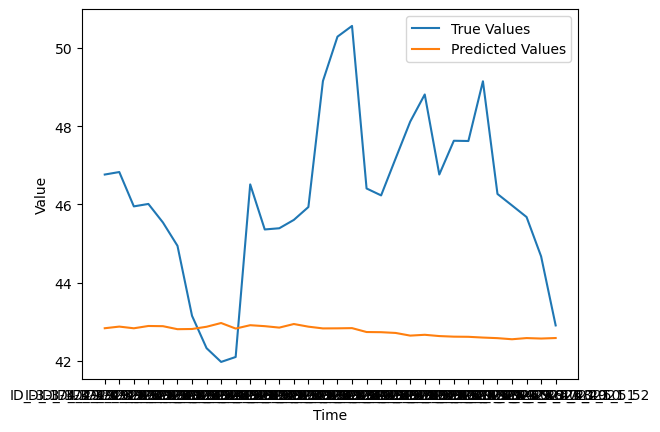

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.176_31.524
Epoch 1/50
3/3 [==============================] - 2s 231ms/step - loss: 201.3100 - mse: 201.3100 - accuracy: 0.0000e+00 - val_loss: 232.9692 - val_mse: 232.9692 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 32ms/step - loss: 194.1552 - mse: 194.1552 - accuracy: 0.0000e+00 - val_loss: 225.9085 - val_mse: 225.9085 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 39ms/step - loss: 188.4187 - mse: 188.4187 - accuracy: 0.0000e+00 - val_loss: 220.3382 - val_mse: 220.3382 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 35ms/step - loss: 183.3012 - mse: 183.3012 - accuracy: 0.0000e+00 - val_loss: 214.6595 - val_mse: 214.6595 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 34ms/step - loss: 178.0498 - mse: 178.0498 - accuracy: 0.0000e+00 - val_loss: 208.7821 - val_mse: 208.7821 - val_

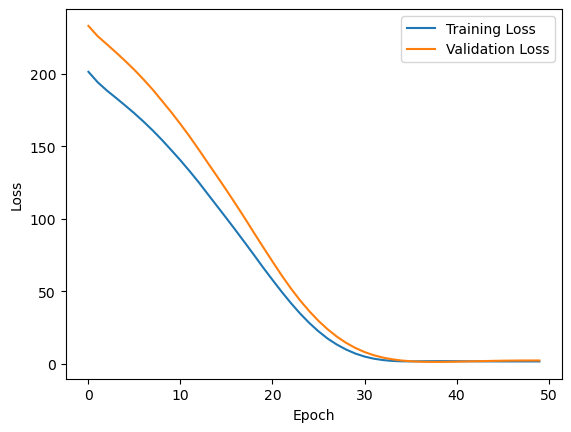

1/1 [==============================] - 0s 326ms/step


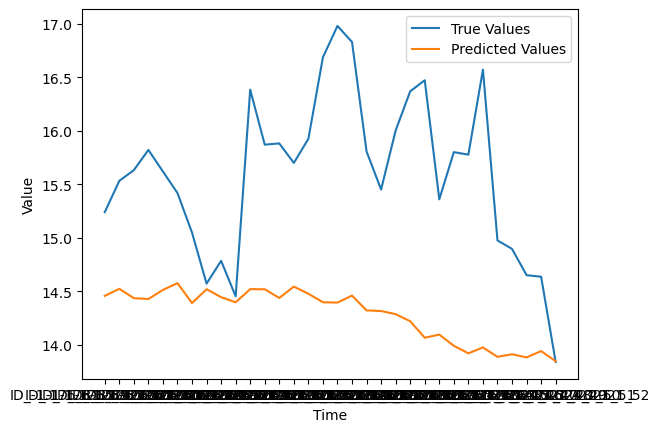

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -2.254_30.446
Epoch 1/50
3/3 [==============================] - 2s 209ms/step - loss: 5769.4399 - mse: 5769.4399 - accuracy: 0.0000e+00 - val_loss: 5883.8467 - val_mse: 5883.8467 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 34ms/step - loss: 5723.7378 - mse: 5723.7378 - accuracy: 0.0000e+00 - val_loss: 5840.3389 - val_mse: 5840.3389 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 33ms/step - loss: 5681.1846 - mse: 5681.1846 - accuracy: 0.0000e+00 - val_loss: 5797.0859 - val_mse: 5797.0859 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 37ms/step - loss: 5638.8042 - mse: 5638.8042 - accuracy: 0.0000e+00 - val_loss: 5752.4707 - val_mse: 5752.4707 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 35ms/step - loss: 5596.1714 - mse: 5596.1714 - accuracy: 0.0000e+00 - val_loss: 5711.9297 - val_m

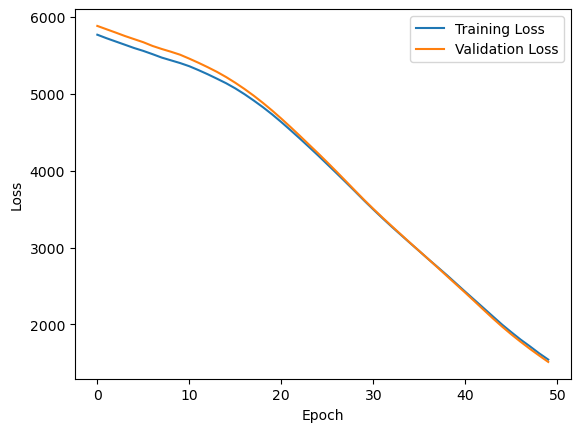

1/1 [==============================] - 0s 379ms/step


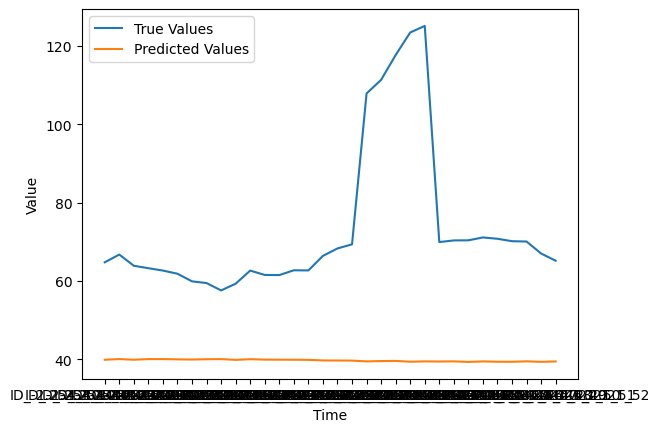

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -2.329_28.671
Epoch 1/50
3/3 [==============================] - 2s 221ms/step - loss: 665.3135 - mse: 665.3135 - accuracy: 0.0000e+00 - val_loss: 619.3992 - val_mse: 619.3992 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 35ms/step - loss: 640.3892 - mse: 640.3892 - accuracy: 0.0000e+00 - val_loss: 596.4058 - val_mse: 596.4058 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 36ms/step - loss: 618.8683 - mse: 618.8683 - accuracy: 0.0000e+00 - val_loss: 576.2505 - val_mse: 576.2505 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 599.9630 - mse: 599.9630 - accuracy: 0.0000e+00 - val_loss: 557.8181 - val_mse: 557.8181 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 582.0547 - mse: 582.0547 - accuracy: 0.0000e+00 - val_loss: 540.1289 - val_mse: 540.1289 - val_

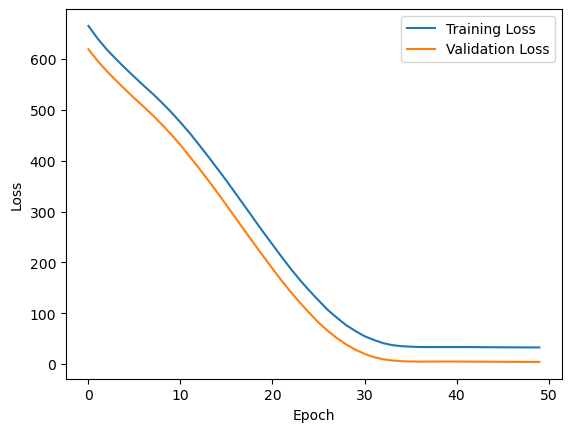

1/1 [==============================] - 0s 351ms/step


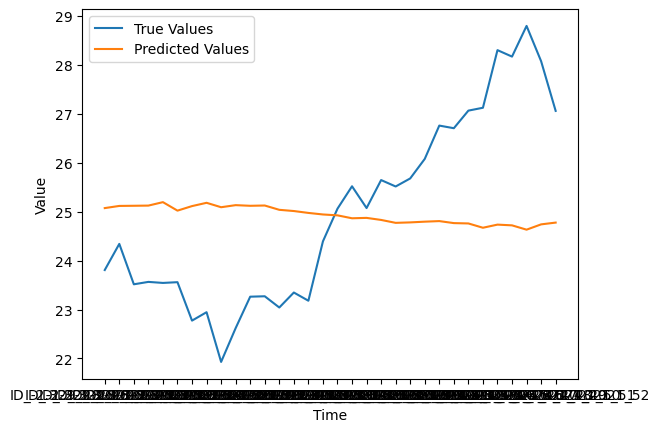

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -2.082_30.418
Epoch 1/50
3/3 [==============================] - 2s 213ms/step - loss: 1125.0293 - mse: 1125.0293 - accuracy: 0.0000e+00 - val_loss: 1046.9779 - val_mse: 1046.9779 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 31ms/step - loss: 1109.5560 - mse: 1109.5560 - accuracy: 0.0000e+00 - val_loss: 1032.5515 - val_mse: 1032.5515 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 33ms/step - loss: 1095.4159 - mse: 1095.4159 - accuracy: 0.0000e+00 - val_loss: 1018.3561 - val_mse: 1018.3561 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 1081.1204 - mse: 1081.1204 - accuracy: 0.0000e+00 - val_loss: 1004.2264 - val_mse: 1004.2264 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 34ms/step - loss: 1067.3629 - mse: 1067.3629 - accuracy: 0.0000e+00 - val_loss: 989.7218 - val_ms

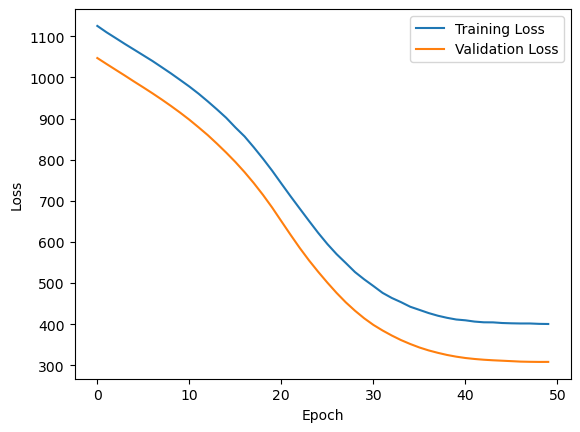

1/1 [==============================] - 0s 364ms/step


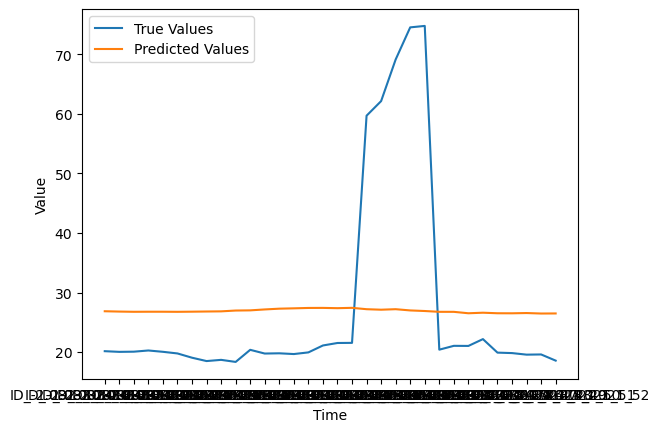

(49, 67)
2/2 [==============================] - 0s 13ms/step
LAT_LONG:  -1.187_31.113
Epoch 1/50
3/3 [==============================] - 3s 214ms/step - loss: 102857.3281 - mse: 102857.3281 - accuracy: 0.0000e+00 - val_loss: 105127.8281 - val_mse: 105127.8281 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 37ms/step - loss: 102661.9219 - mse: 102661.9219 - accuracy: 0.0000e+00 - val_loss: 104939.8203 - val_mse: 104939.8203 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 33ms/step - loss: 102487.0859 - mse: 102487.0859 - accuracy: 0.0000e+00 - val_loss: 104769.1953 - val_mse: 104769.1953 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 102319.6328 - mse: 102319.6328 - accuracy: 0.0000e+00 - val_loss: 104595.5312 - val_mse: 104595.5312 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 102144.5234 - mse: 102144.5234 - accuracy: 0.0

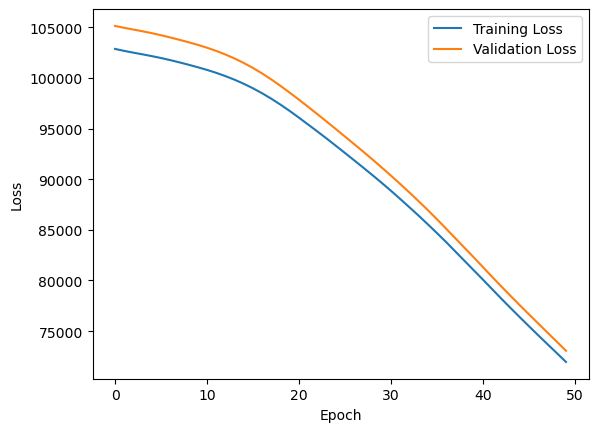

1/1 [==============================] - 0s 411ms/step


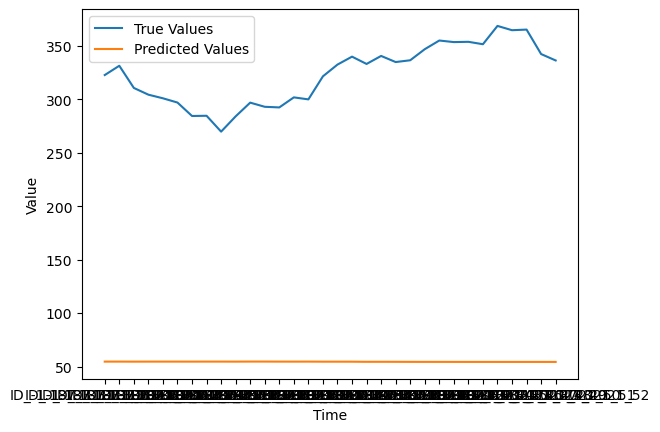

(49, 67)
2/2 [==============================] - 1s 6ms/step
LAT_LONG:  -1.683_29.617
Epoch 1/50
3/3 [==============================] - 2s 240ms/step - loss: 61042.5352 - mse: 61042.5352 - accuracy: 0.0000e+00 - val_loss: 63199.3281 - val_mse: 63199.3281 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 60887.3477 - mse: 60887.3477 - accuracy: 0.0000e+00 - val_loss: 63048.1484 - val_mse: 63048.1484 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 32ms/step - loss: 60743.6328 - mse: 60743.6328 - accuracy: 0.0000e+00 - val_loss: 62918.1484 - val_mse: 62918.1484 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 35ms/step - loss: 60621.3711 - mse: 60621.3711 - accuracy: 0.0000e+00 - val_loss: 62791.6445 - val_mse: 62791.6445 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 60492.9727 - mse: 60492.9727 - accuracy: 0.0000e+00 - val_loss:

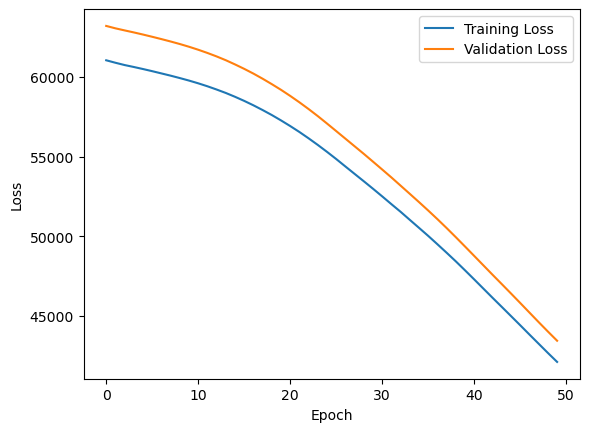

1/1 [==============================] - 0s 352ms/step


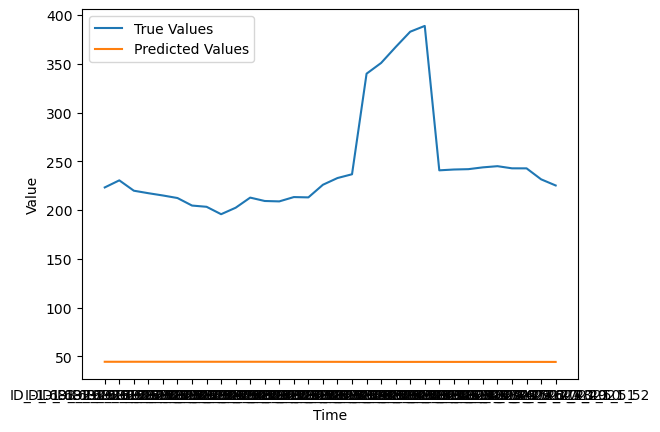

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -2.248_28.652
Epoch 1/50
3/3 [==============================] - 2s 210ms/step - loss: 513.0925 - mse: 513.0925 - accuracy: 0.0000e+00 - val_loss: 507.6714 - val_mse: 507.6714 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 32ms/step - loss: 496.6485 - mse: 496.6485 - accuracy: 0.0000e+00 - val_loss: 491.8389 - val_mse: 491.8389 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 35ms/step - loss: 480.5815 - mse: 480.5815 - accuracy: 0.0000e+00 - val_loss: 475.5239 - val_mse: 475.5239 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 463.6831 - mse: 463.6831 - accuracy: 0.0000e+00 - val_loss: 458.7137 - val_mse: 458.7137 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 447.3503 - mse: 447.3503 - accuracy: 0.0000e+00 - val_loss: 443.0833 - val_mse: 443.0833 - val_

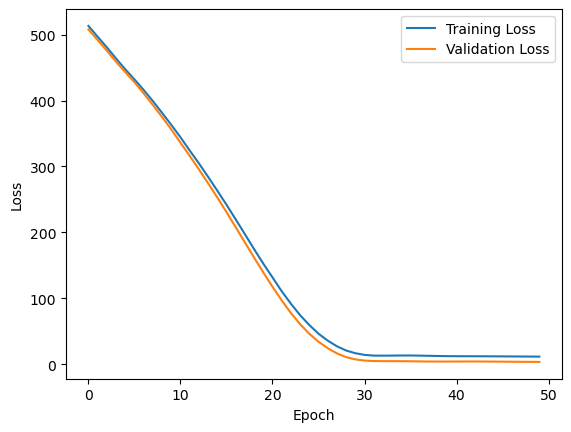

1/1 [==============================] - 0s 397ms/step


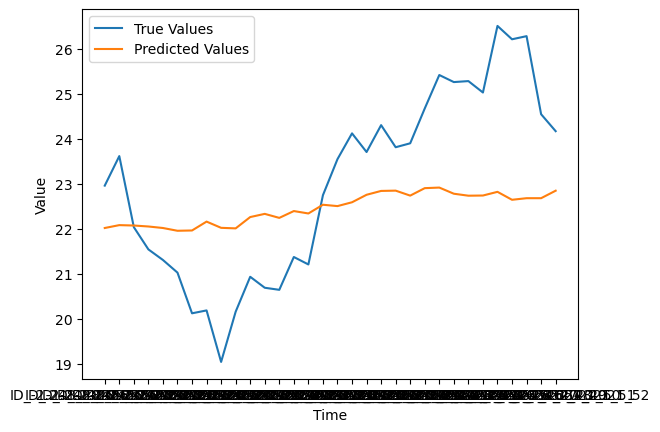

(49, 67)
2/2 [==============================] - 0s 24ms/step
LAT_LONG:  -2.817_29.283
Epoch 1/50
3/3 [==============================] - 2s 226ms/step - loss: 0.0067 - mse: 0.0067 - accuracy: 1.0000 - val_loss: 0.0031 - val_mse: 0.0031 - val_accuracy: 1.0000
Epoch 2/50
3/3 [==============================] - 0s 37ms/step - loss: 0.0037 - mse: 0.0037 - accuracy: 1.0000 - val_loss: 0.0018 - val_mse: 0.0018 - val_accuracy: 1.0000
Epoch 3/50
3/3 [==============================] - 0s 37ms/step - loss: 0.0016 - mse: 0.0016 - accuracy: 1.0000 - val_loss: 0.0022 - val_mse: 0.0022 - val_accuracy: 1.0000
Epoch 4/50
3/3 [==============================] - 0s 34ms/step - loss: 0.0010 - mse: 0.0010 - accuracy: 1.0000 - val_loss: 5.0299e-04 - val_mse: 5.0299e-04 - val_accuracy: 1.0000
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 5.9879e-04 - mse: 5.9879e-04 - accuracy: 1.0000 - val_loss: 3.7623e-04 - val_mse: 3.7623e-04 - val_accuracy: 1.0000
Epoch 6/50
3/3 [==================

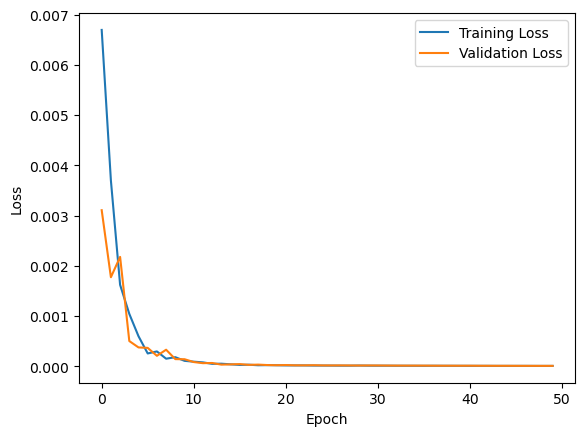

1/1 [==============================] - 0s 346ms/step


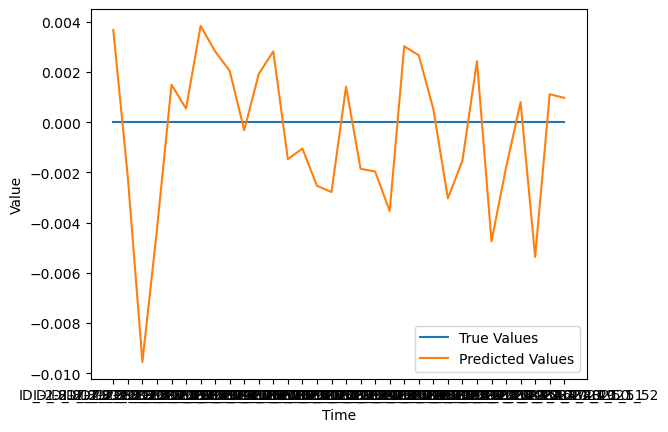

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.492_30.308
Epoch 1/50
3/3 [==============================] - 2s 228ms/step - loss: 74.7802 - mse: 74.7802 - accuracy: 0.0000e+00 - val_loss: 73.9838 - val_mse: 73.9838 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 71.4113 - mse: 71.4113 - accuracy: 0.0000e+00 - val_loss: 70.6875 - val_mse: 70.6875 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 36ms/step - loss: 68.1998 - mse: 68.1998 - accuracy: 0.0000e+00 - val_loss: 67.0279 - val_mse: 67.0279 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 36ms/step - loss: 64.5581 - mse: 64.5581 - accuracy: 0.0000e+00 - val_loss: 63.0773 - val_mse: 63.0773 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 34ms/step - loss: 60.5992 - mse: 60.5992 - accuracy: 0.0000e+00 - val_loss: 58.9091 - val_mse: 58.9091 - val_accuracy: 0.0000e+00

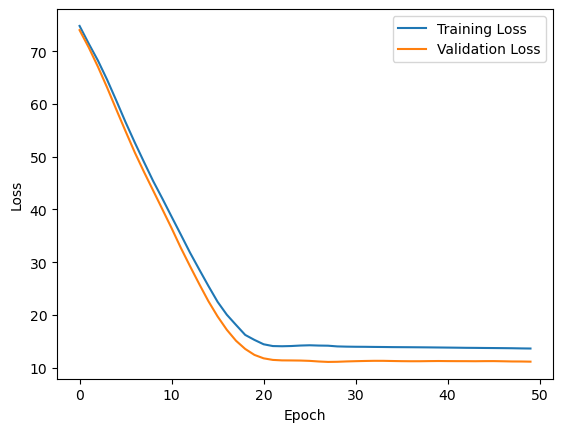

1/1 [==============================] - 0s 332ms/step


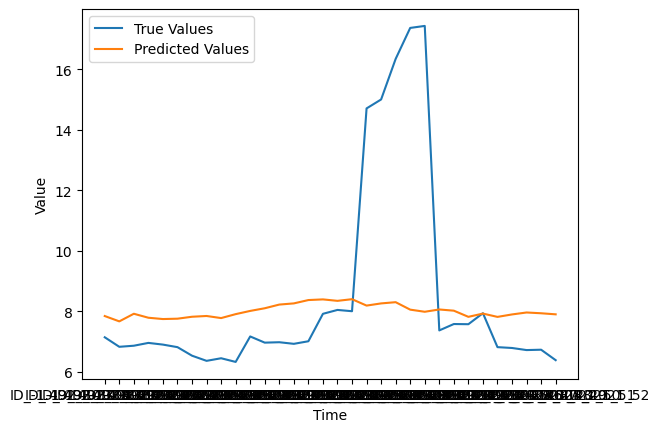

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.737_30.063
Epoch 1/50
3/3 [==============================] - 3s 221ms/step - loss: 9822.5605 - mse: 9822.5605 - accuracy: 0.0000e+00 - val_loss: 9856.9258 - val_mse: 9856.9258 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 32ms/step - loss: 9721.2988 - mse: 9721.2988 - accuracy: 0.0000e+00 - val_loss: 9759.8496 - val_mse: 9759.8496 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 36ms/step - loss: 9634.3252 - mse: 9634.3252 - accuracy: 0.0000e+00 - val_loss: 9692.9336 - val_mse: 9692.9336 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 35ms/step - loss: 9568.3809 - mse: 9568.3818 - accuracy: 0.0000e+00 - val_loss: 9624.7344 - val_mse: 9624.7344 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 9502.5518 - mse: 9502.5518 - accuracy: 0.0000e+00 - val_loss: 9557.0283 - val_m

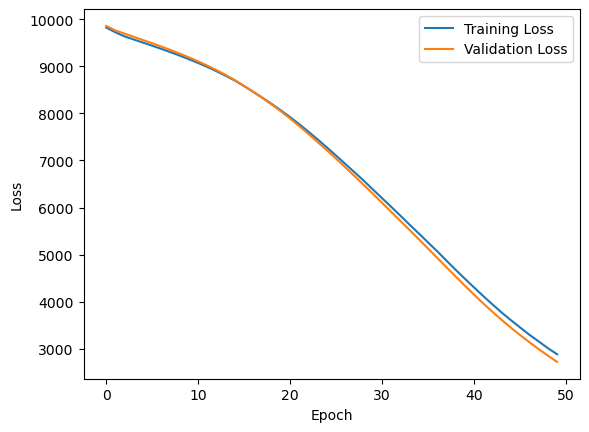

1/1 [==============================] - 0s 341ms/step


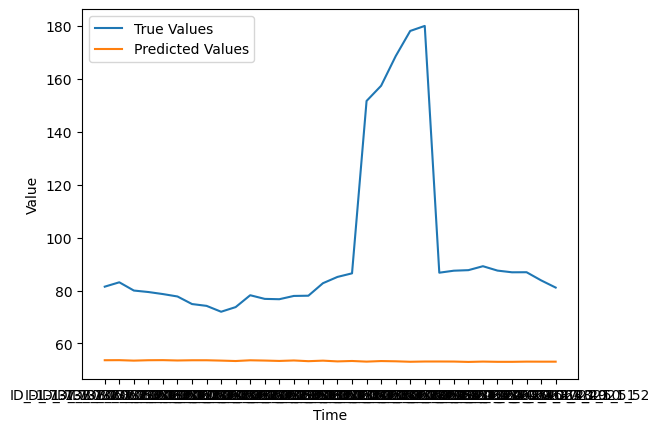

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -2.339_28.461
Epoch 1/50
3/3 [==============================] - 2s 217ms/step - loss: 232.6006 - mse: 232.6006 - accuracy: 0.0000e+00 - val_loss: 222.2126 - val_mse: 222.2126 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 34ms/step - loss: 222.1998 - mse: 222.1998 - accuracy: 0.0000e+00 - val_loss: 214.4553 - val_mse: 214.4553 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 35ms/step - loss: 215.5976 - mse: 215.5976 - accuracy: 0.0000e+00 - val_loss: 209.2088 - val_mse: 209.2088 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 41ms/step - loss: 210.7132 - mse: 210.7132 - accuracy: 0.0000e+00 - val_loss: 204.8323 - val_mse: 204.8323 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 39ms/step - loss: 206.6100 - mse: 206.6100 - accuracy: 0.0000e+00 - val_loss: 200.6004 - val_mse: 200.6004 - val_

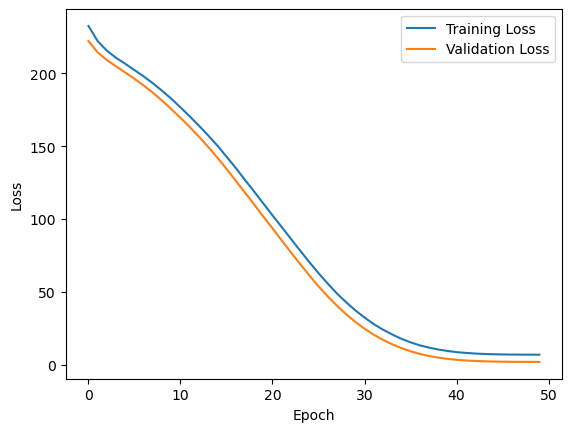

1/1 [==============================] - 0s 352ms/step


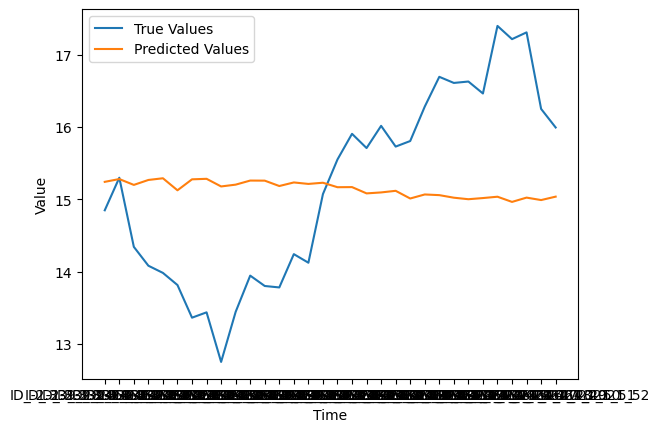

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.293_29.507
Epoch 1/50
3/3 [==============================] - 2s 229ms/step - loss: 119443.8828 - mse: 119443.8828 - accuracy: 0.0000e+00 - val_loss: 123475.5312 - val_mse: 123475.5312 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 34ms/step - loss: 119274.1719 - mse: 119274.1719 - accuracy: 0.0000e+00 - val_loss: 123308.2812 - val_mse: 123308.2812 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 32ms/step - loss: 119106.8984 - mse: 119106.8984 - accuracy: 0.0000e+00 - val_loss: 123145.9531 - val_mse: 123145.9531 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 118956.7188 - mse: 118956.7188 - accuracy: 0.0000e+00 - val_loss: 122997.4531 - val_mse: 122997.4531 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 36ms/step - loss: 118807.3516 - mse: 118807.3516 - accuracy: 0.00

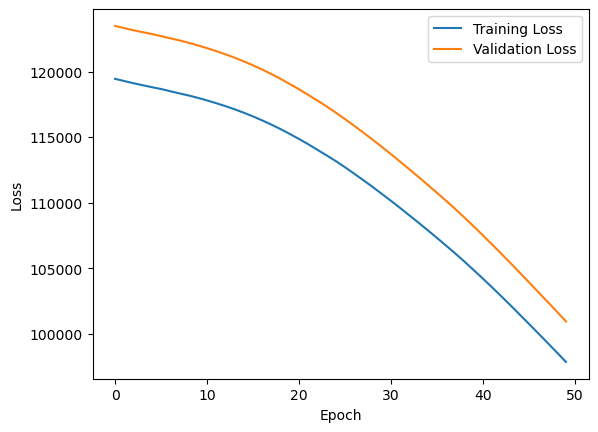

1/1 [==============================] - 0s 374ms/step


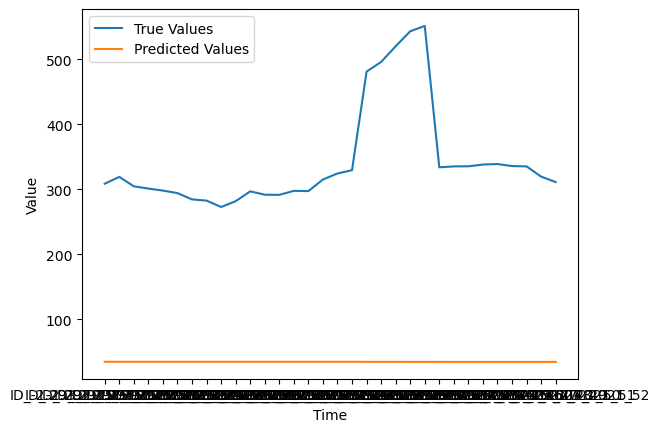

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -1.068_31.332
Epoch 1/50
3/3 [==============================] - 2s 214ms/step - loss: 833.8305 - mse: 833.8305 - accuracy: 0.0000e+00 - val_loss: 880.0007 - val_mse: 880.0007 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 35ms/step - loss: 821.3818 - mse: 821.3818 - accuracy: 0.0000e+00 - val_loss: 867.2677 - val_mse: 867.2677 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 34ms/step - loss: 808.8230 - mse: 808.8230 - accuracy: 0.0000e+00 - val_loss: 854.2073 - val_mse: 854.2073 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 795.7103 - mse: 795.7103 - accuracy: 0.0000e+00 - val_loss: 840.5785 - val_mse: 840.5785 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 782.1127 - mse: 782.1127 - accuracy: 0.0000e+00 - val_loss: 825.9523 - val_mse: 825.9523 - val_

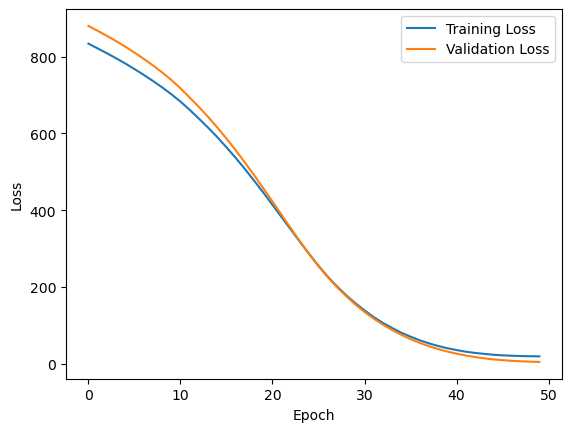

1/1 [==============================] - 0s 470ms/step


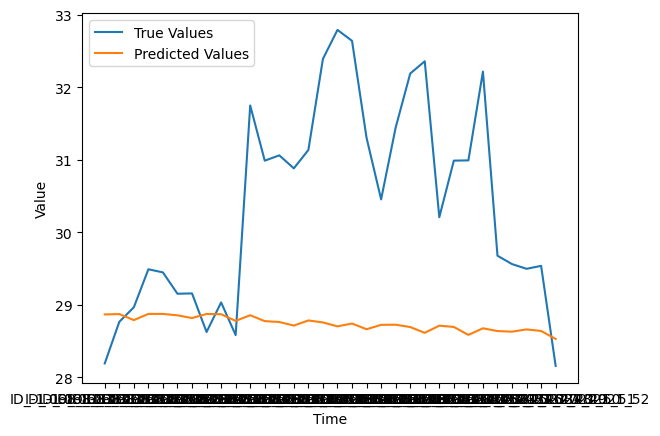

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -2.652_29.148
Epoch 1/50
3/3 [==============================] - 2s 260ms/step - loss: 0.0056 - mse: 0.0056 - accuracy: 0.0000e+00 - val_loss: 0.0029 - val_mse: 0.0029 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 50ms/step - loss: 0.0020 - mse: 0.0020 - accuracy: 0.0000e+00 - val_loss: 0.0031 - val_mse: 0.0031 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 56ms/step - loss: 0.0023 - mse: 0.0023 - accuracy: 0.0000e+00 - val_loss: 3.4858e-04 - val_mse: 3.4858e-04 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 39ms/step - loss: 5.6805e-04 - mse: 5.6805e-04 - accuracy: 0.0000e+00 - val_loss: 0.0020 - val_mse: 0.0020 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 7.8164e-04 - mse: 7.8164e-04 - accuracy: 0.0000e+00 - val_loss: 2.6676e-04 - val_mse: 2.6676e-04 - val_accuracy

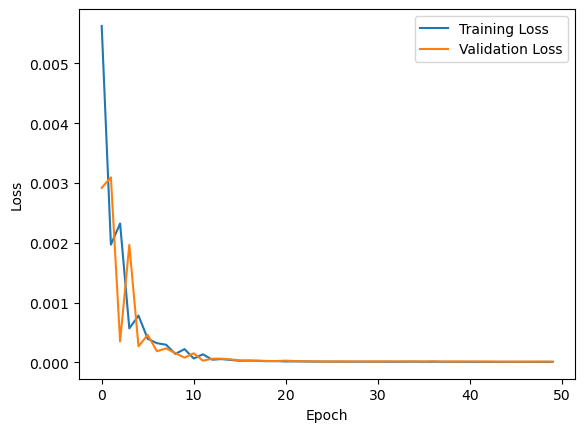

1/1 [==============================] - 0s 343ms/step


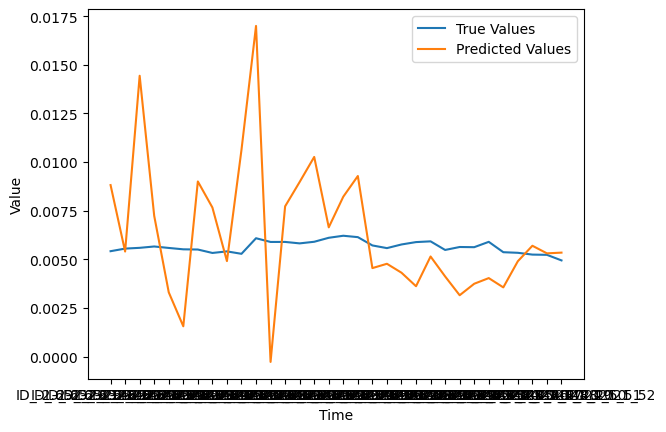

(49, 67)
2/2 [==============================] - 1s 7ms/step
LAT_LONG:  -1.945_29.155
Epoch 1/50
3/3 [==============================] - 3s 456ms/step - loss: 44970.2305 - mse: 44970.2305 - accuracy: 0.0000e+00 - val_loss: 45984.5000 - val_mse: 45984.5000 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 38ms/step - loss: 44852.0000 - mse: 44852.0000 - accuracy: 0.0000e+00 - val_loss: 45869.4766 - val_mse: 45869.4766 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 35ms/step - loss: 44742.2188 - mse: 44742.2188 - accuracy: 0.0000e+00 - val_loss: 45760.3594 - val_mse: 45760.3594 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 44636.0117 - mse: 44636.0117 - accuracy: 0.0000e+00 - val_loss: 45643.2031 - val_mse: 45643.2031 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 35ms/step - loss: 44519.1914 - mse: 44519.1914 - accuracy: 0.0000e+00 - val_loss:

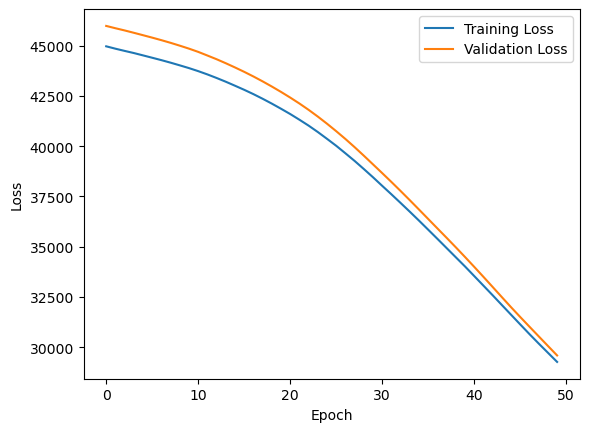

1/1 [==============================] - 0s 418ms/step


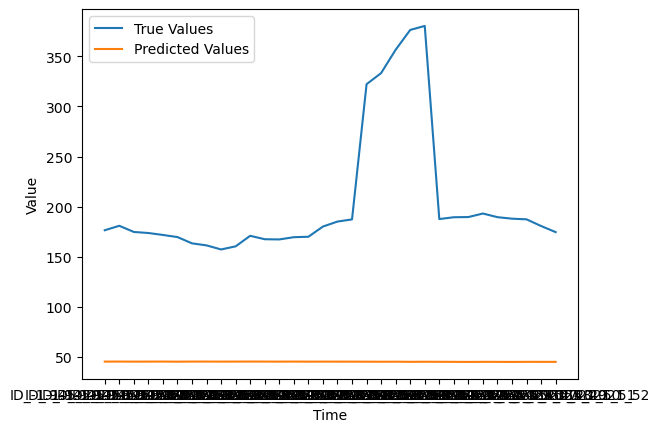

(49, 67)
2/2 [==============================] - 1s 10ms/step
LAT_LONG:  -2.842_28.958
Epoch 1/50
3/3 [==============================] - 2s 220ms/step - loss: 8113.5103 - mse: 8113.5103 - accuracy: 0.0000e+00 - val_loss: 8741.4932 - val_mse: 8741.4932 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 38ms/step - loss: 8047.8286 - mse: 8047.8281 - accuracy: 0.0000e+00 - val_loss: 8676.2168 - val_mse: 8676.2168 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 43ms/step - loss: 7983.7031 - mse: 7983.7031 - accuracy: 0.0000e+00 - val_loss: 8616.6699 - val_mse: 8616.6699 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 35ms/step - loss: 7929.0601 - mse: 7929.0601 - accuracy: 0.0000e+00 - val_loss: 8567.6943 - val_mse: 8567.6943 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 37ms/step - loss: 7882.5190 - mse: 7882.5190 - accuracy: 0.0000e+00 - val_loss: 8521.3604 - val_

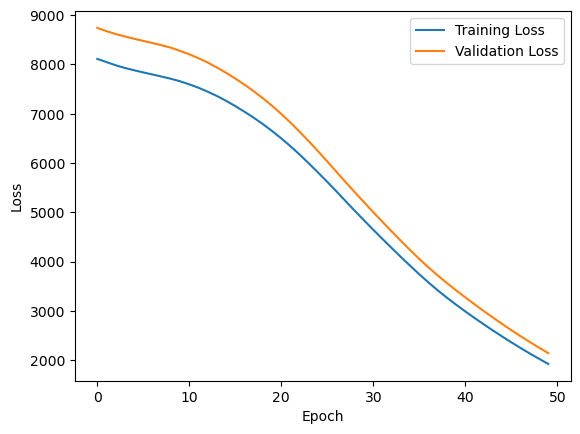

1/1 [==============================] - 0s 369ms/step


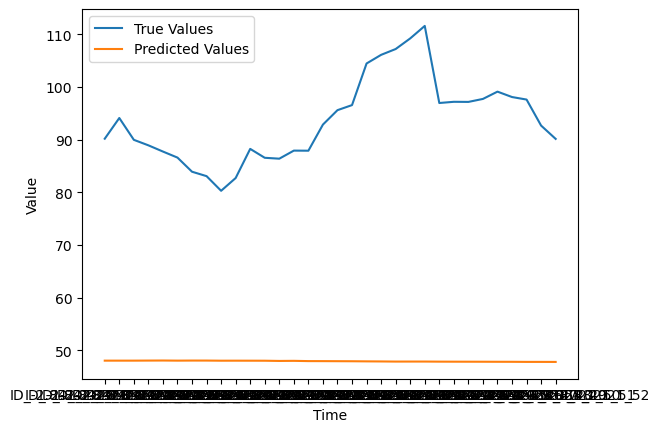

(49, 67)
2/2 [==============================] - 1s 9ms/step
LAT_LONG:  -1.231_30.969
Epoch 1/50
3/3 [==============================] - 2s 228ms/step - loss: 11558.1748 - mse: 11558.1748 - accuracy: 0.0000e+00 - val_loss: 9551.7676 - val_mse: 9551.7676 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 38ms/step - loss: 11490.2354 - mse: 11490.2354 - accuracy: 0.0000e+00 - val_loss: 9486.0293 - val_mse: 9486.0293 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 38ms/step - loss: 11420.8389 - mse: 11420.8389 - accuracy: 0.0000e+00 - val_loss: 9418.6973 - val_mse: 9418.6973 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 41ms/step - loss: 11348.1084 - mse: 11348.1084 - accuracy: 0.0000e+00 - val_loss: 9345.7314 - val_mse: 9345.7314 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 11275.7148 - mse: 11275.7148 - accuracy: 0.0000e+00 - val_loss: 9281.13

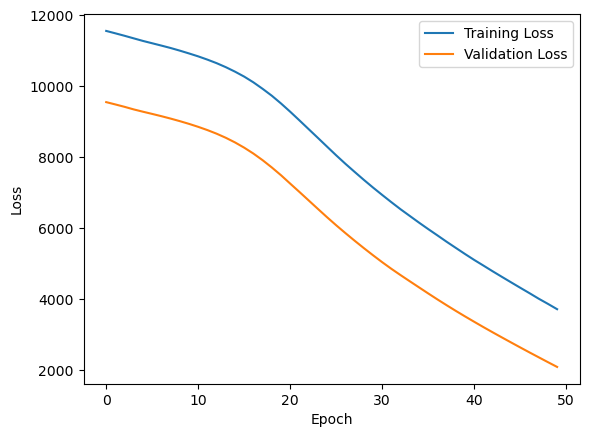

1/1 [==============================] - 1s 503ms/step


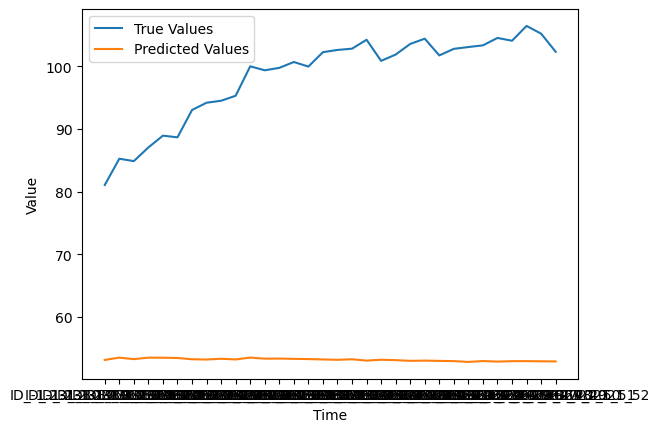

(49, 67)
2/2 [==============================] - 1s 10ms/step
LAT_LONG:  -0.942_30.258
Epoch 1/50
3/3 [==============================] - 4s 258ms/step - loss: 6109.1919 - mse: 6109.1919 - accuracy: 0.0000e+00 - val_loss: 6495.5918 - val_mse: 6495.5918 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 34ms/step - loss: 6053.7295 - mse: 6053.7295 - accuracy: 0.0000e+00 - val_loss: 6432.1562 - val_mse: 6432.1562 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 45ms/step - loss: 5991.9517 - mse: 5991.9517 - accuracy: 0.0000e+00 - val_loss: 6367.4683 - val_mse: 6367.4683 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 39ms/step - loss: 5930.1035 - mse: 5930.1035 - accuracy: 0.0000e+00 - val_loss: 6306.0605 - val_mse: 6306.0605 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 49ms/step - loss: 5872.2051 - mse: 5872.2051 - accuracy: 0.0000e+00 - val_loss: 6245.9297 - val_

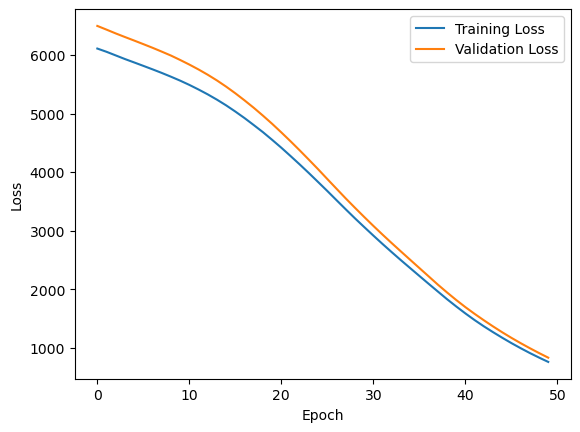

1/1 [==============================] - 0s 380ms/step


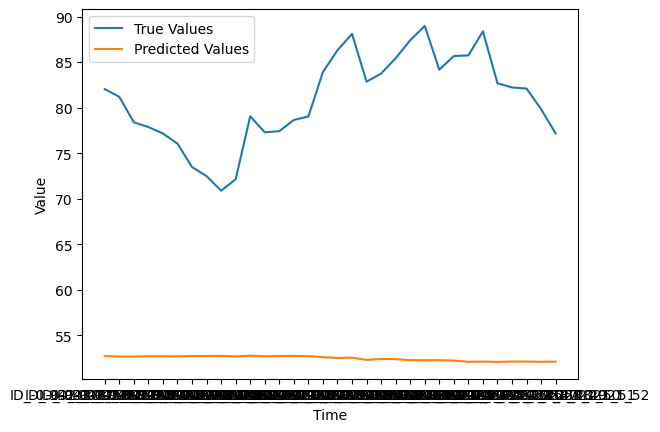

(49, 67)
2/2 [==============================] - 1s 8ms/step
LAT_LONG:  -1.871_29.729
Epoch 1/50
3/3 [==============================] - 3s 276ms/step - loss: 36135.4922 - mse: 36135.4922 - accuracy: 0.0000e+00 - val_loss: 36913.7227 - val_mse: 36913.7227 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 34ms/step - loss: 36046.0234 - mse: 36046.0234 - accuracy: 0.0000e+00 - val_loss: 36823.7578 - val_mse: 36823.7578 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 34ms/step - loss: 35957.8438 - mse: 35957.8477 - accuracy: 0.0000e+00 - val_loss: 36741.1758 - val_mse: 36741.1758 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 35877.4258 - mse: 35877.4297 - accuracy: 0.0000e+00 - val_loss: 36664.2422 - val_mse: 36664.2422 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 35804.4648 - mse: 35804.4648 - accuracy: 0.0000e+00 - val_loss:

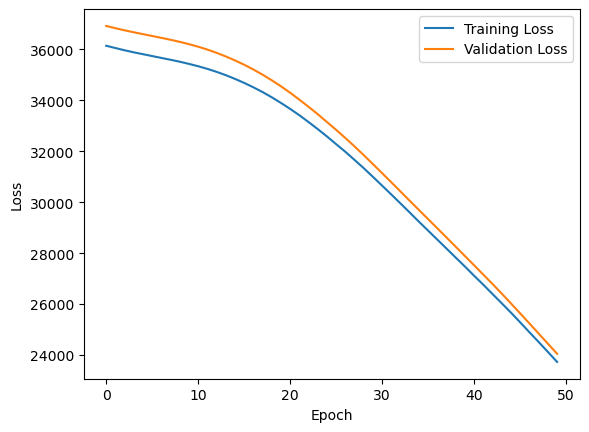

1/1 [==============================] - 0s 437ms/step


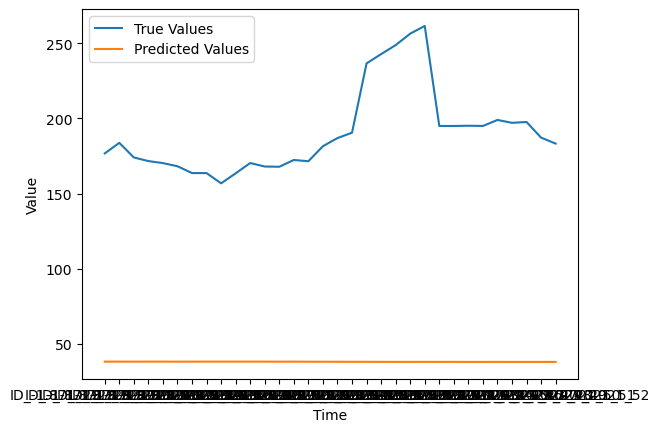

(49, 67)
2/2 [==============================] - 1s 8ms/step
LAT_LONG:  -1.514_29.686
Epoch 1/50
3/3 [==============================] - 3s 261ms/step - loss: 90355.6484 - mse: 90355.6484 - accuracy: 0.0000e+00 - val_loss: 89879.9766 - val_mse: 89879.9766 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 56ms/step - loss: 90195.0469 - mse: 90195.0469 - accuracy: 0.0000e+00 - val_loss: 89740.3984 - val_mse: 89740.3984 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 40ms/step - loss: 90060.8984 - mse: 90060.8984 - accuracy: 0.0000e+00 - val_loss: 89607.8750 - val_mse: 89607.8750 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 36ms/step - loss: 89926.0703 - mse: 89926.0703 - accuracy: 0.0000e+00 - val_loss: 89466.9922 - val_mse: 89466.9922 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 36ms/step - loss: 89788.9766 - mse: 89788.9766 - accuracy: 0.0000e+00 - val_loss:

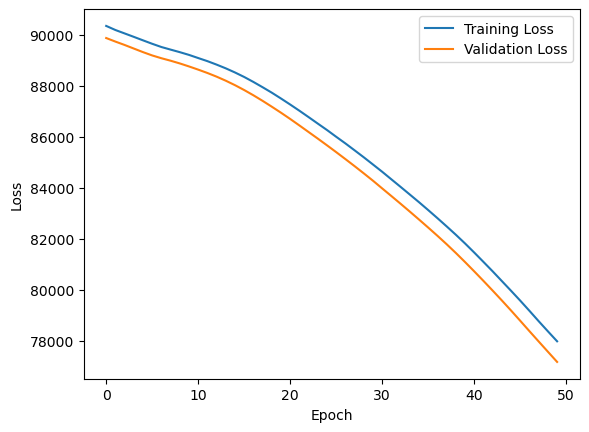

1/1 [==============================] - 0s 461ms/step


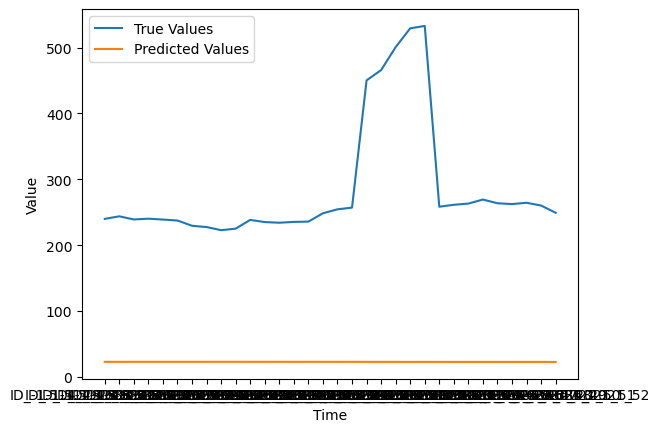

(49, 67)
2/2 [==============================] - 1s 7ms/step
LAT_LONG:  -1.526_29.874
Epoch 1/50
3/3 [==============================] - 2s 229ms/step - loss: 19032.3691 - mse: 19032.3691 - accuracy: 0.0000e+00 - val_loss: 19077.5488 - val_mse: 19077.5488 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 31ms/step - loss: 18922.2246 - mse: 18922.2246 - accuracy: 0.0000e+00 - val_loss: 18965.8711 - val_mse: 18965.8711 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 35ms/step - loss: 18818.7734 - mse: 18818.7734 - accuracy: 0.0000e+00 - val_loss: 18878.3848 - val_mse: 18878.3848 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 47ms/step - loss: 18740.5879 - mse: 18740.5879 - accuracy: 0.0000e+00 - val_loss: 18806.3984 - val_mse: 18806.3984 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 34ms/step - loss: 18667.8711 - mse: 18667.8711 - accuracy: 0.0000e+00 - val_loss:

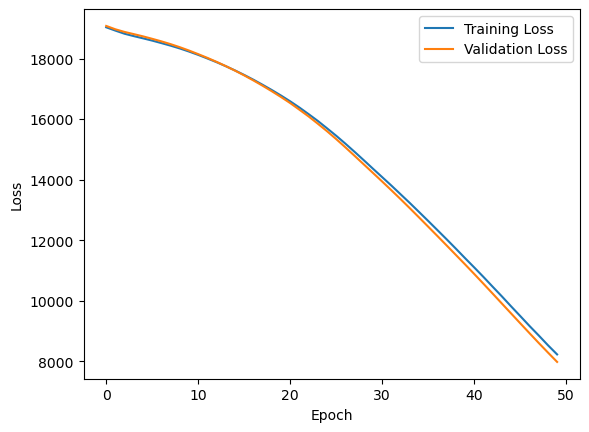

1/1 [==============================] - 0s 384ms/step


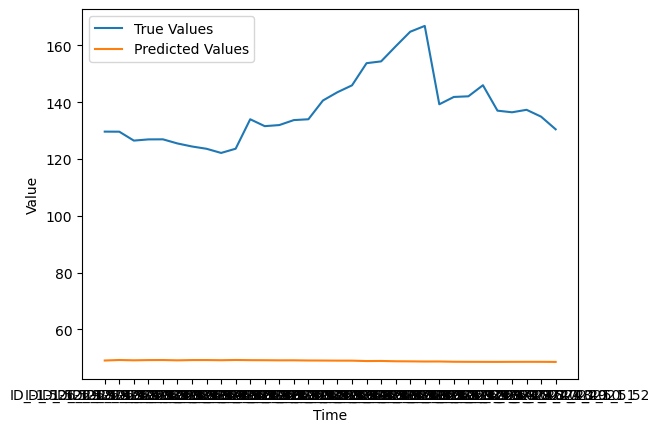

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.176_30.624
Epoch 1/50
3/3 [==============================] - 2s 215ms/step - loss: 3520.7522 - mse: 3520.7522 - accuracy: 0.0000e+00 - val_loss: 4132.9312 - val_mse: 4132.9312 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 3483.2307 - mse: 3483.2307 - accuracy: 0.0000e+00 - val_loss: 4091.9595 - val_mse: 4091.9595 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 3446.4429 - mse: 3446.4429 - accuracy: 0.0000e+00 - val_loss: 4054.9448 - val_mse: 4054.9448 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 3416.6836 - mse: 3416.6836 - accuracy: 0.0000e+00 - val_loss: 4027.9575 - val_mse: 4027.9575 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 3391.7915 - mse: 3391.7915 - accuracy: 0.0000e+00 - val_loss: 3999.9224 - val_m

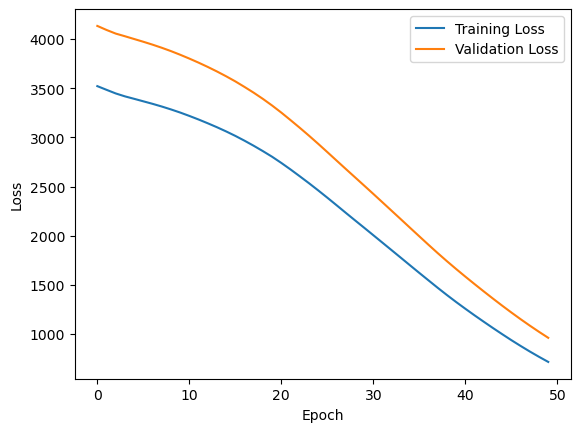

1/1 [==============================] - 0s 291ms/step


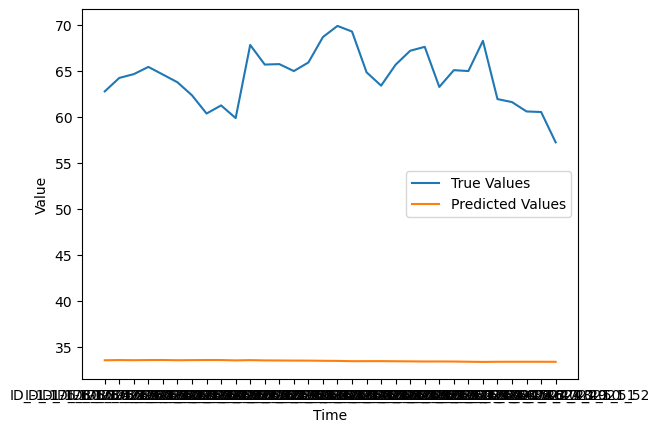

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.486_29.314
Epoch 1/50
3/3 [==============================] - 3s 196ms/step - loss: 352.0295 - mse: 352.0295 - accuracy: 0.0000e+00 - val_loss: 379.4057 - val_mse: 379.4057 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 338.4588 - mse: 338.4588 - accuracy: 0.0000e+00 - val_loss: 365.6855 - val_mse: 365.6855 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 325.9889 - mse: 325.9889 - accuracy: 0.0000e+00 - val_loss: 353.9688 - val_mse: 353.9688 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 315.6101 - mse: 315.6101 - accuracy: 0.0000e+00 - val_loss: 343.2862 - val_mse: 343.2862 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 305.6098 - mse: 305.6098 - accuracy: 0.0000e+00 - val_loss: 332.8491 - val_mse: 332.8491 - val_

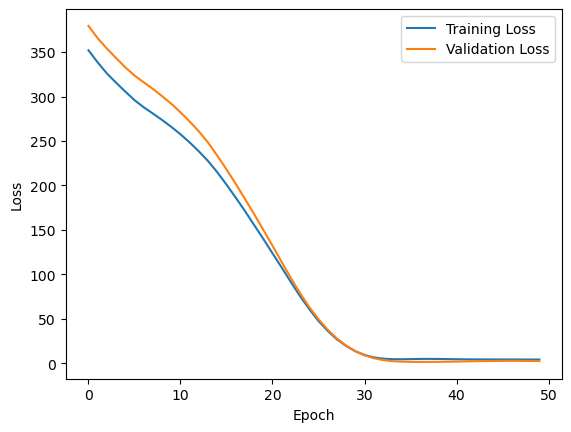

1/1 [==============================] - 0s 291ms/step


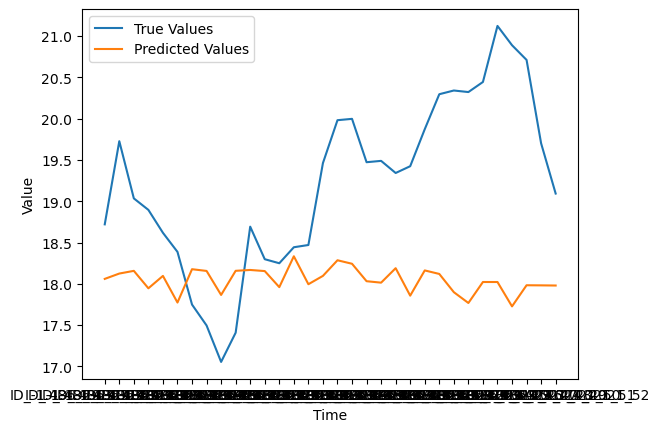

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.2_31.0
Epoch 1/50
3/3 [==============================] - 2s 189ms/step - loss: 20936.3398 - mse: 20936.3398 - accuracy: 0.0000e+00 - val_loss: 22418.0117 - val_mse: 22418.0117 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 20839.4141 - mse: 20839.4141 - accuracy: 0.0000e+00 - val_loss: 22319.3438 - val_mse: 22319.3438 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 25ms/step - loss: 20747.2656 - mse: 20747.2656 - accuracy: 0.0000e+00 - val_loss: 22232.8047 - val_mse: 22232.8047 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 20667.6484 - mse: 20667.6484 - accuracy: 0.0000e+00 - val_loss: 22156.6387 - val_mse: 22156.6387 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 20595.1934 - mse: 20595.1934 - accuracy: 0.0000e+00 - val_loss: 220

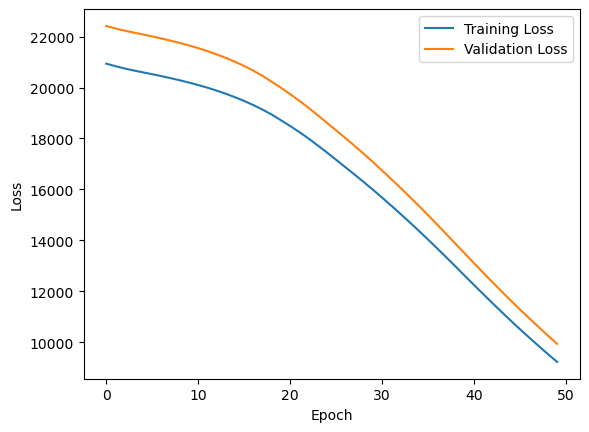

1/1 [==============================] - 0s 292ms/step


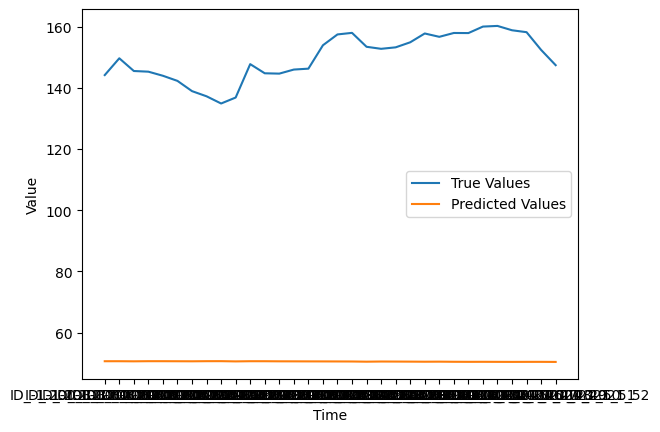

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.096_28.404
Epoch 1/50
3/3 [==============================] - 2s 194ms/step - loss: 0.3406 - mse: 0.3406 - accuracy: 0.0000e+00 - val_loss: 0.0432 - val_mse: 0.0432 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 0.0796 - mse: 0.0796 - accuracy: 0.0000e+00 - val_loss: 0.0261 - val_mse: 0.0261 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 57ms/step - loss: 0.0871 - mse: 0.0871 - accuracy: 0.0000e+00 - val_loss: 0.0767 - val_mse: 0.0767 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 0.1106 - mse: 0.1106 - accuracy: 0.0000e+00 - val_loss: 0.0542 - val_mse: 0.0542 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 32ms/step - loss: 0.0822 - mse: 0.0822 - accuracy: 0.0000e+00 - val_loss: 0.0171 - val_mse: 0.0171 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

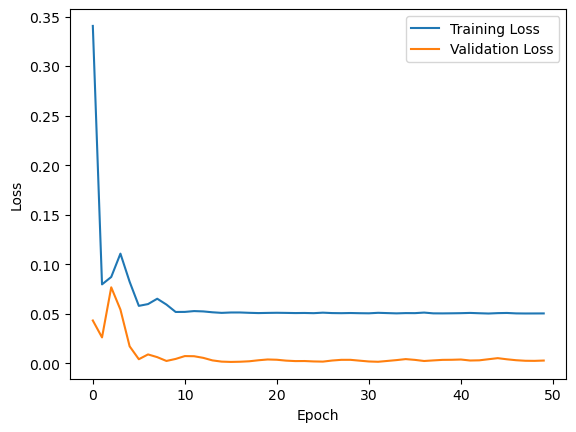

1/1 [==============================] - 0s 297ms/step


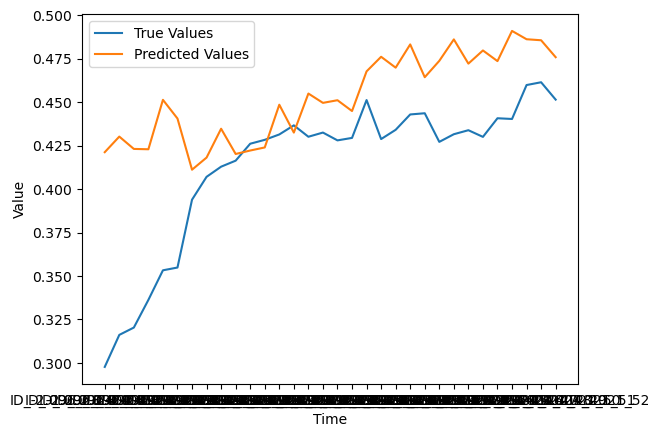

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.599_29.801
Epoch 1/50
3/3 [==============================] - 2s 202ms/step - loss: 135656.6406 - mse: 135656.6406 - accuracy: 0.0000e+00 - val_loss: 129042.2656 - val_mse: 129042.2656 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 135405.2344 - mse: 135405.2344 - accuracy: 0.0000e+00 - val_loss: 128799.8750 - val_mse: 128799.8750 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 135158.6875 - mse: 135158.7031 - accuracy: 0.0000e+00 - val_loss: 128559.0547 - val_mse: 128559.0547 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 134923.5469 - mse: 134923.5469 - accuracy: 0.0000e+00 - val_loss: 128346.4609 - val_mse: 128346.4609 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 134714.0000 - mse: 134713.9844 - accuracy: 0.00

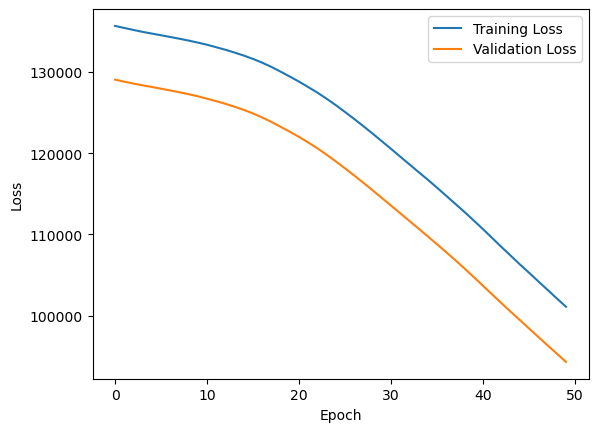

1/1 [==============================] - 0s 360ms/step


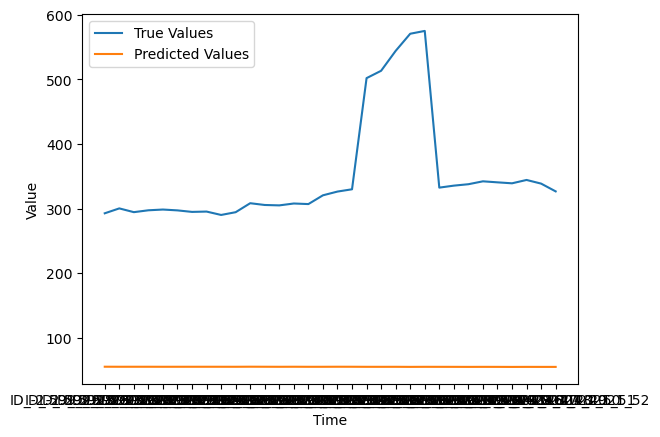

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.307_30.393
Epoch 1/50
3/3 [==============================] - 2s 191ms/step - loss: 19673.4863 - mse: 19673.4883 - accuracy: 0.0000e+00 - val_loss: 20106.8281 - val_mse: 20106.8281 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 19598.9531 - mse: 19598.9531 - accuracy: 0.0000e+00 - val_loss: 20024.6152 - val_mse: 20024.6152 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 19518.5898 - mse: 19518.5898 - accuracy: 0.0000e+00 - val_loss: 19944.0801 - val_mse: 19944.0801 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 19439.3418 - mse: 19439.3418 - accuracy: 0.0000e+00 - val_loss: 19862.2930 - val_mse: 19862.2930 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 19363.0723 - mse: 19363.0723 - accuracy: 0.0000e+00 - val_loss:

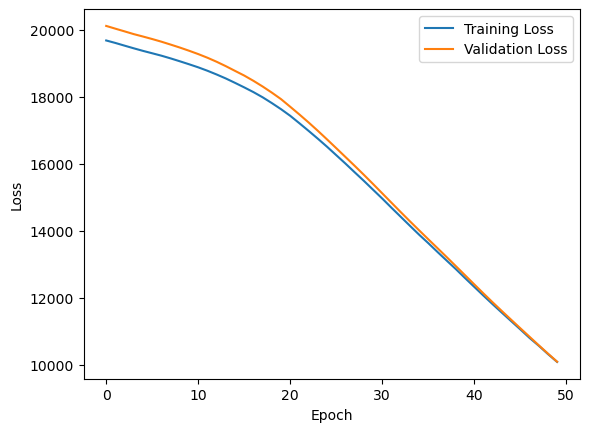

1/1 [==============================] - 0s 269ms/step


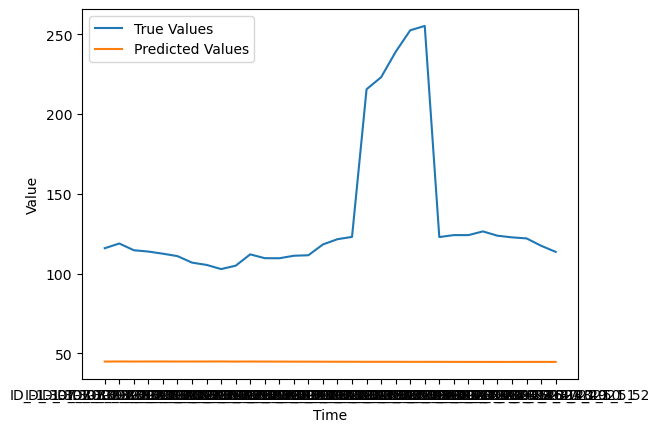

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.129_31.371
Epoch 1/50
3/3 [==============================] - 2s 183ms/step - loss: 62491.0234 - mse: 62491.0234 - accuracy: 0.0000e+00 - val_loss: 64512.2422 - val_mse: 64512.2422 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 62356.5508 - mse: 62356.5508 - accuracy: 0.0000e+00 - val_loss: 64370.8516 - val_mse: 64370.8516 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 26ms/step - loss: 62220.2695 - mse: 62220.2695 - accuracy: 0.0000e+00 - val_loss: 64234.1172 - val_mse: 64234.1172 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 62087.8203 - mse: 62087.8203 - accuracy: 0.0000e+00 - val_loss: 64100.2266 - val_mse: 64100.2266 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 61956.6562 - mse: 61956.6562 - accuracy: 0.0000e+00 - val_loss:

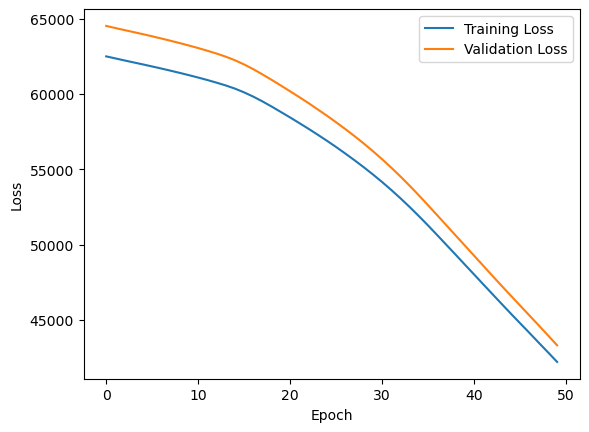

1/1 [==============================] - 0s 287ms/step


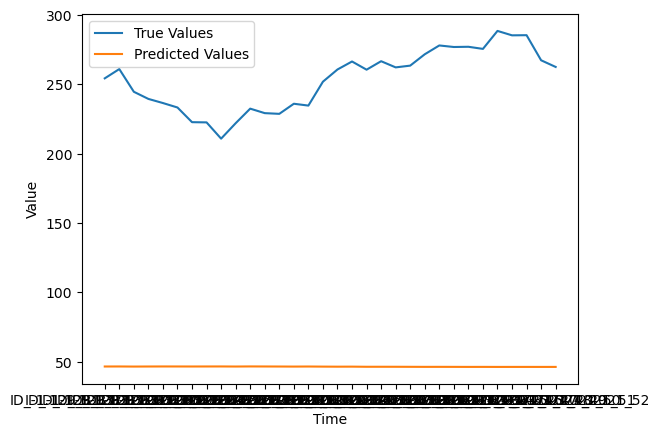

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.516_28.984
Epoch 1/50
3/3 [==============================] - 2s 196ms/step - loss: 2.7667 - mse: 2.7667 - accuracy: 0.0000e+00 - val_loss: 1.5775 - val_mse: 1.5775 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 1.9669 - mse: 1.9669 - accuracy: 0.0000e+00 - val_loss: 0.9656 - val_mse: 0.9656 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 29ms/step - loss: 1.3317 - mse: 1.3317 - accuracy: 0.0000e+00 - val_loss: 0.5323 - val_mse: 0.5323 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 0.8937 - mse: 0.8937 - accuracy: 0.0000e+00 - val_loss: 0.2395 - val_mse: 0.2395 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 0.5922 - mse: 0.5922 - accuracy: 0.0000e+00 - val_loss: 0.0872 - val_mse: 0.0872 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

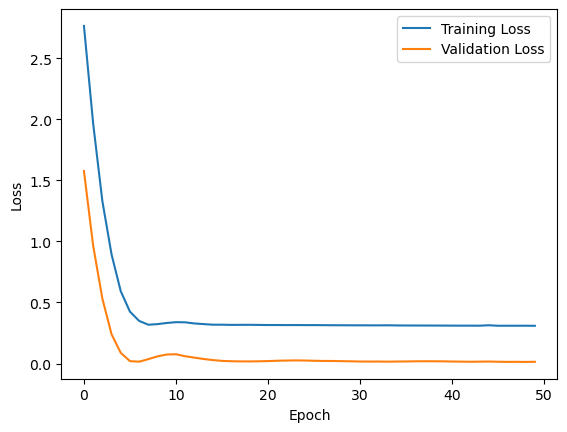

1/1 [==============================] - 0s 288ms/step


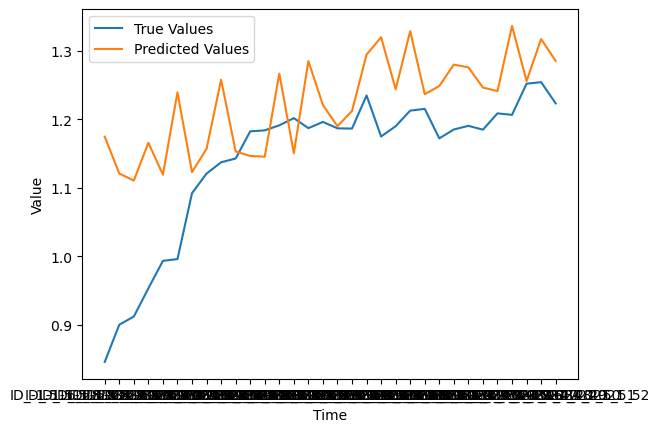

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.889_29.611
Epoch 1/50
3/3 [==============================] - 2s 202ms/step - loss: 109204.3516 - mse: 109204.3516 - accuracy: 0.0000e+00 - val_loss: 113313.8594 - val_mse: 113313.8594 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 108982.8828 - mse: 108982.8828 - accuracy: 0.0000e+00 - val_loss: 113075.0156 - val_mse: 113075.0156 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 29ms/step - loss: 108748.3516 - mse: 108748.3516 - accuracy: 0.0000e+00 - val_loss: 112818.5938 - val_mse: 112818.5938 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 108499.7969 - mse: 108499.7969 - accuracy: 0.0000e+00 - val_loss: 112586.8984 - val_mse: 112586.8984 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 108285.1172 - mse: 108285.1172 - accuracy: 0.00

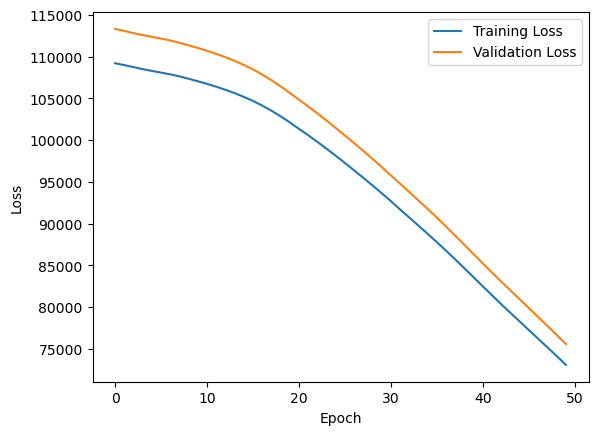

1/1 [==============================] - 0s 279ms/step


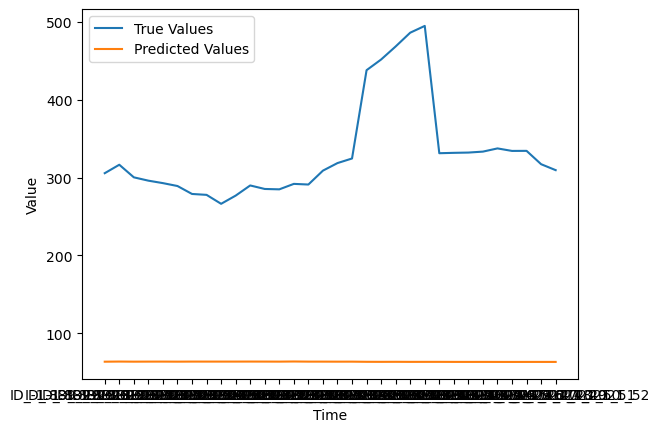

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.961_31.339
Epoch 1/50
3/3 [==============================] - 2s 406ms/step - loss: 31.4175 - mse: 31.4175 - accuracy: 0.0000e+00 - val_loss: 18.9967 - val_mse: 18.9967 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 30ms/step - loss: 29.3854 - mse: 29.3854 - accuracy: 0.0000e+00 - val_loss: 17.4241 - val_mse: 17.4241 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 27.7073 - mse: 27.7073 - accuracy: 0.0000e+00 - val_loss: 16.0513 - val_mse: 16.0513 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 26.1909 - mse: 26.1909 - accuracy: 0.0000e+00 - val_loss: 14.7796 - val_mse: 14.7796 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 24.7368 - mse: 24.7368 - accuracy: 0.0000e+00 - val_loss: 13.5294 - val_mse: 13.5294 - val_accuracy: 0.0000e+00

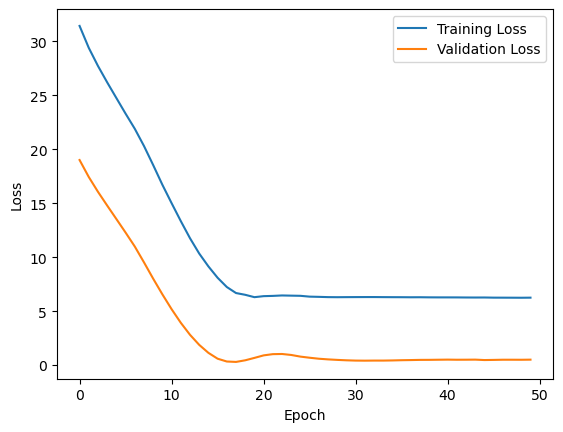

1/1 [==============================] - 0s 297ms/step


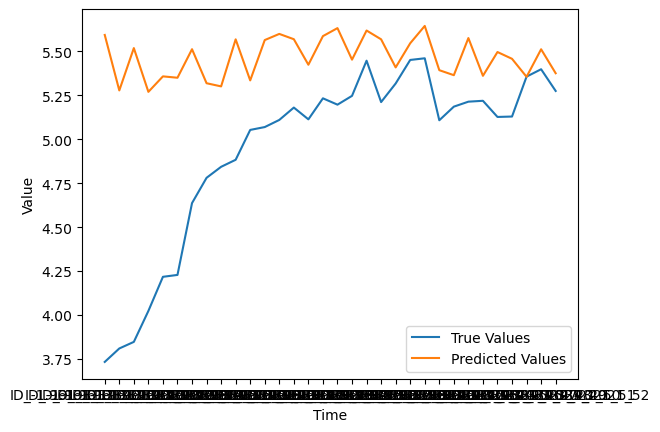

(49, 67)
2/2 [==============================] - 0s 29ms/step
LAT_LONG:  -0.569_30.031
Epoch 1/50
3/3 [==============================] - 2s 200ms/step - loss: 13329.2949 - mse: 13329.2949 - accuracy: 0.0000e+00 - val_loss: 14473.6953 - val_mse: 14473.6953 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 31ms/step - loss: 13277.9326 - mse: 13277.9326 - accuracy: 0.0000e+00 - val_loss: 14421.5254 - val_mse: 14421.5254 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 13228.4590 - mse: 13228.4590 - accuracy: 0.0000e+00 - val_loss: 14370.7500 - val_mse: 14370.7500 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 13180.1221 - mse: 13180.1221 - accuracy: 0.0000e+00 - val_loss: 14318.4199 - val_mse: 14318.4199 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 13129.6631 - mse: 13129.6631 - accuracy: 0.0000e+00 - val_loss

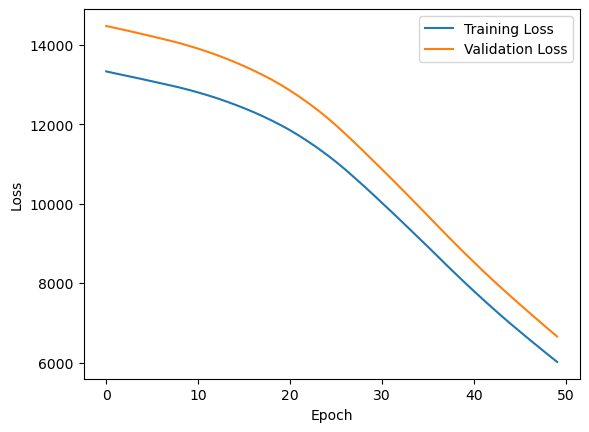

1/1 [==============================] - 0s 274ms/step


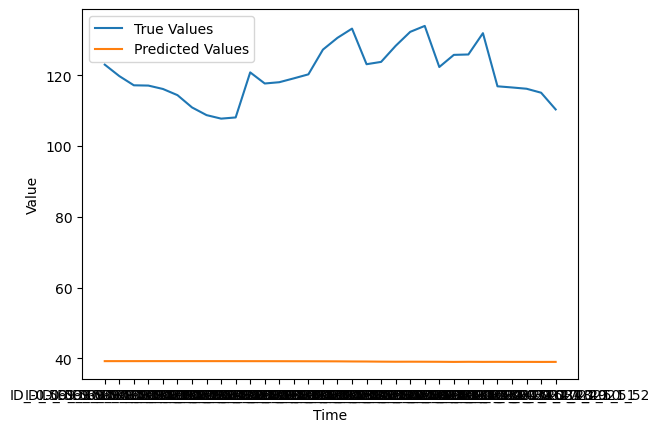

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.88_30.72
Epoch 1/50
3/3 [==============================] - 2s 194ms/step - loss: 391.3737 - mse: 391.3737 - accuracy: 0.0000e+00 - val_loss: 248.0959 - val_mse: 248.0959 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 378.9242 - mse: 378.9242 - accuracy: 0.0000e+00 - val_loss: 238.5503 - val_mse: 238.5503 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 368.4973 - mse: 368.4973 - accuracy: 0.0000e+00 - val_loss: 229.4643 - val_mse: 229.4643 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 357.7904 - mse: 357.7904 - accuracy: 0.0000e+00 - val_loss: 219.4363 - val_mse: 219.4363 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 346.2089 - mse: 346.2089 - accuracy: 0.0000e+00 - val_loss: 209.3874 - val_mse: 209.3874 - val_ac

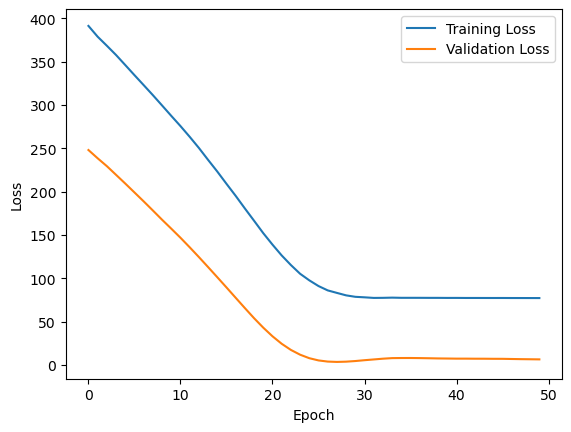

1/1 [==============================] - 0s 291ms/step


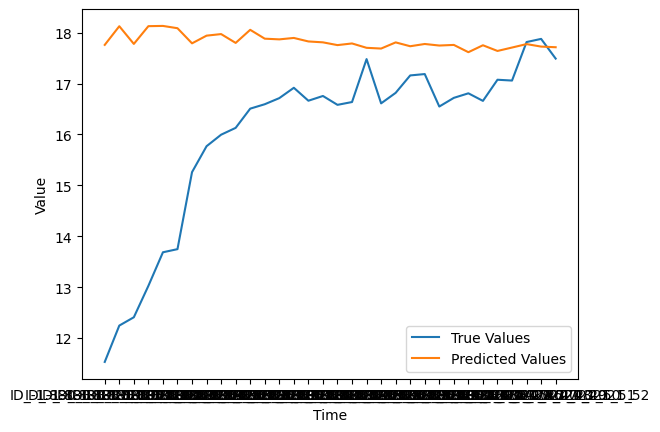

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.091_30.709
Epoch 1/50
3/3 [==============================] - 3s 199ms/step - loss: 2849.3655 - mse: 2849.3655 - accuracy: 0.0000e+00 - val_loss: 2730.6731 - val_mse: 2730.6731 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 2809.0327 - mse: 2809.0327 - accuracy: 0.0000e+00 - val_loss: 2691.3564 - val_mse: 2691.3564 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 2770.6477 - mse: 2770.6477 - accuracy: 0.0000e+00 - val_loss: 2655.6392 - val_mse: 2655.6392 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 26ms/step - loss: 2737.2756 - mse: 2737.2756 - accuracy: 0.0000e+00 - val_loss: 2623.1421 - val_mse: 2623.1421 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 2704.5037 - mse: 2704.5034 - accuracy: 0.0000e+00 - val_loss: 2589.4097 - val_m

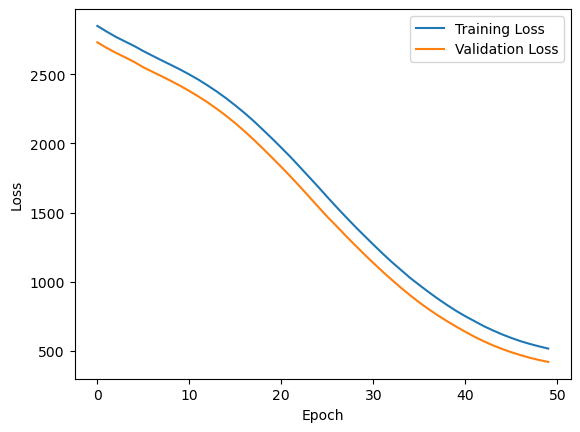

1/1 [==============================] - 0s 280ms/step


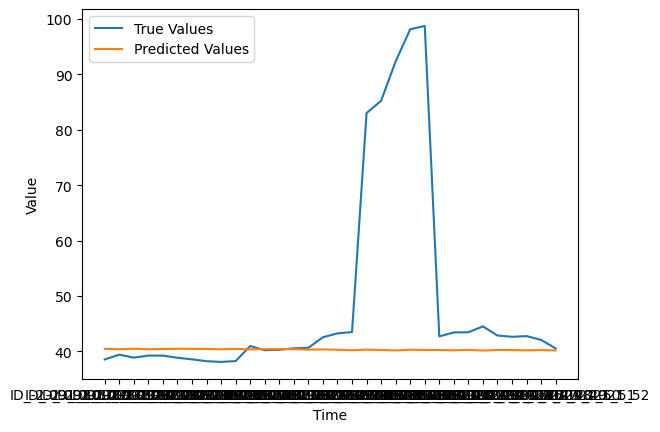

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.959_30.341
Epoch 1/50
3/3 [==============================] - 2s 191ms/step - loss: 34743.7383 - mse: 34743.7422 - accuracy: 0.0000e+00 - val_loss: 36099.4844 - val_mse: 36099.4844 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 34652.0078 - mse: 34652.0078 - accuracy: 0.0000e+00 - val_loss: 36009.4375 - val_mse: 36009.4375 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 34565.4922 - mse: 34565.4922 - accuracy: 0.0000e+00 - val_loss: 35922.9062 - val_mse: 35922.9062 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 34481.7539 - mse: 34481.7461 - accuracy: 0.0000e+00 - val_loss: 35836.2891 - val_mse: 35836.2891 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 34400.5586 - mse: 34400.5586 - accuracy: 0.0000e+00 - val_loss:

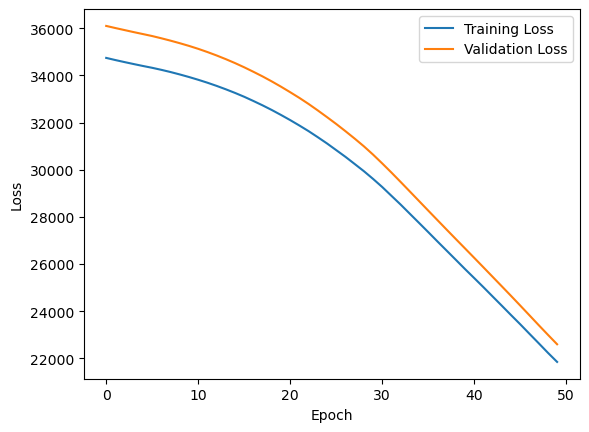

1/1 [==============================] - 0s 291ms/step


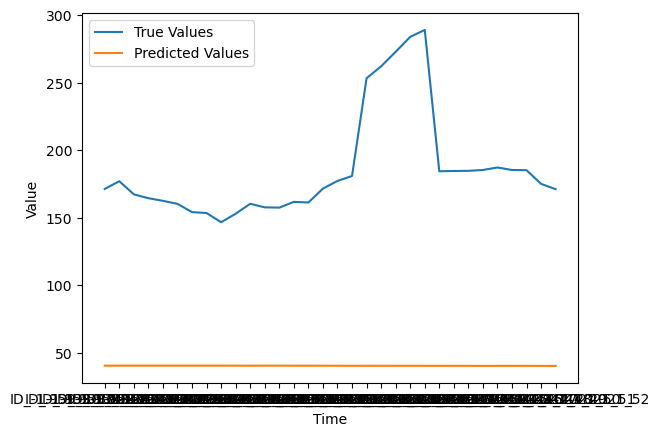

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -0.855_30.145
Epoch 1/50
3/3 [==============================] - 2s 194ms/step - loss: 12493.0098 - mse: 12493.0098 - accuracy: 0.0000e+00 - val_loss: 13726.9883 - val_mse: 13726.9883 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 12435.3652 - mse: 12435.3652 - accuracy: 0.0000e+00 - val_loss: 13663.5059 - val_mse: 13663.5059 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 12374.4287 - mse: 12374.4287 - accuracy: 0.0000e+00 - val_loss: 13600.2910 - val_mse: 13600.2910 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 12314.2441 - mse: 12314.2441 - accuracy: 0.0000e+00 - val_loss: 13537.2021 - val_mse: 13537.2021 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 12252.5889 - mse: 12252.5889 - accuracy: 0.0000e+00 - val_loss:

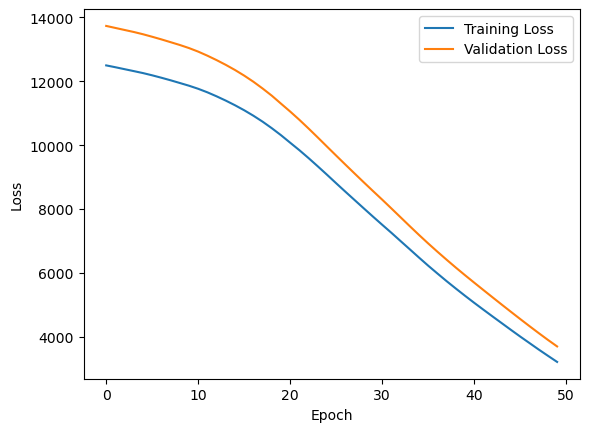

1/1 [==============================] - 1s 671ms/step


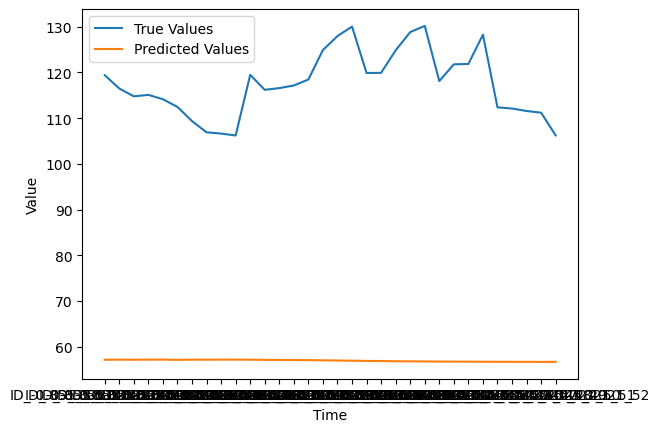

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.17_29.33
Epoch 1/50
3/3 [==============================] - 2s 202ms/step - loss: 0.5129 - mse: 0.5129 - accuracy: 0.0000e+00 - val_loss: 0.1988 - val_mse: 0.1988 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 0.3108 - mse: 0.3108 - accuracy: 0.0000e+00 - val_loss: 0.0724 - val_mse: 0.0724 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 0.1896 - mse: 0.1896 - accuracy: 0.0000e+00 - val_loss: 0.0163 - val_mse: 0.0163 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 0.1257 - mse: 0.1257 - accuracy: 0.0000e+00 - val_loss: 0.0104 - val_mse: 0.0104 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 0.1165 - mse: 0.1165 - accuracy: 0.0000e+00 - val_loss: 0.0334 - val_mse: 0.0334 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [=====

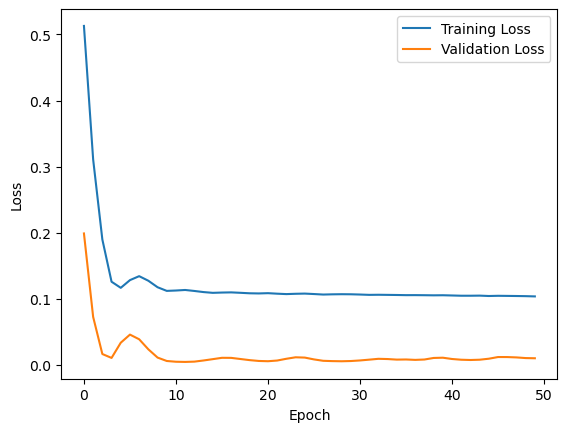

1/1 [==============================] - 0s 281ms/step


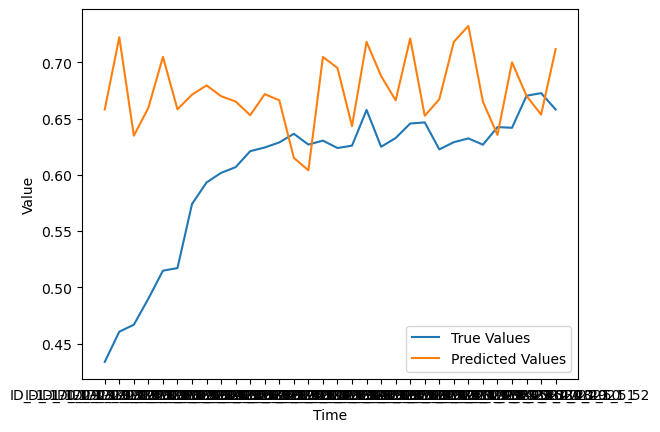

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -0.964_29.436
Epoch 1/50
3/3 [==============================] - 2s 187ms/step - loss: 176.5911 - mse: 176.5911 - accuracy: 0.0000e+00 - val_loss: 177.3337 - val_mse: 177.3337 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 168.6226 - mse: 168.6226 - accuracy: 0.0000e+00 - val_loss: 168.8240 - val_mse: 168.8240 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 160.4280 - mse: 160.4280 - accuracy: 0.0000e+00 - val_loss: 160.9663 - val_mse: 160.9663 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 152.9282 - mse: 152.9282 - accuracy: 0.0000e+00 - val_loss: 153.5619 - val_mse: 153.5619 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 145.7854 - mse: 145.7854 - accuracy: 0.0000e+00 - val_loss: 146.5123 - val_mse: 146.5123 - val_

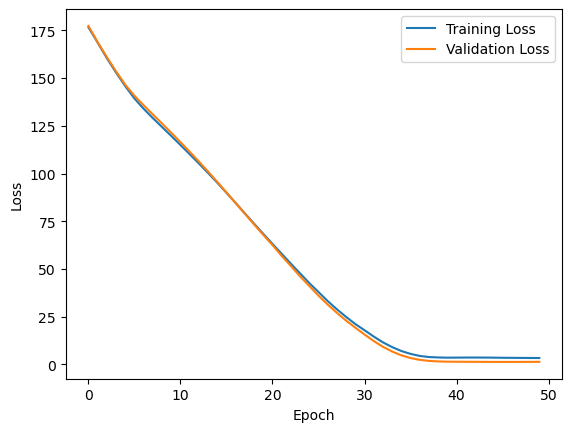

1/1 [==============================] - 0s 289ms/step


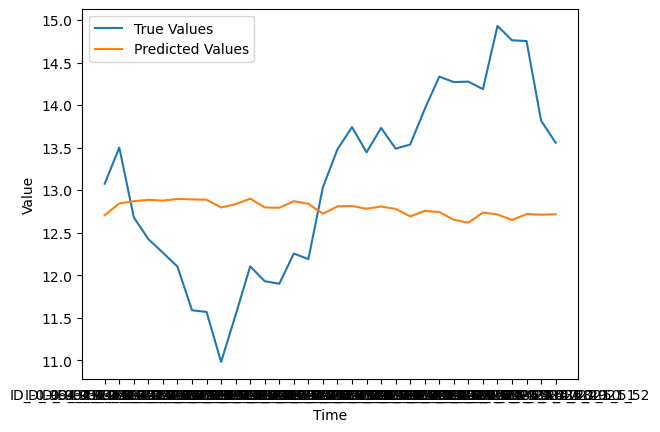

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.757_29.543
Epoch 1/50
3/3 [==============================] - 2s 188ms/step - loss: 5337.5835 - mse: 5337.5835 - accuracy: 0.0000e+00 - val_loss: 5521.7490 - val_mse: 5521.7490 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 5299.9653 - mse: 5299.9653 - accuracy: 0.0000e+00 - val_loss: 5491.2891 - val_mse: 5491.2891 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 5270.8960 - mse: 5270.8960 - accuracy: 0.0000e+00 - val_loss: 5464.6895 - val_mse: 5464.6895 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 5246.8813 - mse: 5246.8813 - accuracy: 0.0000e+00 - val_loss: 5443.9033 - val_mse: 5443.9033 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 5226.8198 - mse: 5226.8198 - accuracy: 0.0000e+00 - val_loss: 5423.0527 - val_m

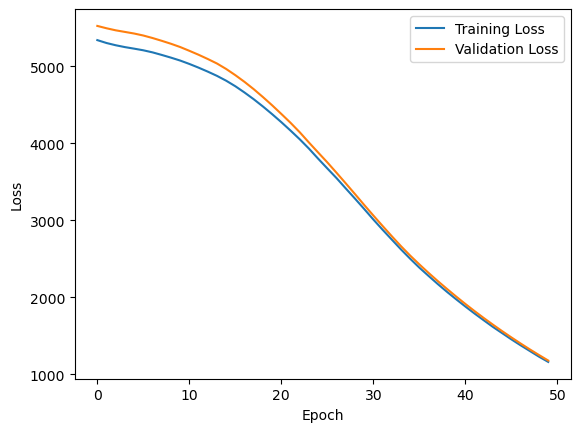

1/1 [==============================] - 0s 282ms/step


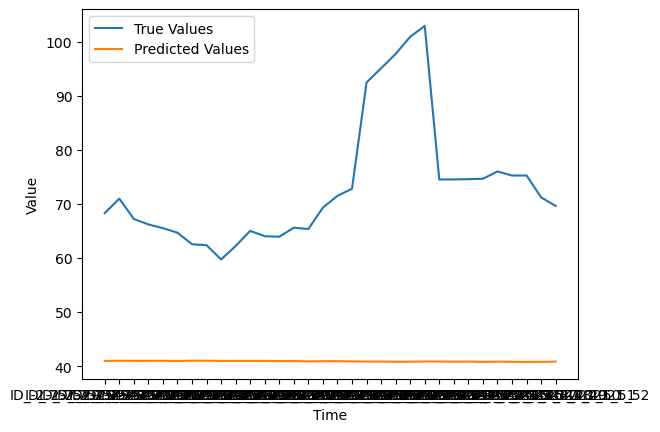

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -2.08_28.62
Epoch 1/50
3/3 [==============================] - 2s 205ms/step - loss: 1.4800 - mse: 1.4800 - accuracy: 0.0000e+00 - val_loss: 1.4055 - val_mse: 1.4055 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 0.8099 - mse: 0.8099 - accuracy: 0.0000e+00 - val_loss: 0.7538 - val_mse: 0.7538 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 0.3545 - mse: 0.3545 - accuracy: 0.0000e+00 - val_loss: 0.3202 - val_mse: 0.3202 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 0.1039 - mse: 0.1039 - accuracy: 0.0000e+00 - val_loss: 0.0891 - val_mse: 0.0891 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 0.0373 - mse: 0.0373 - accuracy: 0.0000e+00 - val_loss: 0.0124 - val_mse: 0.0124 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [=====

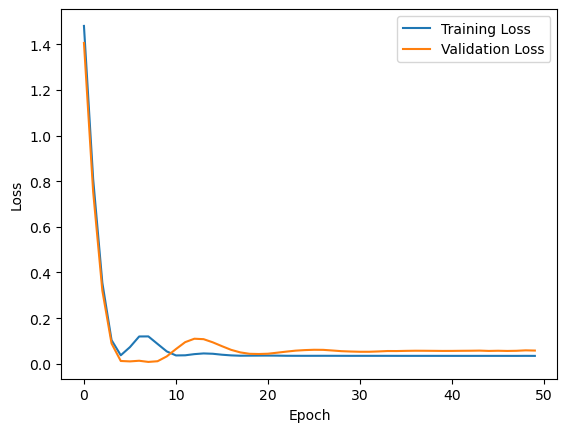

1/1 [==============================] - 0s 297ms/step


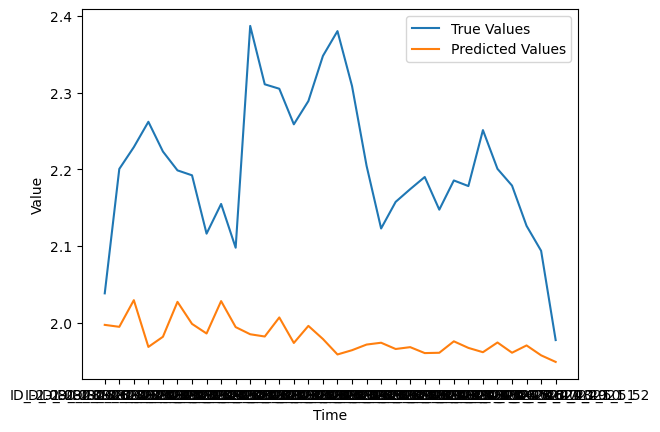

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.697_29.403
Epoch 1/50
3/3 [==============================] - 2s 196ms/step - loss: 1073.6433 - mse: 1073.6433 - accuracy: 0.0000e+00 - val_loss: 1009.2955 - val_mse: 1009.2955 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 30ms/step - loss: 1058.3153 - mse: 1058.3154 - accuracy: 0.0000e+00 - val_loss: 992.4076 - val_mse: 992.4076 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 29ms/step - loss: 1041.3506 - mse: 1041.3506 - accuracy: 0.0000e+00 - val_loss: 975.3143 - val_mse: 975.3143 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 1026.2043 - mse: 1026.2043 - accuracy: 0.0000e+00 - val_loss: 961.3787 - val_mse: 961.3787 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 1012.9017 - mse: 1012.9017 - accuracy: 0.0000e+00 - val_loss: 947.3080 - val_mse: 947

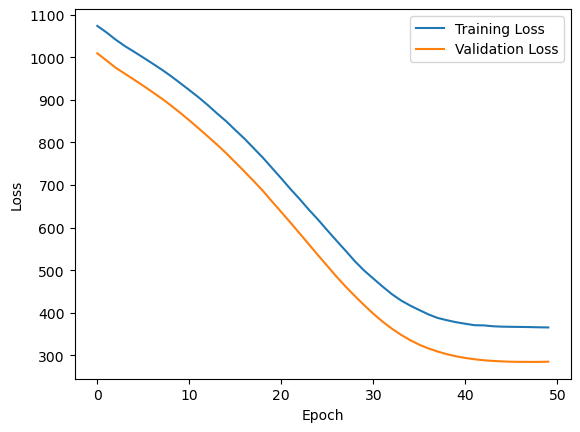

1/1 [==============================] - 0s 286ms/step


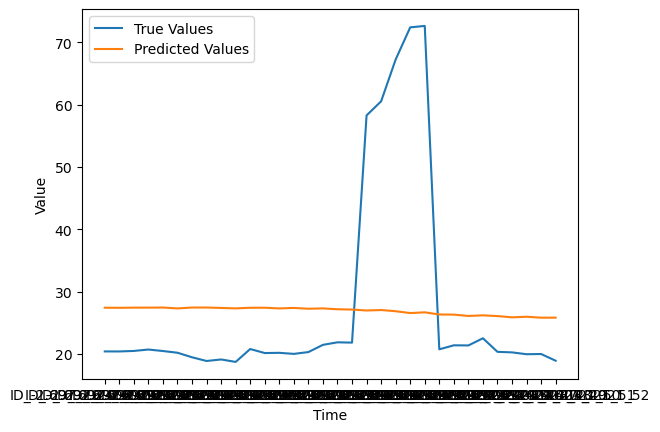

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.342_29.258
Epoch 1/50
3/3 [==============================] - 3s 282ms/step - loss: 987.6343 - mse: 987.6343 - accuracy: 0.0000e+00 - val_loss: 1133.6401 - val_mse: 1133.6401 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 58ms/step - loss: 975.5917 - mse: 975.5917 - accuracy: 0.0000e+00 - val_loss: 1121.7446 - val_mse: 1121.7446 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 39ms/step - loss: 964.7616 - mse: 964.7616 - accuracy: 0.0000e+00 - val_loss: 1110.0094 - val_mse: 1110.0094 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 954.0107 - mse: 954.0107 - accuracy: 0.0000e+00 - val_loss: 1098.1667 - val_mse: 1098.1667 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 943.1921 - mse: 943.1921 - accuracy: 0.0000e+00 - val_loss: 1087.2908 - val_mse: 1087.2

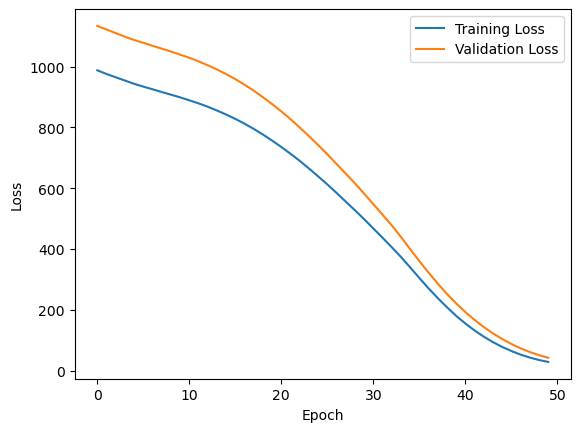

1/1 [==============================] - 0s 348ms/step


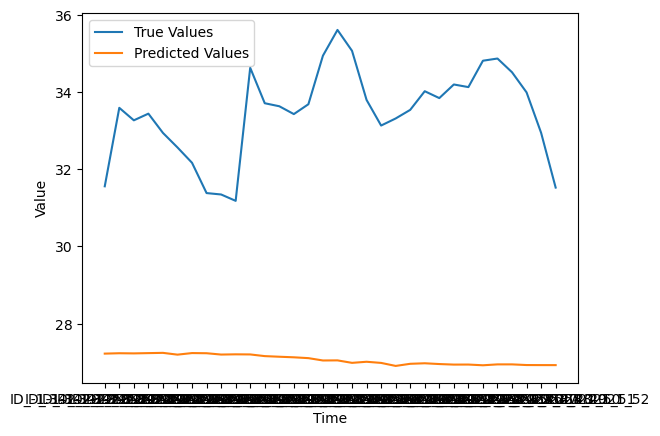

(49, 67)
2/2 [==============================] - 1s 7ms/step
LAT_LONG:  -1.429_30.971
Epoch 1/50
3/3 [==============================] - 2s 222ms/step - loss: 1671.5098 - mse: 1671.5098 - accuracy: 0.0000e+00 - val_loss: 1996.6022 - val_mse: 1996.6022 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 1642.1228 - mse: 1642.1228 - accuracy: 0.0000e+00 - val_loss: 1966.5986 - val_mse: 1966.5986 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 34ms/step - loss: 1616.0342 - mse: 1616.0342 - accuracy: 0.0000e+00 - val_loss: 1940.4688 - val_mse: 1940.4688 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 44ms/step - loss: 1592.2604 - mse: 1592.2604 - accuracy: 0.0000e+00 - val_loss: 1915.1763 - val_mse: 1915.1763 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 1569.5016 - mse: 1569.5016 - accuracy: 0.0000e+00 - val_loss: 1890.3907 - val_m

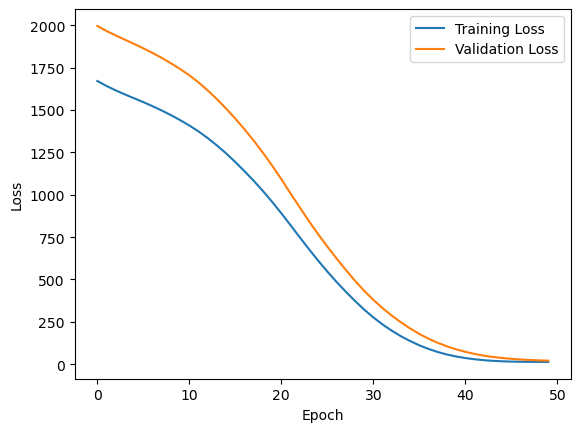

1/1 [==============================] - 0s 299ms/step


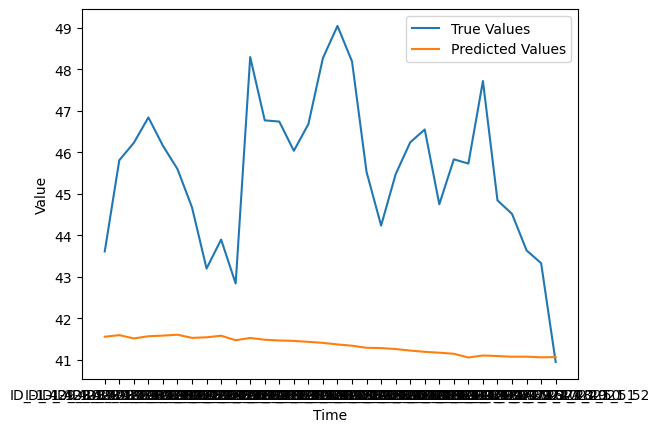

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.07_29.33
Epoch 1/50
3/3 [==============================] - 2s 190ms/step - loss: 1011.8984 - mse: 1011.8985 - accuracy: 0.0000e+00 - val_loss: 1110.7974 - val_mse: 1110.7974 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 985.8630 - mse: 985.8630 - accuracy: 0.0000e+00 - val_loss: 1082.7539 - val_mse: 1082.7539 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 26ms/step - loss: 959.7236 - mse: 959.7236 - accuracy: 0.0000e+00 - val_loss: 1054.9150 - val_mse: 1054.9150 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 934.5483 - mse: 934.5483 - accuracy: 0.0000e+00 - val_loss: 1028.6254 - val_mse: 1028.6254 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 910.0019 - mse: 910.0019 - accuracy: 0.0000e+00 - val_loss: 1001.5345 - val_mse: 1001.5

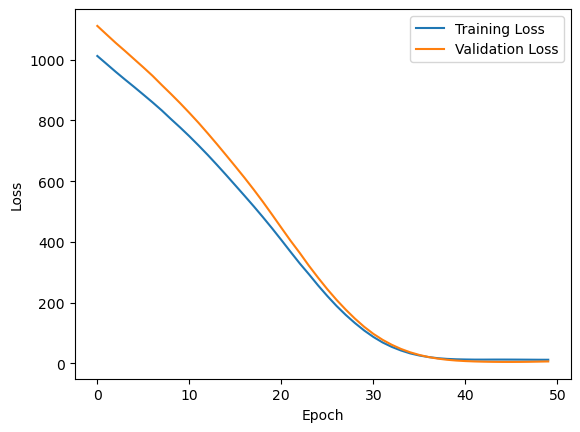

1/1 [==============================] - 0s 257ms/step


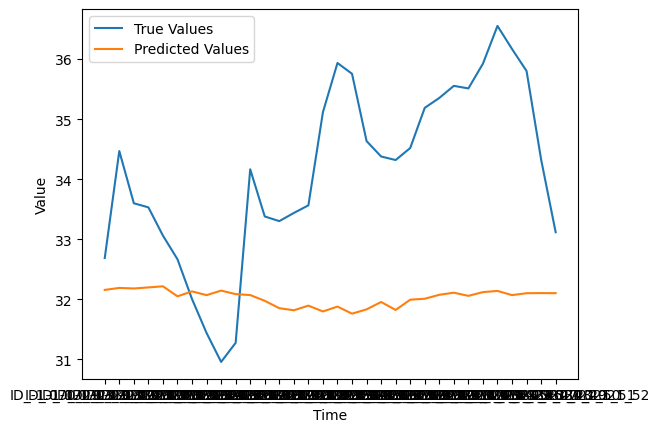

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.479_29.421
Epoch 1/50
3/3 [==============================] - 2s 205ms/step - loss: 48752.4570 - mse: 48752.4570 - accuracy: 0.0000e+00 - val_loss: 50793.5391 - val_mse: 50793.5391 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 48593.7383 - mse: 48593.7383 - accuracy: 0.0000e+00 - val_loss: 50637.1367 - val_mse: 50637.1367 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 29ms/step - loss: 48444.9297 - mse: 48444.9297 - accuracy: 0.0000e+00 - val_loss: 50489.2969 - val_mse: 50489.2969 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 48306.3320 - mse: 48306.3320 - accuracy: 0.0000e+00 - val_loss: 50359.5508 - val_mse: 50359.5508 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 48184.0352 - mse: 48184.0352 - accuracy: 0.0000e+00 - val_loss:

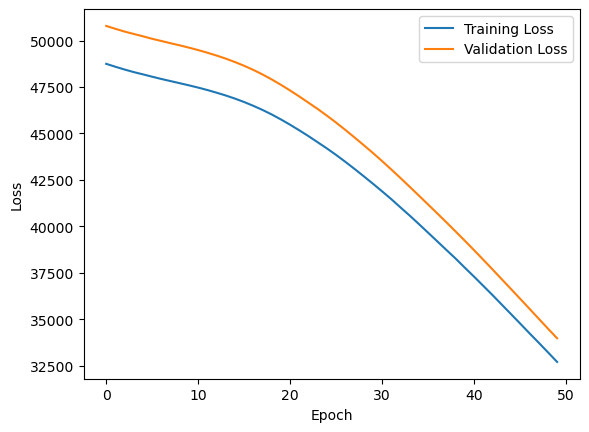

1/1 [==============================] - 0s 345ms/step


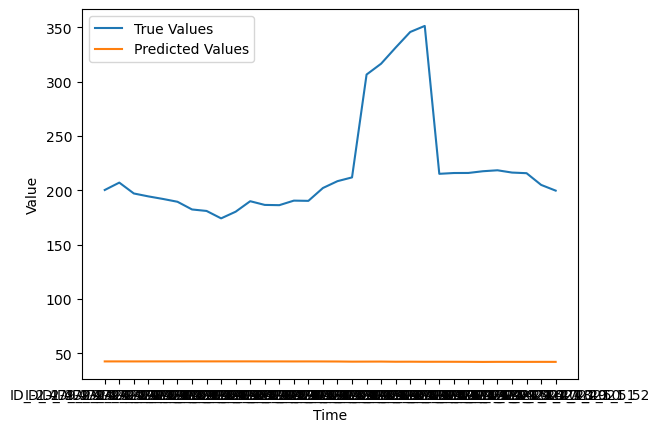

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.844_30.356
Epoch 1/50
3/3 [==============================] - 2s 206ms/step - loss: 11754.0273 - mse: 11754.0273 - accuracy: 0.0000e+00 - val_loss: 12090.1445 - val_mse: 12090.1445 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 31ms/step - loss: 11693.6025 - mse: 11693.6025 - accuracy: 0.0000e+00 - val_loss: 12035.3760 - val_mse: 12035.3760 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 11640.9795 - mse: 11640.9795 - accuracy: 0.0000e+00 - val_loss: 11981.7930 - val_mse: 11981.7930 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 11590.0410 - mse: 11590.0410 - accuracy: 0.0000e+00 - val_loss: 11930.8145 - val_mse: 11930.8145 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 11541.8770 - mse: 11541.8770 - accuracy: 0.0000e+00 - val_loss:

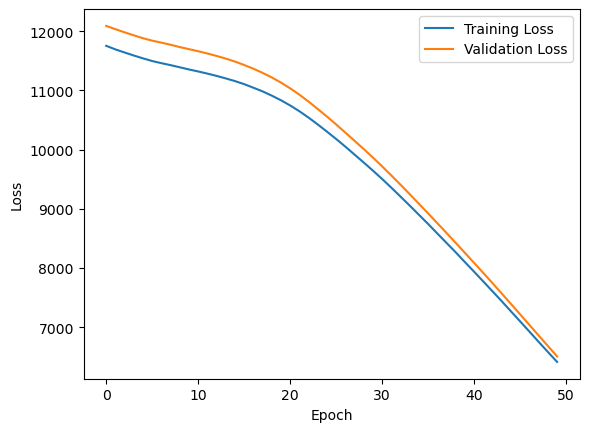

1/1 [==============================] - 0s 302ms/step


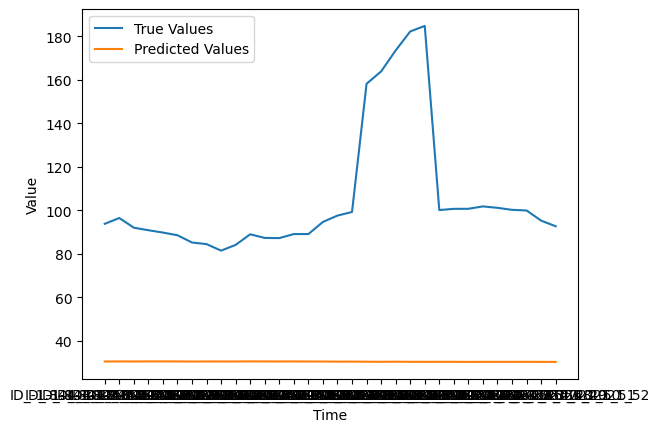

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.118_30.282
Epoch 1/50
3/3 [==============================] - 2s 202ms/step - loss: 431.8100 - mse: 431.8100 - accuracy: 0.0000e+00 - val_loss: 453.4669 - val_mse: 453.4669 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 32ms/step - loss: 415.4786 - mse: 415.4786 - accuracy: 0.0000e+00 - val_loss: 437.1567 - val_mse: 437.1567 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 400.4391 - mse: 400.4391 - accuracy: 0.0000e+00 - val_loss: 423.2709 - val_mse: 423.2709 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 387.8264 - mse: 387.8264 - accuracy: 0.0000e+00 - val_loss: 411.4199 - val_mse: 411.4199 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 376.8554 - mse: 376.8554 - accuracy: 0.0000e+00 - val_loss: 400.0628 - val_mse: 400.0628 - val_

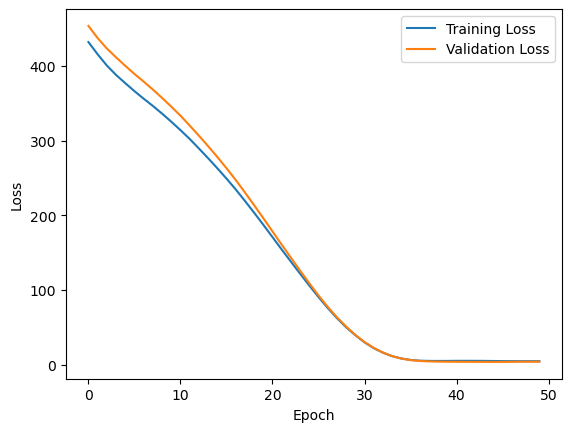

1/1 [==============================] - 0s 376ms/step


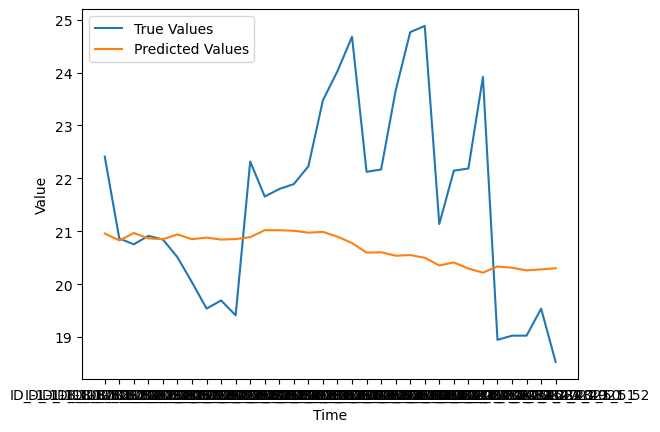

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.317_28.883
Epoch 1/50
3/3 [==============================] - 2s 186ms/step - loss: 1577.7795 - mse: 1577.7795 - accuracy: 0.0000e+00 - val_loss: 1593.1538 - val_mse: 1593.1538 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 1556.4181 - mse: 1556.4181 - accuracy: 0.0000e+00 - val_loss: 1577.8904 - val_mse: 1577.8904 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 1542.3567 - mse: 1542.3567 - accuracy: 0.0000e+00 - val_loss: 1564.4873 - val_mse: 1564.4873 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 1528.8690 - mse: 1528.8690 - accuracy: 0.0000e+00 - val_loss: 1550.1093 - val_mse: 1550.1093 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 1514.3126 - mse: 1514.3126 - accuracy: 0.0000e+00 - val_loss: 1533.5453 - val_m

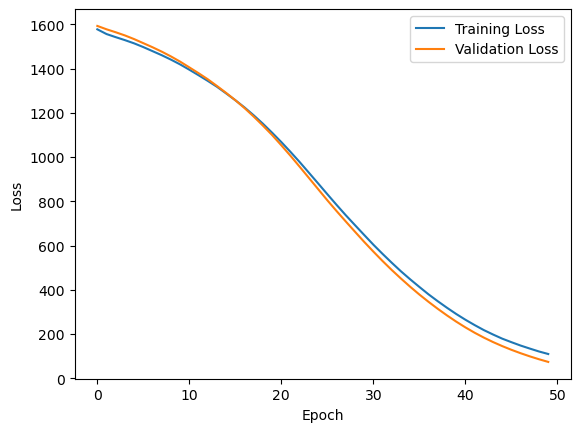

1/1 [==============================] - 0s 292ms/step


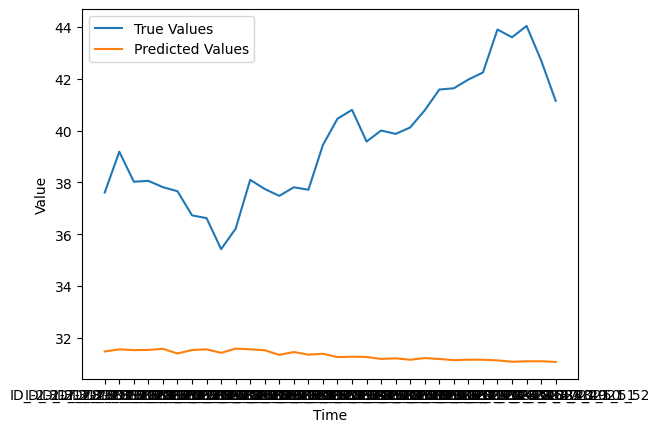

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.408_31.292
Epoch 1/50
3/3 [==============================] - 2s 198ms/step - loss: 738.7537 - mse: 738.7537 - accuracy: 0.0000e+00 - val_loss: 754.5815 - val_mse: 754.5815 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 30ms/step - loss: 728.7806 - mse: 728.7806 - accuracy: 0.0000e+00 - val_loss: 743.9506 - val_mse: 743.9506 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 718.3108 - mse: 718.3108 - accuracy: 0.0000e+00 - val_loss: 733.0717 - val_mse: 733.0717 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 707.7501 - mse: 707.7501 - accuracy: 0.0000e+00 - val_loss: 722.4762 - val_mse: 722.4762 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 697.4318 - mse: 697.4318 - accuracy: 0.0000e+00 - val_loss: 712.0261 - val_mse: 712.0261 - val_

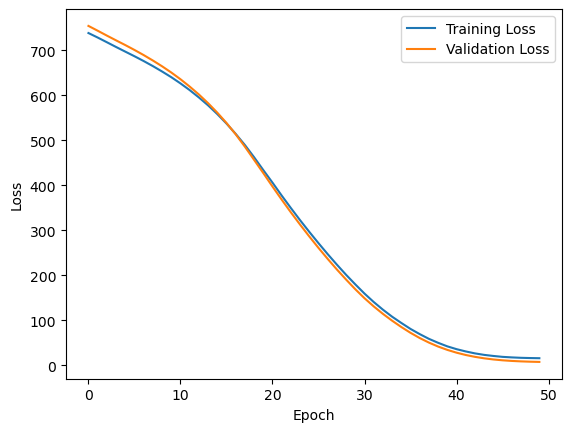

1/1 [==============================] - 0s 291ms/step


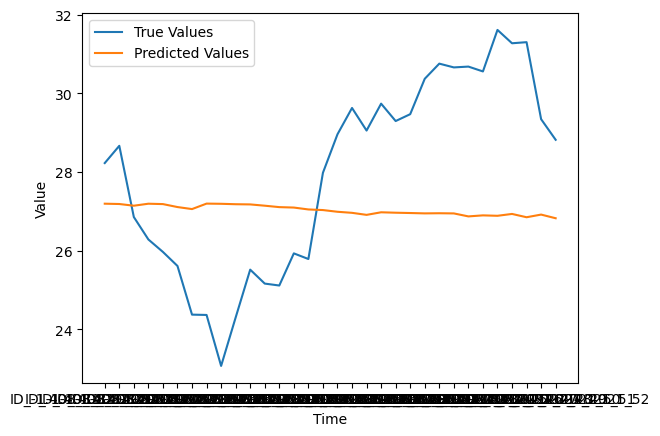

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -2.74_29.66
Epoch 1/50
3/3 [==============================] - 2s 191ms/step - loss: 5885.2354 - mse: 5885.2354 - accuracy: 0.0000e+00 - val_loss: 6112.3027 - val_mse: 6112.3027 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 5854.2617 - mse: 5854.2617 - accuracy: 0.0000e+00 - val_loss: 6088.3809 - val_mse: 6088.3809 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 5834.6279 - mse: 5834.6279 - accuracy: 0.0000e+00 - val_loss: 6073.8979 - val_mse: 6073.8979 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 5821.8706 - mse: 5821.8706 - accuracy: 0.0000e+00 - val_loss: 6064.0518 - val_mse: 6064.0518 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 5815.3350 - mse: 5815.3350 - accuracy: 0.0000e+00 - val_loss: 6059.7207 - val_mse

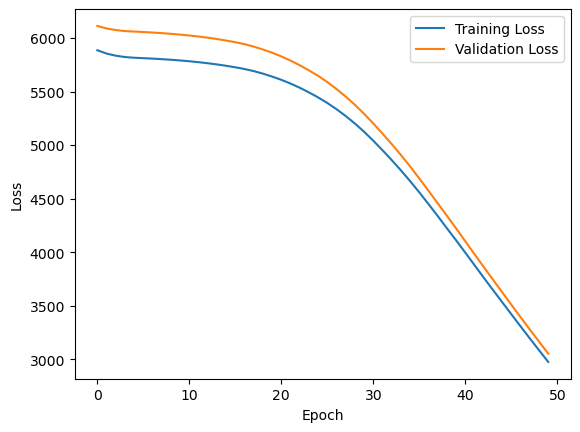

1/1 [==============================] - 0s 276ms/step


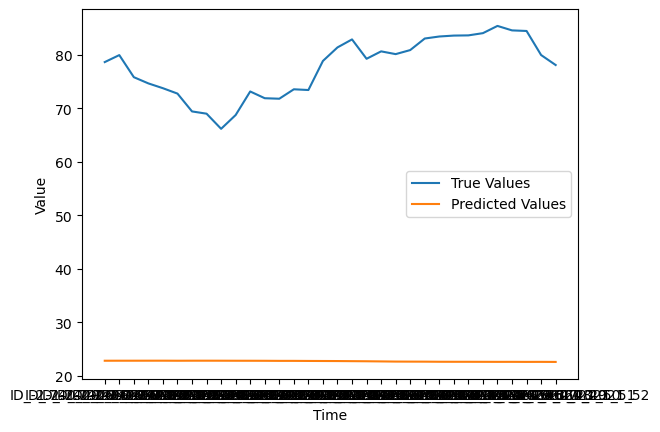

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.003_29.497
Epoch 1/50
3/3 [==============================] - 2s 205ms/step - loss: 519.7538 - mse: 519.7537 - accuracy: 0.0000e+00 - val_loss: 536.7527 - val_mse: 536.7527 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 39ms/step - loss: 503.3123 - mse: 503.3123 - accuracy: 0.0000e+00 - val_loss: 521.8672 - val_mse: 521.8672 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 489.5682 - mse: 489.5682 - accuracy: 0.0000e+00 - val_loss: 508.1935 - val_mse: 508.1935 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 476.6239 - mse: 476.6239 - accuracy: 0.0000e+00 - val_loss: 495.8053 - val_mse: 495.8053 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 464.6837 - mse: 464.6837 - accuracy: 0.0000e+00 - val_loss: 483.3814 - val_mse: 483.3814 - val_

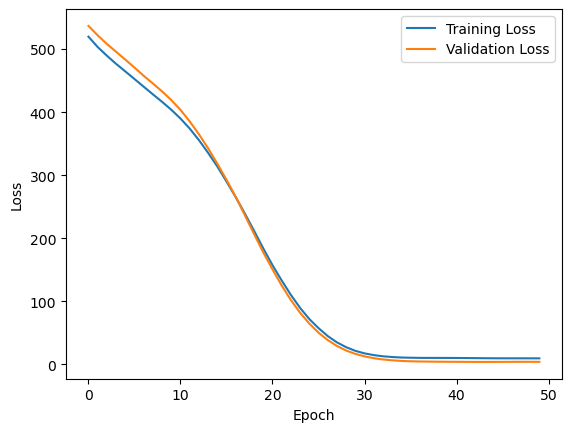

1/1 [==============================] - 0s 488ms/step


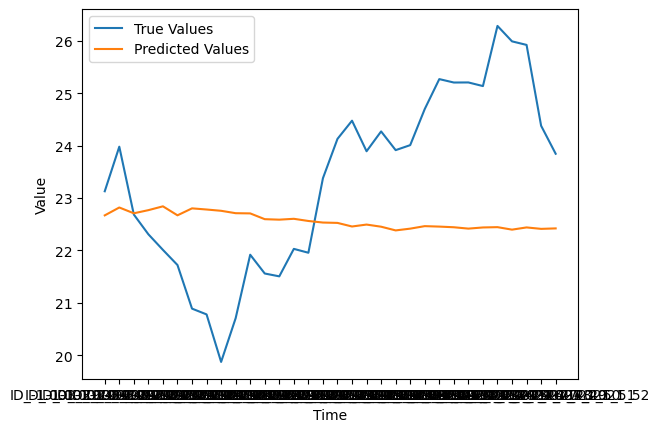

(49, 67)
2/2 [==============================] - 1s 7ms/step
LAT_LONG:  -3.138_30.662
Epoch 1/50
3/3 [==============================] - 3s 255ms/step - loss: 588.6196 - mse: 588.6196 - accuracy: 0.0000e+00 - val_loss: 614.0620 - val_mse: 614.0620 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 574.5737 - mse: 574.5736 - accuracy: 0.0000e+00 - val_loss: 600.8168 - val_mse: 600.8168 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 36ms/step - loss: 561.7556 - mse: 561.7556 - accuracy: 0.0000e+00 - val_loss: 588.9185 - val_mse: 588.9185 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 551.6379 - mse: 551.6379 - accuracy: 0.0000e+00 - val_loss: 580.2972 - val_mse: 580.2972 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 43ms/step - loss: 543.3942 - mse: 543.3942 - accuracy: 0.0000e+00 - val_loss: 571.6870 - val_mse: 571.6870 - val_

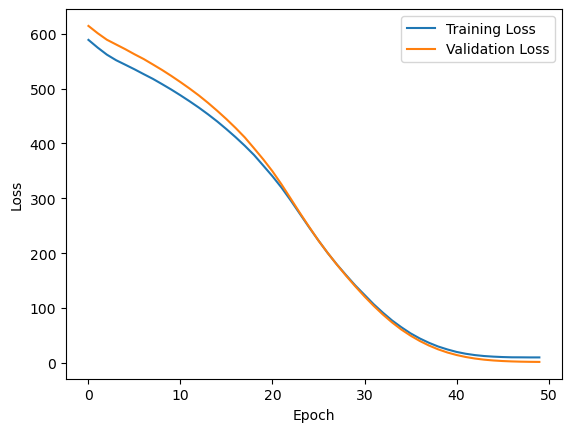

1/1 [==============================] - 0s 355ms/step


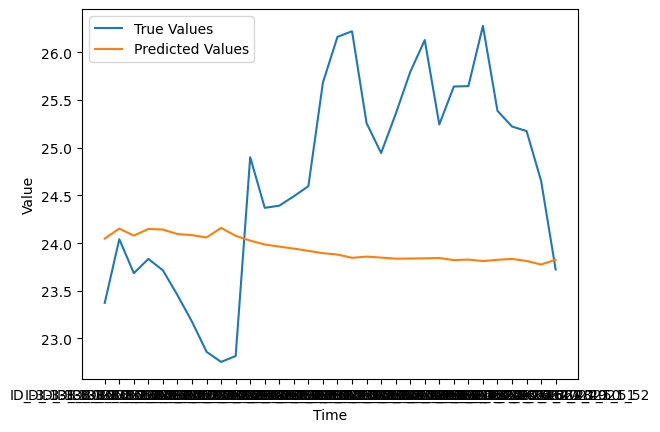

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -2.342_29.458
Epoch 1/50
3/3 [==============================] - 2s 212ms/step - loss: 3526.9822 - mse: 3526.9822 - accuracy: 0.0000e+00 - val_loss: 3665.3887 - val_mse: 3665.3887 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 31ms/step - loss: 3496.0698 - mse: 3496.0698 - accuracy: 0.0000e+00 - val_loss: 3635.9048 - val_mse: 3635.9048 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 32ms/step - loss: 3468.1631 - mse: 3468.1631 - accuracy: 0.0000e+00 - val_loss: 3608.1067 - val_mse: 3608.1067 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 31ms/step - loss: 3440.9912 - mse: 3440.9912 - accuracy: 0.0000e+00 - val_loss: 3580.3567 - val_mse: 3580.3567 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 3416.2983 - mse: 3416.2983 - accuracy: 0.0000e+00 - val_loss: 3558.9570 - val_m

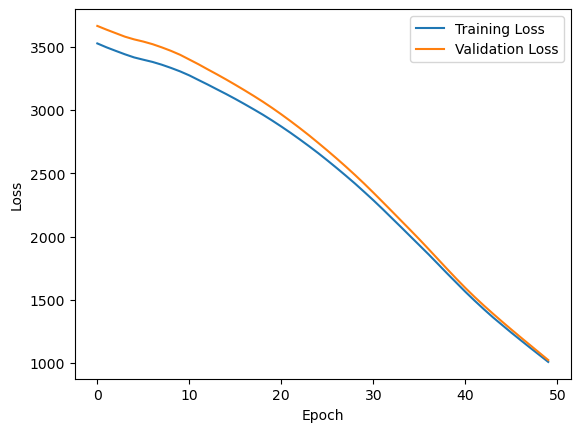

1/1 [==============================] - 0s 390ms/step


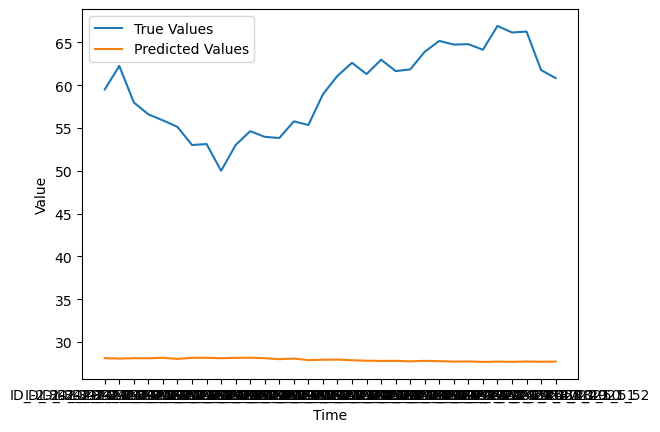

(49, 67)
2/2 [==============================] - 1s 12ms/step
LAT_LONG:  -1.335_29.465
Epoch 1/50
3/3 [==============================] - 3s 253ms/step - loss: 0.0324 - mse: 0.0324 - accuracy: 0.0000e+00 - val_loss: 9.2918e-04 - val_mse: 9.2918e-04 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 36ms/step - loss: 0.0047 - mse: 0.0047 - accuracy: 0.0000e+00 - val_loss: 0.0109 - val_mse: 0.0109 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 40ms/step - loss: 0.0091 - mse: 0.0091 - accuracy: 0.0000e+00 - val_loss: 0.0015 - val_mse: 0.0015 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 0.0012 - mse: 0.0012 - accuracy: 0.0000e+00 - val_loss: 0.0027 - val_mse: 0.0027 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 37ms/step - loss: 0.0032 - mse: 0.0032 - accuracy: 0.0000e+00 - val_loss: 0.0044 - val_mse: 0.0044 - val_accuracy: 0.0000e+00
Epoch 6/50

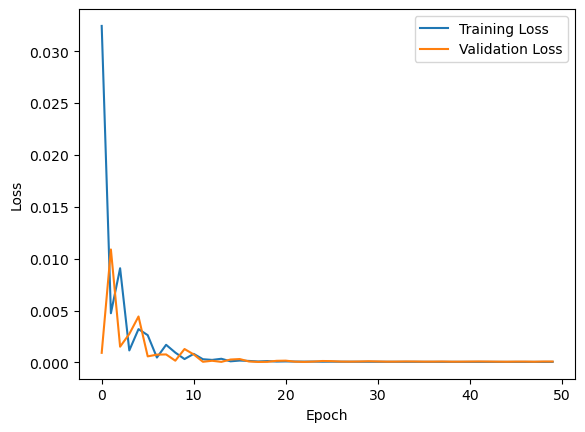

1/1 [==============================] - 1s 538ms/step


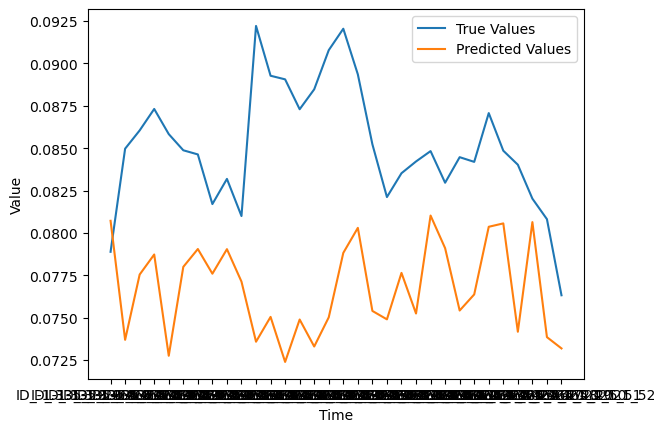

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.771_30.029
Epoch 1/50
3/3 [==============================] - 3s 242ms/step - loss: 23583.5625 - mse: 23583.5625 - accuracy: 0.0000e+00 - val_loss: 25426.8574 - val_mse: 25426.8574 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 41ms/step - loss: 23514.7539 - mse: 23514.7539 - accuracy: 0.0000e+00 - val_loss: 25361.0156 - val_mse: 25361.0156 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 44ms/step - loss: 23453.1914 - mse: 23453.1914 - accuracy: 0.0000e+00 - val_loss: 25300.0566 - val_mse: 25300.0566 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 36ms/step - loss: 23396.0703 - mse: 23396.0703 - accuracy: 0.0000e+00 - val_loss: 25241.3945 - val_mse: 25241.3945 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 32ms/step - loss: 23337.8887 - mse: 23337.8887 - accuracy: 0.0000e+00 - val_loss:

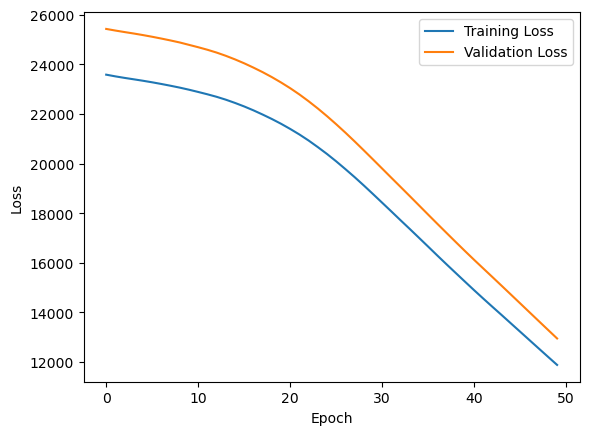

1/1 [==============================] - 0s 421ms/step


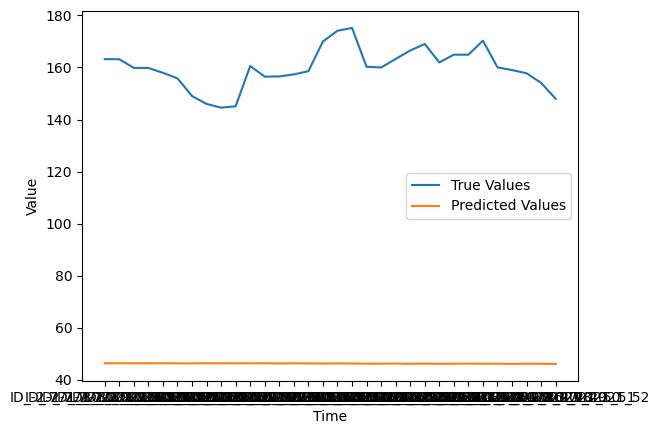

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.399_29.901
Epoch 1/50
3/3 [==============================] - 2s 203ms/step - loss: 7059.2612 - mse: 7059.2612 - accuracy: 0.0000e+00 - val_loss: 6994.6738 - val_mse: 6994.6738 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 32ms/step - loss: 7007.0205 - mse: 7007.0205 - accuracy: 0.0000e+00 - val_loss: 6943.4424 - val_mse: 6943.4424 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 6955.6846 - mse: 6955.6846 - accuracy: 0.0000e+00 - val_loss: 6893.1719 - val_mse: 6893.1719 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 6905.4829 - mse: 6905.4829 - accuracy: 0.0000e+00 - val_loss: 6844.3145 - val_mse: 6844.3145 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 6857.4316 - mse: 6857.4316 - accuracy: 0.0000e+00 - val_loss: 6792.9492 - val_m

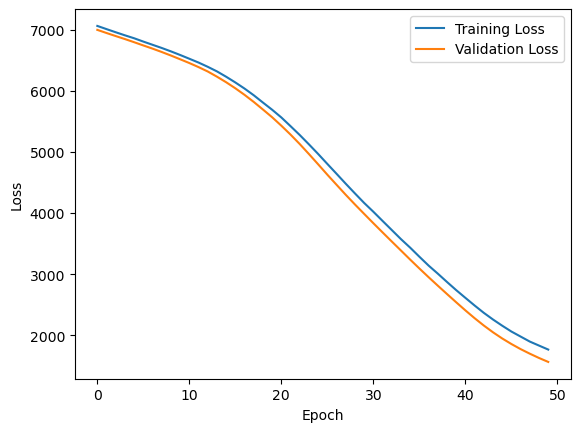

1/1 [==============================] - 0s 369ms/step


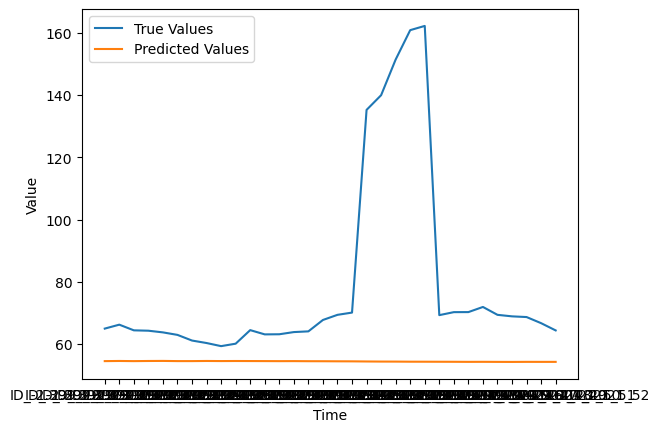

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -1.207_30.693
Epoch 1/50
3/3 [==============================] - 3s 452ms/step - loss: 467.4758 - mse: 467.4758 - accuracy: 0.0000e+00 - val_loss: 328.3682 - val_mse: 328.3682 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 49ms/step - loss: 454.4956 - mse: 454.4956 - accuracy: 0.0000e+00 - val_loss: 317.4178 - val_mse: 317.4178 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 51ms/step - loss: 443.0443 - mse: 443.0443 - accuracy: 0.0000e+00 - val_loss: 308.3490 - val_mse: 308.3490 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 44ms/step - loss: 432.6665 - mse: 432.6665 - accuracy: 0.0000e+00 - val_loss: 298.5381 - val_mse: 298.5381 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 61ms/step - loss: 421.7066 - mse: 421.7066 - accuracy: 0.0000e+00 - val_loss: 289.0862 - val_mse: 289.0862 - val_

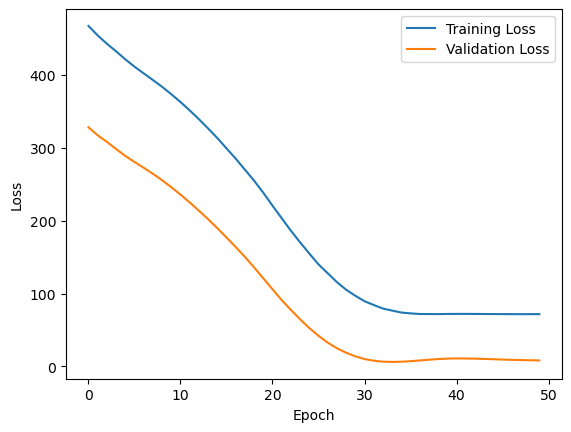

1/1 [==============================] - 1s 570ms/step


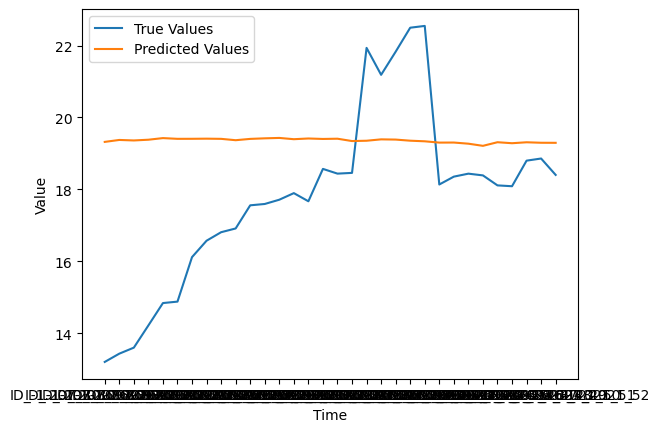

(49, 67)
2/2 [==============================] - 1s 7ms/step
LAT_LONG:  -2.86_28.74
Epoch 1/50
3/3 [==============================] - 3s 289ms/step - loss: 34284.8125 - mse: 34284.8125 - accuracy: 0.0000e+00 - val_loss: 35486.2891 - val_mse: 35486.2891 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 34115.7539 - mse: 34115.7539 - accuracy: 0.0000e+00 - val_loss: 35311.9609 - val_mse: 35311.9609 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 33955.4414 - mse: 33955.4414 - accuracy: 0.0000e+00 - val_loss: 35163.6406 - val_mse: 35163.6406 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 37ms/step - loss: 33815.9727 - mse: 33815.9727 - accuracy: 0.0000e+00 - val_loss: 35031.8359 - val_mse: 35031.8359 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 35ms/step - loss: 33688.6602 - mse: 33688.6602 - accuracy: 0.0000e+00 - val_loss: 3

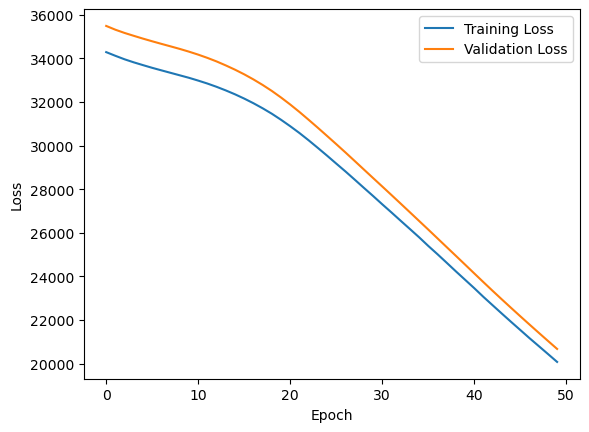

1/1 [==============================] - 0s 371ms/step


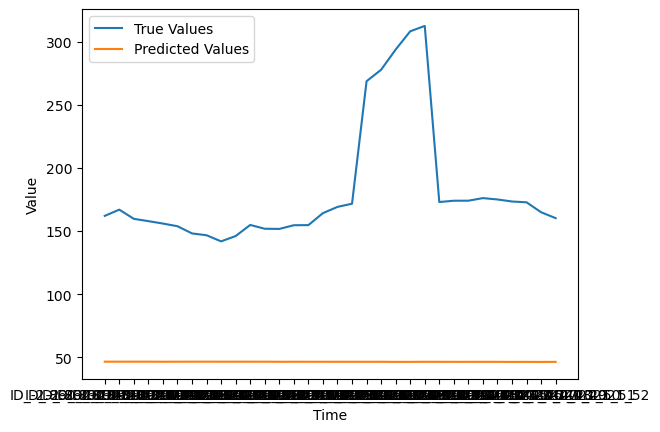

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.484_30.116
Epoch 1/50
3/3 [==============================] - 2s 216ms/step - loss: 5507.3809 - mse: 5507.3799 - accuracy: 0.0000e+00 - val_loss: 5392.0259 - val_mse: 5392.0259 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 34ms/step - loss: 5466.5186 - mse: 5466.5186 - accuracy: 0.0000e+00 - val_loss: 5354.7563 - val_mse: 5354.7563 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 5431.3374 - mse: 5431.3374 - accuracy: 0.0000e+00 - val_loss: 5321.7578 - val_mse: 5321.7578 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 5401.8315 - mse: 5401.8315 - accuracy: 0.0000e+00 - val_loss: 5293.5293 - val_mse: 5293.5293 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 5374.5264 - mse: 5374.5264 - accuracy: 0.0000e+00 - val_loss: 5265.6338 - val_m

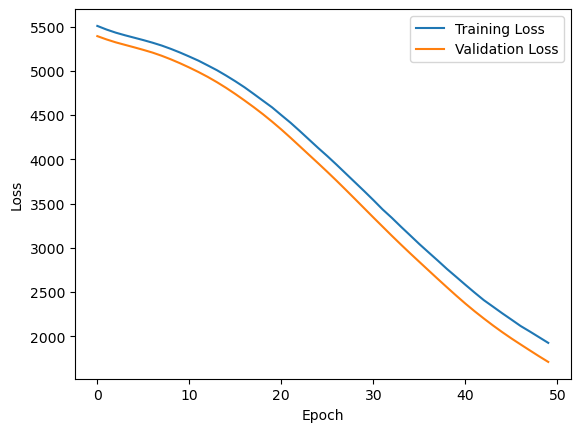

1/1 [==============================] - 0s 316ms/step


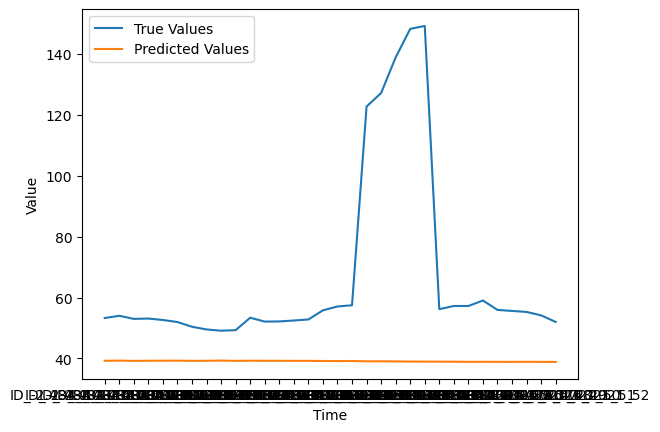

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -3.032_29.168
Epoch 1/50
3/3 [==============================] - 3s 262ms/step - loss: 361.6342 - mse: 361.6342 - accuracy: 0.0000e+00 - val_loss: 368.1428 - val_mse: 368.1428 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 32ms/step - loss: 353.8567 - mse: 353.8567 - accuracy: 0.0000e+00 - val_loss: 359.9061 - val_mse: 359.9061 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 36ms/step - loss: 345.6836 - mse: 345.6836 - accuracy: 0.0000e+00 - val_loss: 351.6193 - val_mse: 351.6193 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 37ms/step - loss: 337.4963 - mse: 337.4963 - accuracy: 0.0000e+00 - val_loss: 343.3335 - val_mse: 343.3335 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 329.2626 - mse: 329.2626 - accuracy: 0.0000e+00 - val_loss: 335.0168 - val_mse: 335.0168 - val_

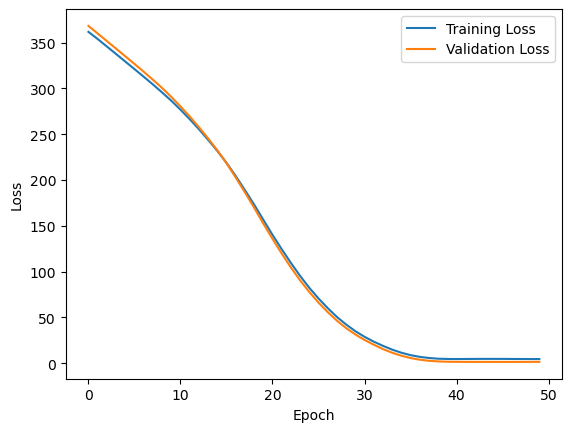

1/1 [==============================] - 0s 365ms/step


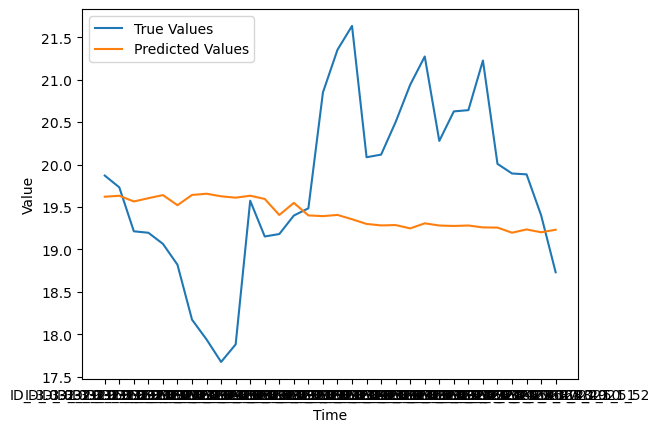

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.431_29.269
Epoch 1/50
3/3 [==============================] - 3s 243ms/step - loss: 766.4907 - mse: 766.4907 - accuracy: 0.0000e+00 - val_loss: 768.3313 - val_mse: 768.3313 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 745.8625 - mse: 745.8625 - accuracy: 0.0000e+00 - val_loss: 748.4808 - val_mse: 748.4808 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 32ms/step - loss: 727.5176 - mse: 727.5176 - accuracy: 0.0000e+00 - val_loss: 732.1720 - val_mse: 732.1720 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 711.5501 - mse: 711.5501 - accuracy: 0.0000e+00 - val_loss: 715.1694 - val_mse: 715.1694 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 695.4006 - mse: 695.4006 - accuracy: 0.0000e+00 - val_loss: 699.3646 - val_mse: 699.3646 - val_

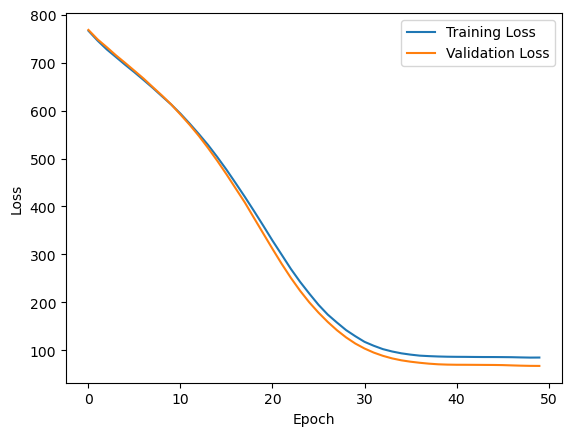

1/1 [==============================] - 0s 396ms/step


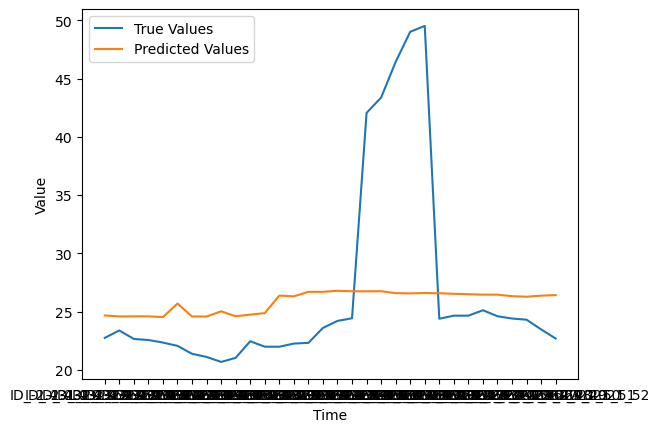

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.833_28.467
Epoch 1/50
3/3 [==============================] - 2s 198ms/step - loss: 0.4515 - mse: 0.4515 - accuracy: 1.0000 - val_loss: 0.1291 - val_mse: 0.1291 - val_accuracy: 1.0000
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 0.0492 - mse: 0.0492 - accuracy: 1.0000 - val_loss: 0.0055 - val_mse: 0.0055 - val_accuracy: 1.0000
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 0.0155 - mse: 0.0155 - accuracy: 1.0000 - val_loss: 0.0290 - val_mse: 0.0290 - val_accuracy: 1.0000
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 0.0360 - mse: 0.0360 - accuracy: 1.0000 - val_loss: 0.0287 - val_mse: 0.0287 - val_accuracy: 1.0000
Epoch 5/50
3/3 [==============================] - 0s 26ms/step - loss: 0.0269 - mse: 0.0269 - accuracy: 1.0000 - val_loss: 0.0108 - val_mse: 0.0108 - val_accuracy: 1.0000
Epoch 6/50
3/3 [==============================] - 0s 27ms/s

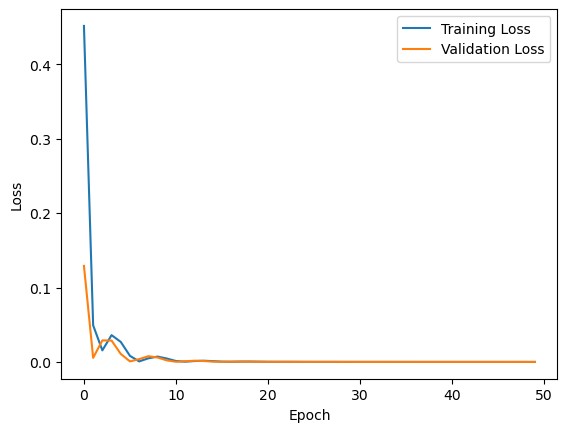

1/1 [==============================] - 0s 297ms/step


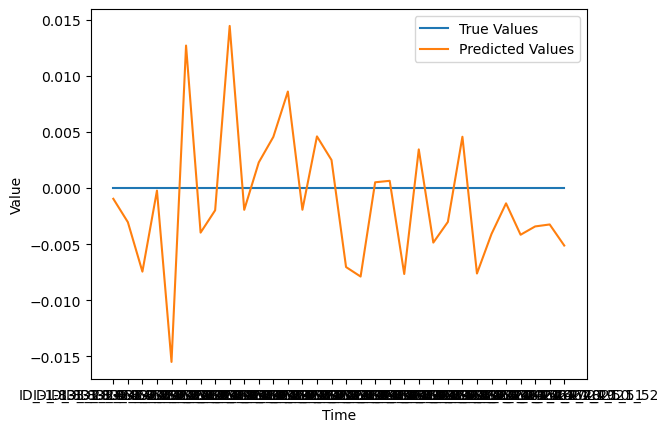

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.447_28.353
Epoch 1/50
3/3 [==============================] - 3s 195ms/step - loss: 2.4535 - mse: 2.4535 - accuracy: 0.0000e+00 - val_loss: 1.2621 - val_mse: 1.2621 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 30ms/step - loss: 1.7689 - mse: 1.7689 - accuracy: 0.0000e+00 - val_loss: 0.7918 - val_mse: 0.7918 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 32ms/step - loss: 1.3236 - mse: 1.3236 - accuracy: 0.0000e+00 - val_loss: 0.4849 - val_mse: 0.4849 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 0.9991 - mse: 0.9991 - accuracy: 0.0000e+00 - val_loss: 0.2806 - val_mse: 0.2806 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 0.7845 - mse: 0.7845 - accuracy: 0.0000e+00 - val_loss: 0.1558 - val_mse: 0.1558 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

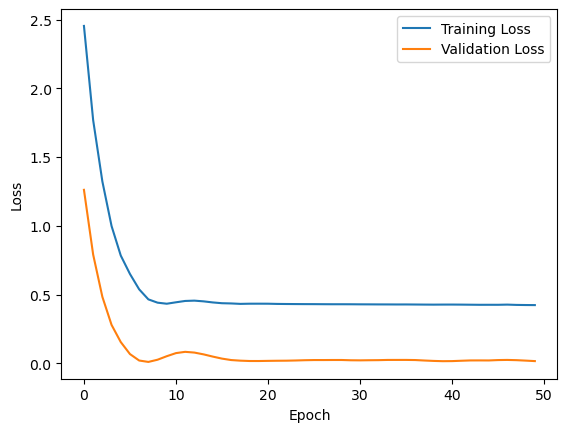

1/1 [==============================] - 0s 375ms/step


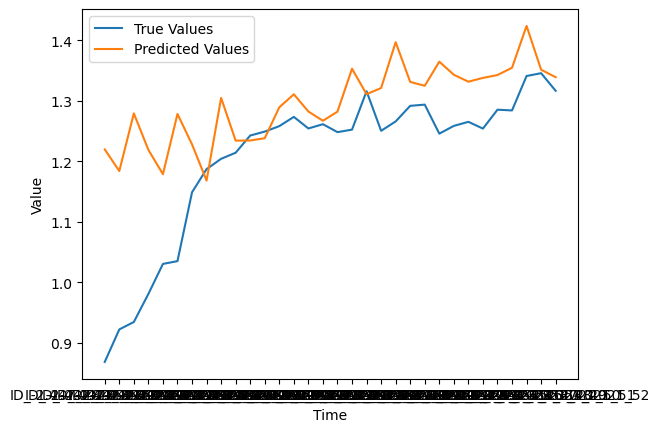

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.7_29.5
Epoch 1/50
3/3 [==============================] - 2s 224ms/step - loss: 14355.0078 - mse: 14355.0078 - accuracy: 0.0000e+00 - val_loss: 14816.3418 - val_mse: 14816.3418 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 14286.2266 - mse: 14286.2266 - accuracy: 0.0000e+00 - val_loss: 14742.2168 - val_mse: 14742.2168 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 14213.0371 - mse: 14213.0371 - accuracy: 0.0000e+00 - val_loss: 14666.6172 - val_mse: 14666.6172 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 14138.1914 - mse: 14138.1914 - accuracy: 0.0000e+00 - val_loss: 14588.0605 - val_mse: 14588.0605 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 14061.6104 - mse: 14061.6104 - accuracy: 0.0000e+00 - val_loss: 145

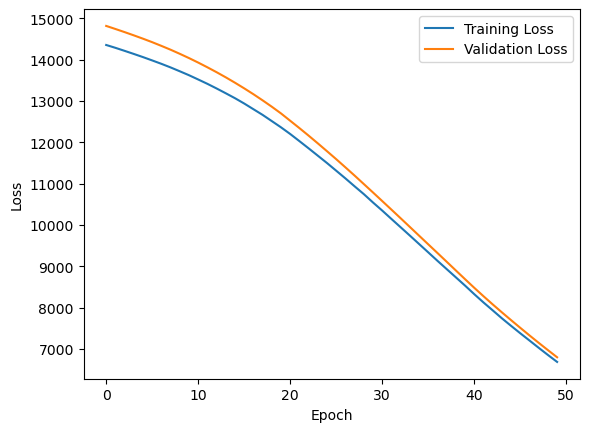

1/1 [==============================] - 0s 303ms/step


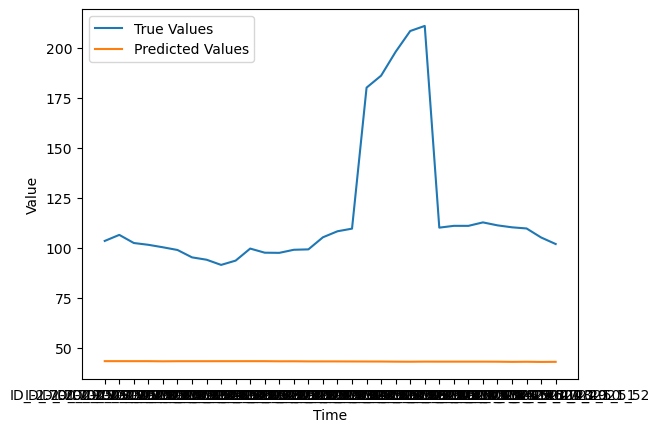

(49, 67)
2/2 [==============================] - 0s 9ms/step
LAT_LONG:  -1.877_30.623
Epoch 1/50
3/3 [==============================] - 3s 215ms/step - loss: 0.0978 - mse: 0.0978 - accuracy: 0.0000e+00 - val_loss: 0.0370 - val_mse: 0.0370 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 38ms/step - loss: 0.0342 - mse: 0.0342 - accuracy: 0.0000e+00 - val_loss: 0.0384 - val_mse: 0.0384 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 35ms/step - loss: 0.0452 - mse: 0.0452 - accuracy: 0.0000e+00 - val_loss: 0.0377 - val_mse: 0.0377 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 37ms/step - loss: 0.0378 - mse: 0.0378 - accuracy: 0.0000e+00 - val_loss: 0.0314 - val_mse: 0.0314 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 36ms/step - loss: 0.0273 - mse: 0.0273 - accuracy: 0.0000e+00 - val_loss: 0.0336 - val_mse: 0.0336 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

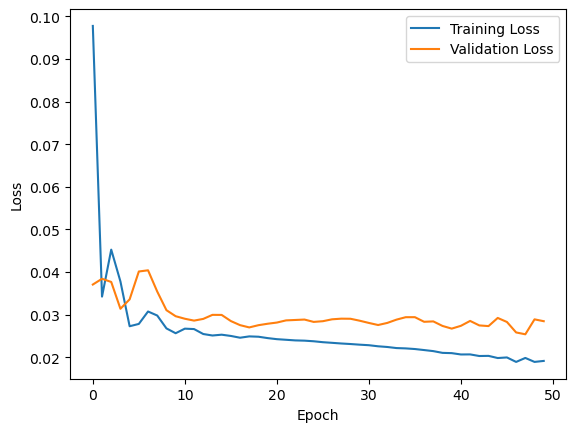

1/1 [==============================] - 0s 340ms/step


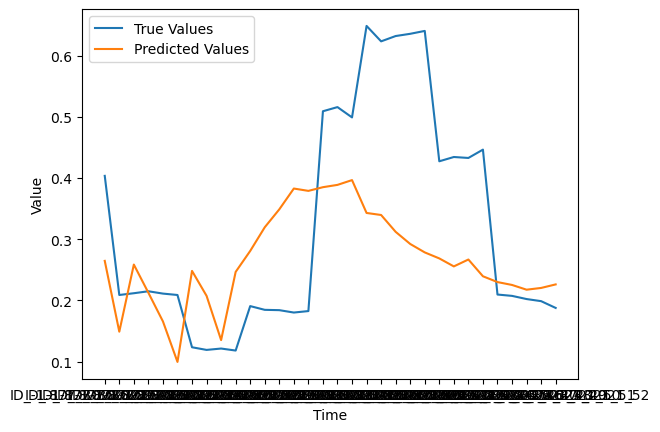

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.753_28.547
Epoch 1/50
3/3 [==============================] - 2s 187ms/step - loss: 595.7144 - mse: 595.7144 - accuracy: 0.0000e+00 - val_loss: 610.1589 - val_mse: 610.1589 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 31ms/step - loss: 578.9108 - mse: 578.9108 - accuracy: 0.0000e+00 - val_loss: 594.8751 - val_mse: 594.8751 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 29ms/step - loss: 563.9403 - mse: 563.9403 - accuracy: 0.0000e+00 - val_loss: 579.2646 - val_mse: 579.2646 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 548.7740 - mse: 548.7740 - accuracy: 0.0000e+00 - val_loss: 563.3639 - val_mse: 563.3639 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 533.3843 - mse: 533.3843 - accuracy: 0.0000e+00 - val_loss: 547.1284 - val_mse: 547.1284 - val_

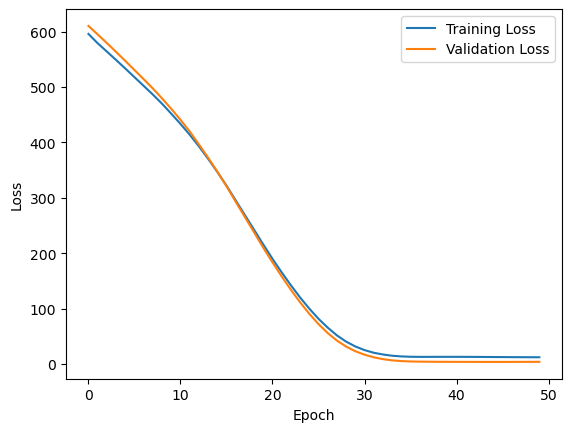

1/1 [==============================] - 0s 259ms/step


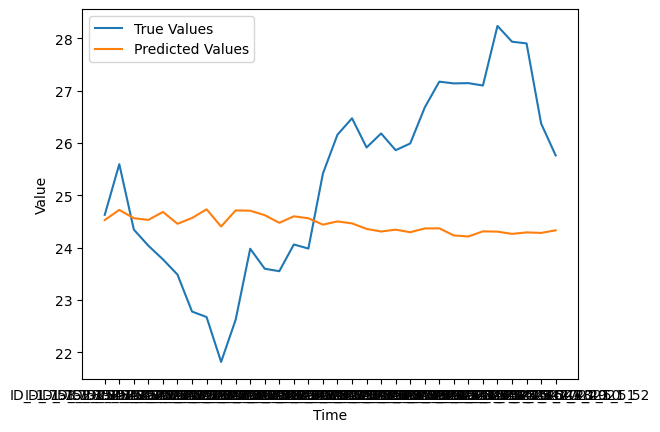

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.466_30.334
Epoch 1/50
3/3 [==============================] - 2s 201ms/step - loss: 203.0098 - mse: 203.0098 - accuracy: 0.0000e+00 - val_loss: 193.8224 - val_mse: 193.8224 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 30ms/step - loss: 199.3670 - mse: 199.3670 - accuracy: 0.0000e+00 - val_loss: 189.8462 - val_mse: 189.8462 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 29ms/step - loss: 195.4329 - mse: 195.4329 - accuracy: 0.0000e+00 - val_loss: 185.5618 - val_mse: 185.5618 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 191.3757 - mse: 191.3757 - accuracy: 0.0000e+00 - val_loss: 181.1035 - val_mse: 181.1035 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 186.9464 - mse: 186.9464 - accuracy: 0.0000e+00 - val_loss: 176.4187 - val_mse: 176.4187 - val_

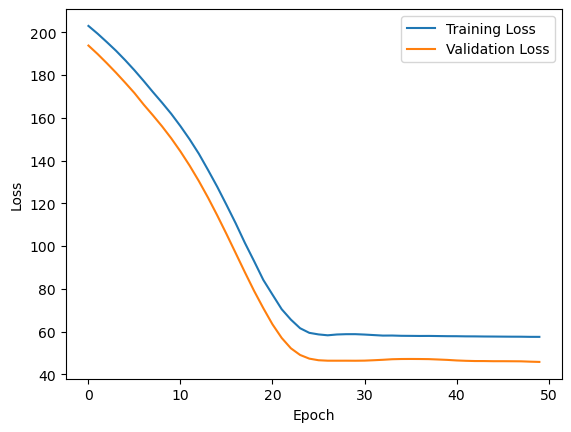

1/1 [==============================] - 0s 269ms/step


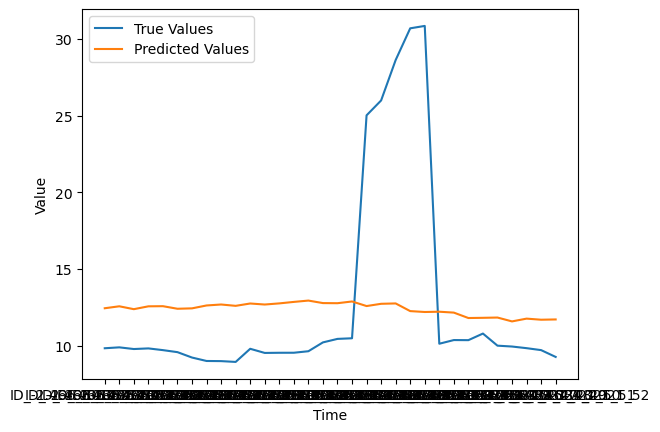

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.13_30.07
Epoch 1/50
3/3 [==============================] - 2s 209ms/step - loss: 2526.6375 - mse: 2526.6375 - accuracy: 0.0000e+00 - val_loss: 2757.8323 - val_mse: 2757.8323 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 2499.1125 - mse: 2499.1125 - accuracy: 0.0000e+00 - val_loss: 2729.5186 - val_mse: 2729.5186 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 36ms/step - loss: 2472.1328 - mse: 2472.1328 - accuracy: 0.0000e+00 - val_loss: 2701.7290 - val_mse: 2701.7290 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 41ms/step - loss: 2445.9673 - mse: 2445.9673 - accuracy: 0.0000e+00 - val_loss: 2674.0168 - val_mse: 2674.0168 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 38ms/step - loss: 2420.1472 - mse: 2420.1472 - accuracy: 0.0000e+00 - val_loss: 2645.3760 - val_mse

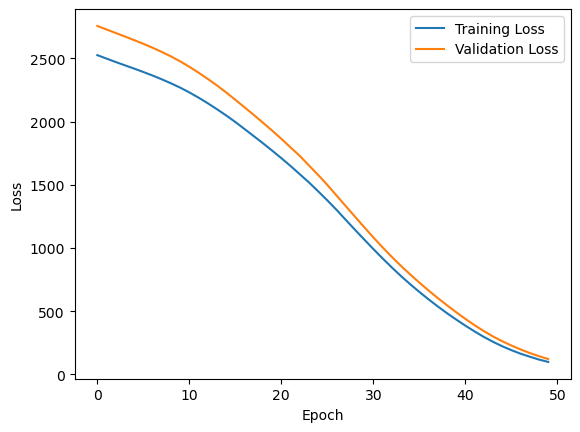

1/1 [==============================] - 0s 299ms/step


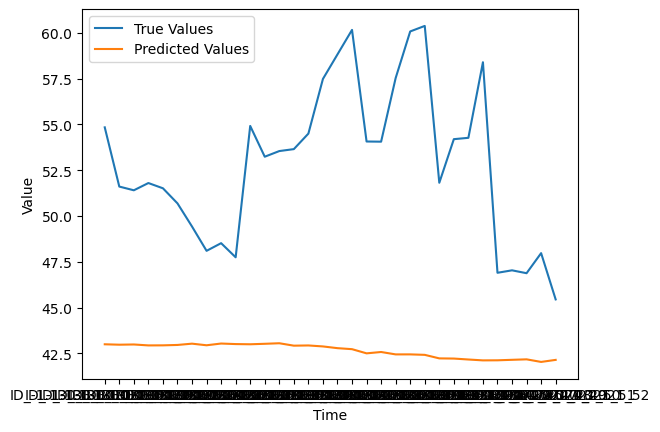

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.533_28.467
Epoch 1/50
3/3 [==============================] - 2s 190ms/step - loss: 1.8417 - mse: 1.8417 - accuracy: 0.0000e+00 - val_loss: 0.8290 - val_mse: 0.8290 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 1.4637 - mse: 1.4637 - accuracy: 0.0000e+00 - val_loss: 0.5549 - val_mse: 0.5549 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 1.1586 - mse: 1.1586 - accuracy: 0.0000e+00 - val_loss: 0.3406 - val_mse: 0.3406 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 0.9021 - mse: 0.9021 - accuracy: 0.0000e+00 - val_loss: 0.1823 - val_mse: 0.1823 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 0.7179 - mse: 0.7179 - accuracy: 0.0000e+00 - val_loss: 0.0681 - val_mse: 0.0681 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

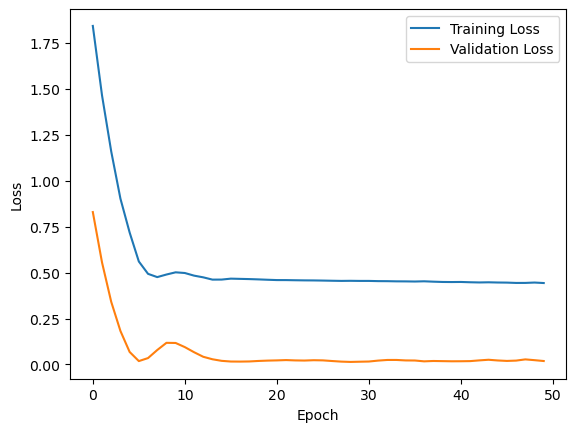

1/1 [==============================] - 0s 317ms/step


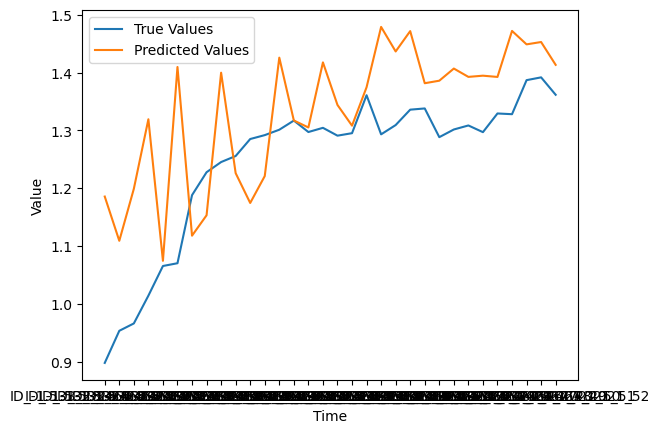

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.204_30.996
Epoch 1/50
3/3 [==============================] - 2s 204ms/step - loss: 1449.8263 - mse: 1449.8263 - accuracy: 0.0000e+00 - val_loss: 1412.9932 - val_mse: 1412.9932 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 1427.2333 - mse: 1427.2333 - accuracy: 0.0000e+00 - val_loss: 1391.2820 - val_mse: 1391.2820 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 1405.4866 - mse: 1405.4866 - accuracy: 0.0000e+00 - val_loss: 1369.5762 - val_mse: 1369.5762 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 1383.8608 - mse: 1383.8608 - accuracy: 0.0000e+00 - val_loss: 1347.3728 - val_mse: 1347.3728 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 1361.3838 - mse: 1361.3838 - accuracy: 0.0000e+00 - val_loss: 1324.1102 - val_m

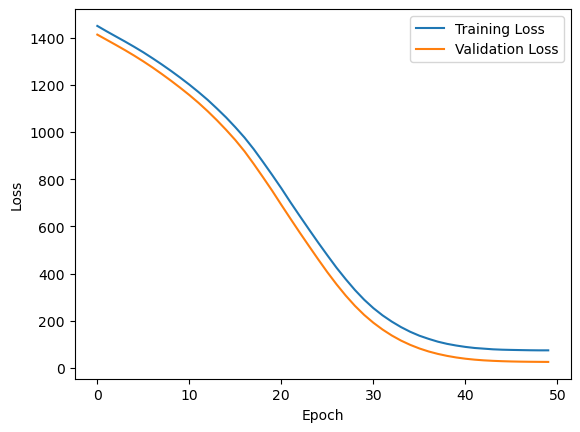

1/1 [==============================] - 0s 282ms/step


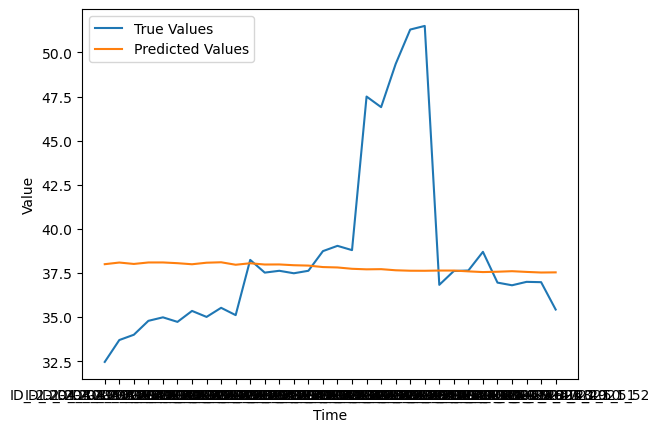

(49, 67)
2/2 [==============================] - 1s 6ms/step
LAT_LONG:  -0.853_30.647
Epoch 1/50
3/3 [==============================] - 2s 192ms/step - loss: 2857.4751 - mse: 2857.4751 - accuracy: 0.0000e+00 - val_loss: 3146.5840 - val_mse: 3146.5840 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 36ms/step - loss: 2834.8726 - mse: 2834.8726 - accuracy: 0.0000e+00 - val_loss: 3124.1018 - val_mse: 3124.1018 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 2813.5896 - mse: 2813.5896 - accuracy: 0.0000e+00 - val_loss: 3101.7271 - val_mse: 3101.7271 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 2792.2949 - mse: 2792.2949 - accuracy: 0.0000e+00 - val_loss: 3079.0657 - val_mse: 3079.0657 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 2770.7224 - mse: 2770.7224 - accuracy: 0.0000e+00 - val_loss: 3055.6694 - val_m

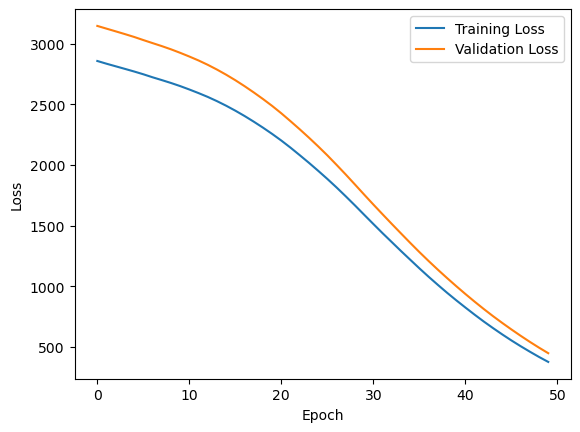

1/1 [==============================] - 0s 288ms/step


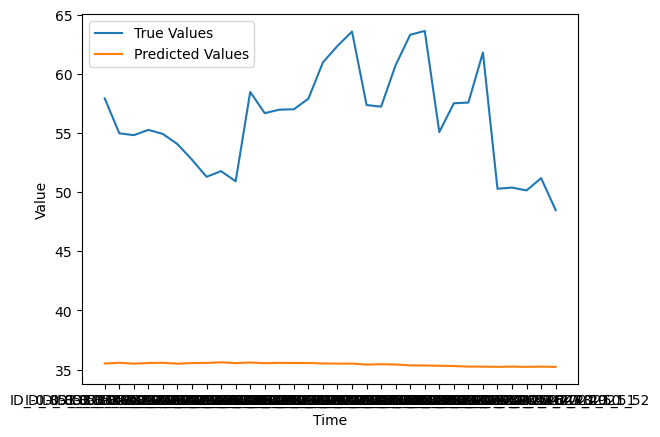

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -0.787_30.513
Epoch 1/50
3/3 [==============================] - 2s 205ms/step - loss: 11.8089 - mse: 11.8089 - accuracy: 0.0000e+00 - val_loss: 10.5530 - val_mse: 10.5530 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 8.9727 - mse: 8.9727 - accuracy: 0.0000e+00 - val_loss: 7.9591 - val_mse: 7.9591 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 29ms/step - loss: 6.6195 - mse: 6.6195 - accuracy: 0.0000e+00 - val_loss: 5.8376 - val_mse: 5.8376 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 4.7365 - mse: 4.7365 - accuracy: 0.0000e+00 - val_loss: 4.1381 - val_mse: 4.1381 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 3.2412 - mse: 3.2412 - accuracy: 0.0000e+00 - val_loss: 2.8248 - val_mse: 2.8248 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 

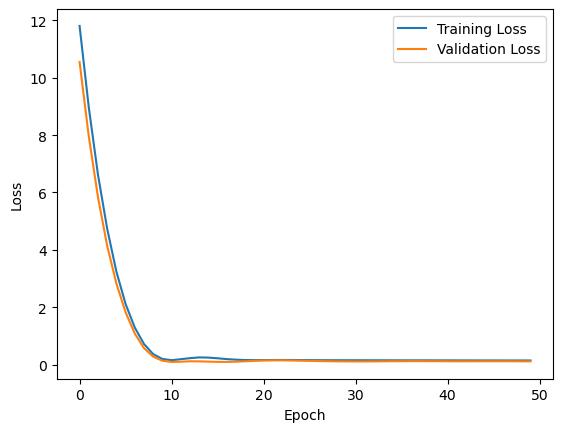

1/1 [==============================] - 0s 306ms/step


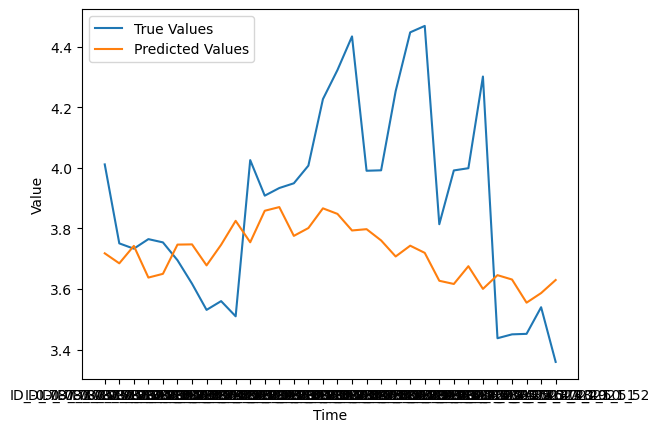

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.939_30.461
Epoch 1/50
3/3 [==============================] - 2s 197ms/step - loss: 131.2478 - mse: 131.2478 - accuracy: 0.0000e+00 - val_loss: 127.3190 - val_mse: 127.3190 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 26ms/step - loss: 125.7215 - mse: 125.7215 - accuracy: 0.0000e+00 - val_loss: 122.4442 - val_mse: 122.4442 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 120.9451 - mse: 120.9451 - accuracy: 0.0000e+00 - val_loss: 117.9922 - val_mse: 117.9922 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 117.0836 - mse: 117.0836 - accuracy: 0.0000e+00 - val_loss: 114.8747 - val_mse: 114.8747 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 114.3106 - mse: 114.3106 - accuracy: 0.0000e+00 - val_loss: 112.5070 - val_mse: 112.5070 - val_

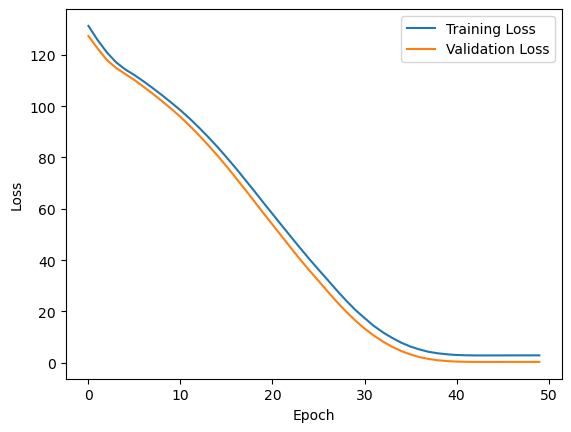

1/1 [==============================] - 0s 293ms/step


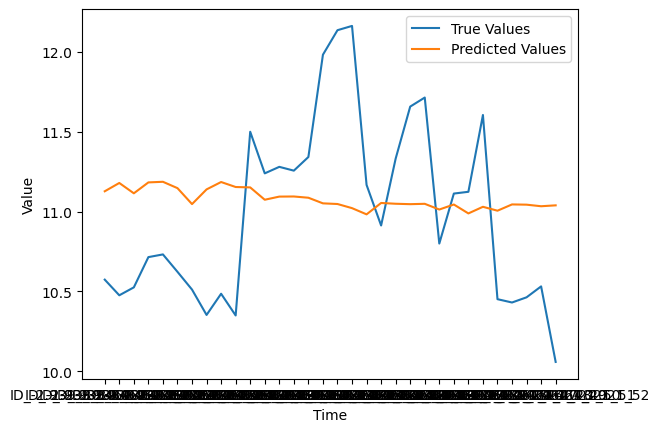

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.751_29.249
Epoch 1/50
3/3 [==============================] - 2s 220ms/step - loss: 4.6750 - mse: 4.6750 - accuracy: 0.0000e+00 - val_loss: 4.3939 - val_mse: 4.3939 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 3.1611 - mse: 3.1611 - accuracy: 0.0000e+00 - val_loss: 3.1465 - val_mse: 3.1465 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 2.1661 - mse: 2.1661 - accuracy: 0.0000e+00 - val_loss: 2.3064 - val_mse: 2.3064 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 1.4960 - mse: 1.4960 - accuracy: 0.0000e+00 - val_loss: 1.6343 - val_mse: 1.6343 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 0.9720 - mse: 0.9720 - accuracy: 0.0000e+00 - val_loss: 1.0692 - val_mse: 1.0692 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

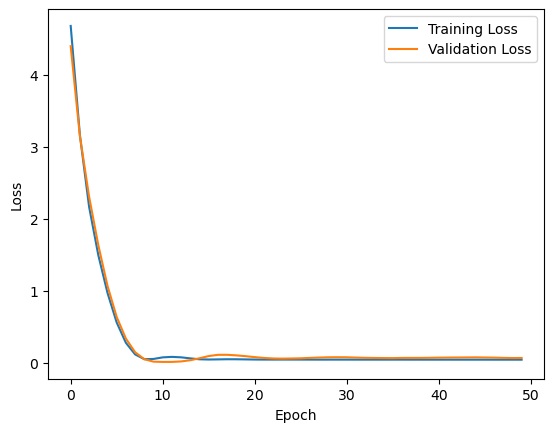

1/1 [==============================] - 0s 322ms/step


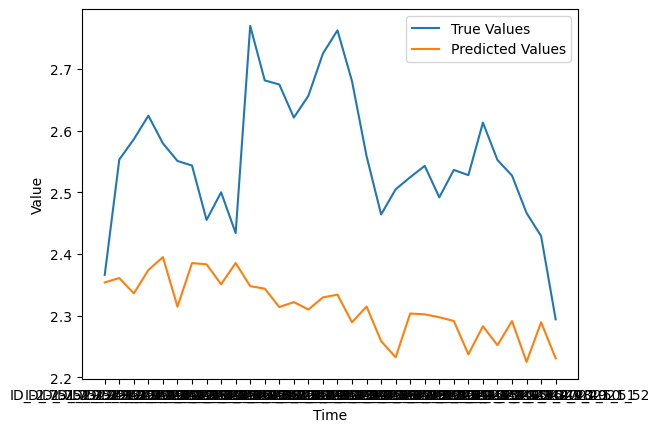

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.92_29.68
Epoch 1/50
3/3 [==============================] - 2s 204ms/step - loss: 11634.9209 - mse: 11634.9209 - accuracy: 0.0000e+00 - val_loss: 11958.4922 - val_mse: 11958.4922 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 11577.1250 - mse: 11577.1250 - accuracy: 0.0000e+00 - val_loss: 11906.8682 - val_mse: 11906.8682 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 29ms/step - loss: 11526.0020 - mse: 11526.0020 - accuracy: 0.0000e+00 - val_loss: 11852.4902 - val_mse: 11852.4902 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 11471.3232 - mse: 11471.3232 - accuracy: 0.0000e+00 - val_loss: 11793.7197 - val_mse: 11793.7197 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 11413.9033 - mse: 11413.9033 - accuracy: 0.0000e+00 - val_loss: 1

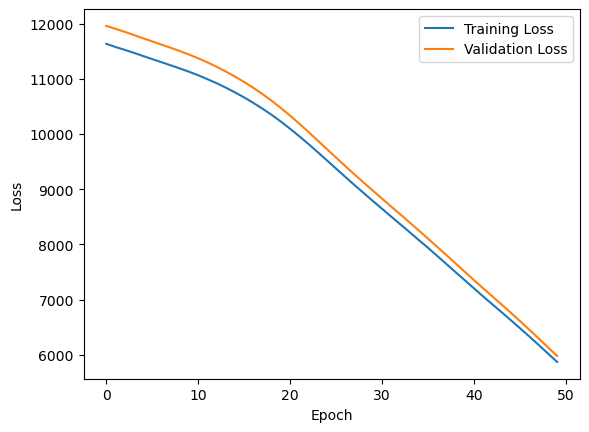

1/1 [==============================] - 0s 277ms/step


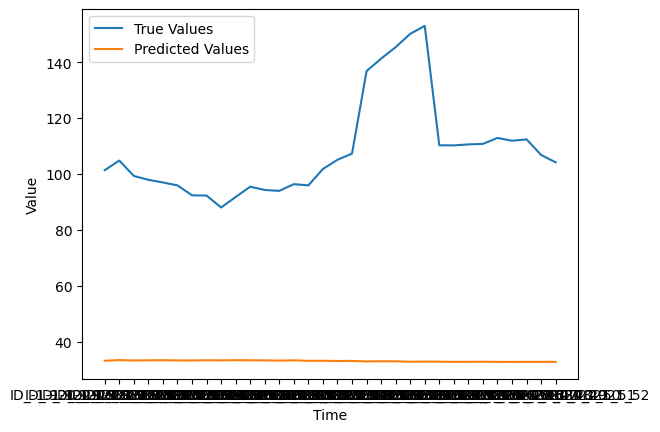

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.638_29.562
Epoch 1/50
3/3 [==============================] - 2s 209ms/step - loss: 32927.1445 - mse: 32927.1445 - accuracy: 0.0000e+00 - val_loss: 34371.5000 - val_mse: 34371.5000 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 31ms/step - loss: 32816.1758 - mse: 32816.1758 - accuracy: 0.0000e+00 - val_loss: 34261.3281 - val_mse: 34261.3281 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 32709.2637 - mse: 32709.2637 - accuracy: 0.0000e+00 - val_loss: 34146.8672 - val_mse: 34146.8672 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 32597.1230 - mse: 32597.1211 - accuracy: 0.0000e+00 - val_loss: 34029.7070 - val_mse: 34029.7070 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 32482.2051 - mse: 32482.2051 - accuracy: 0.0000e+00 - val_loss:

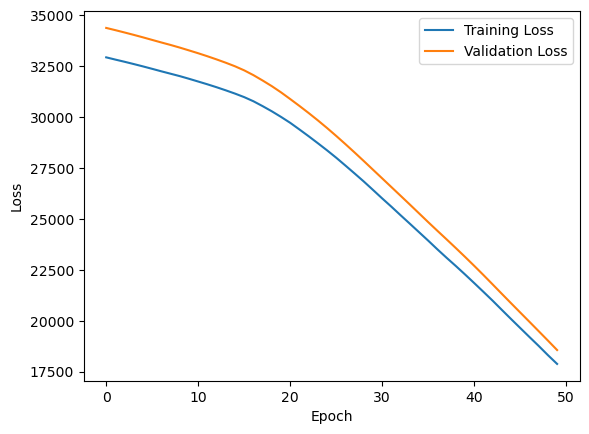

1/1 [==============================] - 0s 315ms/step


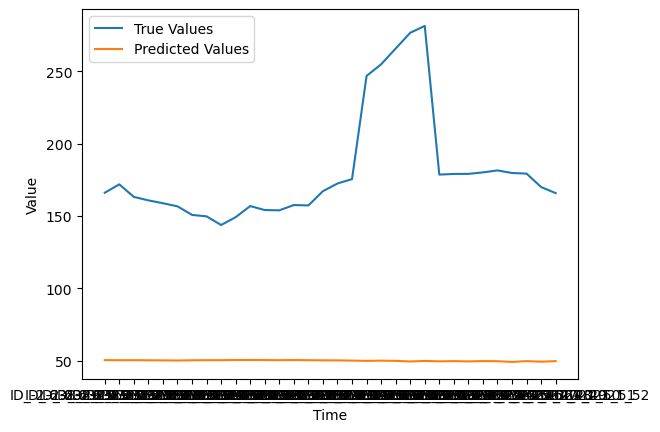

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.235_30.765
Epoch 1/50
3/3 [==============================] - 2s 189ms/step - loss: 4428.0776 - mse: 4428.0776 - accuracy: 0.0000e+00 - val_loss: 4250.0791 - val_mse: 4250.0791 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 4397.0933 - mse: 4397.0933 - accuracy: 0.0000e+00 - val_loss: 4220.6113 - val_mse: 4220.6113 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 4368.1040 - mse: 4368.1040 - accuracy: 0.0000e+00 - val_loss: 4193.0938 - val_mse: 4193.0938 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 4341.7383 - mse: 4341.7383 - accuracy: 0.0000e+00 - val_loss: 4167.8965 - val_mse: 4167.8965 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 32ms/step - loss: 4316.2036 - mse: 4316.2036 - accuracy: 0.0000e+00 - val_loss: 4142.4106 - val_m

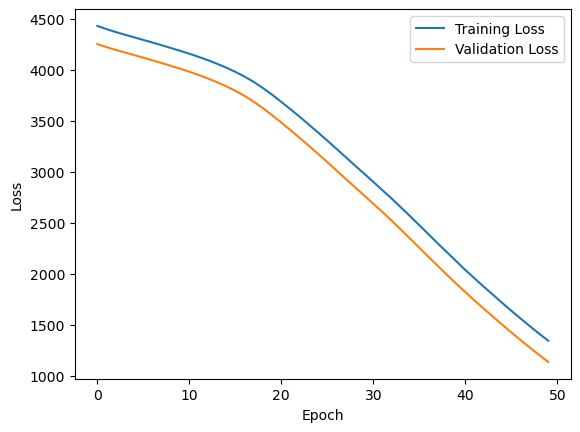

1/1 [==============================] - 0s 387ms/step


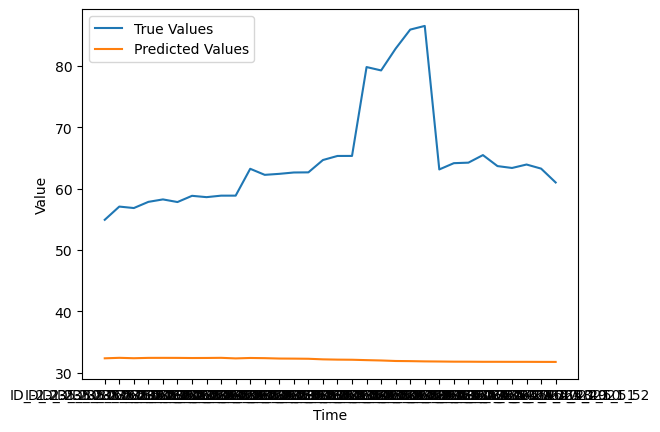

(49, 67)
2/2 [==============================] - 1s 8ms/step
LAT_LONG:  -1.014_29.786
Epoch 1/50
3/3 [==============================] - 2s 206ms/step - loss: 3438.0042 - mse: 3438.0042 - accuracy: 0.0000e+00 - val_loss: 3622.6240 - val_mse: 3622.6240 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 31ms/step - loss: 3385.6099 - mse: 3385.6099 - accuracy: 0.0000e+00 - val_loss: 3568.3003 - val_mse: 3568.3003 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 3333.1177 - mse: 3333.1177 - accuracy: 0.0000e+00 - val_loss: 3513.5813 - val_mse: 3513.5813 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 3280.3567 - mse: 3280.3567 - accuracy: 0.0000e+00 - val_loss: 3459.4443 - val_mse: 3459.4443 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 3227.8164 - mse: 3227.8164 - accuracy: 0.0000e+00 - val_loss: 3404.2678 - val_m

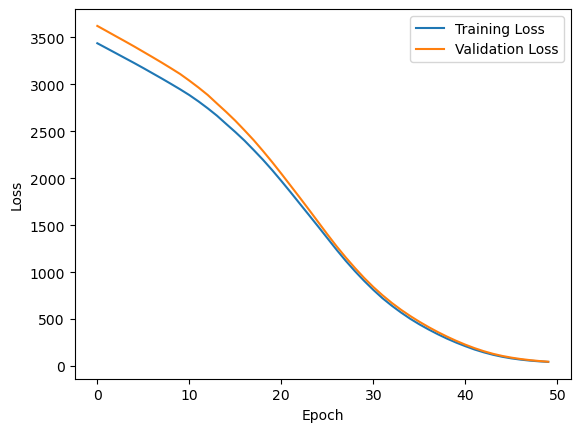

1/1 [==============================] - 0s 299ms/step


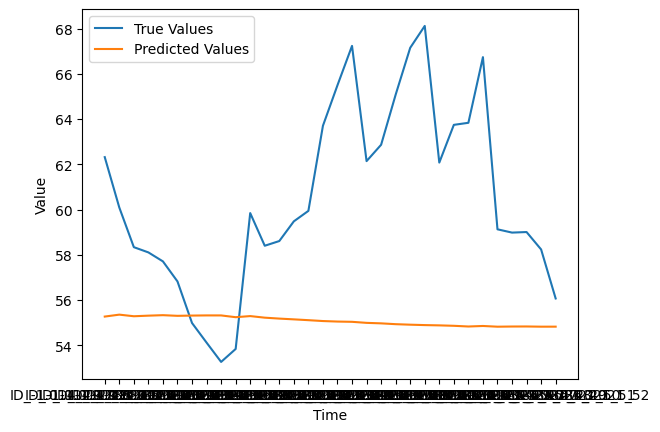

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -2.82_28.38
Epoch 1/50
3/3 [==============================] - 2s 197ms/step - loss: 457.6990 - mse: 457.6990 - accuracy: 0.0000e+00 - val_loss: 490.4555 - val_mse: 490.4555 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 436.1595 - mse: 436.1595 - accuracy: 0.0000e+00 - val_loss: 468.4594 - val_mse: 468.4594 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 415.7914 - mse: 415.7914 - accuracy: 0.0000e+00 - val_loss: 447.8442 - val_mse: 447.8442 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 397.3054 - mse: 397.3054 - accuracy: 0.0000e+00 - val_loss: 430.9048 - val_mse: 430.9048 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 381.9016 - mse: 381.9016 - accuracy: 0.0000e+00 - val_loss: 416.4523 - val_mse: 416.4523 - val_ac

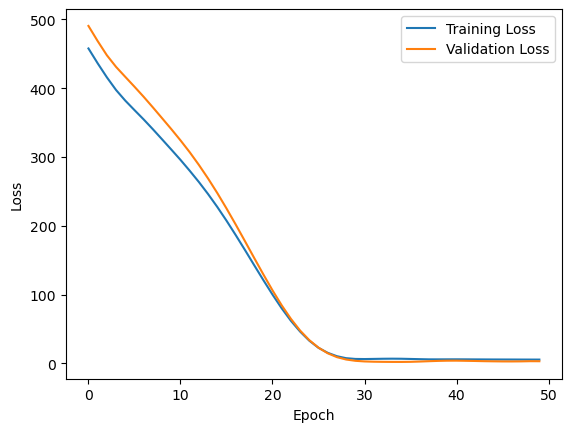

1/1 [==============================] - 0s 294ms/step


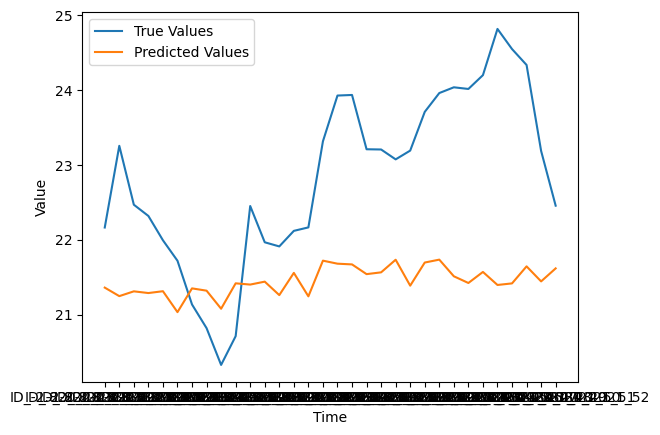

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -3.287_29.713
Epoch 1/50
3/3 [==============================] - 2s 198ms/step - loss: 1776.9406 - mse: 1776.9406 - accuracy: 0.0000e+00 - val_loss: 1828.6841 - val_mse: 1828.6841 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 1745.7859 - mse: 1745.7859 - accuracy: 0.0000e+00 - val_loss: 1797.9916 - val_mse: 1797.9916 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 1715.6954 - mse: 1715.6954 - accuracy: 0.0000e+00 - val_loss: 1767.9937 - val_mse: 1767.9937 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 1686.7017 - mse: 1686.7017 - accuracy: 0.0000e+00 - val_loss: 1738.0844 - val_mse: 1738.0844 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 1656.7367 - mse: 1656.7367 - accuracy: 0.0000e+00 - val_loss: 1705.5354 - val_m

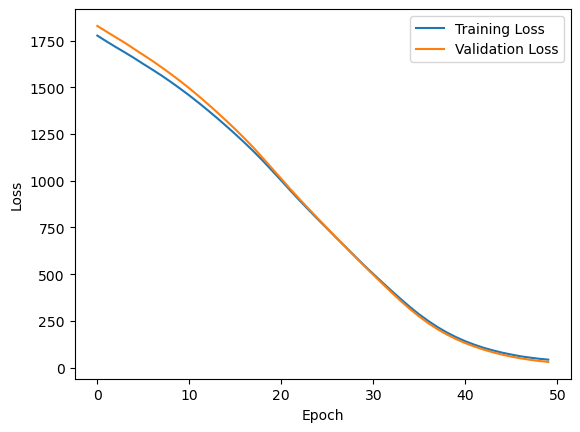

1/1 [==============================] - 0s 303ms/step


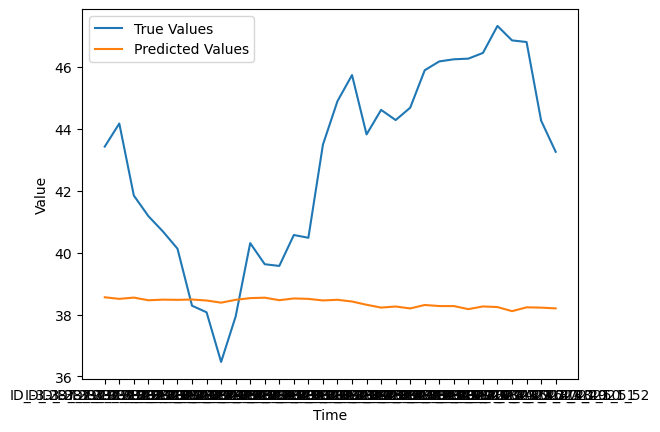

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.729_30.471
Epoch 1/50
3/3 [==============================] - 2s 376ms/step - loss: 32445.9238 - mse: 32445.9238 - accuracy: 0.0000e+00 - val_loss: 31584.6191 - val_mse: 31584.6191 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 32313.8789 - mse: 32313.8789 - accuracy: 0.0000e+00 - val_loss: 31446.8105 - val_mse: 31446.8105 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 34ms/step - loss: 32171.3027 - mse: 32171.3027 - accuracy: 0.0000e+00 - val_loss: 31296.5332 - val_mse: 31296.5332 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 31ms/step - loss: 32022.7246 - mse: 32022.7246 - accuracy: 0.0000e+00 - val_loss: 31138.4766 - val_mse: 31138.4766 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 31862.0391 - mse: 31862.0391 - accuracy: 0.0000e+00 - val_loss:

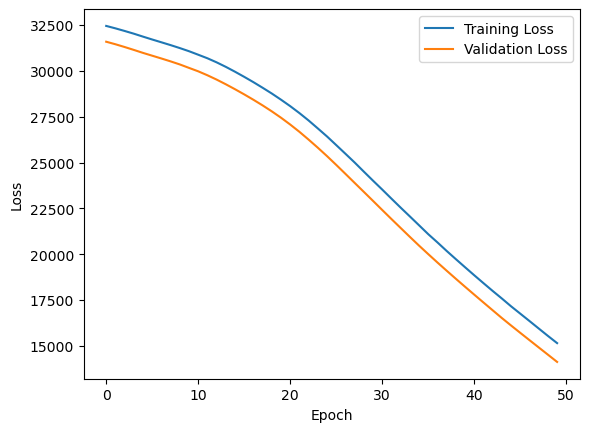

1/1 [==============================] - 0s 342ms/step


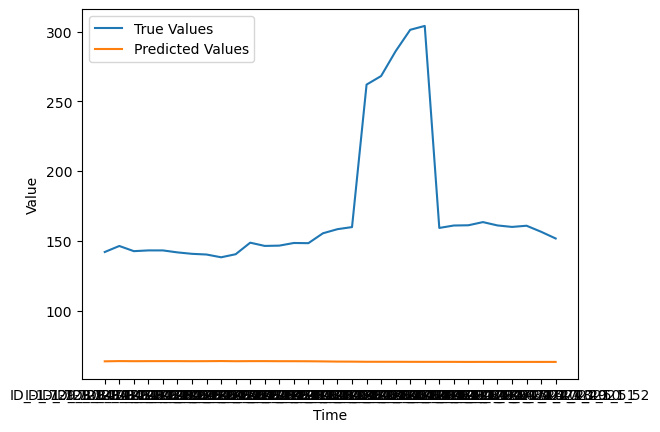

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.979_30.021
Epoch 1/50
3/3 [==============================] - 2s 228ms/step - loss: 2273.6799 - mse: 2273.6799 - accuracy: 0.0000e+00 - val_loss: 2430.4612 - val_mse: 2430.4612 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 26ms/step - loss: 2240.2952 - mse: 2240.2949 - accuracy: 0.0000e+00 - val_loss: 2399.3550 - val_mse: 2399.3550 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 2211.5242 - mse: 2211.5242 - accuracy: 0.0000e+00 - val_loss: 2372.8989 - val_mse: 2372.8989 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 2186.4524 - mse: 2186.4524 - accuracy: 0.0000e+00 - val_loss: 2347.2095 - val_mse: 2347.2095 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 2161.0354 - mse: 2161.0349 - accuracy: 0.0000e+00 - val_loss: 2320.0347 - val_m

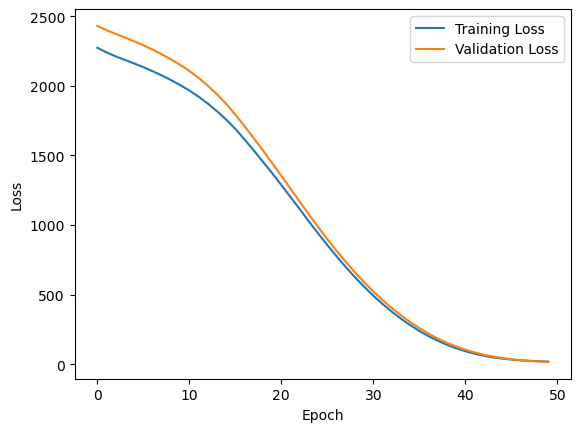

1/1 [==============================] - 0s 292ms/step


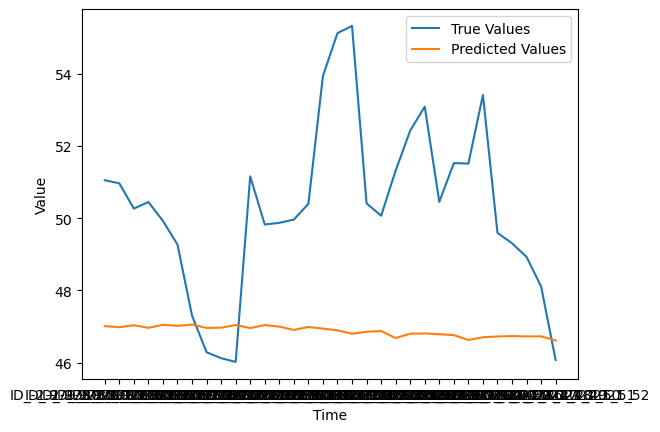

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.932_31.068
Epoch 1/50
3/3 [==============================] - 2s 241ms/step - loss: 11.8630 - mse: 11.8630 - accuracy: 0.0000e+00 - val_loss: 10.4609 - val_mse: 10.4609 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 8.7774 - mse: 8.7774 - accuracy: 0.0000e+00 - val_loss: 7.9098 - val_mse: 7.9098 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 6.5222 - mse: 6.5222 - accuracy: 0.0000e+00 - val_loss: 5.9575 - val_mse: 5.9575 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 37ms/step - loss: 4.8520 - mse: 4.8520 - accuracy: 0.0000e+00 - val_loss: 4.4666 - val_mse: 4.4666 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 3.5702 - mse: 3.5702 - accuracy: 0.0000e+00 - val_loss: 3.2225 - val_mse: 3.2225 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 

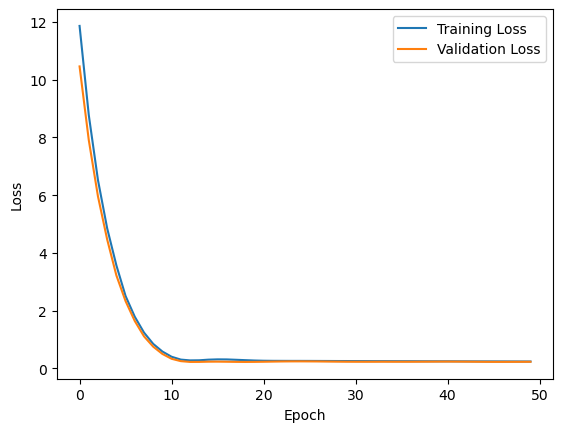

1/1 [==============================] - 0s 300ms/step


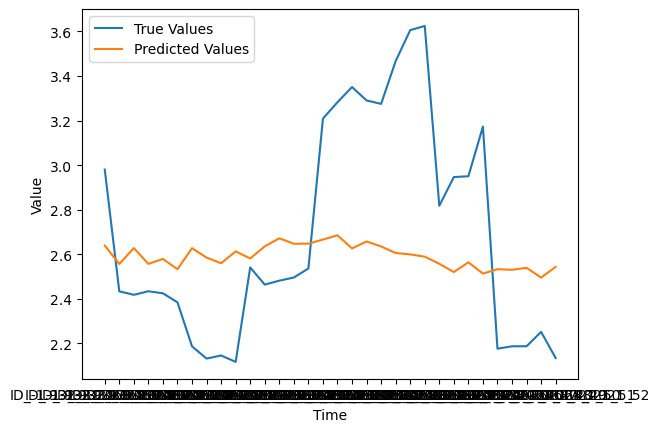

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.366_29.434
Epoch 1/50
3/3 [==============================] - 3s 199ms/step - loss: 1485.9803 - mse: 1485.9803 - accuracy: 0.0000e+00 - val_loss: 1500.5933 - val_mse: 1500.5933 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 30ms/step - loss: 1446.5179 - mse: 1446.5179 - accuracy: 0.0000e+00 - val_loss: 1462.4175 - val_mse: 1462.4175 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 1411.5923 - mse: 1411.5923 - accuracy: 0.0000e+00 - val_loss: 1431.7974 - val_mse: 1431.7974 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 1384.8490 - mse: 1384.8490 - accuracy: 0.0000e+00 - val_loss: 1407.5580 - val_mse: 1407.5580 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 1361.6486 - mse: 1361.6486 - accuracy: 0.0000e+00 - val_loss: 1383.9089 - val_m

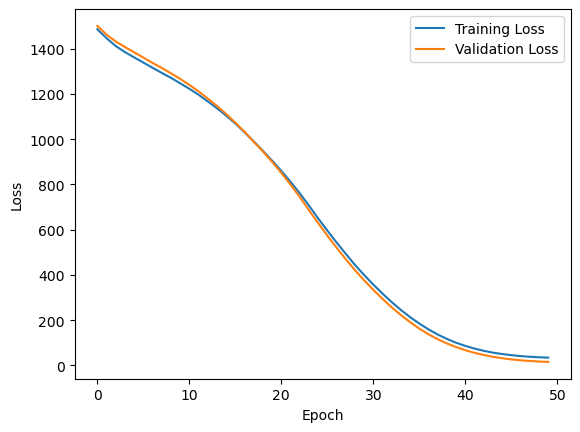

1/1 [==============================] - 0s 358ms/step


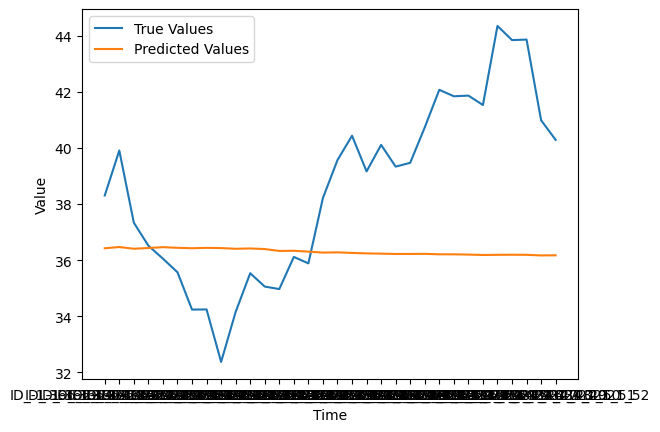

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.528_29.972
Epoch 1/50
3/3 [==============================] - 2s 198ms/step - loss: 15119.3799 - mse: 15119.3799 - accuracy: 0.0000e+00 - val_loss: 15616.1562 - val_mse: 15616.1562 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 31ms/step - loss: 15052.7334 - mse: 15052.7334 - accuracy: 0.0000e+00 - val_loss: 15554.5498 - val_mse: 15554.5498 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 32ms/step - loss: 14993.8486 - mse: 14993.8486 - accuracy: 0.0000e+00 - val_loss: 15495.7832 - val_mse: 15495.7832 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 14937.6436 - mse: 14937.6436 - accuracy: 0.0000e+00 - val_loss: 15440.0791 - val_mse: 15440.0791 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 14881.9092 - mse: 14881.9092 - accuracy: 0.0000e+00 - val_loss:

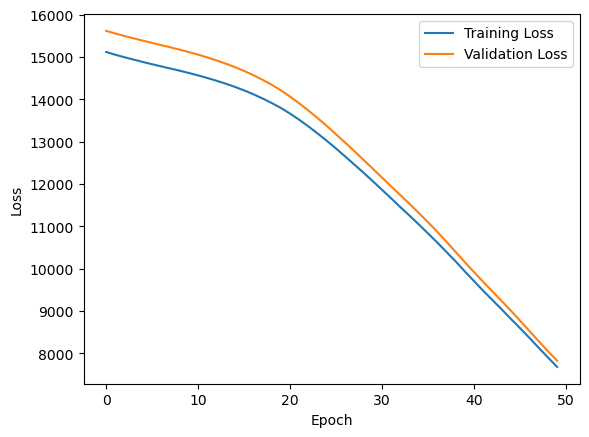

1/1 [==============================] - 0s 311ms/step


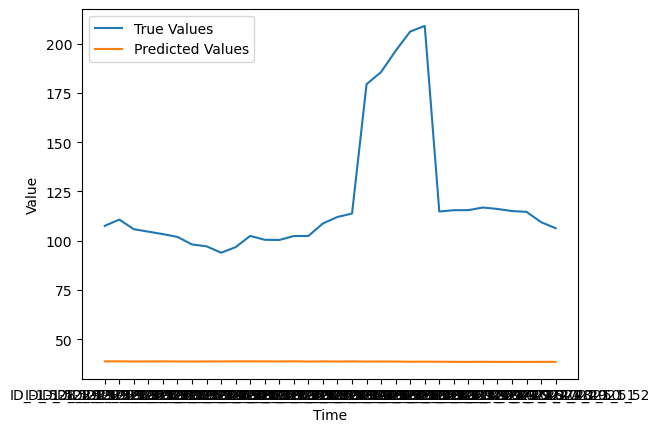

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.959_30.641
Epoch 1/50
3/3 [==============================] - 2s 218ms/step - loss: 10.6969 - mse: 10.6969 - accuracy: 0.0000e+00 - val_loss: 8.7880 - val_mse: 8.7880 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 8.9428 - mse: 8.9428 - accuracy: 0.0000e+00 - val_loss: 7.1405 - val_mse: 7.1405 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 7.2803 - mse: 7.2803 - accuracy: 0.0000e+00 - val_loss: 5.7413 - val_mse: 5.7413 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 26ms/step - loss: 5.9881 - mse: 5.9881 - accuracy: 0.0000e+00 - val_loss: 4.6969 - val_mse: 4.6969 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 5.0011 - mse: 5.0011 - accuracy: 0.0000e+00 - val_loss: 3.8512 - val_mse: 3.8512 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [=

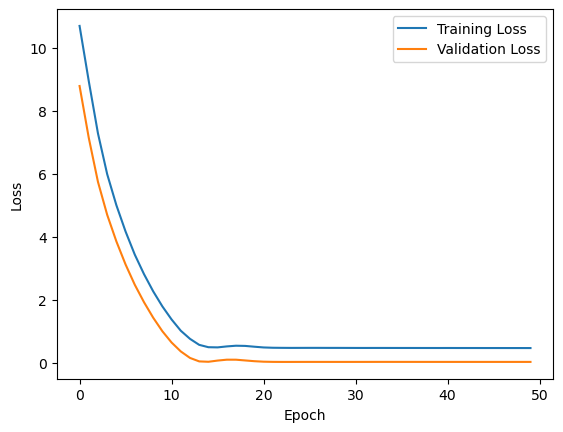

1/1 [==============================] - 0s 289ms/step


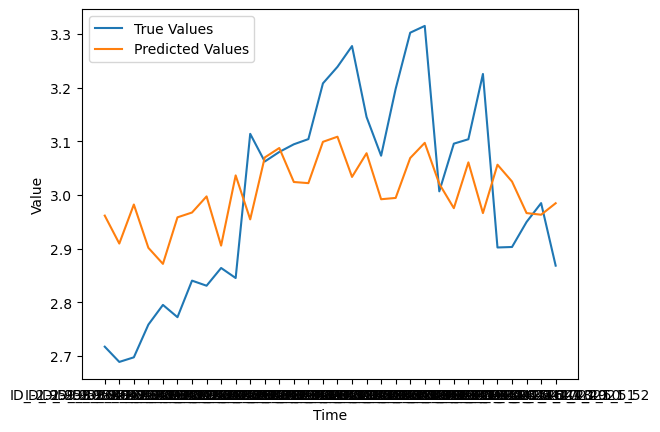

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -0.869_29.231
Epoch 1/50
3/3 [==============================] - 2s 199ms/step - loss: 1.1462 - mse: 1.1462 - accuracy: 0.0000e+00 - val_loss: 0.5498 - val_mse: 0.5498 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 31ms/step - loss: 0.5347 - mse: 0.5347 - accuracy: 0.0000e+00 - val_loss: 0.2020 - val_mse: 0.2020 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 0.2371 - mse: 0.2371 - accuracy: 0.0000e+00 - val_loss: 0.0414 - val_mse: 0.0414 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 0.1237 - mse: 0.1237 - accuracy: 0.0000e+00 - val_loss: 0.0309 - val_mse: 0.0309 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 0.1361 - mse: 0.1361 - accuracy: 0.0000e+00 - val_loss: 0.0715 - val_mse: 0.0715 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

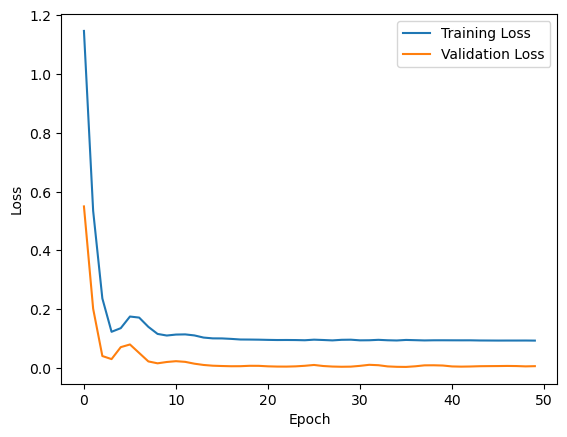

1/1 [==============================] - 0s 307ms/step


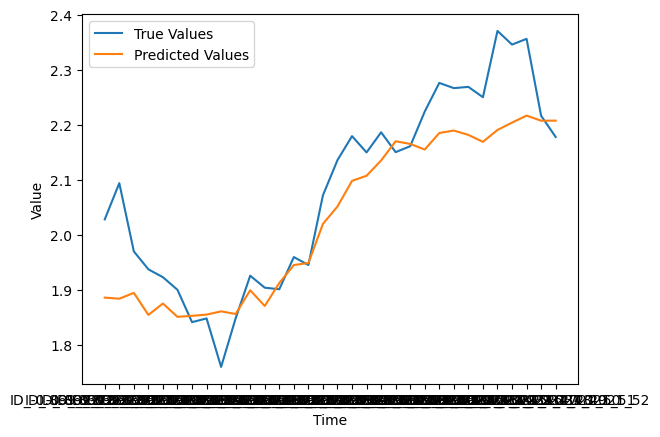

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.167_30.633
Epoch 1/50
3/3 [==============================] - 2s 220ms/step - loss: 13.9395 - mse: 13.9395 - accuracy: 0.0000e+00 - val_loss: 11.6076 - val_mse: 11.6076 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 12.8990 - mse: 12.8990 - accuracy: 0.0000e+00 - val_loss: 10.6624 - val_mse: 10.6624 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 12.0249 - mse: 12.0249 - accuracy: 0.0000e+00 - val_loss: 9.9280 - val_mse: 9.9280 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 11.2886 - mse: 11.2886 - accuracy: 0.0000e+00 - val_loss: 9.2463 - val_mse: 9.2463 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 10.6484 - mse: 10.6484 - accuracy: 0.0000e+00 - val_loss: 8.6026 - val_mse: 8.6026 - val_accuracy: 0.0000e+00
Epoch

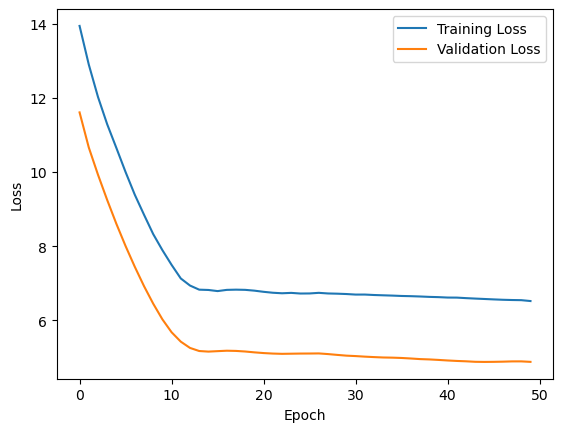

1/1 [==============================] - 0s 298ms/step


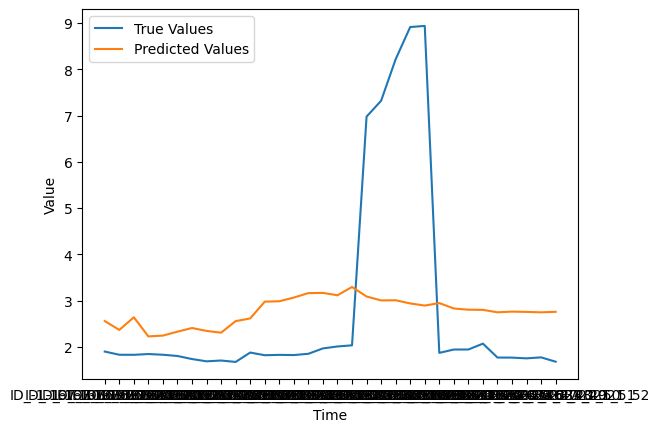

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.052_30.948
Epoch 1/50
3/3 [==============================] - 2s 196ms/step - loss: 45535.5039 - mse: 45535.5039 - accuracy: 0.0000e+00 - val_loss: 47586.2539 - val_mse: 47586.2539 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 45400.0742 - mse: 45400.0742 - accuracy: 0.0000e+00 - val_loss: 47445.5898 - val_mse: 47445.5898 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 26ms/step - loss: 45263.5664 - mse: 45263.5664 - accuracy: 0.0000e+00 - val_loss: 47299.0508 - val_mse: 47299.0508 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 45120.2930 - mse: 45120.2930 - accuracy: 0.0000e+00 - val_loss: 47139.5156 - val_mse: 47139.5156 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 44959.2695 - mse: 44959.2695 - accuracy: 0.0000e+00 - val_loss:

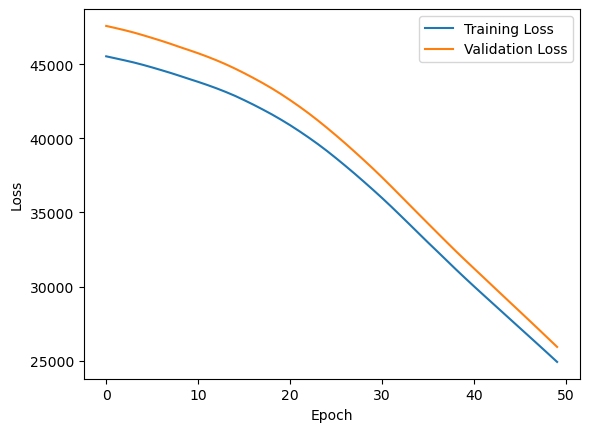

1/1 [==============================] - 0s 301ms/step


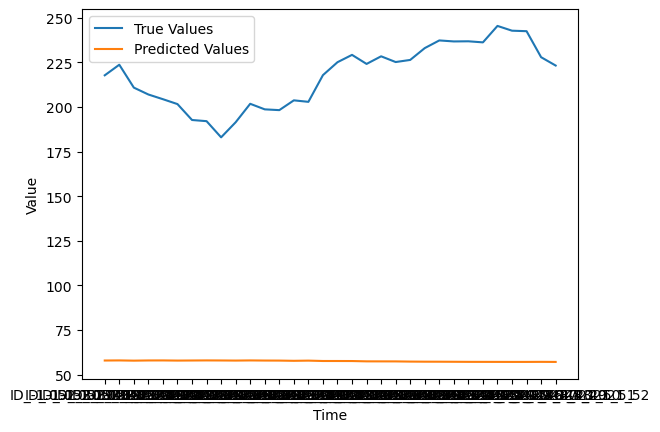

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -2.376_29.924
Epoch 1/50
3/3 [==============================] - 2s 202ms/step - loss: 102623.1016 - mse: 102623.1016 - accuracy: 0.0000e+00 - val_loss: 96940.0312 - val_mse: 96940.0312 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 102427.3672 - mse: 102427.3672 - accuracy: 0.0000e+00 - val_loss: 96752.5938 - val_mse: 96752.5938 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 102238.2109 - mse: 102238.2109 - accuracy: 0.0000e+00 - val_loss: 96561.0547 - val_mse: 96561.0547 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 102043.6406 - mse: 102043.6406 - accuracy: 0.0000e+00 - val_loss: 96370.8047 - val_mse: 96370.8047 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 101856.0703 - mse: 101856.0703 - accuracy: 0.0000e+00 -

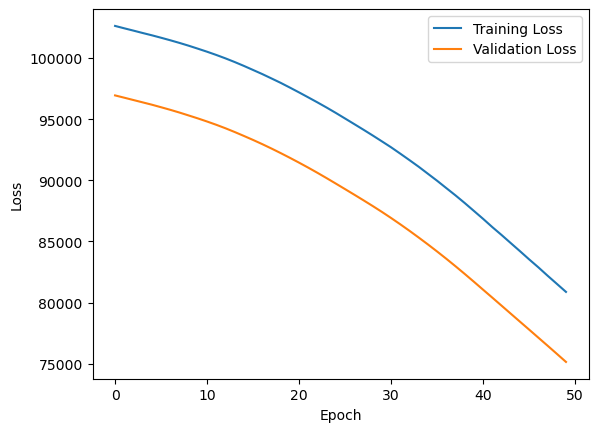

1/1 [==============================] - 0s 295ms/step


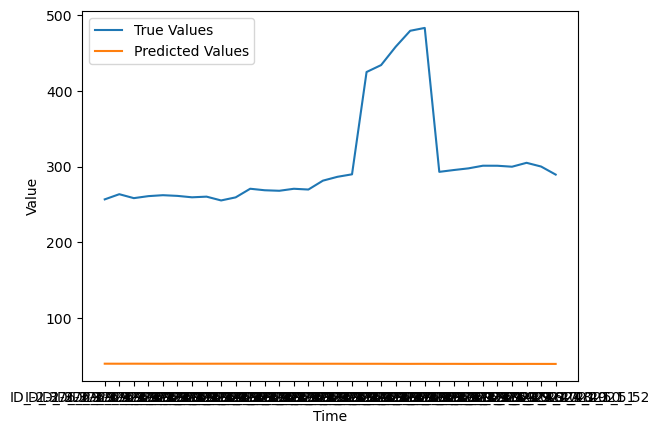

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -2.341_29.059
Epoch 1/50
3/3 [==============================] - 2s 221ms/step - loss: 19250.8223 - mse: 19250.8223 - accuracy: 0.0000e+00 - val_loss: 19707.5859 - val_mse: 19707.5859 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 19170.9434 - mse: 19170.9434 - accuracy: 0.0000e+00 - val_loss: 19632.2773 - val_mse: 19632.2773 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 19102.0117 - mse: 19102.0117 - accuracy: 0.0000e+00 - val_loss: 19572.2402 - val_mse: 19572.2402 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 26ms/step - loss: 19048.9355 - mse: 19048.9355 - accuracy: 0.0000e+00 - val_loss: 19521.5215 - val_mse: 19521.5215 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 19000.1836 - mse: 19000.1836 - accuracy: 0.0000e+00 - val_loss:

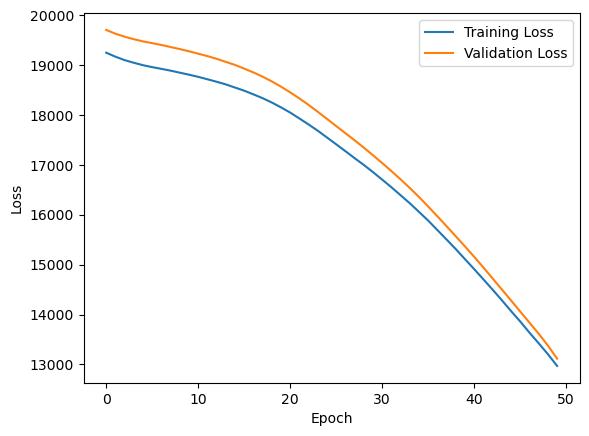

1/1 [==============================] - 0s 312ms/step


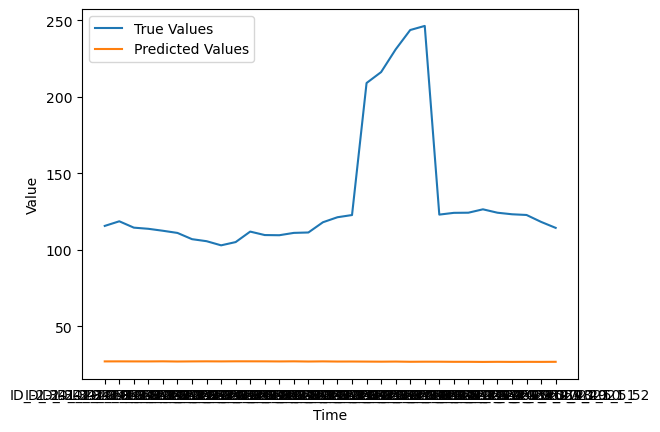

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.166_31.234
Epoch 1/50
3/3 [==============================] - 2s 201ms/step - loss: 23.9437 - mse: 23.9437 - accuracy: 0.0000e+00 - val_loss: 15.6875 - val_mse: 15.6875 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 21.9712 - mse: 21.9712 - accuracy: 0.0000e+00 - val_loss: 14.3251 - val_mse: 14.3251 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 29ms/step - loss: 20.4843 - mse: 20.4843 - accuracy: 0.0000e+00 - val_loss: 13.1529 - val_mse: 13.1529 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 19.4120 - mse: 19.4120 - accuracy: 0.0000e+00 - val_loss: 12.4949 - val_mse: 12.4949 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 18.6916 - mse: 18.6916 - accuracy: 0.0000e+00 - val_loss: 11.7434 - val_mse: 11.7434 - val_accuracy: 0.0000e+00

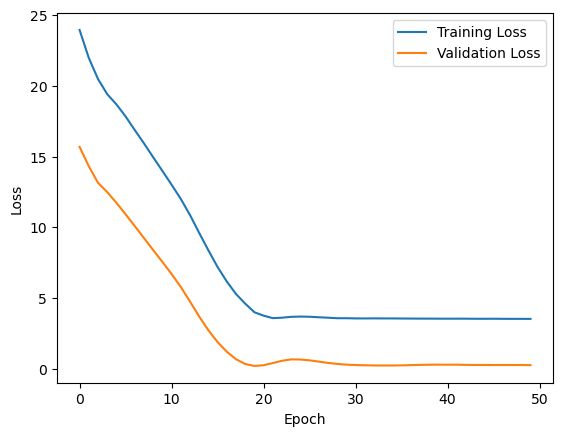

1/1 [==============================] - 0s 300ms/step


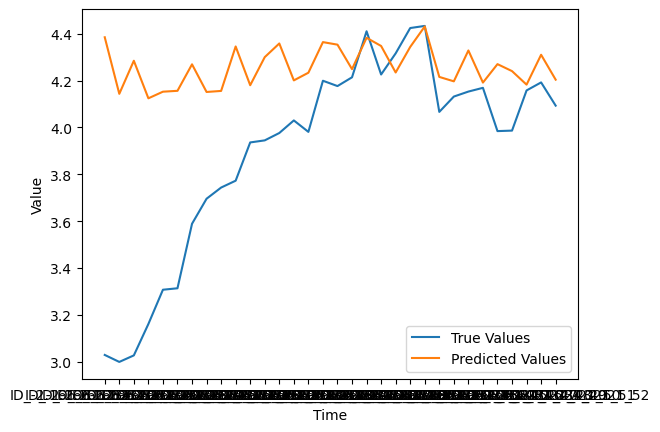

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -3.161_28.839
Epoch 1/50
3/3 [==============================] - 2s 190ms/step - loss: 0.0130 - mse: 0.0130 - accuracy: 0.0000e+00 - val_loss: 0.0156 - val_mse: 0.0156 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 0.0119 - mse: 0.0119 - accuracy: 0.0000e+00 - val_loss: 0.0068 - val_mse: 0.0068 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 0.0028 - mse: 0.0028 - accuracy: 0.0000e+00 - val_loss: 0.0026 - val_mse: 0.0026 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 0.0054 - mse: 0.0054 - accuracy: 0.0000e+00 - val_loss: 0.0019 - val_mse: 0.0019 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 0.0024 - mse: 0.0024 - accuracy: 0.0000e+00 - val_loss: 0.0018 - val_mse: 0.0018 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

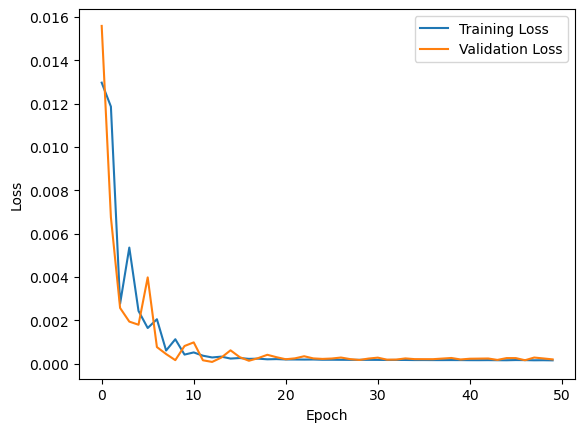

1/1 [==============================] - 0s 316ms/step


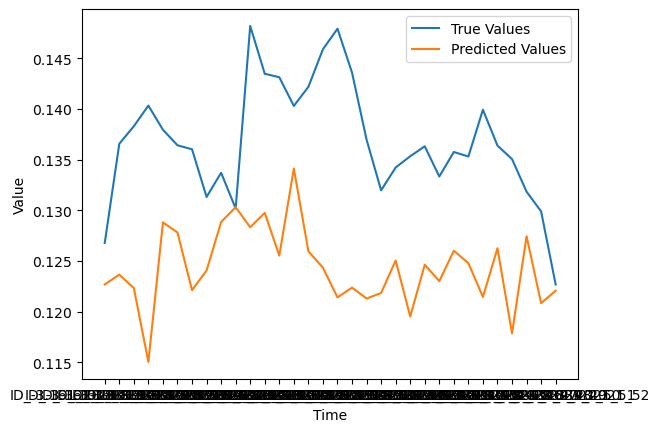

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.846_29.554
Epoch 1/50
3/3 [==============================] - 2s 194ms/step - loss: 25243.5312 - mse: 25243.5312 - accuracy: 0.0000e+00 - val_loss: 25673.7812 - val_mse: 25673.7812 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 25172.3242 - mse: 25172.3242 - accuracy: 0.0000e+00 - val_loss: 25603.5898 - val_mse: 25603.5898 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 25103.6758 - mse: 25103.6758 - accuracy: 0.0000e+00 - val_loss: 25538.6465 - val_mse: 25538.6465 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 25039.5547 - mse: 25039.5547 - accuracy: 0.0000e+00 - val_loss: 25473.5840 - val_mse: 25473.5840 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 24976.9805 - mse: 24976.9805 - accuracy: 0.0000e+00 - val_loss:

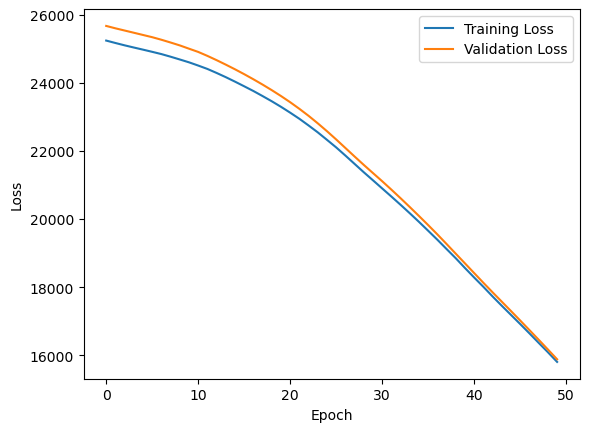

1/1 [==============================] - 0s 326ms/step


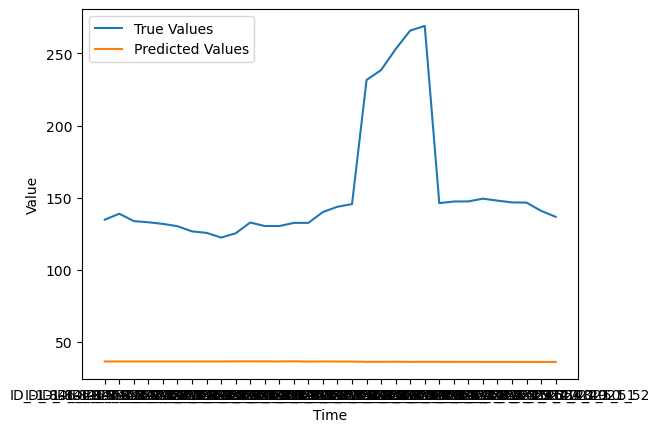

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.383_29.917
Epoch 1/50
3/3 [==============================] - 2s 220ms/step - loss: 33278.8828 - mse: 33278.8828 - accuracy: 0.0000e+00 - val_loss: 34058.1719 - val_mse: 34058.1719 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 33194.1094 - mse: 33194.1094 - accuracy: 0.0000e+00 - val_loss: 33974.1758 - val_mse: 33974.1758 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 33118.0703 - mse: 33118.0703 - accuracy: 0.0000e+00 - val_loss: 33905.8945 - val_mse: 33905.8945 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 33053.3867 - mse: 33053.3867 - accuracy: 0.0000e+00 - val_loss: 33844.4844 - val_mse: 33844.4844 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 32997.0078 - mse: 32997.0078 - accuracy: 0.0000e+00 - val_loss:

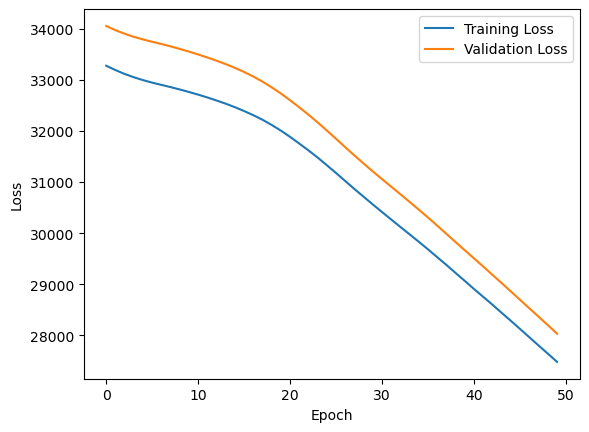

1/1 [==============================] - 0s 299ms/step


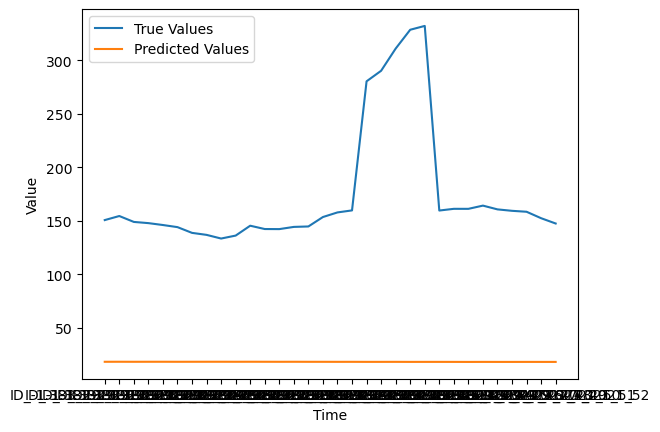

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.065_31.035
Epoch 1/50
3/3 [==============================] - 2s 256ms/step - loss: 65711.5547 - mse: 65711.5547 - accuracy: 0.0000e+00 - val_loss: 66963.8438 - val_mse: 66963.8438 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 37ms/step - loss: 65465.0469 - mse: 65465.0469 - accuracy: 0.0000e+00 - val_loss: 66725.4922 - val_mse: 66725.4922 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 34ms/step - loss: 65231.4766 - mse: 65231.4727 - accuracy: 0.0000e+00 - val_loss: 66489.7031 - val_mse: 66489.7031 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 31ms/step - loss: 65008.3516 - mse: 65008.3516 - accuracy: 0.0000e+00 - val_loss: 66266.0000 - val_mse: 66266.0000 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 64791.7734 - mse: 64791.7734 - accuracy: 0.0000e+00 - val_loss:

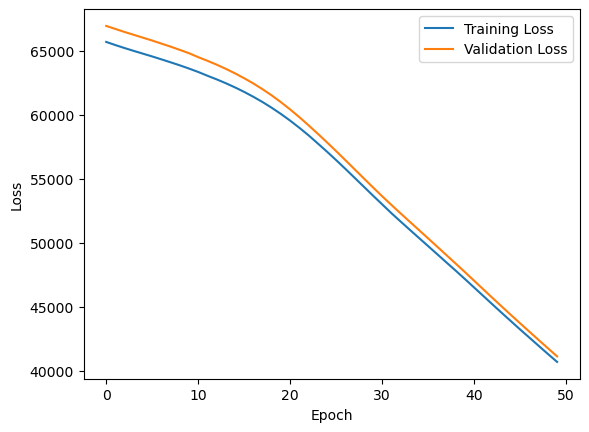

1/1 [==============================] - 0s 328ms/step


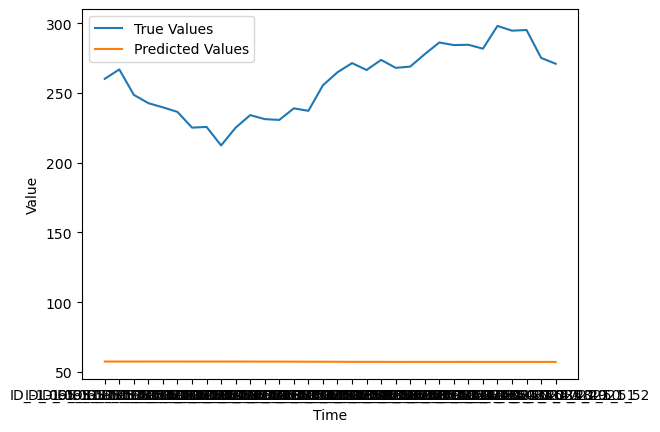

(49, 67)
2/2 [==============================] - 0s 9ms/step
LAT_LONG:  -2.3_29.2
Epoch 1/50
3/3 [==============================] - 2s 198ms/step - loss: 96708.8125 - mse: 96708.8125 - accuracy: 0.0000e+00 - val_loss: 100004.5312 - val_mse: 100004.5312 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 30ms/step - loss: 96486.0859 - mse: 96486.0859 - accuracy: 0.0000e+00 - val_loss: 99780.2969 - val_mse: 99780.2969 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 96262.4766 - mse: 96262.4766 - accuracy: 0.0000e+00 - val_loss: 99554.0156 - val_mse: 99554.0156 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 96035.7656 - mse: 96035.7656 - accuracy: 0.0000e+00 - val_loss: 99316.3594 - val_mse: 99316.3594 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 95802.5859 - mse: 95802.5859 - accuracy: 0.0000e+00 - val_loss: 9

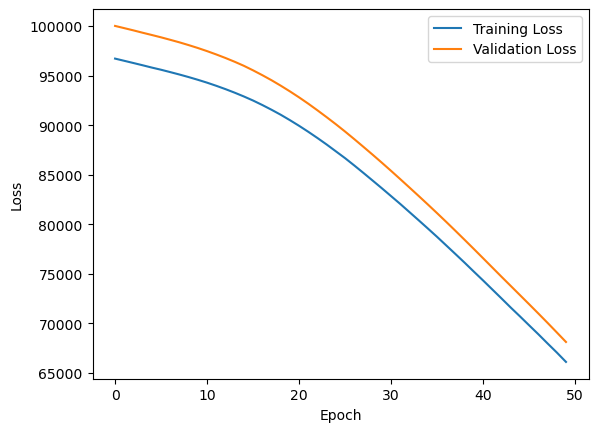

1/1 [==============================] - 0s 381ms/step


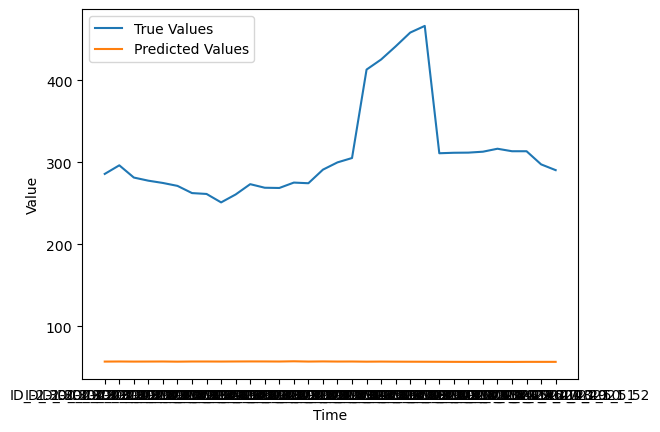

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.972_28.228
Epoch 1/50
3/3 [==============================] - 2s 210ms/step - loss: 9.3929 - mse: 9.3929 - accuracy: 0.0000e+00 - val_loss: 7.8640 - val_mse: 7.8640 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 7.9761 - mse: 7.9761 - accuracy: 0.0000e+00 - val_loss: 6.6294 - val_mse: 6.6294 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 6.7389 - mse: 6.7389 - accuracy: 0.0000e+00 - val_loss: 5.5702 - val_mse: 5.5702 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 36ms/step - loss: 5.7995 - mse: 5.7995 - accuracy: 0.0000e+00 - val_loss: 4.7920 - val_mse: 4.7920 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 5.0625 - mse: 5.0625 - accuracy: 0.0000e+00 - val_loss: 4.0873 - val_mse: 4.0873 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

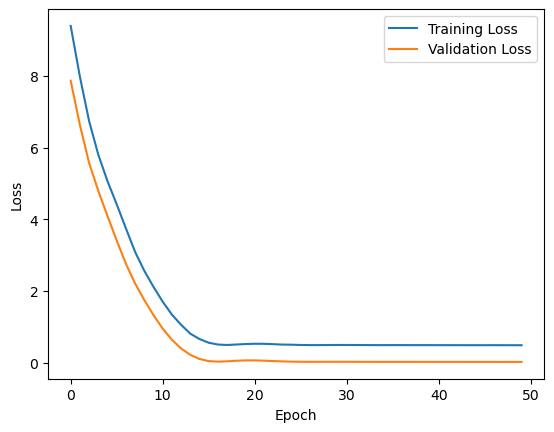

1/1 [==============================] - 0s 302ms/step


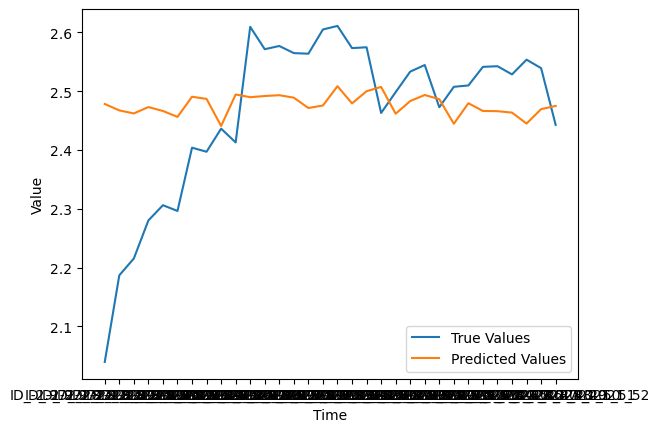

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.024_28.976
Epoch 1/50
3/3 [==============================] - 2s 380ms/step - loss: 1109.5917 - mse: 1109.5916 - accuracy: 0.0000e+00 - val_loss: 1124.7893 - val_mse: 1124.7893 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 1091.4720 - mse: 1091.4720 - accuracy: 0.0000e+00 - val_loss: 1107.1801 - val_mse: 1107.1801 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 29ms/step - loss: 1073.2380 - mse: 1073.2380 - accuracy: 0.0000e+00 - val_loss: 1088.2124 - val_mse: 1088.2124 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 1052.7018 - mse: 1052.7018 - accuracy: 0.0000e+00 - val_loss: 1063.5105 - val_mse: 1063.5105 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 1027.8730 - mse: 1027.8732 - accuracy: 0.0000e+00 - val_loss: 1039.1670 - val_m

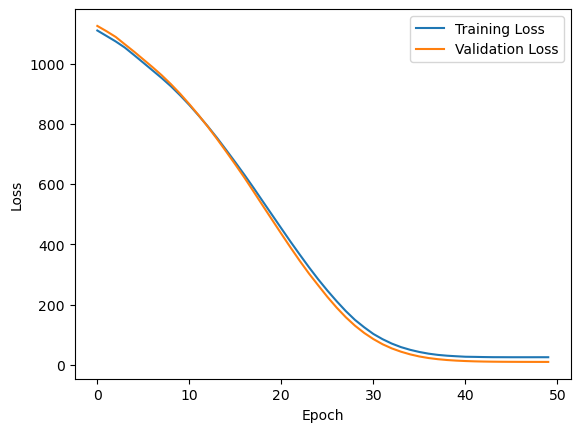

1/1 [==============================] - 0s 300ms/step


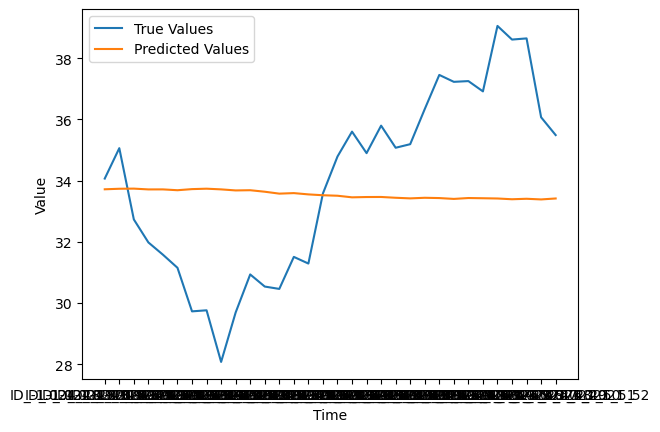

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.378_29.222
Epoch 1/50
3/3 [==============================] - 2s 201ms/step - loss: 4837130.5000 - mse: 4837130.5000 - accuracy: 0.0000e+00 - val_loss: 5726039.0000 - val_mse: 5726039.0000 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 4835670.5000 - mse: 4835671.0000 - accuracy: 0.0000e+00 - val_loss: 5724610.5000 - val_mse: 5724610.5000 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 4834360.5000 - mse: 4834361.0000 - accuracy: 0.0000e+00 - val_loss: 5723210.0000 - val_mse: 5723210.0000 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 26ms/step - loss: 4833033.5000 - mse: 4833034.0000 - accuracy: 0.0000e+00 - val_loss: 5721720.5000 - val_mse: 5721720.5000 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 4831643.5000 - mse: 4831643.500

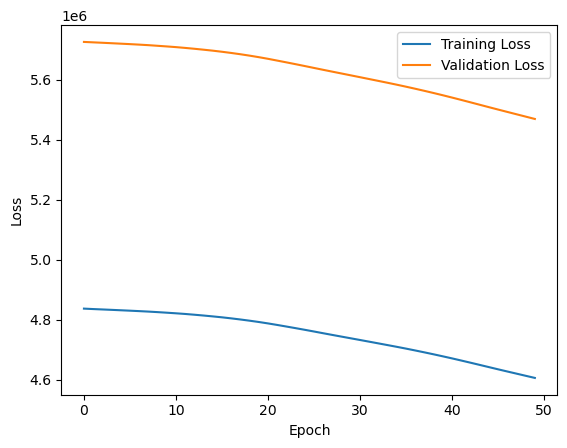

1/1 [==============================] - 0s 337ms/step


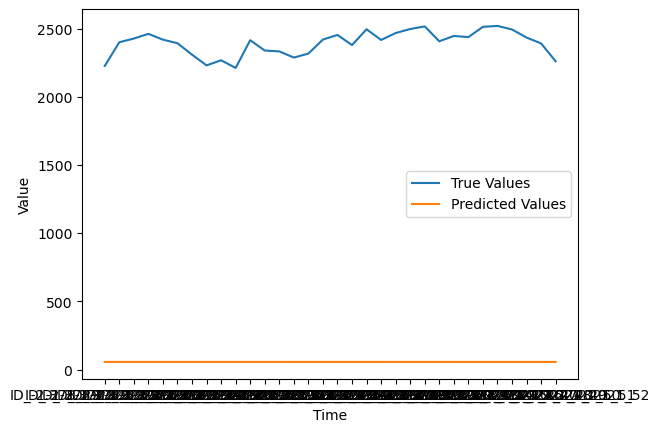

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -0.659_30.341
Epoch 1/50
3/3 [==============================] - 3s 234ms/step - loss: 533.9488 - mse: 533.9488 - accuracy: 0.0000e+00 - val_loss: 566.7938 - val_mse: 566.7938 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 36ms/step - loss: 514.5057 - mse: 514.5057 - accuracy: 0.0000e+00 - val_loss: 547.1673 - val_mse: 547.1673 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 38ms/step - loss: 495.9011 - mse: 495.9011 - accuracy: 0.0000e+00 - val_loss: 528.6040 - val_mse: 528.6040 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 478.2493 - mse: 478.2493 - accuracy: 0.0000e+00 - val_loss: 510.4514 - val_mse: 510.4514 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 461.1916 - mse: 461.1916 - accuracy: 0.0000e+00 - val_loss: 493.2921 - val_mse: 493.2921 - val_

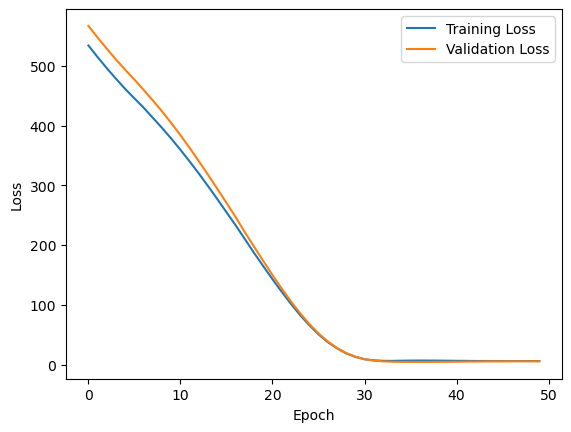

1/1 [==============================] - 0s 317ms/step


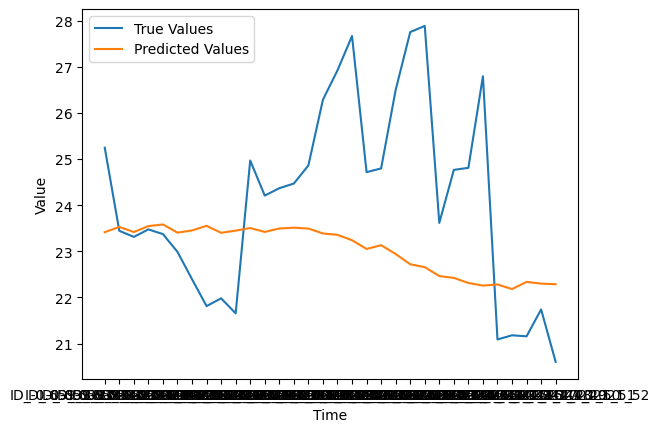

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -2.404_30.496
Epoch 1/50
3/3 [==============================] - 3s 191ms/step - loss: 6000.6143 - mse: 6000.6143 - accuracy: 0.0000e+00 - val_loss: 5677.5273 - val_mse: 5677.5273 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 5958.1548 - mse: 5958.1548 - accuracy: 0.0000e+00 - val_loss: 5639.3833 - val_mse: 5639.3833 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 5922.4609 - mse: 5922.4609 - accuracy: 0.0000e+00 - val_loss: 5603.4604 - val_mse: 5603.4604 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 5887.9585 - mse: 5887.9585 - accuracy: 0.0000e+00 - val_loss: 5569.9170 - val_mse: 5569.9170 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 5857.7725 - mse: 5857.7725 - accuracy: 0.0000e+00 - val_loss: 5540.3926 - val_m

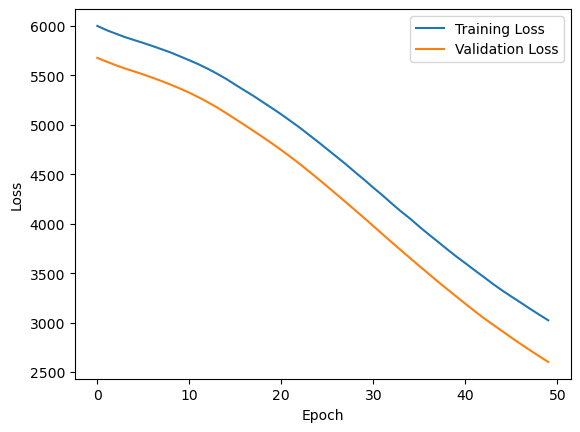

1/1 [==============================] - 0s 333ms/step


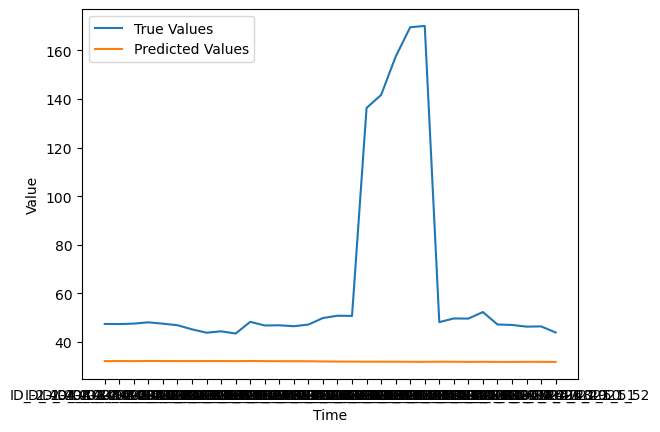

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.623_28.977
Epoch 1/50
3/3 [==============================] - 2s 209ms/step - loss: 0.1356 - mse: 0.1356 - accuracy: 0.0000e+00 - val_loss: 0.0299 - val_mse: 0.0299 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 31ms/step - loss: 0.0131 - mse: 0.0131 - accuracy: 0.0000e+00 - val_loss: 0.0171 - val_mse: 0.0171 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 32ms/step - loss: 0.0425 - mse: 0.0425 - accuracy: 0.0000e+00 - val_loss: 0.0268 - val_mse: 0.0268 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 31ms/step - loss: 0.0410 - mse: 0.0410 - accuracy: 0.0000e+00 - val_loss: 0.0081 - val_mse: 0.0081 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 0.0145 - mse: 0.0145 - accuracy: 0.0000e+00 - val_loss: 0.0118 - val_mse: 0.0118 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

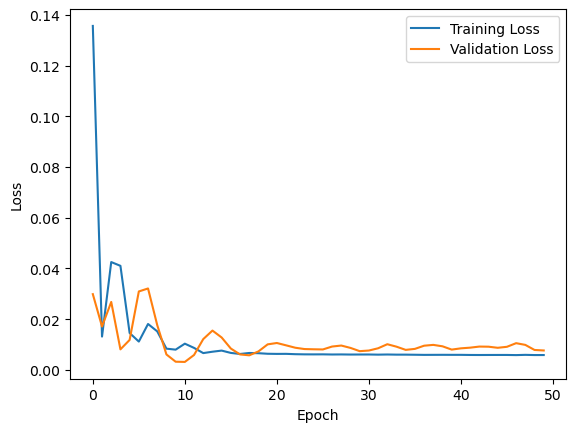

1/1 [==============================] - 0s 313ms/step


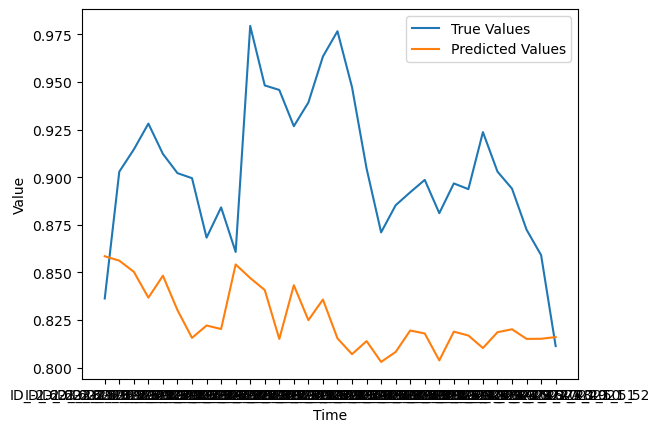

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.761_28.439
Epoch 1/50
3/3 [==============================] - 2s 204ms/step - loss: 10.8522 - mse: 10.8522 - accuracy: 0.0000e+00 - val_loss: 9.0757 - val_mse: 9.0757 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 8.6127 - mse: 8.6127 - accuracy: 0.0000e+00 - val_loss: 7.5826 - val_mse: 7.5826 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 7.3713 - mse: 7.3713 - accuracy: 0.0000e+00 - val_loss: 6.5202 - val_mse: 6.5202 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 6.4240 - mse: 6.4240 - accuracy: 0.0000e+00 - val_loss: 5.6769 - val_mse: 5.6769 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 5.6396 - mse: 5.6396 - accuracy: 0.0000e+00 - val_loss: 4.8698 - val_mse: 4.8698 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [=

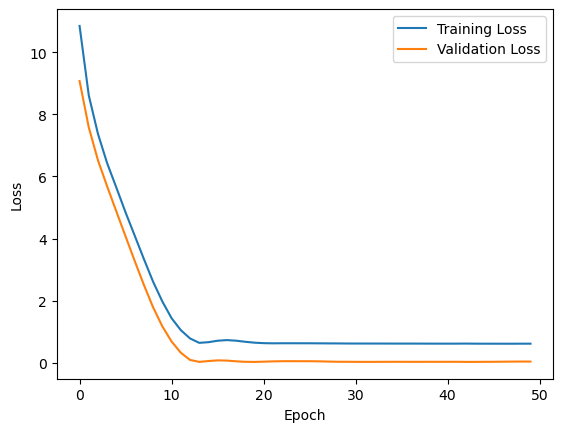

1/1 [==============================] - 0s 315ms/step


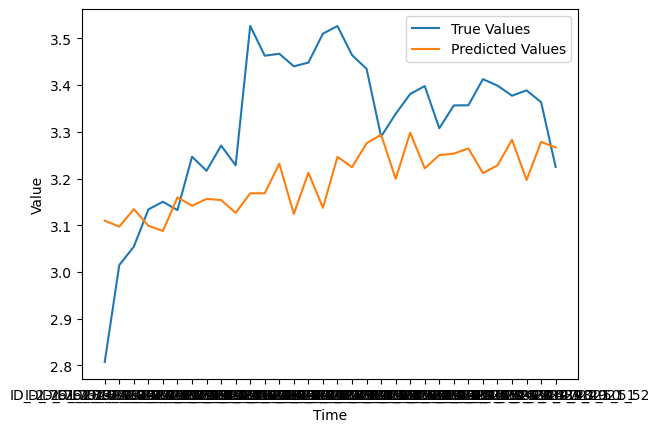

(49, 67)
2/2 [==============================] - 1s 7ms/step
LAT_LONG:  -1.974_28.526
Epoch 1/50
3/3 [==============================] - 2s 207ms/step - loss: 0.3123 - mse: 0.3123 - accuracy: 0.2835 - val_loss: 0.0851 - val_mse: 0.0851 - val_accuracy: 1.0000
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 0.0481 - mse: 0.0481 - accuracy: 1.0000 - val_loss: 0.0017 - val_mse: 0.0017 - val_accuracy: 1.0000
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 0.0129 - mse: 0.0129 - accuracy: 1.0000 - val_loss: 0.0436 - val_mse: 0.0436 - val_accuracy: 1.0000
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 0.0513 - mse: 0.0513 - accuracy: 1.0000 - val_loss: 0.0402 - val_mse: 0.0402 - val_accuracy: 1.0000
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 0.0350 - mse: 0.0350 - accuracy: 1.0000 - val_loss: 0.0133 - val_mse: 0.0133 - val_accuracy: 1.0000
Epoch 6/50
3/3 [==============================] - 0s 28ms/s

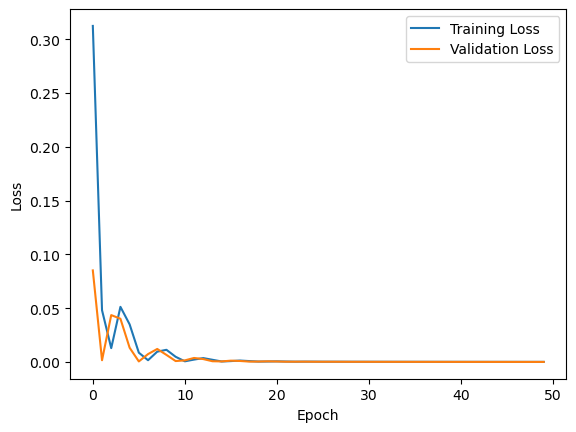

1/1 [==============================] - 0s 301ms/step


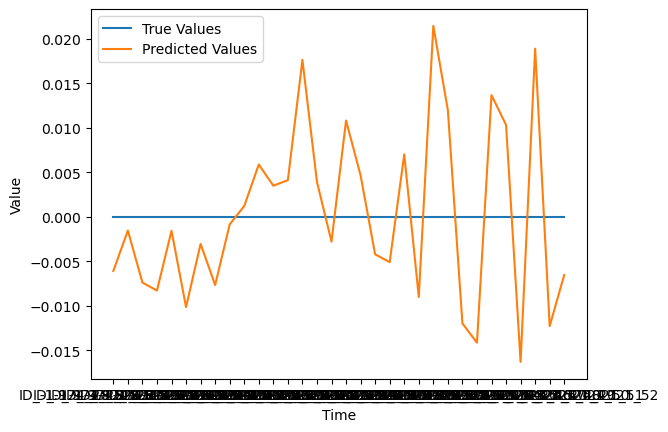

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -1.593_30.207
Epoch 1/50
3/3 [==============================] - 2s 243ms/step - loss: 32215.0430 - mse: 32215.0430 - accuracy: 0.0000e+00 - val_loss: 33235.6406 - val_mse: 33235.6406 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 36ms/step - loss: 32134.9727 - mse: 32134.9727 - accuracy: 0.0000e+00 - val_loss: 33165.2461 - val_mse: 33165.2461 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 44ms/step - loss: 32068.5918 - mse: 32068.5918 - accuracy: 0.0000e+00 - val_loss: 33104.6719 - val_mse: 33104.6719 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 43ms/step - loss: 32008.8867 - mse: 32008.8867 - accuracy: 0.0000e+00 - val_loss: 33041.8516 - val_mse: 33041.8516 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 39ms/step - loss: 31946.6055 - mse: 31946.6055 - accuracy: 0.0000e+00 - val_loss:

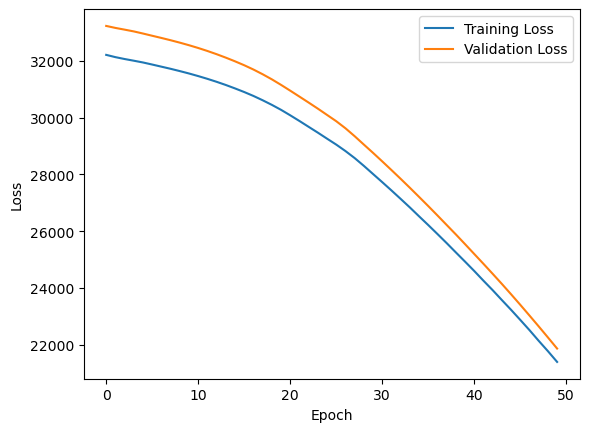

1/1 [==============================] - 1s 507ms/step


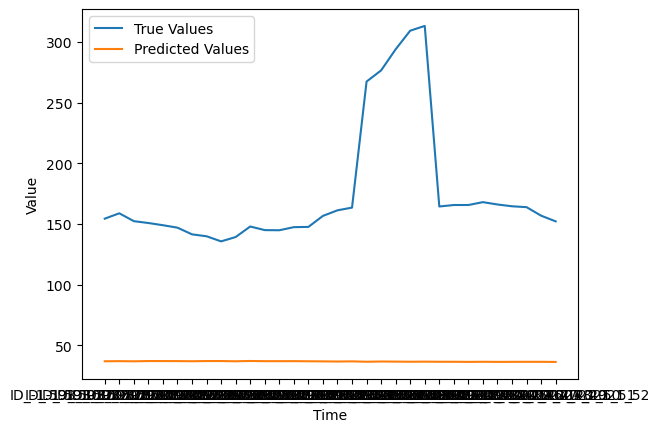

(49, 67)
2/2 [==============================] - 1s 9ms/step
LAT_LONG:  -1.339_29.961
Epoch 1/50
3/3 [==============================] - 3s 374ms/step - loss: 4035.8723 - mse: 4035.8726 - accuracy: 0.0000e+00 - val_loss: 3607.5625 - val_mse: 3607.5625 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 3987.1987 - mse: 3987.1987 - accuracy: 0.0000e+00 - val_loss: 3560.5864 - val_mse: 3560.5864 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 3940.1953 - mse: 3940.1953 - accuracy: 0.0000e+00 - val_loss: 3516.3447 - val_mse: 3516.3447 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 3895.1880 - mse: 3895.1880 - accuracy: 0.0000e+00 - val_loss: 3468.7559 - val_mse: 3468.7559 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 3845.0730 - mse: 3845.0730 - accuracy: 0.0000e+00 - val_loss: 3417.4438 - val_m

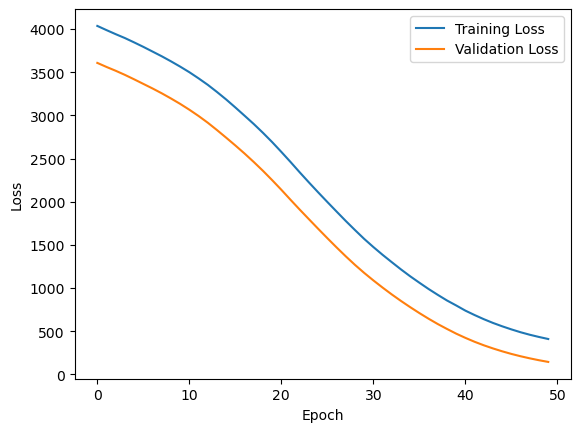

1/1 [==============================] - 0s 260ms/step


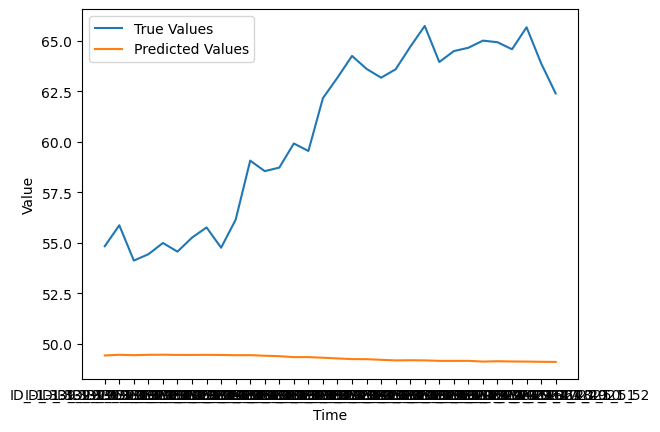

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.185_29.515
Epoch 1/50
3/3 [==============================] - 2s 239ms/step - loss: 34971.0234 - mse: 34971.0273 - accuracy: 0.0000e+00 - val_loss: 35992.1797 - val_mse: 35992.1797 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 34854.8711 - mse: 34854.8711 - accuracy: 0.0000e+00 - val_loss: 35883.1641 - val_mse: 35883.1641 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 34752.9180 - mse: 34752.9180 - accuracy: 0.0000e+00 - val_loss: 35783.3398 - val_mse: 35783.3398 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 34662.3203 - mse: 34662.3203 - accuracy: 0.0000e+00 - val_loss: 35700.8984 - val_mse: 35700.8984 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 34582.2383 - mse: 34582.2383 - accuracy: 0.0000e+00 - val_loss:

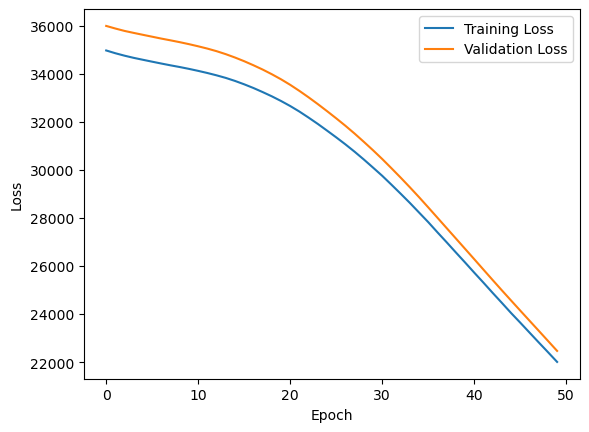

1/1 [==============================] - 0s 299ms/step


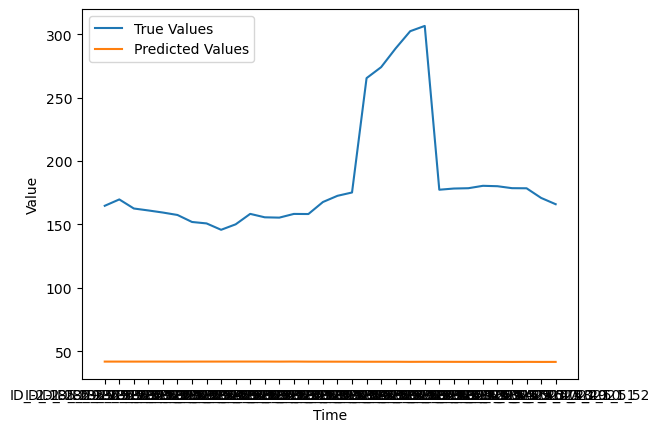

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.299_29.601
Epoch 1/50
3/3 [==============================] - 2s 240ms/step - loss: 131.3298 - mse: 131.3298 - accuracy: 0.0000e+00 - val_loss: 129.2599 - val_mse: 129.2599 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 31ms/step - loss: 124.8944 - mse: 124.8944 - accuracy: 0.0000e+00 - val_loss: 123.7831 - val_mse: 123.7831 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 119.5582 - mse: 119.5582 - accuracy: 0.0000e+00 - val_loss: 118.3889 - val_mse: 118.3889 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 114.1433 - mse: 114.1433 - accuracy: 0.0000e+00 - val_loss: 112.6712 - val_mse: 112.6712 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 108.5242 - mse: 108.5242 - accuracy: 0.0000e+00 - val_loss: 106.9417 - val_mse: 106.9417 - val_

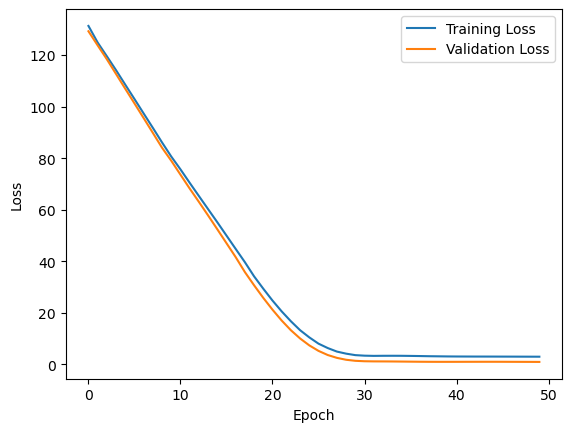

1/1 [==============================] - 0s 287ms/step


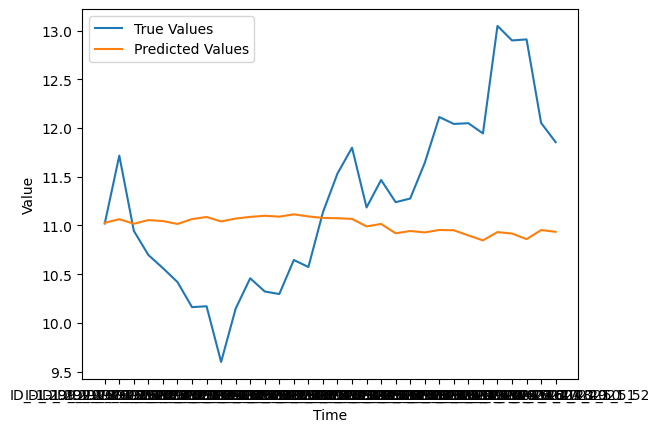

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.168_30.232
Epoch 1/50
3/3 [==============================] - 3s 201ms/step - loss: 8321.9229 - mse: 8321.9229 - accuracy: 0.0000e+00 - val_loss: 8854.9023 - val_mse: 8854.9023 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 30ms/step - loss: 8250.8408 - mse: 8250.8408 - accuracy: 0.0000e+00 - val_loss: 8803.1533 - val_mse: 8803.1533 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 29ms/step - loss: 8210.8887 - mse: 8210.8887 - accuracy: 0.0000e+00 - val_loss: 8774.4492 - val_mse: 8774.4492 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 8188.3496 - mse: 8188.3496 - accuracy: 0.0000e+00 - val_loss: 8754.9297 - val_mse: 8754.9297 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 32ms/step - loss: 8170.8525 - mse: 8170.8525 - accuracy: 0.0000e+00 - val_loss: 8736.1973 - val_m

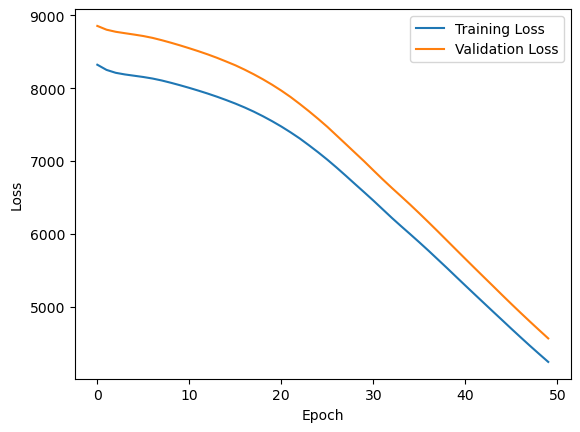

1/1 [==============================] - 0s 320ms/step


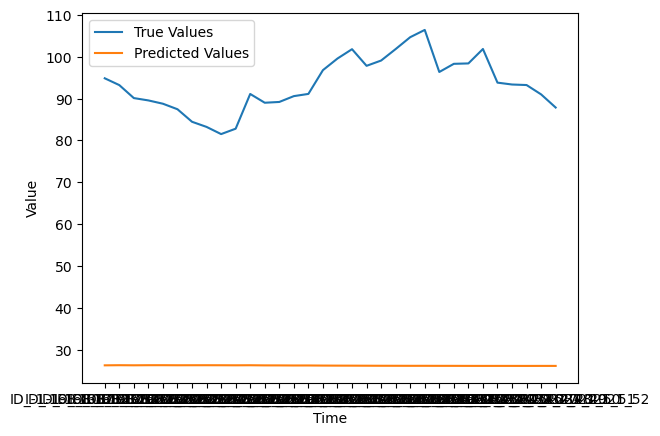

(49, 67)
2/2 [==============================] - 0s 10ms/step
LAT_LONG:  -1.906_29.694
Epoch 1/50
3/3 [==============================] - 2s 199ms/step - loss: 7761.4185 - mse: 7761.4185 - accuracy: 0.0000e+00 - val_loss: 8028.8896 - val_mse: 8028.8896 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 7724.2490 - mse: 7724.2490 - accuracy: 0.0000e+00 - val_loss: 7997.5576 - val_mse: 7997.5576 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 7693.6279 - mse: 7693.6279 - accuracy: 0.0000e+00 - val_loss: 7968.6846 - val_mse: 7968.6846 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 7665.5522 - mse: 7665.5522 - accuracy: 0.0000e+00 - val_loss: 7941.5176 - val_mse: 7941.5176 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 7638.7017 - mse: 7638.7017 - accuracy: 0.0000e+00 - val_loss: 7914.9893 - val_

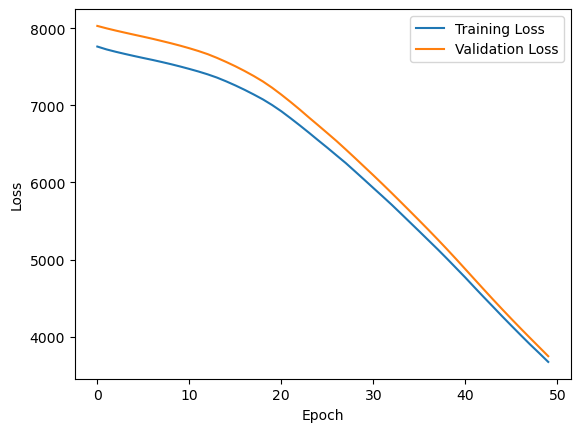

1/1 [==============================] - 0s 311ms/step


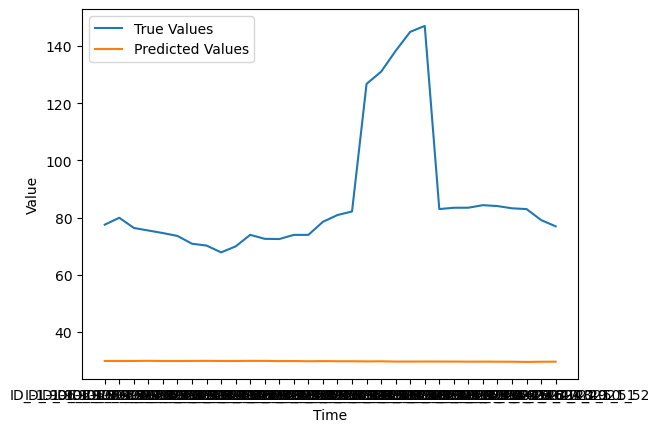

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.693_28.607
Epoch 1/50
3/3 [==============================] - 2s 222ms/step - loss: 719.2977 - mse: 719.2977 - accuracy: 0.0000e+00 - val_loss: 733.5469 - val_mse: 733.5469 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 31ms/step - loss: 704.8049 - mse: 704.8049 - accuracy: 0.0000e+00 - val_loss: 718.3755 - val_mse: 718.3755 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 35ms/step - loss: 689.6234 - mse: 689.6234 - accuracy: 0.0000e+00 - val_loss: 701.6012 - val_mse: 701.6012 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 672.9661 - mse: 672.9661 - accuracy: 0.0000e+00 - val_loss: 683.6945 - val_mse: 683.6945 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 655.1850 - mse: 655.1850 - accuracy: 0.0000e+00 - val_loss: 664.6420 - val_mse: 664.6420 - val_

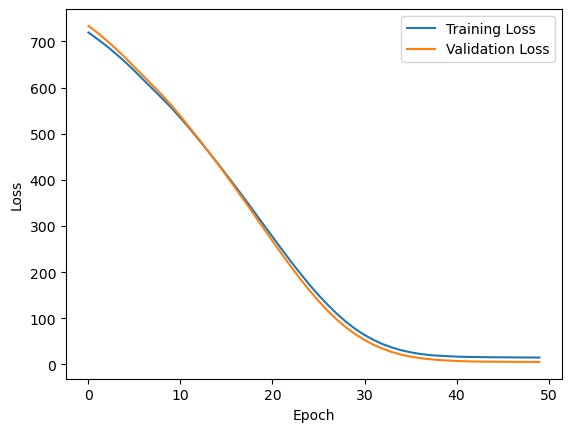

1/1 [==============================] - 0s 325ms/step


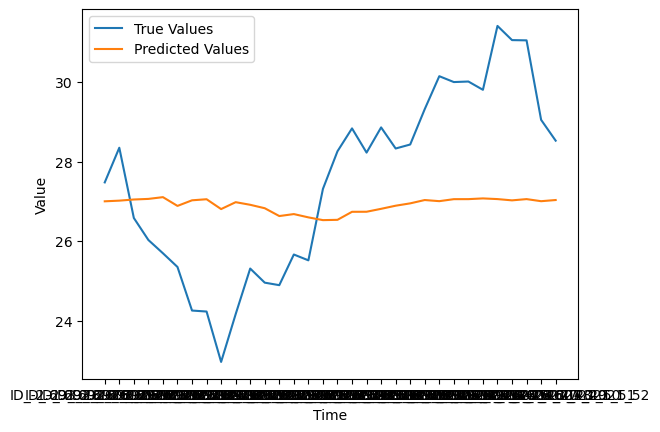

(49, 67)
2/2 [==============================] - 1s 5ms/step
LAT_LONG:  -2.255_28.645
Epoch 1/50
3/3 [==============================] - 2s 187ms/step - loss: 2.9713 - mse: 2.9713 - accuracy: 0.0000e+00 - val_loss: 1.1080 - val_mse: 1.1080 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 2.0344 - mse: 2.0344 - accuracy: 0.0000e+00 - val_loss: 0.4941 - val_mse: 0.4941 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 1.3803 - mse: 1.3803 - accuracy: 0.0000e+00 - val_loss: 0.1345 - val_mse: 0.1345 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 0.9627 - mse: 0.9627 - accuracy: 0.0000e+00 - val_loss: 0.0180 - val_mse: 0.0180 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 0.8232 - mse: 0.8232 - accuracy: 0.0000e+00 - val_loss: 0.0879 - val_mse: 0.0879 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

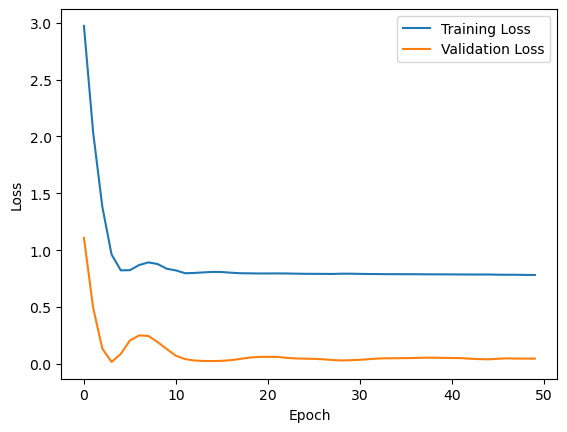

1/1 [==============================] - 0s 297ms/step


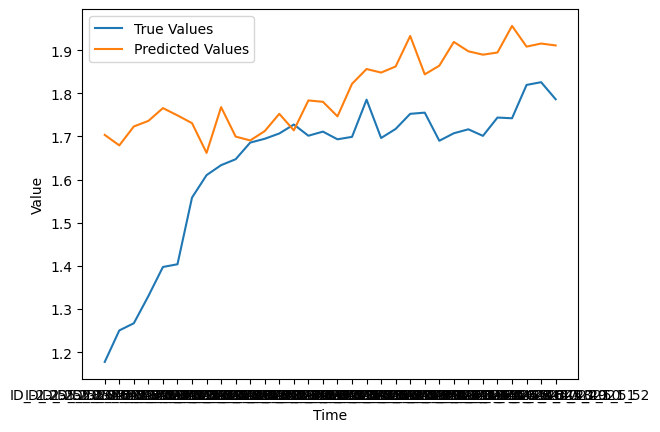

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -0.997_30.403
Epoch 1/50
3/3 [==============================] - 2s 186ms/step - loss: 1058.2458 - mse: 1058.2458 - accuracy: 0.0000e+00 - val_loss: 1105.0426 - val_mse: 1105.0426 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 1039.1967 - mse: 1039.1967 - accuracy: 0.0000e+00 - val_loss: 1085.0156 - val_mse: 1085.0156 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 1019.4717 - mse: 1019.4717 - accuracy: 0.0000e+00 - val_loss: 1064.4222 - val_mse: 1064.4222 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 999.2440 - mse: 999.2440 - accuracy: 0.0000e+00 - val_loss: 1043.3359 - val_mse: 1043.3359 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 978.5272 - mse: 978.5272 - accuracy: 0.0000e+00 - val_loss: 1021.4444 - val_mse: 

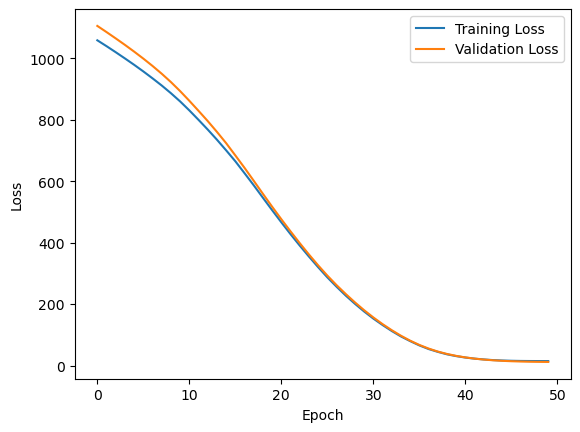

1/1 [==============================] - 0s 296ms/step


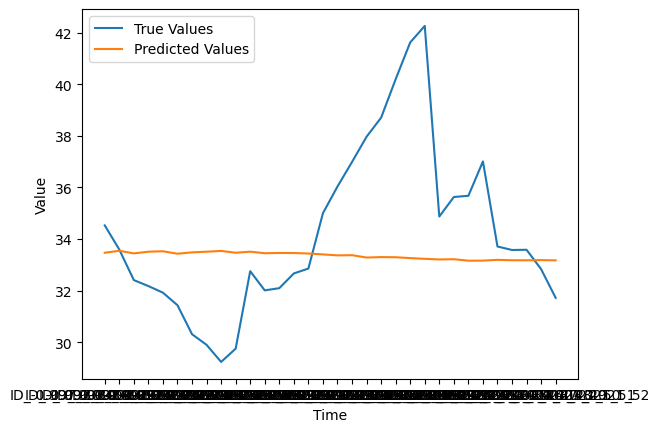

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.696_28.304
Epoch 1/50
3/3 [==============================] - 2s 242ms/step - loss: 0.7059 - mse: 0.7059 - accuracy: 0.0000e+00 - val_loss: 0.4165 - val_mse: 0.4165 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 30ms/step - loss: 0.2951 - mse: 0.2951 - accuracy: 0.3543 - val_loss: 0.1322 - val_mse: 0.1322 - val_accuracy: 1.0000
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 0.0762 - mse: 0.0762 - accuracy: 1.0000 - val_loss: 0.0130 - val_mse: 0.0130 - val_accuracy: 1.0000
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 0.0057 - mse: 0.0057 - accuracy: 1.0000 - val_loss: 0.0094 - val_mse: 0.0094 - val_accuracy: 1.0000
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 0.0198 - mse: 0.0198 - accuracy: 1.0000 - val_loss: 0.0334 - val_mse: 0.0334 - val_accuracy: 1.0000
Epoch 6/50
3/3 [==============================] - 0

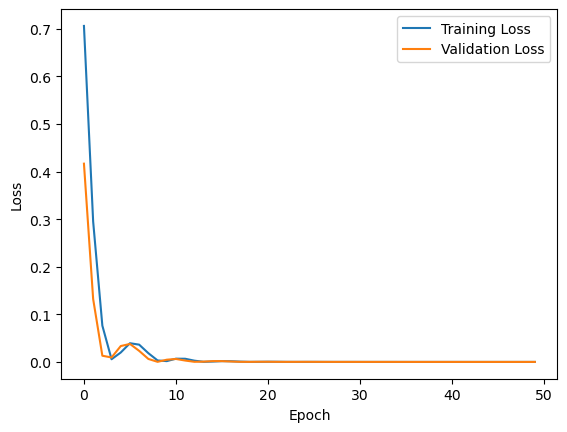

1/1 [==============================] - 0s 300ms/step


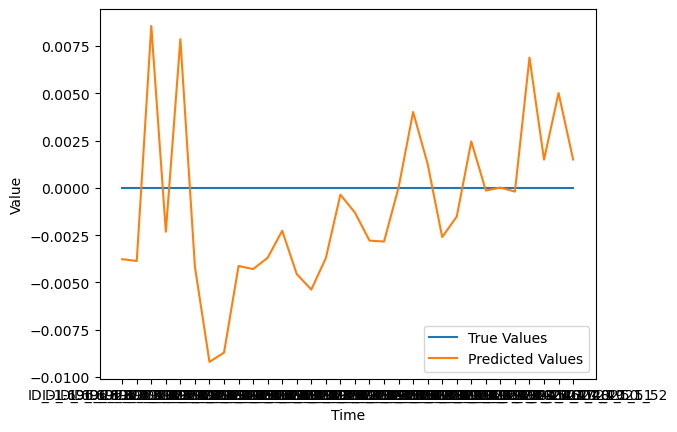

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -1.486_29.614
Epoch 1/50
3/3 [==============================] - 2s 216ms/step - loss: 104650.0156 - mse: 104650.0156 - accuracy: 0.0000e+00 - val_loss: 105524.5469 - val_mse: 105524.5469 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 104497.7031 - mse: 104497.7031 - accuracy: 0.0000e+00 - val_loss: 105386.2500 - val_mse: 105386.2500 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 104364.5312 - mse: 104364.5312 - accuracy: 0.0000e+00 - val_loss: 105260.1094 - val_mse: 105260.1094 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 104240.2344 - mse: 104240.2344 - accuracy: 0.0000e+00 - val_loss: 105140.3906 - val_mse: 105140.3906 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 104109.7266 - mse: 104109.7266 - accuracy: 0.00

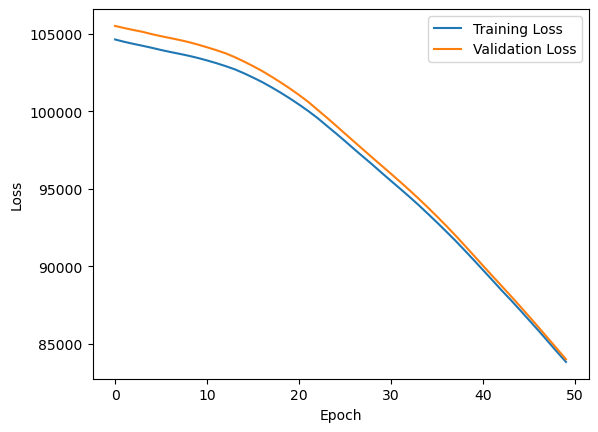

1/1 [==============================] - 0s 297ms/step


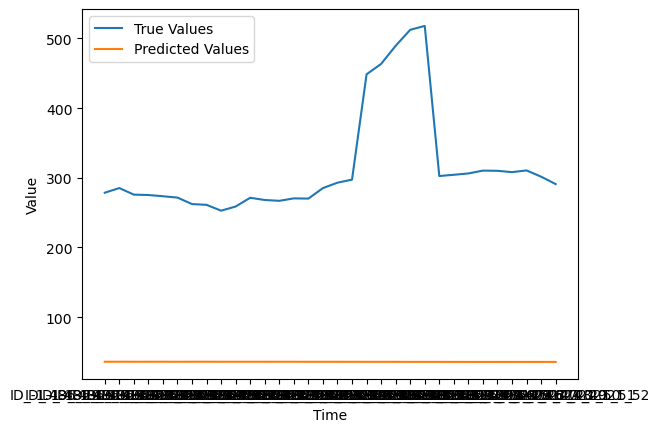

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.522_29.078
Epoch 1/50
3/3 [==============================] - 2s 228ms/step - loss: 1466.7755 - mse: 1466.7755 - accuracy: 0.0000e+00 - val_loss: 1422.6638 - val_mse: 1422.6638 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 1447.0664 - mse: 1447.0664 - accuracy: 0.0000e+00 - val_loss: 1404.3650 - val_mse: 1404.3650 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 1429.4819 - mse: 1429.4819 - accuracy: 0.0000e+00 - val_loss: 1389.1935 - val_mse: 1389.1935 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 1414.7998 - mse: 1414.7999 - accuracy: 0.0000e+00 - val_loss: 1374.4303 - val_mse: 1374.4303 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 1399.9927 - mse: 1399.9927 - accuracy: 0.0000e+00 - val_loss: 1360.1940 - val_m

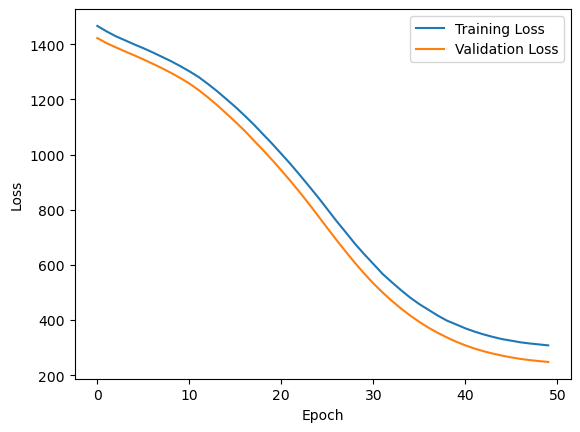

1/1 [==============================] - 0s 308ms/step


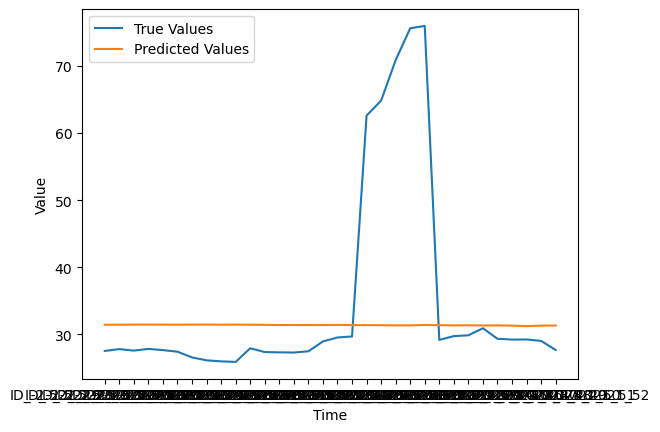

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.139_30.561
Epoch 1/50
3/3 [==============================] - 2s 189ms/step - loss: 1603.5598 - mse: 1603.5598 - accuracy: 0.0000e+00 - val_loss: 1760.9990 - val_mse: 1760.9990 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 50ms/step - loss: 1585.2054 - mse: 1585.2054 - accuracy: 0.0000e+00 - val_loss: 1741.5558 - val_mse: 1741.5558 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 42ms/step - loss: 1566.3649 - mse: 1566.3649 - accuracy: 0.0000e+00 - val_loss: 1720.4614 - val_mse: 1720.4614 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 1545.8364 - mse: 1545.8364 - accuracy: 0.0000e+00 - val_loss: 1697.3197 - val_mse: 1697.3197 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 1524.0002 - mse: 1524.0002 - accuracy: 0.0000e+00 - val_loss: 1673.5488 - val_m

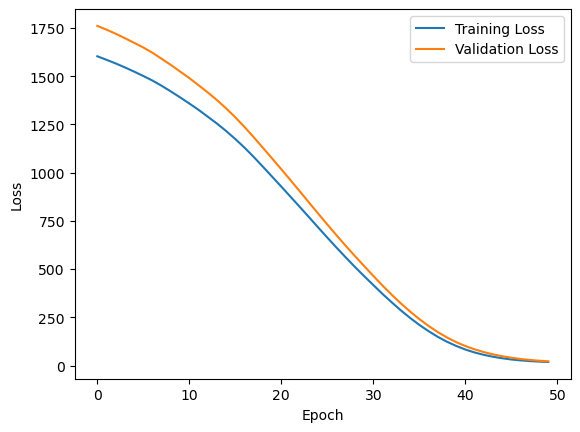

1/1 [==============================] - 0s 337ms/step


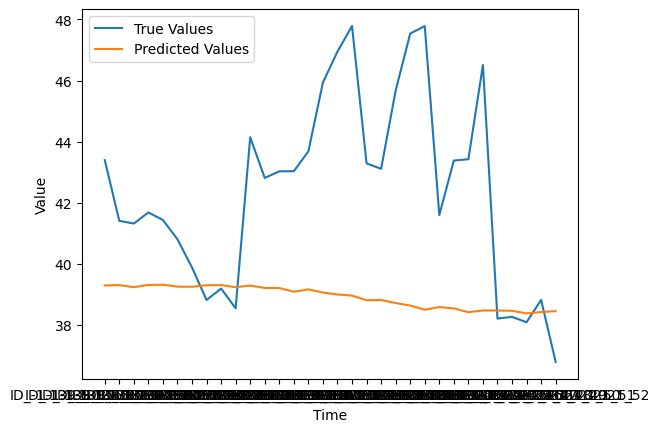

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -0.806_31.494
Epoch 1/50
3/3 [==============================] - 2s 214ms/step - loss: 34.2834 - mse: 34.2834 - accuracy: 0.0000e+00 - val_loss: 21.5327 - val_mse: 21.5327 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 30.6531 - mse: 30.6531 - accuracy: 0.0000e+00 - val_loss: 18.7472 - val_mse: 18.7472 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 27.8684 - mse: 27.8684 - accuracy: 0.0000e+00 - val_loss: 17.1161 - val_mse: 17.1161 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 26.0706 - mse: 26.0706 - accuracy: 0.0000e+00 - val_loss: 15.6328 - val_mse: 15.6328 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 24.3134 - mse: 24.3134 - accuracy: 0.0000e+00 - val_loss: 13.9538 - val_mse: 13.9538 - val_accuracy: 0.0000e+00

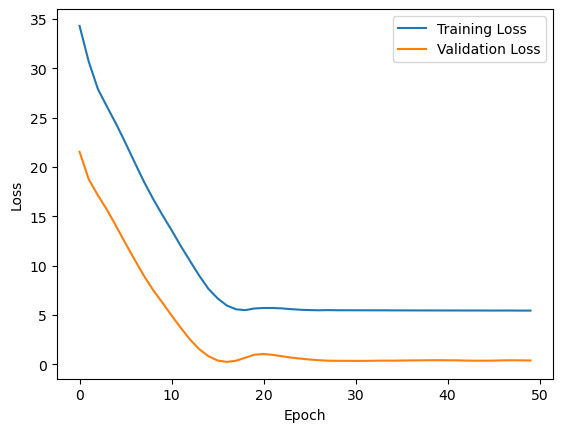

1/1 [==============================] - 0s 303ms/step


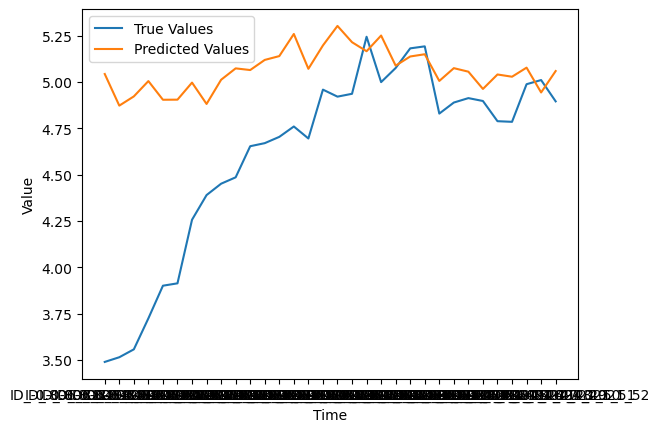

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -0.978_29.722
Epoch 1/50
3/3 [==============================] - 2s 218ms/step - loss: 770.0422 - mse: 770.0422 - accuracy: 0.0000e+00 - val_loss: 846.5938 - val_mse: 846.5938 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 759.3009 - mse: 759.3009 - accuracy: 0.0000e+00 - val_loss: 835.1224 - val_mse: 835.1224 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 29ms/step - loss: 748.3340 - mse: 748.3340 - accuracy: 0.0000e+00 - val_loss: 823.7911 - val_mse: 823.7911 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 737.7596 - mse: 737.7596 - accuracy: 0.0000e+00 - val_loss: 813.1099 - val_mse: 813.1099 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 727.6708 - mse: 727.6708 - accuracy: 0.0000e+00 - val_loss: 802.3488 - val_mse: 802.3488 - val_

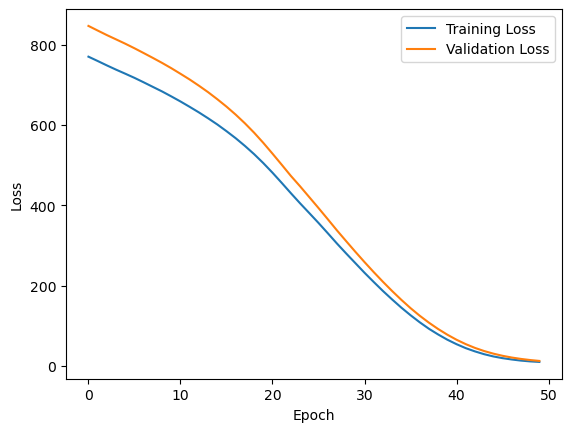

1/1 [==============================] - 0s 330ms/step


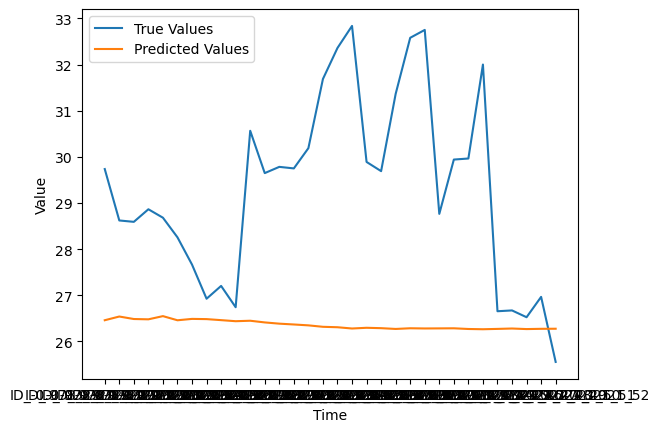

(49, 67)
2/2 [==============================] - 0s 9ms/step
LAT_LONG:  -1.764_31.436
Epoch 1/50
3/3 [==============================] - 2s 213ms/step - loss: 22.1965 - mse: 22.1965 - accuracy: 0.0000e+00 - val_loss: 22.6949 - val_mse: 22.6949 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 31ms/step - loss: 18.9560 - mse: 18.9560 - accuracy: 0.0000e+00 - val_loss: 19.6224 - val_mse: 19.6224 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 29ms/step - loss: 16.3331 - mse: 16.3331 - accuracy: 0.0000e+00 - val_loss: 17.1563 - val_mse: 17.1563 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 14.1405 - mse: 14.1405 - accuracy: 0.0000e+00 - val_loss: 14.8711 - val_mse: 14.8711 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 32ms/step - loss: 12.0233 - mse: 12.0233 - accuracy: 0.0000e+00 - val_loss: 12.5732 - val_mse: 12.5732 - val_accuracy: 0.0000e+00

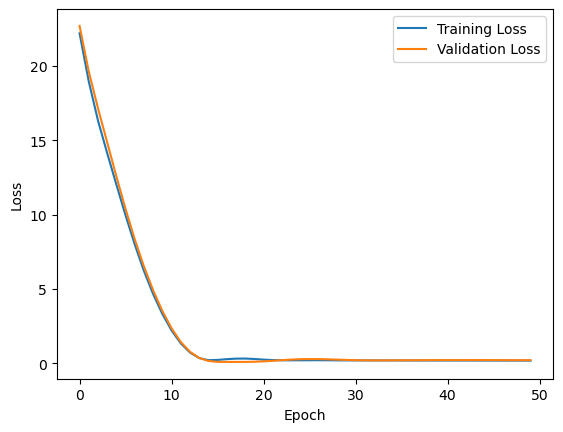

1/1 [==============================] - 0s 305ms/step


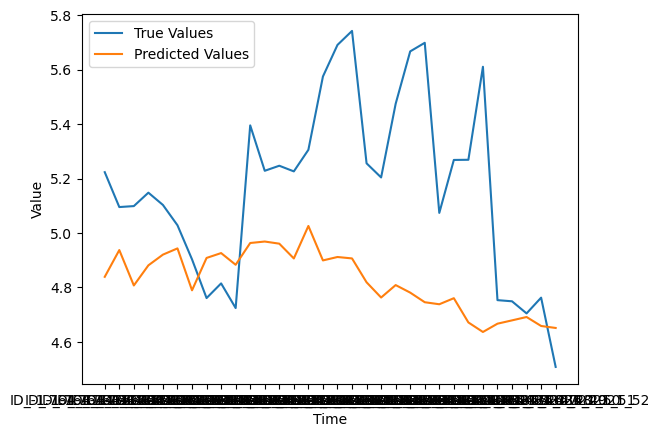

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.97_30.03
Epoch 1/50
3/3 [==============================] - 2s 213ms/step - loss: 53.9652 - mse: 53.9652 - accuracy: 0.0000e+00 - val_loss: 56.9800 - val_mse: 56.9800 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 50.3854 - mse: 50.3854 - accuracy: 0.0000e+00 - val_loss: 53.3988 - val_mse: 53.3988 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 47.0072 - mse: 47.0072 - accuracy: 0.0000e+00 - val_loss: 49.9246 - val_mse: 49.9246 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 43.7552 - mse: 43.7552 - accuracy: 0.0000e+00 - val_loss: 46.7191 - val_mse: 46.7191 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 40.9517 - mse: 40.9517 - accuracy: 0.0000e+00 - val_loss: 44.1758 - val_mse: 44.1758 - val_accuracy: 0.0000e+00
E

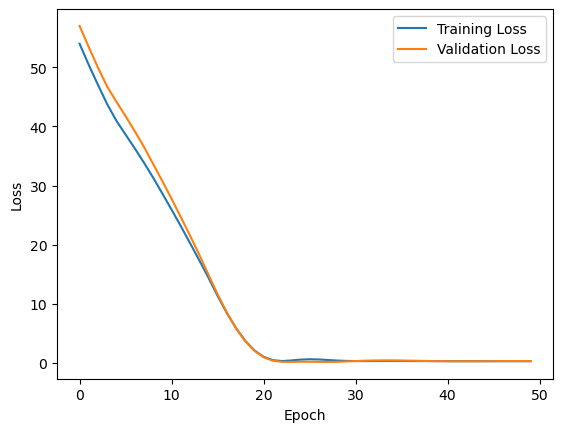

1/1 [==============================] - 0s 325ms/step


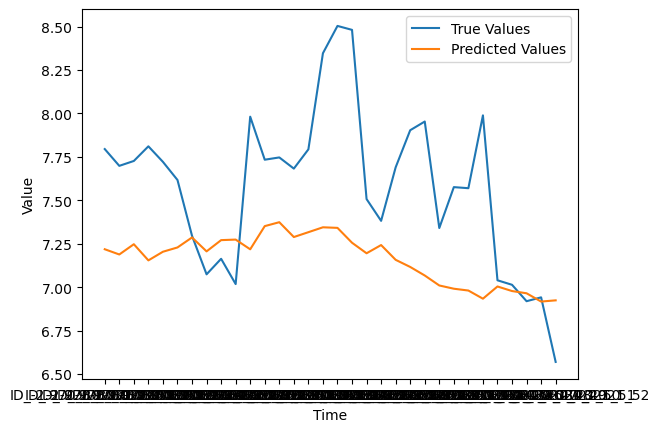

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.231_30.269
Epoch 1/50
3/3 [==============================] - 2s 427ms/step - loss: 6350.5840 - mse: 6350.5840 - accuracy: 0.0000e+00 - val_loss: 6669.7197 - val_mse: 6669.7197 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 6312.9146 - mse: 6312.9146 - accuracy: 0.0000e+00 - val_loss: 6638.0771 - val_mse: 6638.0771 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 29ms/step - loss: 6283.4766 - mse: 6283.4766 - accuracy: 0.0000e+00 - val_loss: 6609.1997 - val_mse: 6609.1997 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 6255.7617 - mse: 6255.7617 - accuracy: 0.0000e+00 - val_loss: 6580.4844 - val_mse: 6580.4844 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 6225.3364 - mse: 6225.3364 - accuracy: 0.0000e+00 - val_loss: 6544.6396 - val_m

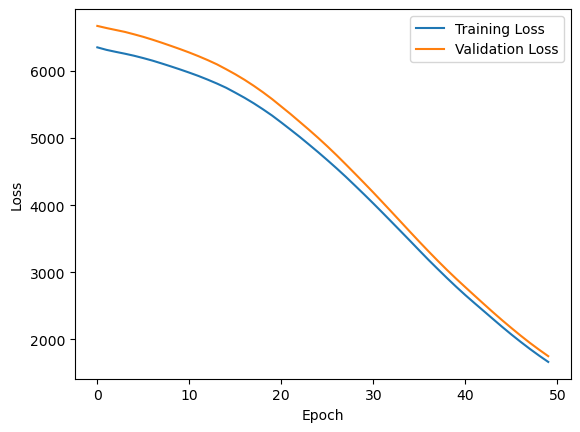

1/1 [==============================] - 0s 347ms/step


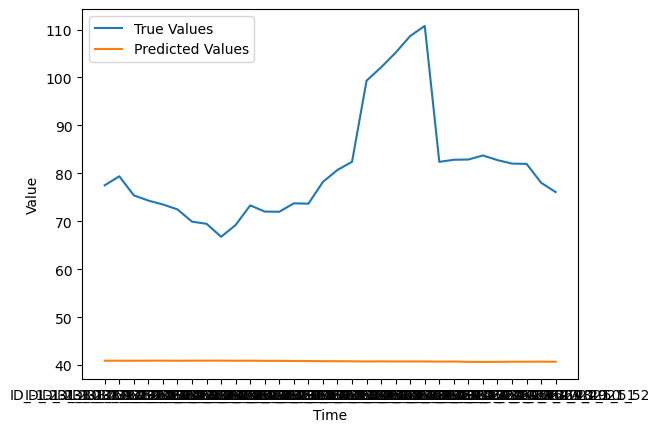

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.384_28.916
Epoch 1/50
3/3 [==============================] - 2s 207ms/step - loss: 38.2136 - mse: 38.2136 - accuracy: 0.0000e+00 - val_loss: 35.4328 - val_mse: 35.4328 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 34.8382 - mse: 34.8382 - accuracy: 0.0000e+00 - val_loss: 32.2737 - val_mse: 32.2737 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 31.7774 - mse: 31.7774 - accuracy: 0.0000e+00 - val_loss: 29.3057 - val_mse: 29.3057 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 28.8830 - mse: 28.8830 - accuracy: 0.0000e+00 - val_loss: 26.4610 - val_mse: 26.4610 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 26.1088 - mse: 26.1088 - accuracy: 0.0000e+00 - val_loss: 23.8153 - val_mse: 23.8153 - val_accuracy: 0.0000e+00

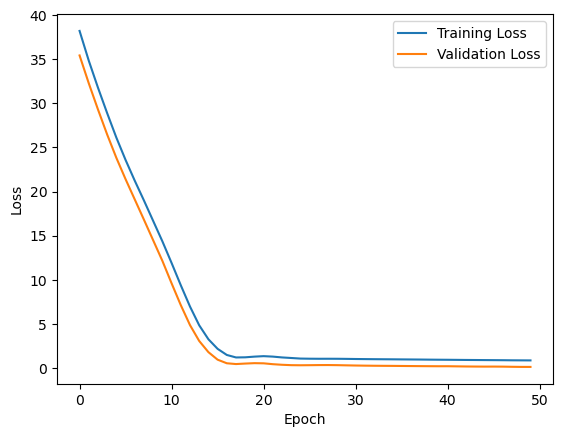

1/1 [==============================] - 0s 303ms/step


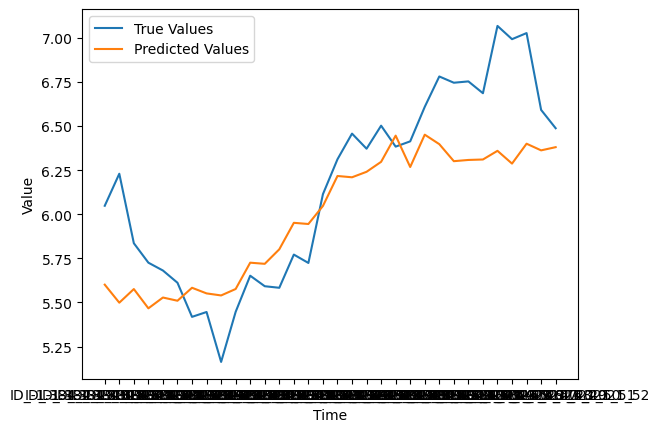

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -0.871_30.029
Epoch 1/50
3/3 [==============================] - 2s 235ms/step - loss: 944.6210 - mse: 944.6210 - accuracy: 0.0000e+00 - val_loss: 1028.1489 - val_mse: 1028.1489 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 925.5646 - mse: 925.5646 - accuracy: 0.0000e+00 - val_loss: 1011.6048 - val_mse: 1011.6048 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 29ms/step - loss: 911.4381 - mse: 911.4381 - accuracy: 0.0000e+00 - val_loss: 999.0677 - val_mse: 999.0677 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 900.3005 - mse: 900.3005 - accuracy: 0.0000e+00 - val_loss: 987.5626 - val_mse: 987.5626 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 888.3693 - mse: 888.3693 - accuracy: 0.0000e+00 - val_loss: 973.5822 - val_mse: 973.5822 - 

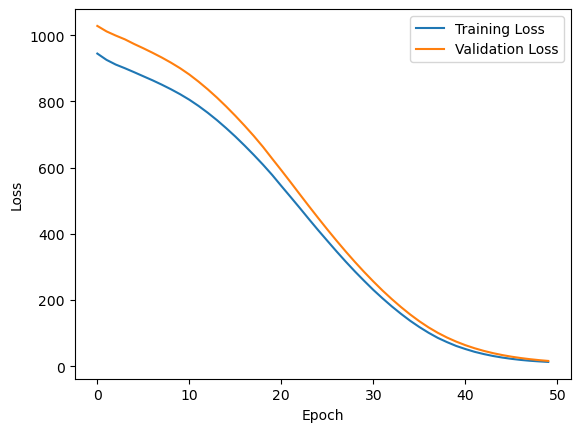

1/1 [==============================] - 0s 303ms/step


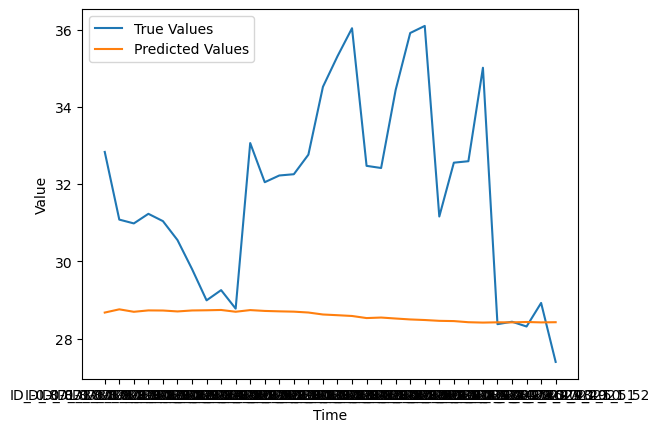

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.555_30.945
Epoch 1/50
3/3 [==============================] - 2s 193ms/step - loss: 1004.5075 - mse: 1004.5075 - accuracy: 0.0000e+00 - val_loss: 1160.0299 - val_mse: 1160.0299 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 30ms/step - loss: 983.6116 - mse: 983.6116 - accuracy: 0.0000e+00 - val_loss: 1136.2148 - val_mse: 1136.2148 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 961.6310 - mse: 961.6310 - accuracy: 0.0000e+00 - val_loss: 1112.2118 - val_mse: 1112.2118 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 939.4534 - mse: 939.4534 - accuracy: 0.0000e+00 - val_loss: 1087.8439 - val_mse: 1087.8439 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 916.7263 - mse: 916.7263 - accuracy: 0.0000e+00 - val_loss: 1061.9050 - val_mse: 1061

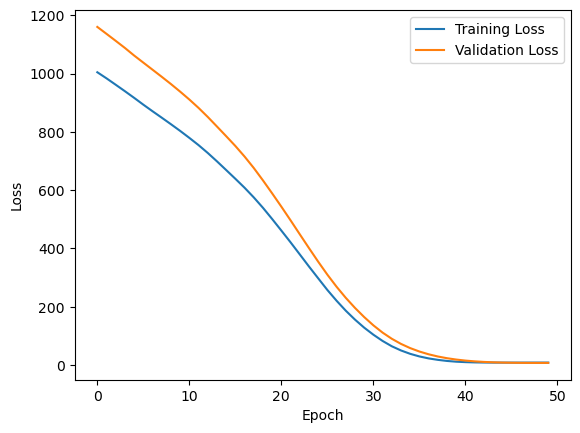

1/1 [==============================] - 0s 337ms/step


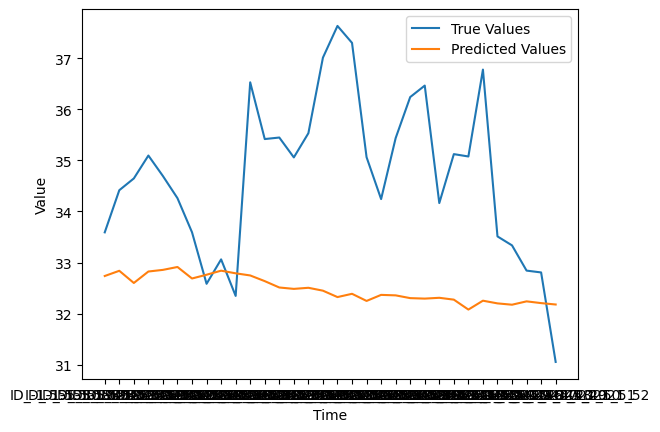

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.398_29.702
Epoch 1/50
3/3 [==============================] - 2s 216ms/step - loss: 33665.3516 - mse: 33665.3516 - accuracy: 0.0000e+00 - val_loss: 33631.5703 - val_mse: 33631.5703 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 33553.7773 - mse: 33553.7734 - accuracy: 0.0000e+00 - val_loss: 33526.3984 - val_mse: 33526.3984 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 33453.2227 - mse: 33453.2227 - accuracy: 0.0000e+00 - val_loss: 33424.5859 - val_mse: 33424.5859 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 33353.9883 - mse: 33353.9883 - accuracy: 0.0000e+00 - val_loss: 33334.1016 - val_mse: 33334.1016 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 33266.4727 - mse: 33266.4727 - accuracy: 0.0000e+00 - val_loss:

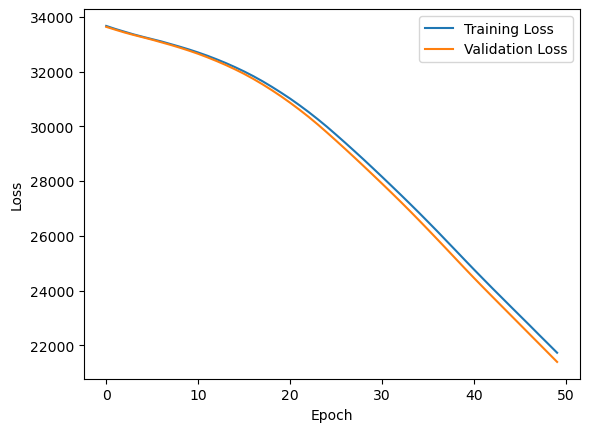

1/1 [==============================] - 0s 301ms/step


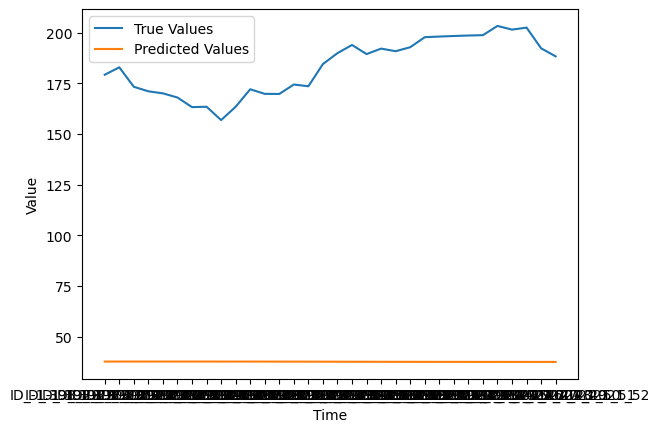

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.978_31.122
Epoch 1/50
3/3 [==============================] - 2s 229ms/step - loss: 54708.1094 - mse: 54708.1094 - accuracy: 0.0000e+00 - val_loss: 55842.6562 - val_mse: 55842.6562 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 54553.7695 - mse: 54553.7695 - accuracy: 0.0000e+00 - val_loss: 55710.6484 - val_mse: 55710.6484 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 54434.3828 - mse: 54434.3828 - accuracy: 0.0000e+00 - val_loss: 55622.5859 - val_mse: 55622.5859 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 54342.8672 - mse: 54342.8672 - accuracy: 0.0000e+00 - val_loss: 55525.1328 - val_mse: 55525.1328 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 54242.5312 - mse: 54242.5312 - accuracy: 0.0000e+00 - val_loss:

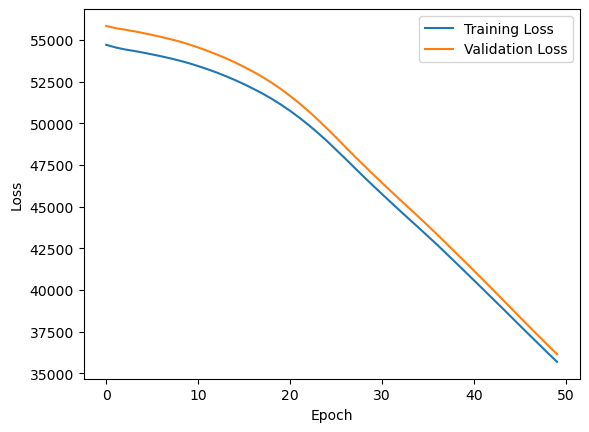

1/1 [==============================] - 0s 275ms/step


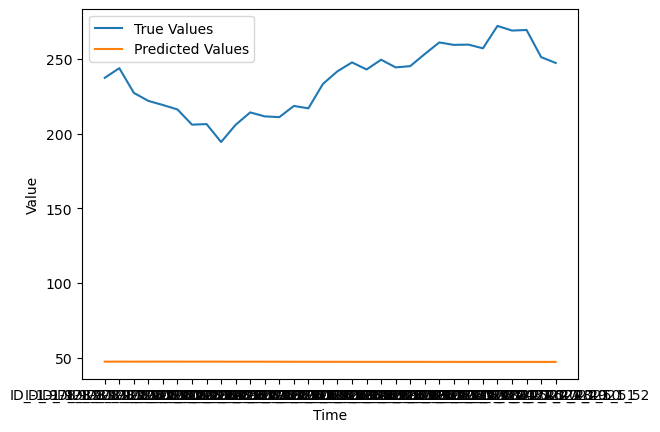

(49, 67)
2/2 [==============================] - 1s 6ms/step
LAT_LONG:  -1.49_30.51
Epoch 1/50
3/3 [==============================] - 2s 229ms/step - loss: 890.1549 - mse: 890.1549 - accuracy: 0.0000e+00 - val_loss: 576.0593 - val_mse: 576.0593 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 872.6684 - mse: 872.6684 - accuracy: 0.0000e+00 - val_loss: 561.0548 - val_mse: 561.0548 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 856.4200 - mse: 856.4200 - accuracy: 0.0000e+00 - val_loss: 546.8190 - val_mse: 546.8190 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 841.1067 - mse: 841.1067 - accuracy: 0.0000e+00 - val_loss: 534.2809 - val_mse: 534.2809 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 827.6725 - mse: 827.6725 - accuracy: 0.0000e+00 - val_loss: 521.4163 - val_mse: 521.4163 - val_ac

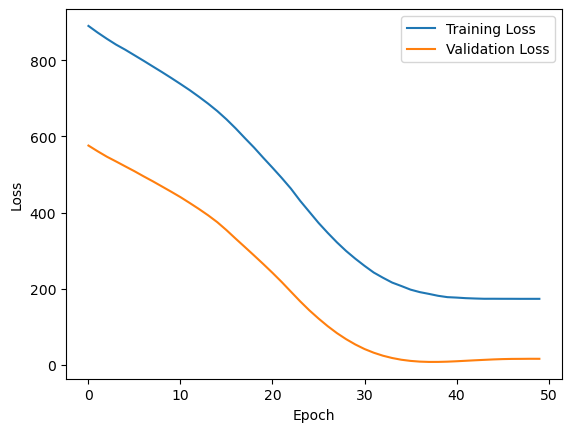

1/1 [==============================] - 0s 302ms/step


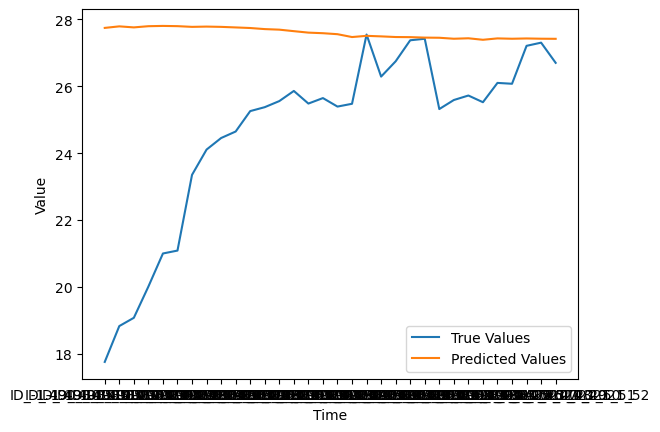

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.18_29.62
Epoch 1/50
3/3 [==============================] - 2s 213ms/step - loss: 15560.6670 - mse: 15560.6670 - accuracy: 0.0000e+00 - val_loss: 16132.2490 - val_mse: 16132.2490 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 15456.0898 - mse: 15456.0898 - accuracy: 0.0000e+00 - val_loss: 16028.0957 - val_mse: 16028.0957 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 15356.4600 - mse: 15356.4600 - accuracy: 0.0000e+00 - val_loss: 15930.4561 - val_mse: 15930.4561 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 31ms/step - loss: 15265.0312 - mse: 15265.0312 - accuracy: 0.0000e+00 - val_loss: 15833.7461 - val_mse: 15833.7461 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 15170.9824 - mse: 15170.9824 - accuracy: 0.0000e+00 - val_loss: 1

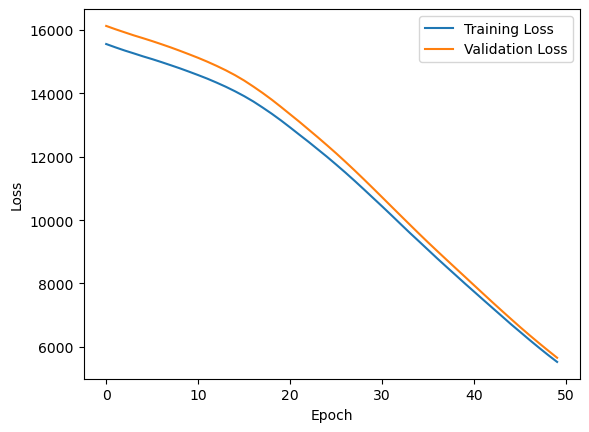

1/1 [==============================] - 0s 325ms/step


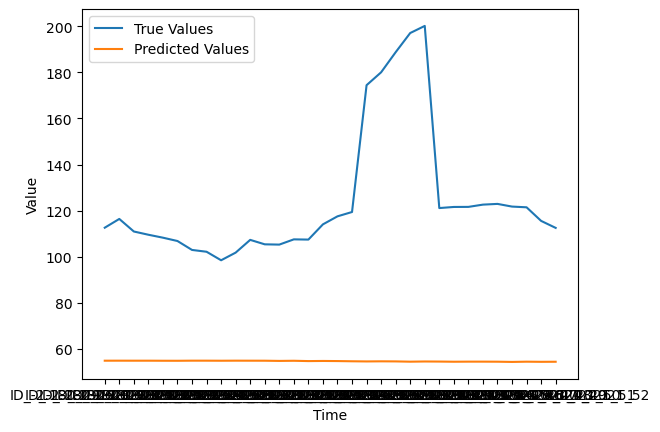

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.177_30.223
Epoch 1/50
3/3 [==============================] - 2s 435ms/step - loss: 10683.2275 - mse: 10683.2275 - accuracy: 0.0000e+00 - val_loss: 9851.8496 - val_mse: 9851.8496 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 10607.5703 - mse: 10607.5703 - accuracy: 0.0000e+00 - val_loss: 9778.4316 - val_mse: 9778.4316 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 10534.1191 - mse: 10534.1191 - accuracy: 0.0000e+00 - val_loss: 9708.0488 - val_mse: 9708.0488 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 10465.4902 - mse: 10465.4902 - accuracy: 0.0000e+00 - val_loss: 9644.1523 - val_mse: 9644.1523 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 10401.3389 - mse: 10401.3389 - accuracy: 0.0000e+00 - val_loss: 9583.64

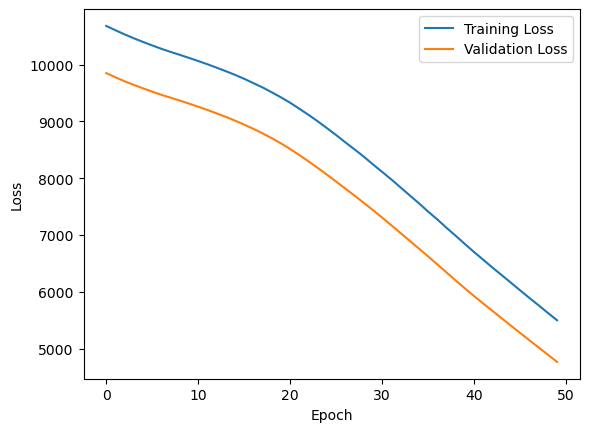

1/1 [==============================] - 0s 308ms/step


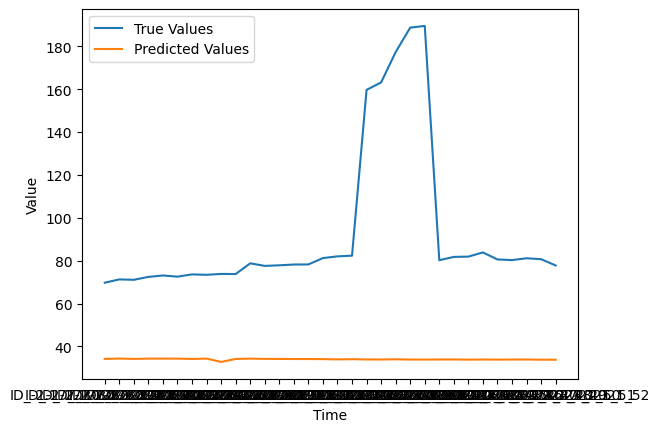

(49, 67)
2/2 [==============================] - 0s 9ms/step
LAT_LONG:  -0.997_30.603
Epoch 1/50
3/3 [==============================] - 2s 221ms/step - loss: 2812.9734 - mse: 2812.9734 - accuracy: 0.0000e+00 - val_loss: 3066.0864 - val_mse: 3066.0864 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 2782.0452 - mse: 2782.0452 - accuracy: 0.0000e+00 - val_loss: 3033.7700 - val_mse: 3033.7700 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 2750.6606 - mse: 2750.6606 - accuracy: 0.0000e+00 - val_loss: 3001.0598 - val_mse: 3001.0598 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 2719.0923 - mse: 2719.0923 - accuracy: 0.0000e+00 - val_loss: 2967.6606 - val_mse: 2967.6606 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 2686.8362 - mse: 2686.8362 - accuracy: 0.0000e+00 - val_loss: 2935.0850 - val_m

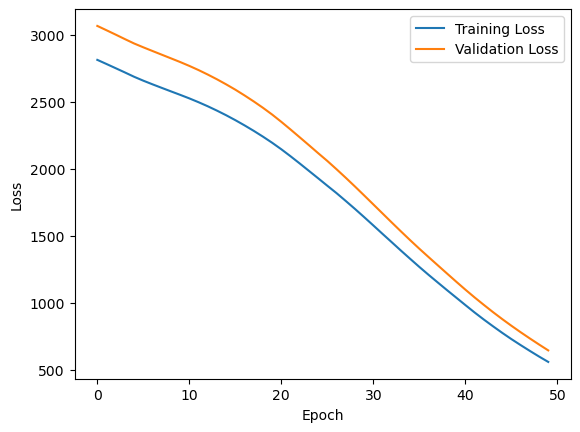

1/1 [==============================] - 1s 525ms/step


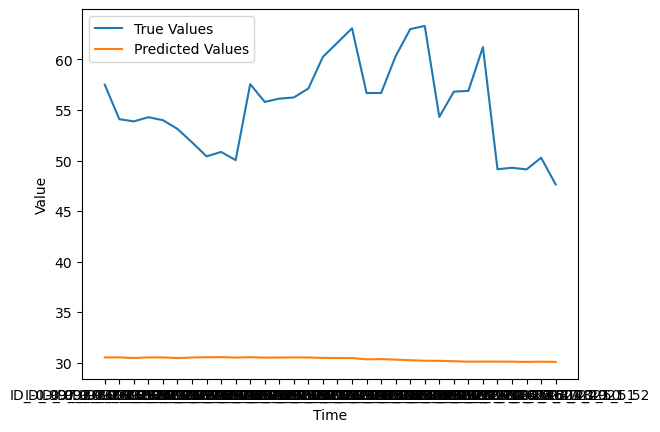

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -2.517_29.883
Epoch 1/50
3/3 [==============================] - 3s 263ms/step - loss: 12923.0176 - mse: 12923.0176 - accuracy: 0.0000e+00 - val_loss: 13071.7168 - val_mse: 13071.7168 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 12854.4219 - mse: 12854.4219 - accuracy: 0.0000e+00 - val_loss: 13002.1191 - val_mse: 13002.1191 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 41ms/step - loss: 12786.1797 - mse: 12786.1797 - accuracy: 0.0000e+00 - val_loss: 12929.0127 - val_mse: 12929.0127 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 12712.8486 - mse: 12712.8486 - accuracy: 0.0000e+00 - val_loss: 12852.8213 - val_mse: 12852.8213 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 12639.2051 - mse: 12639.2051 - accuracy: 0.0000e+00 - val_loss:

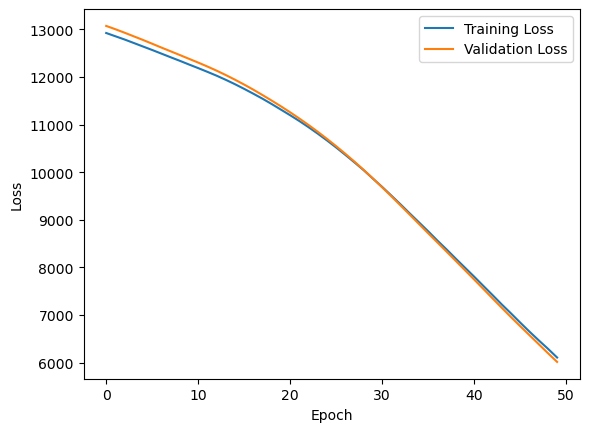

1/1 [==============================] - 0s 336ms/step


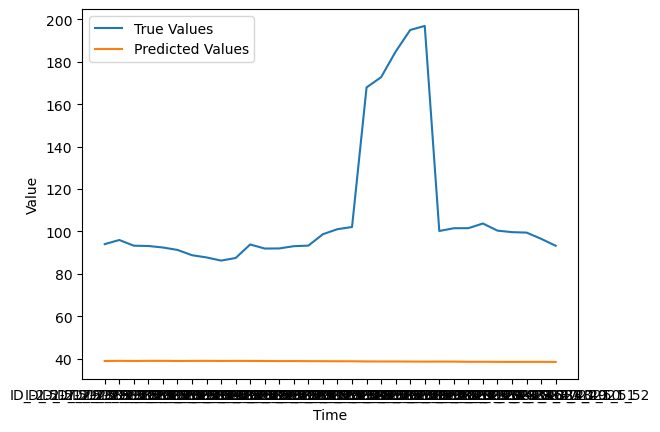

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.133_30.467
Epoch 1/50
3/3 [==============================] - 2s 192ms/step - loss: 10416.7695 - mse: 10416.7695 - accuracy: 0.0000e+00 - val_loss: 10893.8672 - val_mse: 10893.8672 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 10380.1045 - mse: 10380.1045 - accuracy: 0.0000e+00 - val_loss: 10857.4102 - val_mse: 10857.4102 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 10342.9648 - mse: 10342.9639 - accuracy: 0.0000e+00 - val_loss: 10816.8809 - val_mse: 10816.8809 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 10303.3213 - mse: 10303.3213 - accuracy: 0.0000e+00 - val_loss: 10771.3057 - val_mse: 10771.3057 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 10259.7822 - mse: 10259.7812 - accuracy: 0.0000e+00 - val_loss:

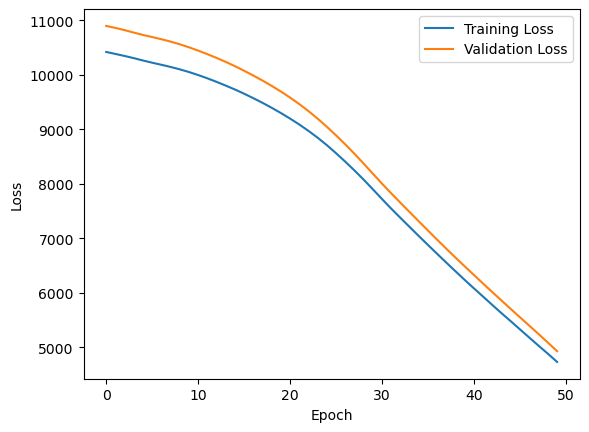

1/1 [==============================] - 0s 311ms/step


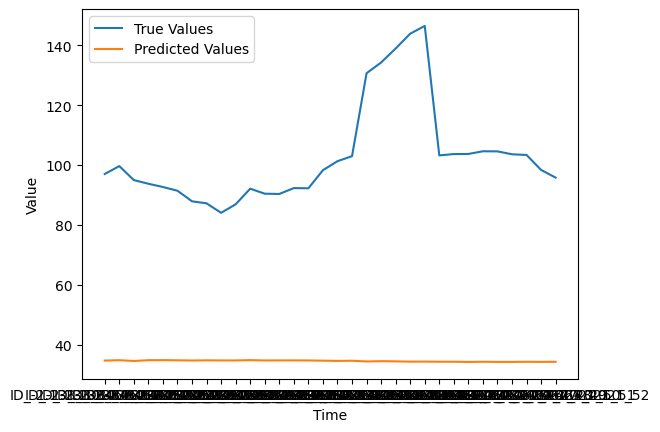

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.794_28.306
Epoch 1/50
3/3 [==============================] - 2s 249ms/step - loss: 2.8422 - mse: 2.8422 - accuracy: 0.0000e+00 - val_loss: 0.6717 - val_mse: 0.6717 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 36ms/step - loss: 1.7096 - mse: 1.7096 - accuracy: 0.0000e+00 - val_loss: 0.2656 - val_mse: 0.2656 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 57ms/step - loss: 1.2663 - mse: 1.2663 - accuracy: 0.0000e+00 - val_loss: 0.0527 - val_mse: 0.0527 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 34ms/step - loss: 0.9845 - mse: 0.9845 - accuracy: 0.0000e+00 - val_loss: 0.0208 - val_mse: 0.0208 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 0.9015 - mse: 0.9015 - accuracy: 0.0000e+00 - val_loss: 0.1088 - val_mse: 0.1088 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

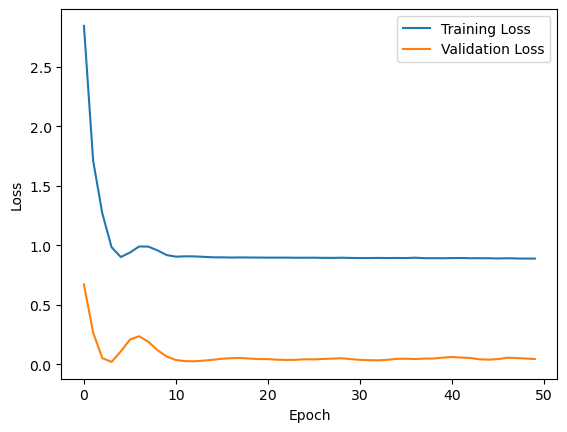

1/1 [==============================] - 0s 395ms/step


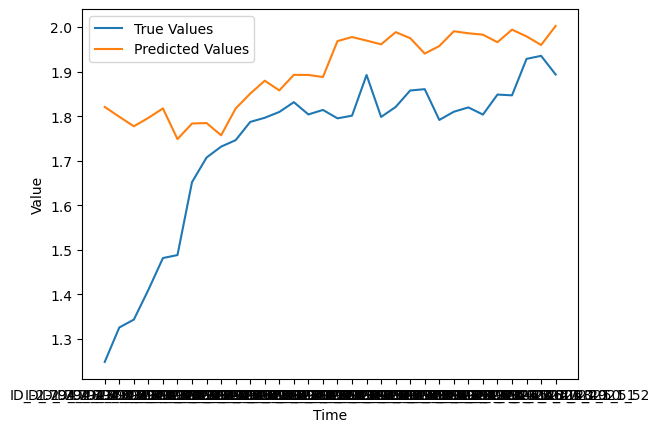

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.489_28.811
Epoch 1/50
3/3 [==============================] - 2s 245ms/step - loss: 1429.3915 - mse: 1429.3915 - accuracy: 0.0000e+00 - val_loss: 1440.9102 - val_mse: 1440.9102 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 1402.7506 - mse: 1402.7506 - accuracy: 0.0000e+00 - val_loss: 1416.1050 - val_mse: 1416.1050 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 1378.8325 - mse: 1378.8325 - accuracy: 0.0000e+00 - val_loss: 1393.2605 - val_mse: 1393.2605 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 1357.6700 - mse: 1357.6700 - accuracy: 0.0000e+00 - val_loss: 1374.3428 - val_mse: 1374.3428 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 32ms/step - loss: 1339.7202 - mse: 1339.7202 - accuracy: 0.0000e+00 - val_loss: 1356.4189 - val_m

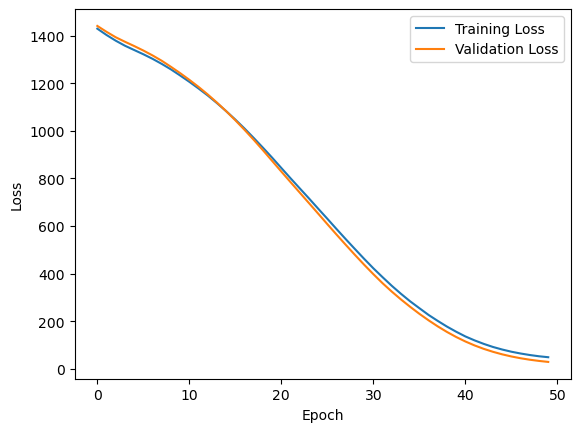

1/1 [==============================] - 0s 307ms/step


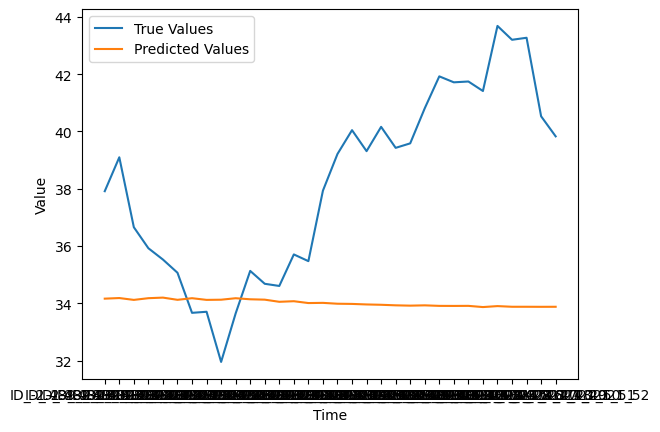

(49, 67)
2/2 [==============================] - 1s 5ms/step
LAT_LONG:  -2.662_30.138
Epoch 1/50
3/3 [==============================] - 2s 235ms/step - loss: 1222.6483 - mse: 1222.6483 - accuracy: 0.0000e+00 - val_loss: 1124.4211 - val_mse: 1124.4211 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 30ms/step - loss: 1210.9318 - mse: 1210.9318 - accuracy: 0.0000e+00 - val_loss: 1113.3843 - val_mse: 1113.3843 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 29ms/step - loss: 1199.5284 - mse: 1199.5284 - accuracy: 0.0000e+00 - val_loss: 1103.6030 - val_mse: 1103.6030 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 31ms/step - loss: 1189.8944 - mse: 1189.8944 - accuracy: 0.0000e+00 - val_loss: 1095.2238 - val_mse: 1095.2238 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 1181.5814 - mse: 1181.5814 - accuracy: 0.0000e+00 - val_loss: 1087.0227 - val_m

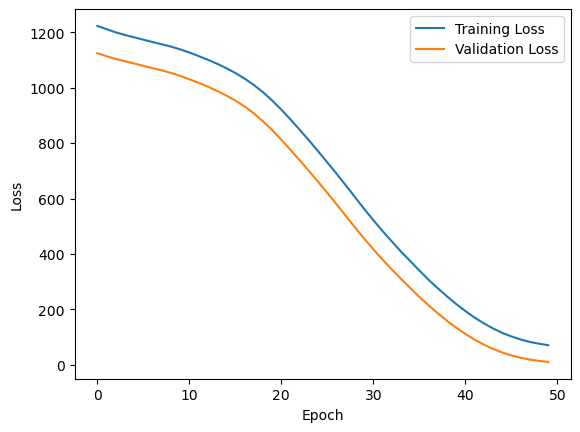

1/1 [==============================] - 0s 365ms/step


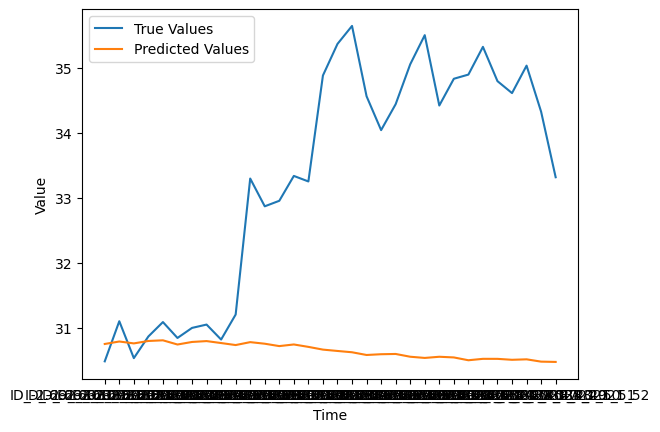

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.64_29.46
Epoch 1/50
3/3 [==============================] - 2s 287ms/step - loss: 18488.3320 - mse: 18488.3320 - accuracy: 0.0000e+00 - val_loss: 19130.8965 - val_mse: 19130.8965 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 26ms/step - loss: 18398.6660 - mse: 18398.6680 - accuracy: 0.0000e+00 - val_loss: 19043.9766 - val_mse: 19043.9766 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 45ms/step - loss: 18320.2090 - mse: 18320.2090 - accuracy: 0.0000e+00 - val_loss: 18968.9473 - val_mse: 18968.9473 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 56ms/step - loss: 18248.5645 - mse: 18248.5645 - accuracy: 0.0000e+00 - val_loss: 18898.0117 - val_mse: 18898.0117 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 18185.2422 - mse: 18185.2422 - accuracy: 0.0000e+00 - val_loss: 1

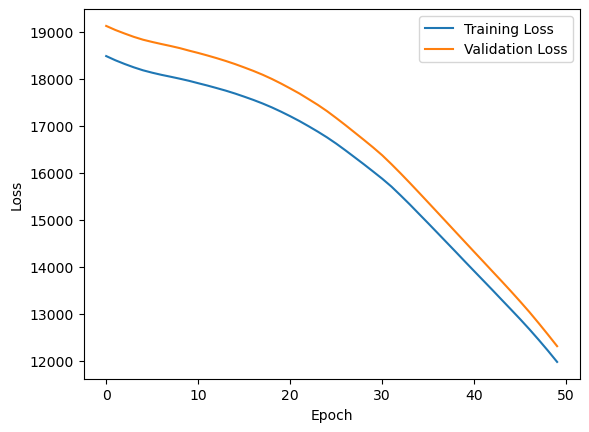

1/1 [==============================] - 0s 361ms/step


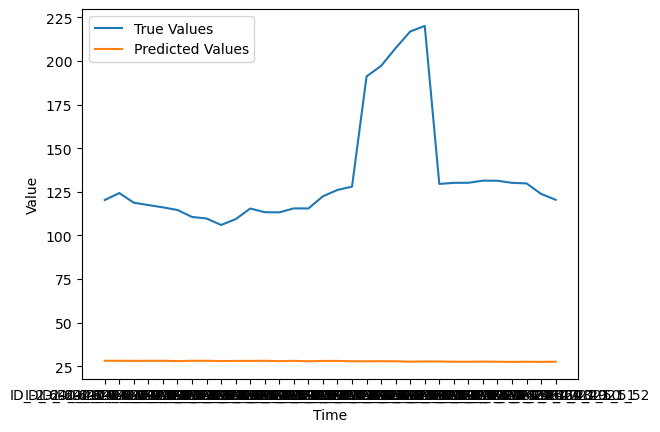

(49, 67)
2/2 [==============================] - 1s 15ms/step
LAT_LONG:  -0.964_29.636
Epoch 1/50
3/3 [==============================] - 3s 191ms/step - loss: 17011.8184 - mse: 17011.8184 - accuracy: 0.0000e+00 - val_loss: 18005.1602 - val_mse: 18005.1602 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 16971.9570 - mse: 16971.9590 - accuracy: 0.0000e+00 - val_loss: 17964.4277 - val_mse: 17964.4277 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 32ms/step - loss: 16931.0527 - mse: 16931.0527 - accuracy: 0.0000e+00 - val_loss: 17919.4258 - val_mse: 17919.4258 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 16885.2910 - mse: 16885.2910 - accuracy: 0.0000e+00 - val_loss: 17862.8145 - val_mse: 17862.8145 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 16826.7930 - mse: 16826.7930 - accuracy: 0.0000e+00 - val_loss

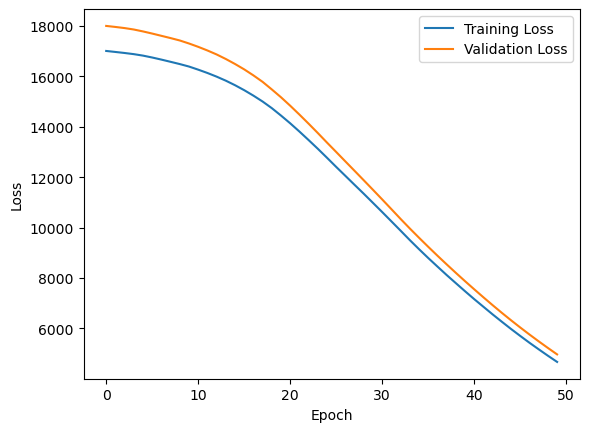

1/1 [==============================] - 0s 322ms/step


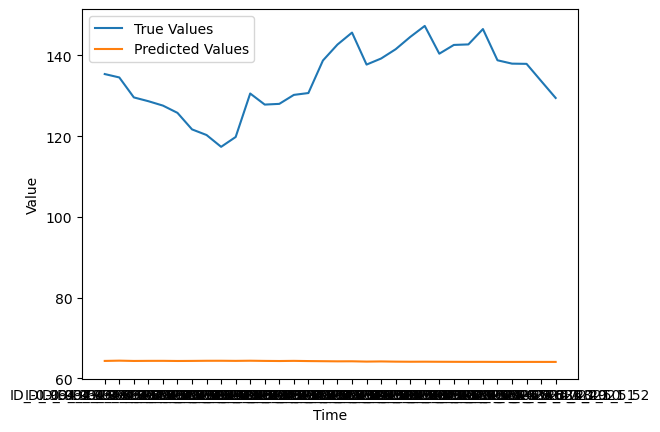

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.283_30.417
Epoch 1/50
3/3 [==============================] - 2s 248ms/step - loss: 0.0550 - mse: 0.0550 - accuracy: 0.0000e+00 - val_loss: 0.0099 - val_mse: 0.0099 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 0.0179 - mse: 0.0179 - accuracy: 0.0000e+00 - val_loss: 0.0214 - val_mse: 0.0214 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 0.0191 - mse: 0.0191 - accuracy: 0.0000e+00 - val_loss: 0.0114 - val_mse: 0.0114 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 0.0104 - mse: 0.0104 - accuracy: 0.0000e+00 - val_loss: 0.0123 - val_mse: 0.0123 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 0.0128 - mse: 0.0128 - accuracy: 0.0000e+00 - val_loss: 0.0133 - val_mse: 0.0133 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

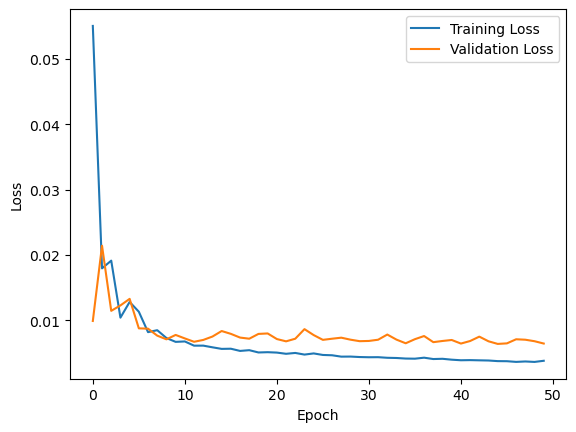

1/1 [==============================] - 0s 339ms/step


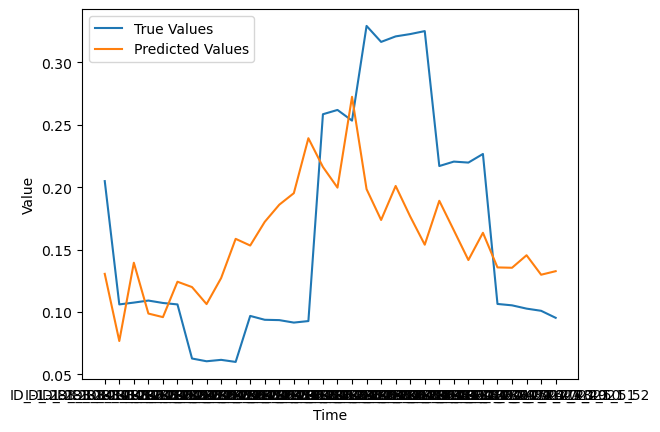

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.836_30.064
Epoch 1/50
3/3 [==============================] - 2s 210ms/step - loss: 1990.1703 - mse: 1990.1703 - accuracy: 0.0000e+00 - val_loss: 1915.6967 - val_mse: 1915.6967 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 26ms/step - loss: 1965.6259 - mse: 1965.6259 - accuracy: 0.0000e+00 - val_loss: 1892.7278 - val_mse: 1892.7278 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 1942.2990 - mse: 1942.2990 - accuracy: 0.0000e+00 - val_loss: 1869.2891 - val_mse: 1869.2891 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 1918.8809 - mse: 1918.8809 - accuracy: 0.0000e+00 - val_loss: 1846.1851 - val_mse: 1846.1851 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 1896.3888 - mse: 1896.3888 - accuracy: 0.0000e+00 - val_loss: 1823.7085 - val_m

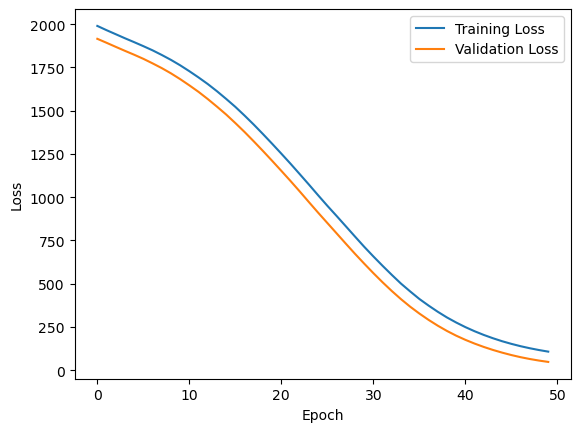

1/1 [==============================] - 0s 317ms/step


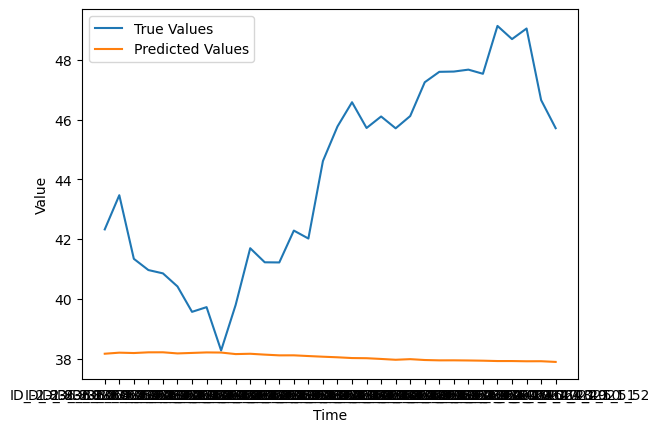

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.257_30.243
Epoch 1/50
3/3 [==============================] - 2s 187ms/step - loss: 11428.7461 - mse: 11428.7461 - accuracy: 0.0000e+00 - val_loss: 11702.9844 - val_mse: 11702.9844 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 11372.4229 - mse: 11372.4229 - accuracy: 0.0000e+00 - val_loss: 11655.1953 - val_mse: 11655.1953 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 11322.8135 - mse: 11322.8135 - accuracy: 0.0000e+00 - val_loss: 11599.6113 - val_mse: 11599.6113 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 11270.6465 - mse: 11270.6465 - accuracy: 0.0000e+00 - val_loss: 11549.4365 - val_mse: 11549.4365 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 11223.7471 - mse: 11223.7471 - accuracy: 0.0000e+00 - val_loss:

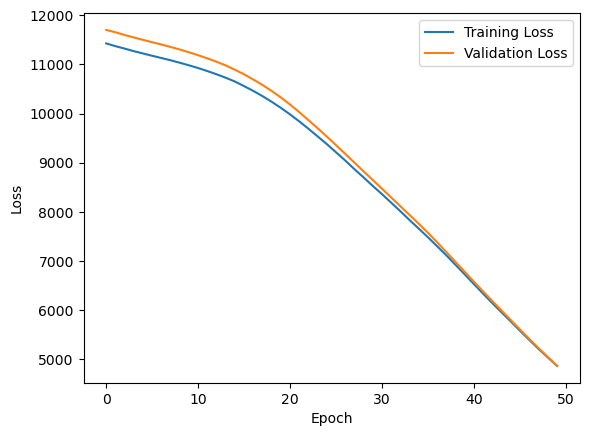

1/1 [==============================] - 0s 321ms/step


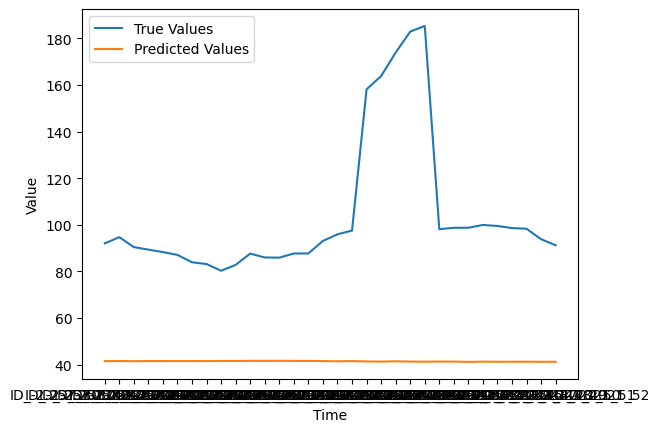

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.505_30.995
Epoch 1/50
3/3 [==============================] - 2s 255ms/step - loss: 0.0468 - mse: 0.0468 - accuracy: 1.0000 - val_loss: 0.0023 - val_mse: 0.0023 - val_accuracy: 1.0000
Epoch 2/50
3/3 [==============================] - 0s 30ms/step - loss: 0.0019 - mse: 0.0019 - accuracy: 1.0000 - val_loss: 0.0063 - val_mse: 0.0063 - val_accuracy: 1.0000
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 0.0067 - mse: 0.0067 - accuracy: 1.0000 - val_loss: 0.0075 - val_mse: 0.0075 - val_accuracy: 1.0000
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 0.0054 - mse: 0.0054 - accuracy: 1.0000 - val_loss: 0.0027 - val_mse: 0.0027 - val_accuracy: 1.0000
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 0.0013 - mse: 0.0013 - accuracy: 1.0000 - val_loss: 3.9626e-04 - val_mse: 3.9626e-04 - val_accuracy: 1.0000
Epoch 6/50
3/3 [==============================] - 0

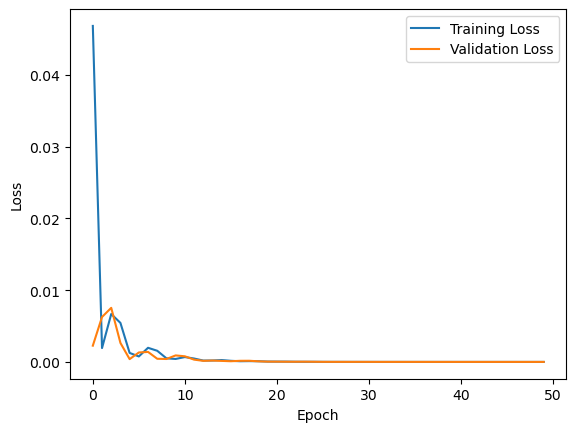

1/1 [==============================] - 0s 317ms/step


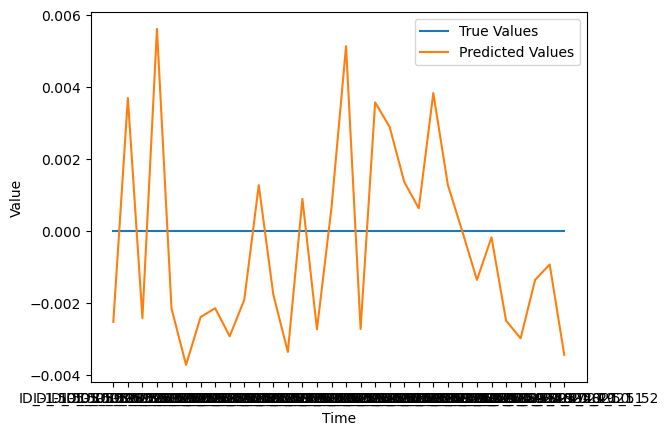

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -0.799_29.201
Epoch 1/50
3/3 [==============================] - 2s 202ms/step - loss: 358.1313 - mse: 358.1313 - accuracy: 0.0000e+00 - val_loss: 384.6492 - val_mse: 384.6492 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 26ms/step - loss: 348.7389 - mse: 348.7389 - accuracy: 0.0000e+00 - val_loss: 374.9804 - val_mse: 374.9804 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 339.5016 - mse: 339.5016 - accuracy: 0.0000e+00 - val_loss: 365.4565 - val_mse: 365.4565 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 330.4407 - mse: 330.4407 - accuracy: 0.0000e+00 - val_loss: 355.8461 - val_mse: 355.8461 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 321.2598 - mse: 321.2598 - accuracy: 0.0000e+00 - val_loss: 346.2984 - val_mse: 346.2984 - val_

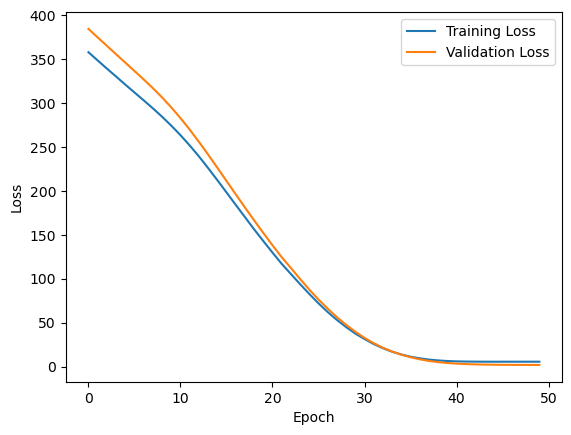

1/1 [==============================] - 0s 326ms/step


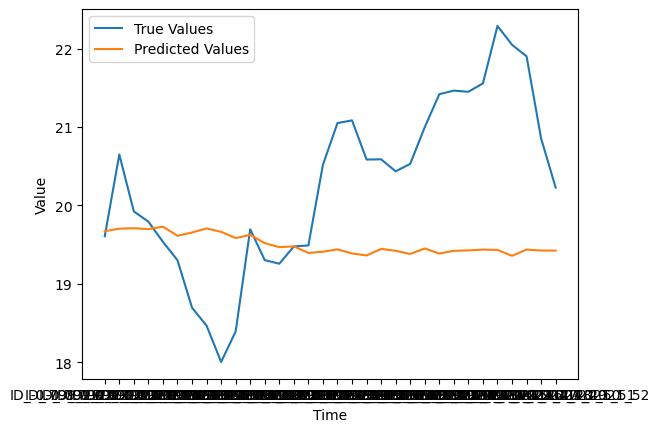

(49, 67)
2/2 [==============================] - 0s 9ms/step
LAT_LONG:  -1.085_29.215
Epoch 1/50
3/3 [==============================] - 2s 205ms/step - loss: 45.5534 - mse: 45.5534 - accuracy: 0.0000e+00 - val_loss: 44.5782 - val_mse: 44.5782 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 40.8709 - mse: 40.8709 - accuracy: 0.0000e+00 - val_loss: 40.2496 - val_mse: 40.2496 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 36.7575 - mse: 36.7575 - accuracy: 0.0000e+00 - val_loss: 36.3862 - val_mse: 36.3862 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 33.1459 - mse: 33.1459 - accuracy: 0.0000e+00 - val_loss: 32.9377 - val_mse: 32.9377 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 29.8738 - mse: 29.8738 - accuracy: 0.0000e+00 - val_loss: 29.4725 - val_mse: 29.4725 - val_accuracy: 0.0000e+00

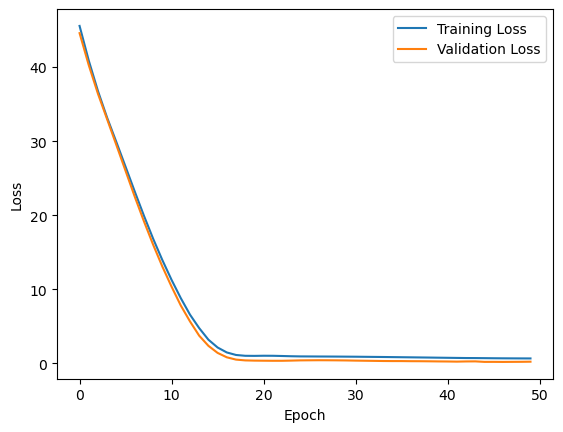

1/1 [==============================] - 0s 340ms/step


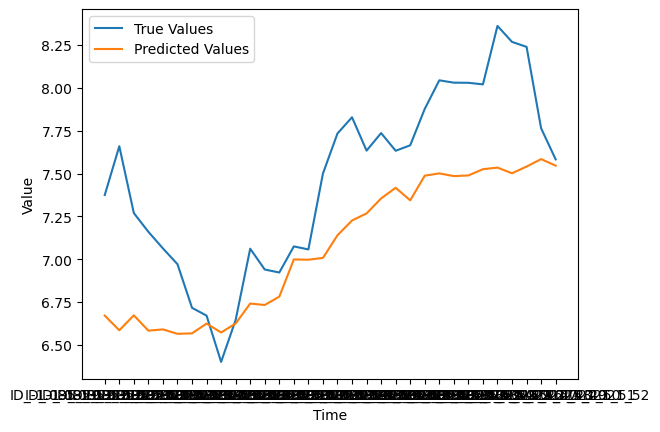

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -2.77_28.93
Epoch 1/50
3/3 [==============================] - 2s 202ms/step - loss: 1776.5094 - mse: 1776.5094 - accuracy: 0.0000e+00 - val_loss: 1821.7367 - val_mse: 1821.7367 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 26ms/step - loss: 1749.9625 - mse: 1749.9625 - accuracy: 0.0000e+00 - val_loss: 1795.1167 - val_mse: 1795.1167 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 1723.1304 - mse: 1723.1304 - accuracy: 0.0000e+00 - val_loss: 1768.4766 - val_mse: 1768.4766 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 31ms/step - loss: 1697.0758 - mse: 1697.0758 - accuracy: 0.0000e+00 - val_loss: 1741.7712 - val_mse: 1741.7712 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 1670.8453 - mse: 1670.8453 - accuracy: 0.0000e+00 - val_loss: 1714.8568 - val_mse

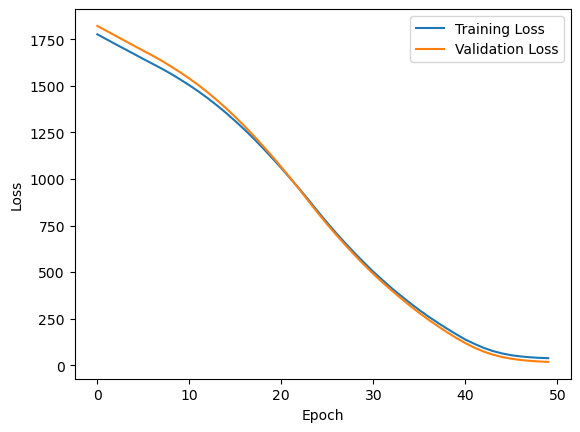

1/1 [==============================] - 0s 306ms/step


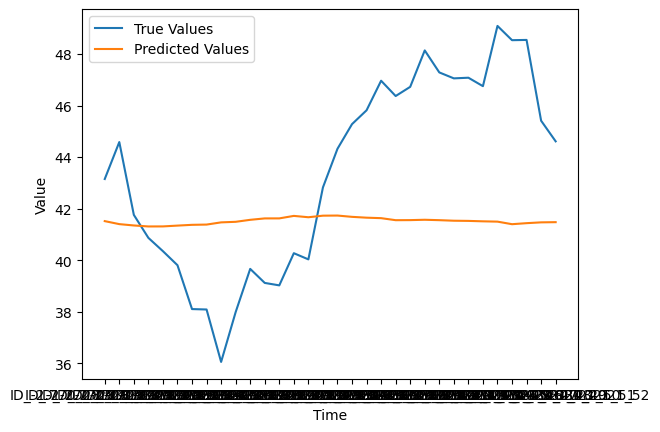

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -3.153_30.347
Epoch 1/50
3/3 [==============================] - 2s 447ms/step - loss: 192.4976 - mse: 192.4976 - accuracy: 0.0000e+00 - val_loss: 181.0655 - val_mse: 181.0655 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 184.4992 - mse: 184.4992 - accuracy: 0.0000e+00 - val_loss: 173.6186 - val_mse: 173.6186 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 29ms/step - loss: 177.5160 - mse: 177.5160 - accuracy: 0.0000e+00 - val_loss: 167.0908 - val_mse: 167.0908 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 170.9619 - mse: 170.9619 - accuracy: 0.0000e+00 - val_loss: 160.4854 - val_mse: 160.4854 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 164.3185 - mse: 164.3185 - accuracy: 0.0000e+00 - val_loss: 153.8237 - val_mse: 153.8237 - val_

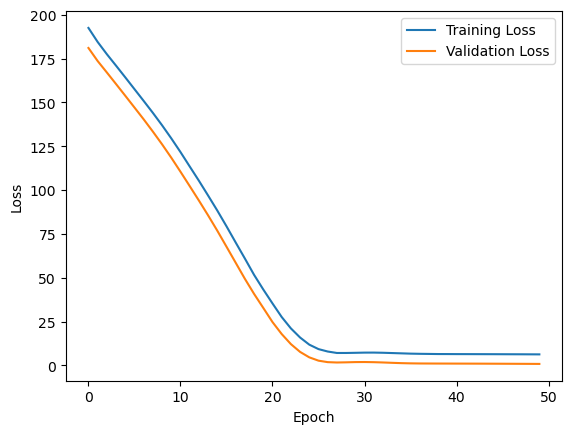

1/1 [==============================] - 0s 330ms/step


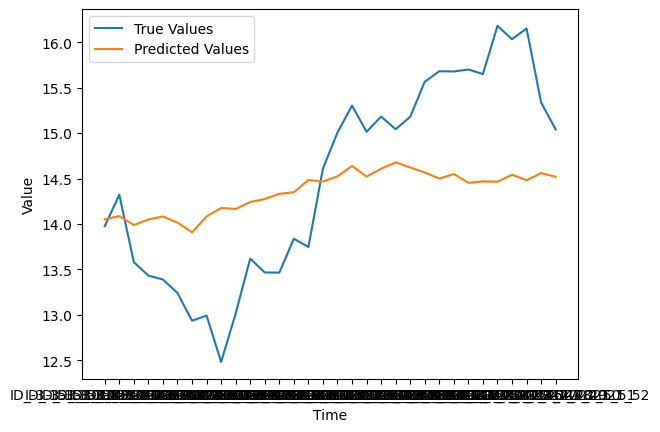

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.922_29.178
Epoch 1/50
3/3 [==============================] - 2s 295ms/step - loss: 998.8423 - mse: 998.8423 - accuracy: 0.0000e+00 - val_loss: 945.6575 - val_mse: 945.6575 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 51ms/step - loss: 985.0985 - mse: 985.0985 - accuracy: 0.0000e+00 - val_loss: 932.0291 - val_mse: 932.0291 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 71ms/step - loss: 971.7059 - mse: 971.7059 - accuracy: 0.0000e+00 - val_loss: 919.0538 - val_mse: 919.0538 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 62ms/step - loss: 958.6109 - mse: 958.6109 - accuracy: 0.0000e+00 - val_loss: 906.0396 - val_mse: 906.0396 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 51ms/step - loss: 945.5028 - mse: 945.5028 - accuracy: 0.0000e+00 - val_loss: 893.0474 - val_mse: 893.0474 - val_

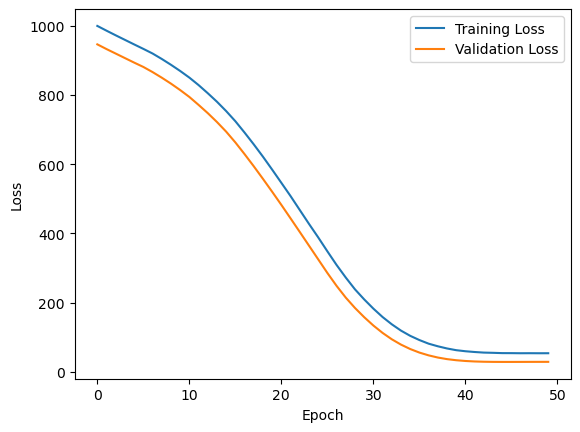

1/1 [==============================] - 1s 555ms/step


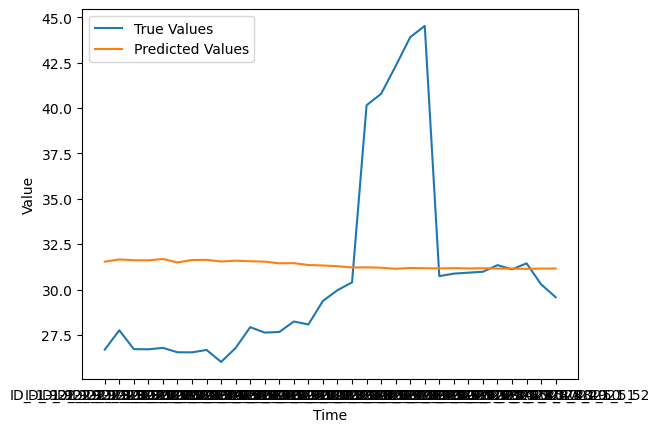

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -3.023_30.177
Epoch 1/50
3/3 [==============================] - 4s 669ms/step - loss: 3390.0046 - mse: 3390.0046 - accuracy: 0.0000e+00 - val_loss: 3301.0530 - val_mse: 3301.0530 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 35ms/step - loss: 3348.1775 - mse: 3348.1775 - accuracy: 0.0000e+00 - val_loss: 3261.7219 - val_mse: 3261.7219 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 58ms/step - loss: 3309.3032 - mse: 3309.3032 - accuracy: 0.0000e+00 - val_loss: 3224.2368 - val_mse: 3224.2368 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 38ms/step - loss: 3273.4563 - mse: 3273.4563 - accuracy: 0.0000e+00 - val_loss: 3191.9517 - val_mse: 3191.9517 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 32ms/step - loss: 3243.4529 - mse: 3243.4529 - accuracy: 0.0000e+00 - val_loss: 3162.1367 - val_m

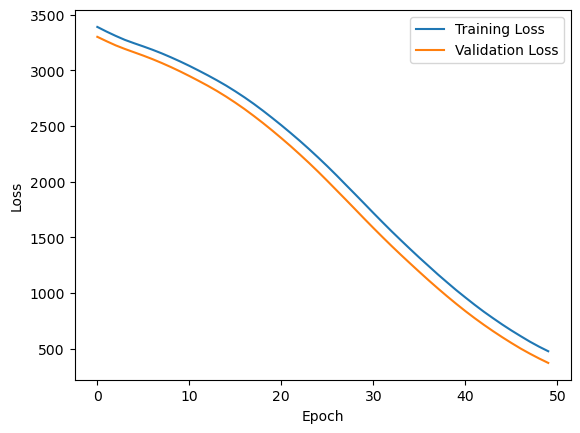

1/1 [==============================] - 0s 339ms/step


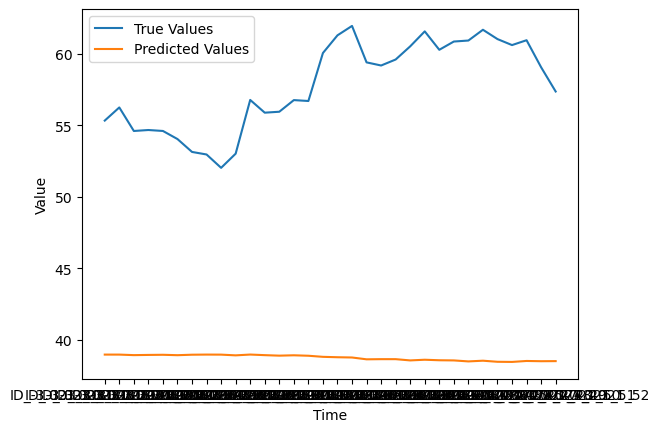

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.581_30.819
Epoch 1/50
3/3 [==============================] - 2s 189ms/step - loss: 13729.6836 - mse: 13729.6836 - accuracy: 0.0000e+00 - val_loss: 14582.5234 - val_mse: 14582.5234 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 13637.2568 - mse: 13637.2568 - accuracy: 0.0000e+00 - val_loss: 14488.5176 - val_mse: 14488.5176 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 13549.2949 - mse: 13549.2949 - accuracy: 0.0000e+00 - val_loss: 14401.2617 - val_mse: 14401.2617 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 13467.2246 - mse: 13467.2246 - accuracy: 0.0000e+00 - val_loss: 14318.7686 - val_mse: 14318.7686 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 13388.1846 - mse: 13388.1846 - accuracy: 0.0000e+00 - val_loss:

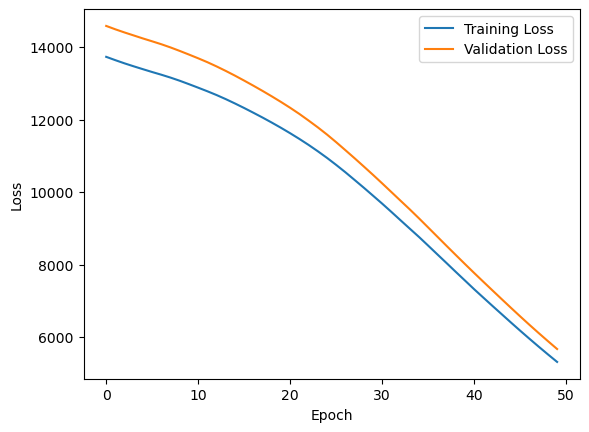

1/1 [==============================] - 0s 340ms/step


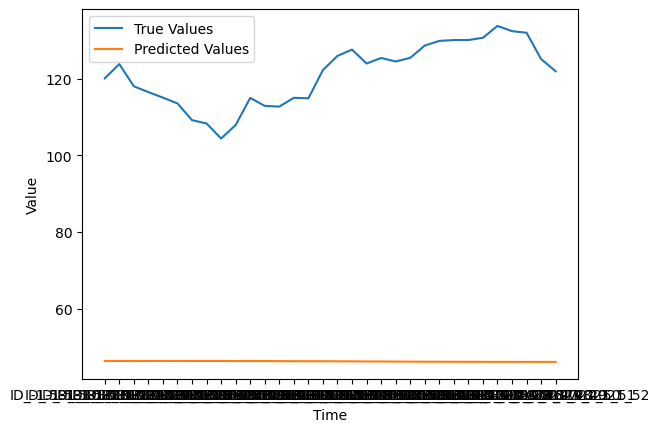

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.926_28.474
Epoch 1/50
3/3 [==============================] - 2s 274ms/step - loss: 1.1614 - mse: 1.1614 - accuracy: 0.0000e+00 - val_loss: 0.4304 - val_mse: 0.4304 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 35ms/step - loss: 0.6505 - mse: 0.6505 - accuracy: 0.0000e+00 - val_loss: 0.1340 - val_mse: 0.1340 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 34ms/step - loss: 0.3809 - mse: 0.3809 - accuracy: 0.0000e+00 - val_loss: 0.0191 - val_mse: 0.0191 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 31ms/step - loss: 0.2906 - mse: 0.2906 - accuracy: 0.0000e+00 - val_loss: 0.0290 - val_mse: 0.0290 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 0.2831 - mse: 0.2831 - accuracy: 0.0000e+00 - val_loss: 0.0764 - val_mse: 0.0764 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

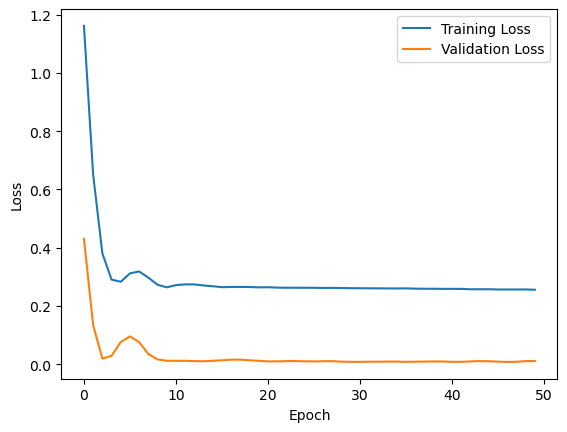

1/1 [==============================] - 0s 386ms/step


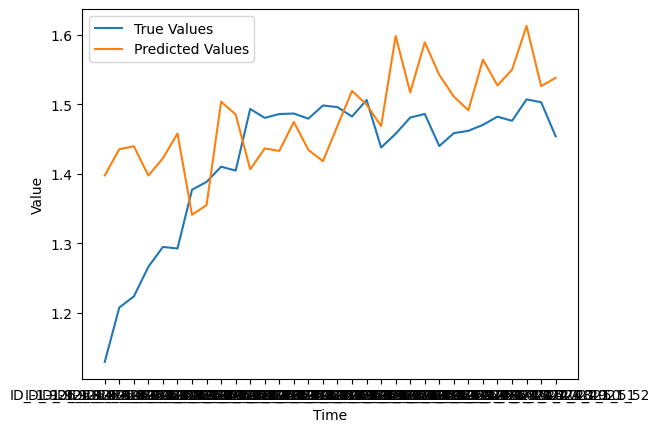

(49, 67)
2/2 [==============================] - 1s 6ms/step
LAT_LONG:  -1.176_31.324
Epoch 1/50
3/3 [==============================] - 3s 261ms/step - loss: 495.6633 - mse: 495.6633 - accuracy: 0.0000e+00 - val_loss: 510.2940 - val_mse: 510.2940 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 485.2102 - mse: 485.2102 - accuracy: 0.0000e+00 - val_loss: 499.7847 - val_mse: 499.7847 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 35ms/step - loss: 475.3549 - mse: 475.3549 - accuracy: 0.0000e+00 - val_loss: 489.7567 - val_mse: 489.7567 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 52ms/step - loss: 465.5732 - mse: 465.5732 - accuracy: 0.0000e+00 - val_loss: 479.6691 - val_mse: 479.6691 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 39ms/step - loss: 455.7669 - mse: 455.7669 - accuracy: 0.0000e+00 - val_loss: 469.8497 - val_mse: 469.8497 - val_

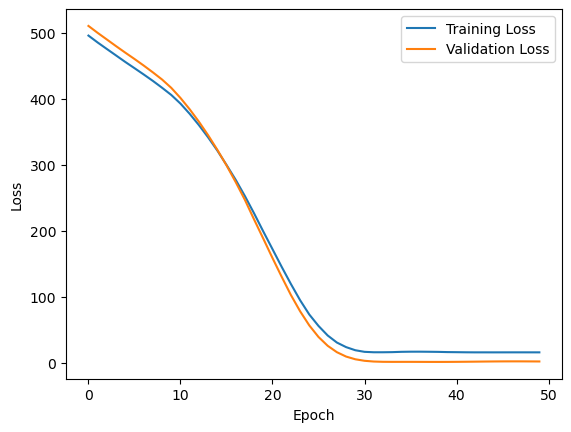

1/1 [==============================] - 1s 520ms/step


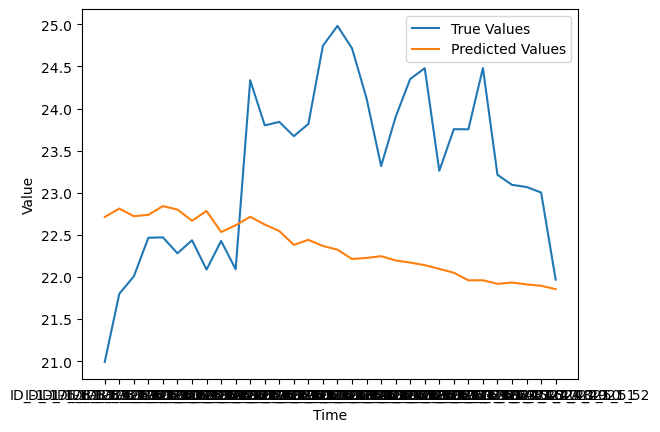

(49, 67)
2/2 [==============================] - 2s 10ms/step
LAT_LONG:  -2.441_28.959
Epoch 1/50
3/3 [==============================] - 3s 383ms/step - loss: 158537.0469 - mse: 158537.0469 - accuracy: 0.0000e+00 - val_loss: 170280.0625 - val_mse: 170280.0625 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 32ms/step - loss: 158313.7500 - mse: 158313.7500 - accuracy: 0.0000e+00 - val_loss: 170053.3125 - val_mse: 170053.3125 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 33ms/step - loss: 158098.7812 - mse: 158098.7812 - accuracy: 0.0000e+00 - val_loss: 169839.0000 - val_mse: 169839.0000 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 39ms/step - loss: 157889.8594 - mse: 157889.8594 - accuracy: 0.0000e+00 - val_loss: 169625.8906 - val_mse: 169625.8906 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 38ms/step - loss: 157689.5000 - mse: 157689.4844 - accuracy: 0.0

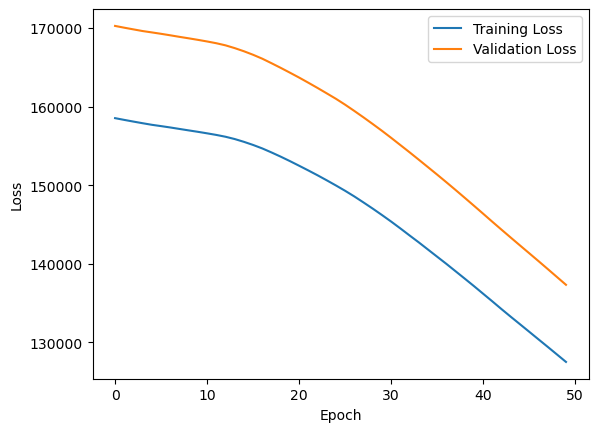

1/1 [==============================] - 0s 421ms/step


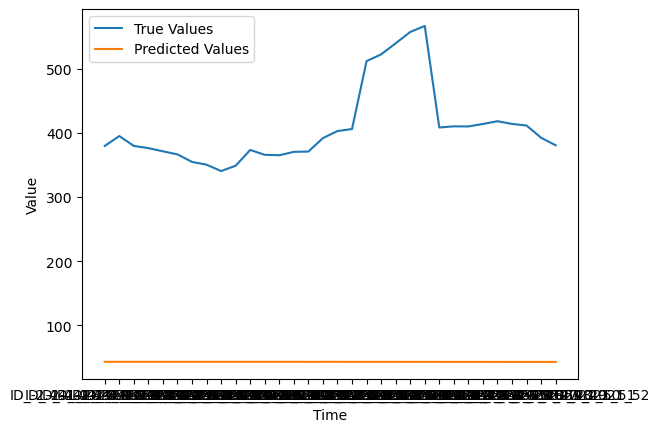

(49, 67)
2/2 [==============================] - 1s 5ms/step
LAT_LONG:  -1.416_31.284
Epoch 1/50
3/3 [==============================] - 3s 411ms/step - loss: 7593.8433 - mse: 7593.8433 - accuracy: 0.0000e+00 - val_loss: 7789.1533 - val_mse: 7789.1533 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 37ms/step - loss: 7551.6611 - mse: 7551.6611 - accuracy: 0.0000e+00 - val_loss: 7748.4707 - val_mse: 7748.4707 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 37ms/step - loss: 7513.7397 - mse: 7513.7397 - accuracy: 0.0000e+00 - val_loss: 7712.9541 - val_mse: 7712.9541 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 39ms/step - loss: 7479.2588 - mse: 7479.2588 - accuracy: 0.0000e+00 - val_loss: 7677.6602 - val_mse: 7677.6602 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 7443.3203 - mse: 7443.3203 - accuracy: 0.0000e+00 - val_loss: 7637.6211 - val_m

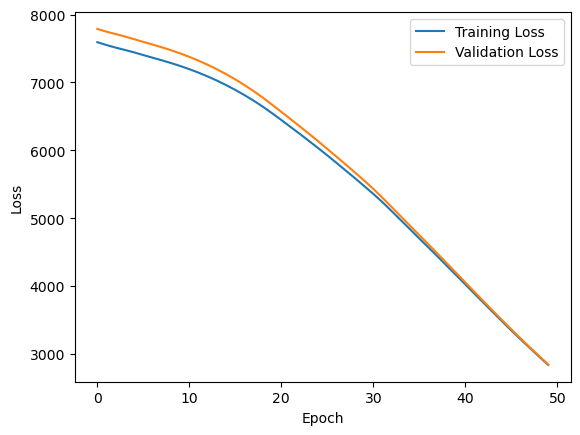

1/1 [==============================] - 0s 311ms/step


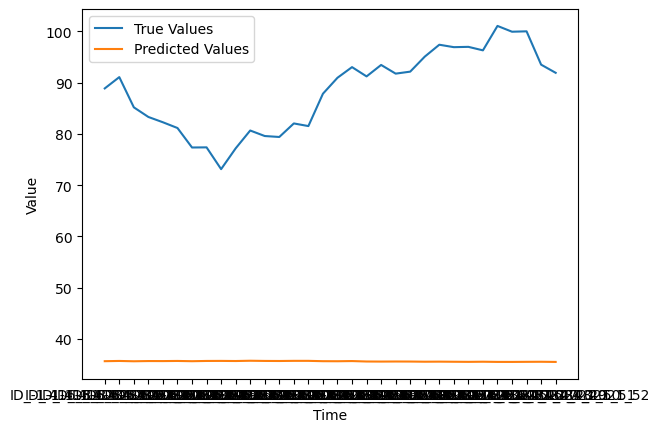

(49, 67)
2/2 [==============================] - 1s 7ms/step
LAT_LONG:  -2.015_30.985
Epoch 1/50
3/3 [==============================] - 2s 250ms/step - loss: 65318.3164 - mse: 65318.3164 - accuracy: 0.0000e+00 - val_loss: 66772.4219 - val_mse: 66772.4219 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 32ms/step - loss: 65166.5859 - mse: 65166.5859 - accuracy: 0.0000e+00 - val_loss: 66626.7969 - val_mse: 66626.7969 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 34ms/step - loss: 65025.7188 - mse: 65025.7188 - accuracy: 0.0000e+00 - val_loss: 66495.1953 - val_mse: 66495.1953 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 37ms/step - loss: 64903.2773 - mse: 64903.2773 - accuracy: 0.0000e+00 - val_loss: 66373.7969 - val_mse: 66373.7969 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 64782.9219 - mse: 64782.9219 - accuracy: 0.0000e+00 - val_loss:

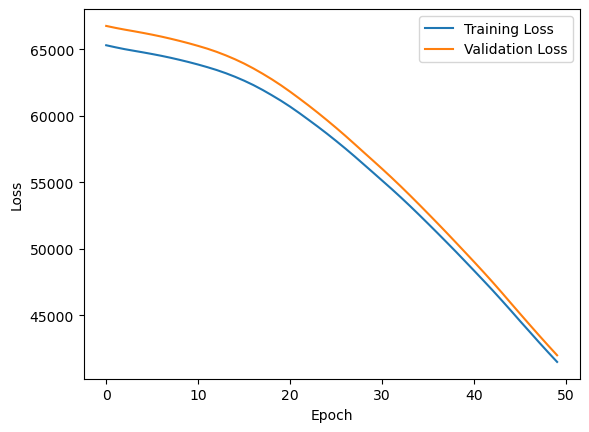

1/1 [==============================] - 0s 357ms/step


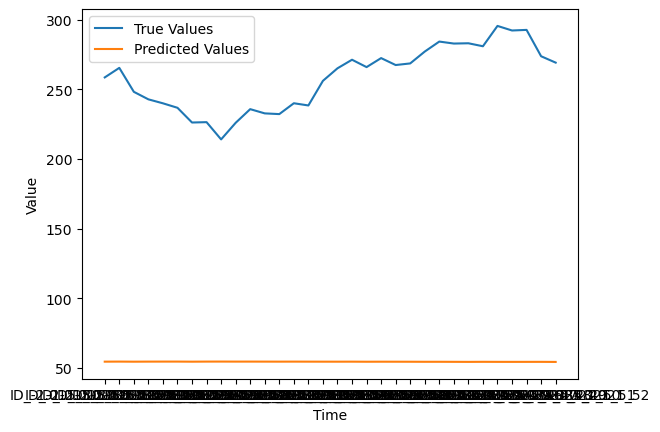

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.839_30.961
Epoch 1/50
3/3 [==============================] - 2s 210ms/step - loss: 2566.4158 - mse: 2566.4158 - accuracy: 0.0000e+00 - val_loss: 2811.7573 - val_mse: 2811.7573 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 30ms/step - loss: 2533.2117 - mse: 2533.2117 - accuracy: 0.0000e+00 - val_loss: 2777.0942 - val_mse: 2777.0942 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 2502.4519 - mse: 2502.4521 - accuracy: 0.0000e+00 - val_loss: 2749.1682 - val_mse: 2749.1682 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 32ms/step - loss: 2475.6201 - mse: 2475.6201 - accuracy: 0.0000e+00 - val_loss: 2721.3330 - val_mse: 2721.3330 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 2449.9854 - mse: 2449.9854 - accuracy: 0.0000e+00 - val_loss: 2697.0908 - val_m

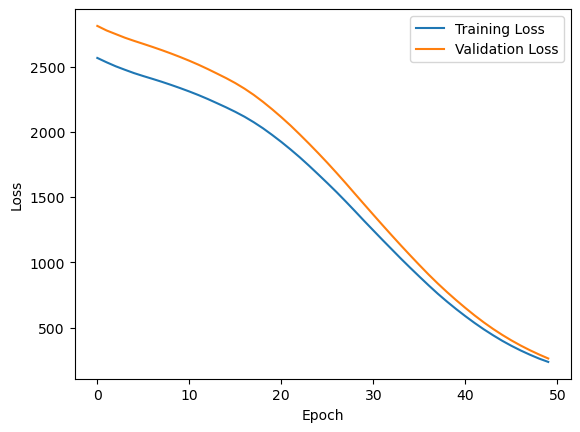

1/1 [==============================] - 0s 335ms/step


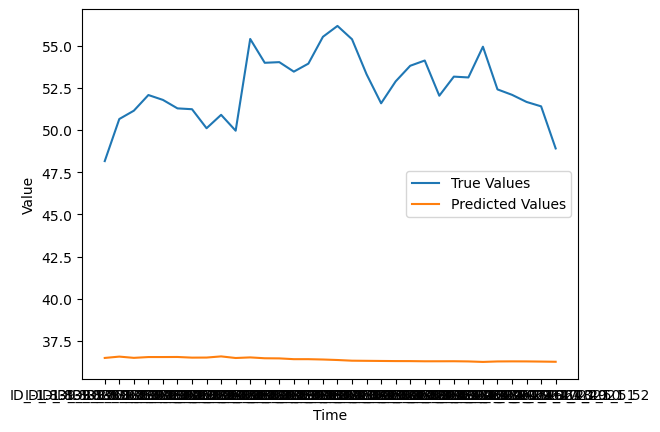

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.783_31.117
Epoch 1/50
3/3 [==============================] - 2s 197ms/step - loss: 1.5430 - mse: 1.5430 - accuracy: 0.0000e+00 - val_loss: 0.4810 - val_mse: 0.4810 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 1.0768 - mse: 1.0768 - accuracy: 0.0000e+00 - val_loss: 0.1999 - val_mse: 0.1999 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 0.7451 - mse: 0.7451 - accuracy: 0.0000e+00 - val_loss: 0.0599 - val_mse: 0.0599 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 0.5696 - mse: 0.5696 - accuracy: 0.0000e+00 - val_loss: 0.0314 - val_mse: 0.0314 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 0.4794 - mse: 0.4794 - accuracy: 0.0000e+00 - val_loss: 0.0798 - val_mse: 0.0798 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

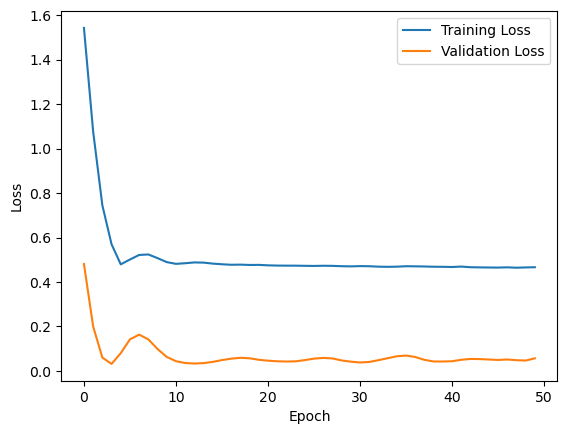

1/1 [==============================] - 0s 322ms/step


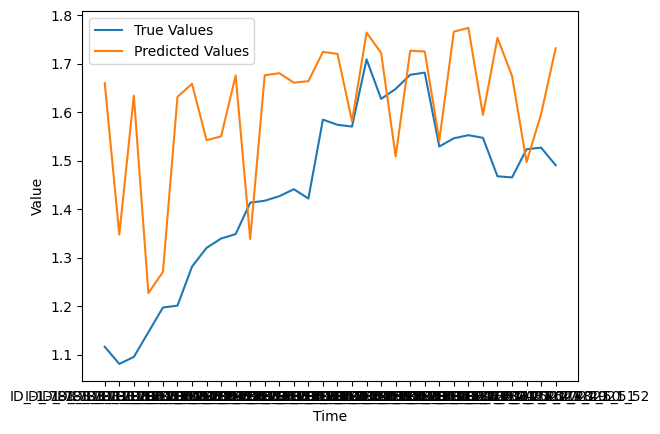

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.946_30.454
Epoch 1/50
3/3 [==============================] - 4s 229ms/step - loss: 529.8747 - mse: 529.8747 - accuracy: 0.0000e+00 - val_loss: 535.0568 - val_mse: 535.0568 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 520.7013 - mse: 520.7013 - accuracy: 0.0000e+00 - val_loss: 527.0696 - val_mse: 527.0696 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 513.0165 - mse: 513.0165 - accuracy: 0.0000e+00 - val_loss: 519.1680 - val_mse: 519.1680 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 505.0800 - mse: 505.0800 - accuracy: 0.0000e+00 - val_loss: 510.9117 - val_mse: 510.9117 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 496.9789 - mse: 496.9789 - accuracy: 0.0000e+00 - val_loss: 502.7358 - val_mse: 502.7358 - val_

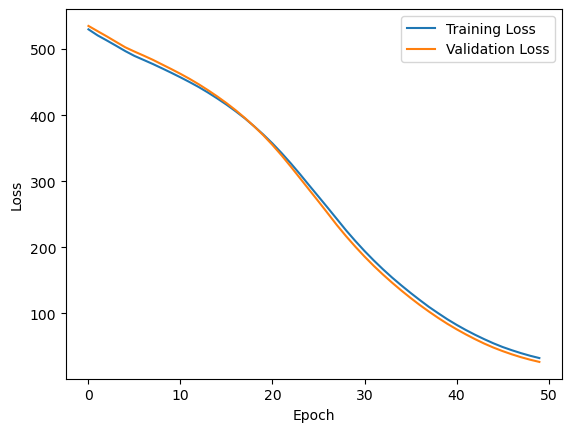

1/1 [==============================] - 1s 523ms/step


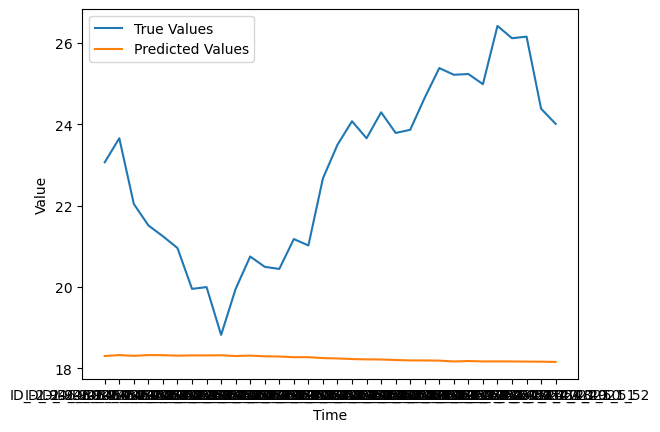

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.41_31.39
Epoch 1/50
3/3 [==============================] - 2s 227ms/step - loss: 13.7186 - mse: 13.7186 - accuracy: 0.0000e+00 - val_loss: 14.7087 - val_mse: 14.7087 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 11.9910 - mse: 11.9910 - accuracy: 0.0000e+00 - val_loss: 12.9904 - val_mse: 12.9904 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 10.5305 - mse: 10.5305 - accuracy: 0.0000e+00 - val_loss: 11.5657 - val_mse: 11.5657 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 9.2450 - mse: 9.2450 - accuracy: 0.0000e+00 - val_loss: 10.1995 - val_mse: 10.1995 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 8.0587 - mse: 8.0587 - accuracy: 0.0000e+00 - val_loss: 8.9922 - val_mse: 8.9922 - val_accuracy: 0.0000e+00
Epoch 6

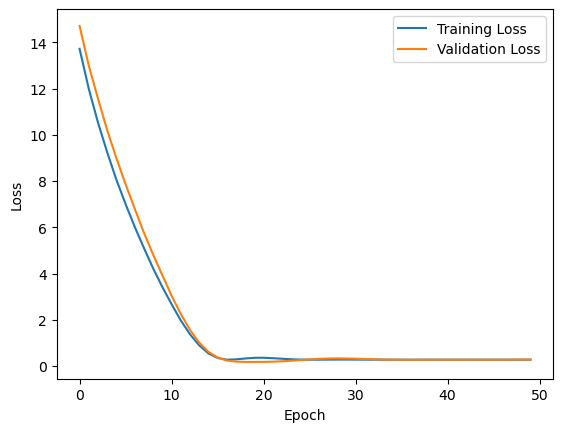

1/1 [==============================] - 0s 319ms/step


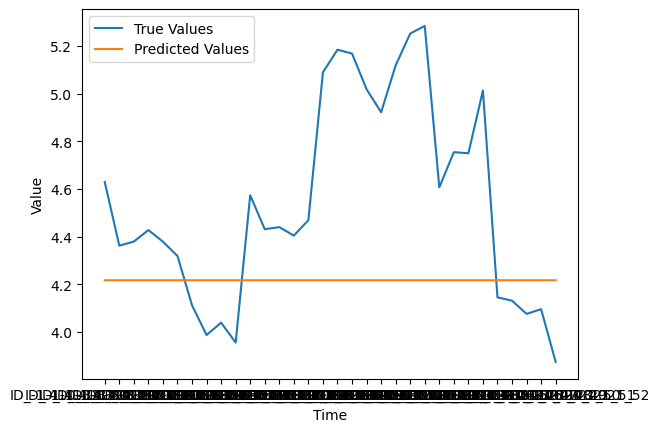

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.858_31.442
Epoch 1/50
3/3 [==============================] - 2s 224ms/step - loss: 6.8219 - mse: 6.8219 - accuracy: 0.0000e+00 - val_loss: 6.7844 - val_mse: 6.7844 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 5.2947 - mse: 5.2947 - accuracy: 0.0000e+00 - val_loss: 5.3727 - val_mse: 5.3727 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 4.1374 - mse: 4.1374 - accuracy: 0.0000e+00 - val_loss: 4.2350 - val_mse: 4.2350 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 3.2210 - mse: 3.2210 - accuracy: 0.0000e+00 - val_loss: 3.2739 - val_mse: 3.2739 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 2.3902 - mse: 2.3902 - accuracy: 0.0000e+00 - val_loss: 2.4125 - val_mse: 2.4125 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

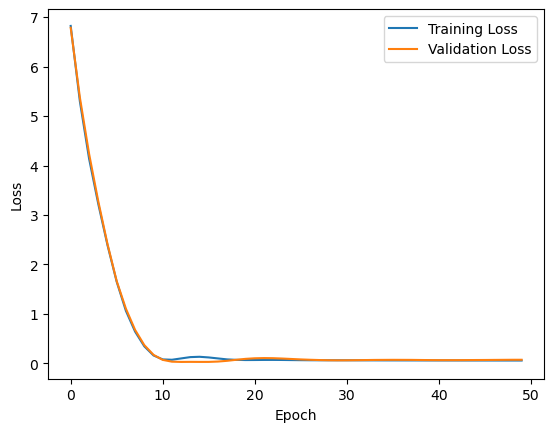

1/1 [==============================] - 0s 318ms/step


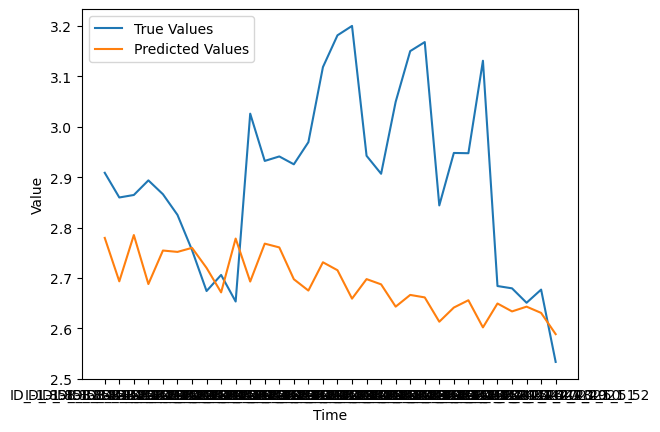

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.602_29.898
Epoch 1/50
3/3 [==============================] - 2s 282ms/step - loss: 16499.2559 - mse: 16499.2559 - accuracy: 0.0000e+00 - val_loss: 16895.8301 - val_mse: 16895.8301 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 16423.0234 - mse: 16423.0254 - accuracy: 0.0000e+00 - val_loss: 16825.7578 - val_mse: 16825.7578 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 32ms/step - loss: 16354.6494 - mse: 16354.6494 - accuracy: 0.0000e+00 - val_loss: 16753.3867 - val_mse: 16753.3867 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 16282.4268 - mse: 16282.4268 - accuracy: 0.0000e+00 - val_loss: 16681.1719 - val_mse: 16681.1719 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 16209.0410 - mse: 16209.0410 - accuracy: 0.0000e+00 - val_loss:

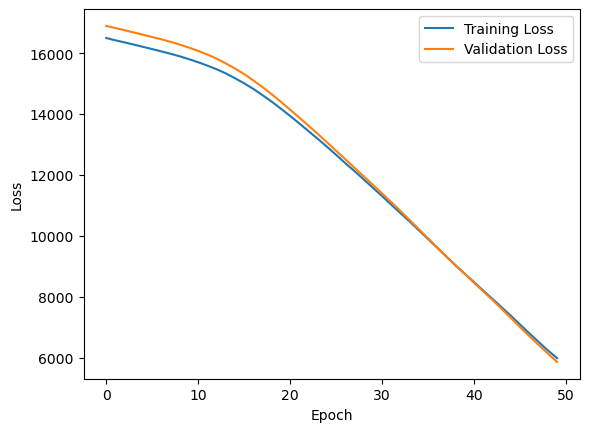

1/1 [==============================] - 0s 355ms/step


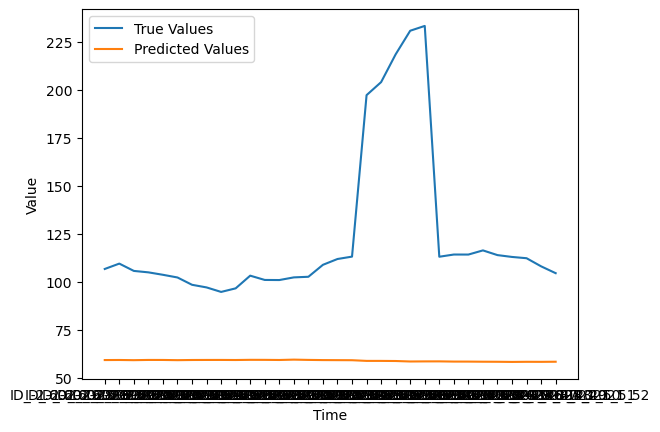

(49, 67)
2/2 [==============================] - 0s 10ms/step
LAT_LONG:  -1.225_30.975
Epoch 1/50
3/3 [==============================] - 2s 225ms/step - loss: 41984.0469 - mse: 41984.0469 - accuracy: 0.0000e+00 - val_loss: 43498.8750 - val_mse: 43498.8750 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 31ms/step - loss: 41867.4141 - mse: 41867.4141 - accuracy: 0.0000e+00 - val_loss: 43368.9688 - val_mse: 43368.9688 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 41741.4961 - mse: 41741.4961 - accuracy: 0.0000e+00 - val_loss: 43243.9609 - val_mse: 43243.9609 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 45ms/step - loss: 41620.2930 - mse: 41620.2930 - accuracy: 0.0000e+00 - val_loss: 43115.0430 - val_mse: 43115.0430 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 42ms/step - loss: 41496.1992 - mse: 41496.1953 - accuracy: 0.0000e+00 - val_loss

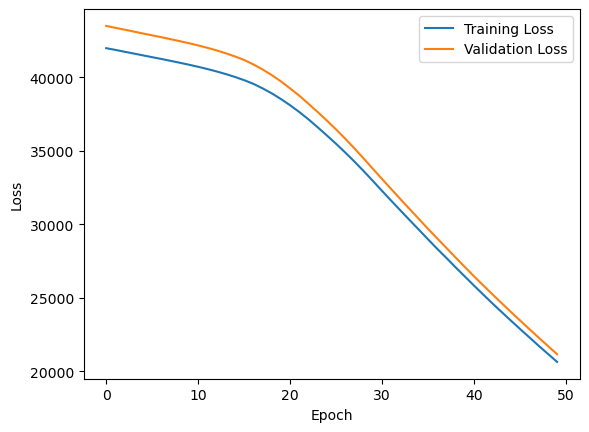

1/1 [==============================] - 0s 339ms/step


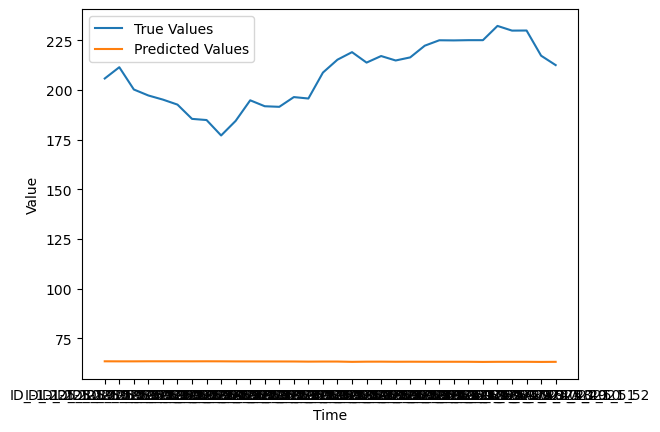

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.836_30.364
Epoch 1/50
3/3 [==============================] - 2s 247ms/step - loss: 1880.5267 - mse: 1880.5267 - accuracy: 0.0000e+00 - val_loss: 1984.9148 - val_mse: 1984.9148 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 30ms/step - loss: 1846.9310 - mse: 1846.9310 - accuracy: 0.0000e+00 - val_loss: 1952.9500 - val_mse: 1952.9500 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 1817.8109 - mse: 1817.8109 - accuracy: 0.0000e+00 - val_loss: 1927.2871 - val_mse: 1927.2871 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 1792.9481 - mse: 1792.9481 - accuracy: 0.0000e+00 - val_loss: 1902.0464 - val_mse: 1902.0464 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 1767.1887 - mse: 1767.1887 - accuracy: 0.0000e+00 - val_loss: 1873.5710 - val_m

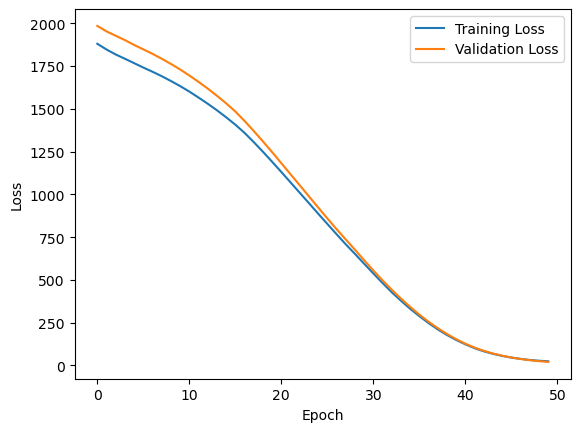

1/1 [==============================] - 0s 269ms/step


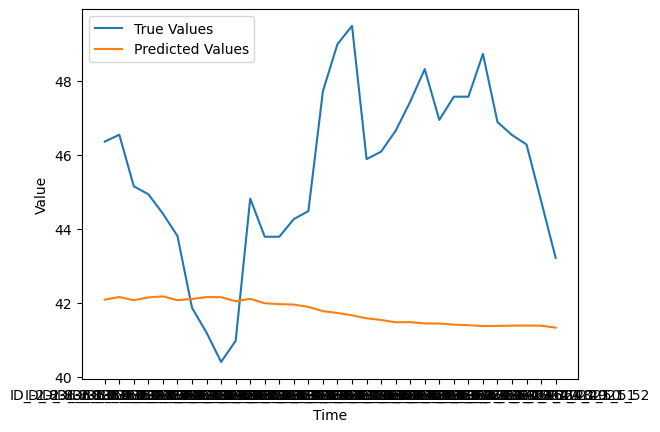

(49, 67)
2/2 [==============================] - 0s 9ms/step
LAT_LONG:  -1.043_29.057
Epoch 1/50
3/3 [==============================] - 3s 335ms/step - loss: 146.2064 - mse: 146.2064 - accuracy: 0.0000e+00 - val_loss: 142.4202 - val_mse: 142.4202 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 139.8525 - mse: 139.8525 - accuracy: 0.0000e+00 - val_loss: 136.5082 - val_mse: 136.5082 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 134.0860 - mse: 134.0860 - accuracy: 0.0000e+00 - val_loss: 131.1643 - val_mse: 131.1643 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 128.7413 - mse: 128.7413 - accuracy: 0.0000e+00 - val_loss: 125.7791 - val_mse: 125.7791 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 123.3431 - mse: 123.3431 - accuracy: 0.0000e+00 - val_loss: 120.4975 - val_mse: 120.4975 - val_

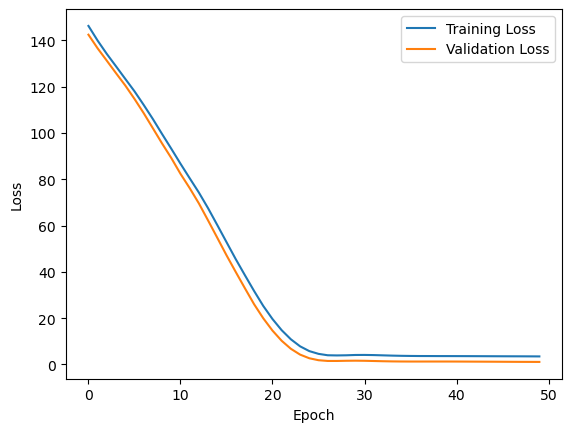

1/1 [==============================] - 0s 274ms/step


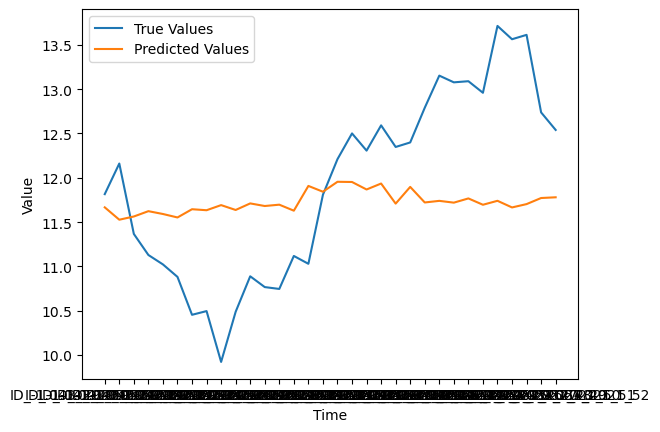

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.33_29.57
Epoch 1/50
3/3 [==============================] - 2s 245ms/step - loss: 29041.5020 - mse: 29041.5020 - accuracy: 0.0000e+00 - val_loss: 30169.1895 - val_mse: 30169.1895 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 26ms/step - loss: 28962.5938 - mse: 28962.5938 - accuracy: 0.0000e+00 - val_loss: 30089.2598 - val_mse: 30089.2598 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 28883.1855 - mse: 28883.1855 - accuracy: 0.0000e+00 - val_loss: 30012.5801 - val_mse: 30012.5801 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 28807.7676 - mse: 28807.7676 - accuracy: 0.0000e+00 - val_loss: 29946.3633 - val_mse: 29946.3633 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 28741.7305 - mse: 28741.7305 - accuracy: 0.0000e+00 - val_loss: 2

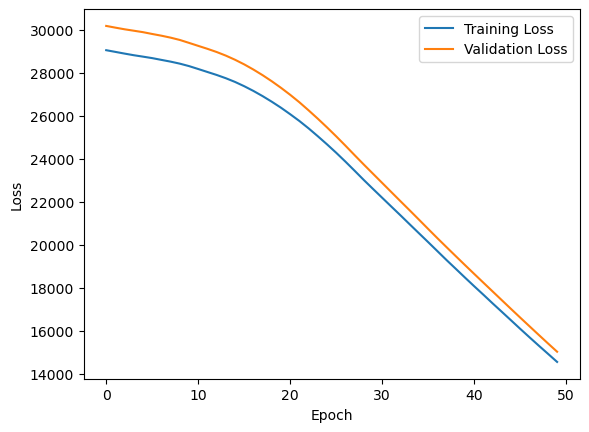

1/1 [==============================] - 0s 403ms/step


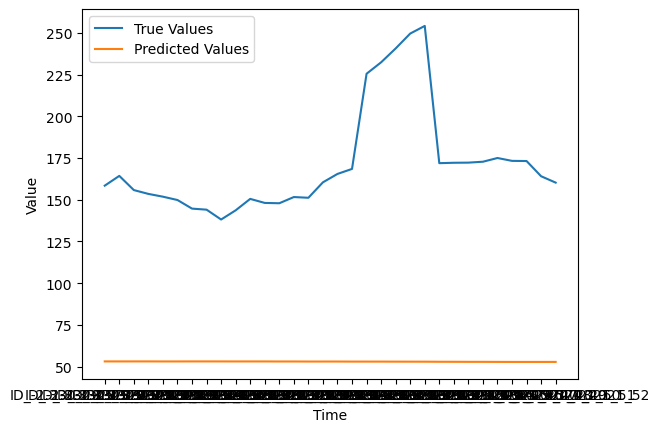

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -2.999_30.701
Epoch 1/50
3/3 [==============================] - 3s 224ms/step - loss: 694.3817 - mse: 694.3817 - accuracy: 0.0000e+00 - val_loss: 723.8832 - val_mse: 723.8832 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 41ms/step - loss: 678.5859 - mse: 678.5859 - accuracy: 0.0000e+00 - val_loss: 707.7219 - val_mse: 707.7219 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 33ms/step - loss: 663.0970 - mse: 663.0969 - accuracy: 0.0000e+00 - val_loss: 692.0480 - val_mse: 692.0480 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 31ms/step - loss: 648.2763 - mse: 648.2762 - accuracy: 0.0000e+00 - val_loss: 677.3663 - val_mse: 677.3663 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 634.7510 - mse: 634.7510 - accuracy: 0.0000e+00 - val_loss: 664.0275 - val_mse: 664.0275 - val_

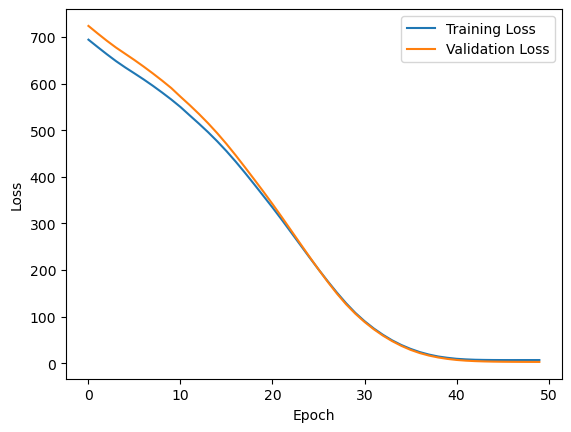

1/1 [==============================] - 0s 382ms/step


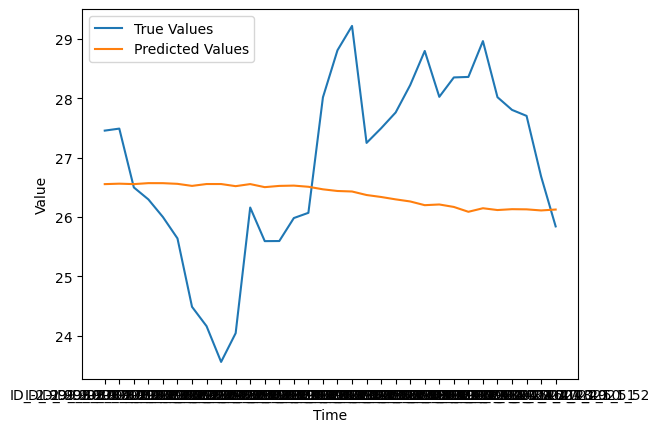

(49, 67)
2/2 [==============================] - 0s 12ms/step
LAT_LONG:  -2.883_29.017
Epoch 1/50
3/3 [==============================] - 2s 239ms/step - loss: 1018.5386 - mse: 1018.5386 - accuracy: 0.0000e+00 - val_loss: 1044.4817 - val_mse: 1044.4817 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 31ms/step - loss: 994.8346 - mse: 994.8346 - accuracy: 0.0000e+00 - val_loss: 1020.3088 - val_mse: 1020.3088 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 33ms/step - loss: 971.0110 - mse: 971.0110 - accuracy: 0.0000e+00 - val_loss: 996.8511 - val_mse: 996.8511 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 948.4691 - mse: 948.4691 - accuracy: 0.0000e+00 - val_loss: 974.1130 - val_mse: 974.1130 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 926.3984 - mse: 926.3984 - accuracy: 0.0000e+00 - val_loss: 951.2769 - val_mse: 951.2769

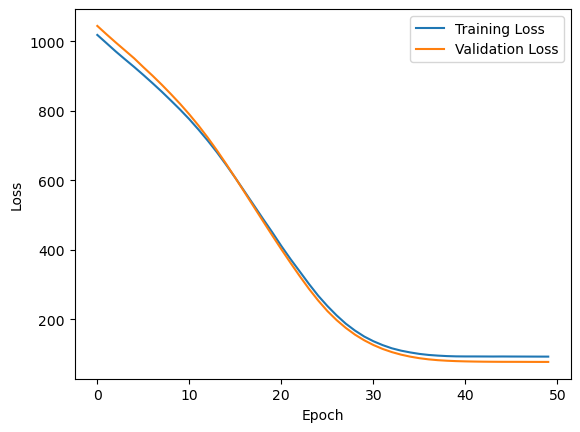

1/1 [==============================] - 0s 424ms/step


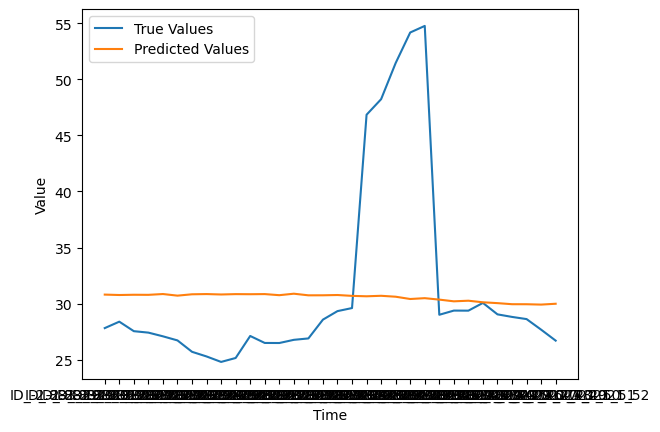

(49, 67)
2/2 [==============================] - 1s 14ms/step
LAT_LONG:  -1.289_28.911
Epoch 1/50
3/3 [==============================] - 2s 202ms/step - loss: 632.7266 - mse: 632.7266 - accuracy: 0.0000e+00 - val_loss: 650.9319 - val_mse: 650.9319 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 617.2405 - mse: 617.2405 - accuracy: 0.0000e+00 - val_loss: 636.0410 - val_mse: 636.0410 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 602.8028 - mse: 602.8028 - accuracy: 0.0000e+00 - val_loss: 620.8262 - val_mse: 620.8262 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 60ms/step - loss: 587.9758 - mse: 587.9758 - accuracy: 0.0000e+00 - val_loss: 605.7300 - val_mse: 605.7300 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 38ms/step - loss: 573.3361 - mse: 573.3361 - accuracy: 0.0000e+00 - val_loss: 591.2403 - val_mse: 591.2403 - val

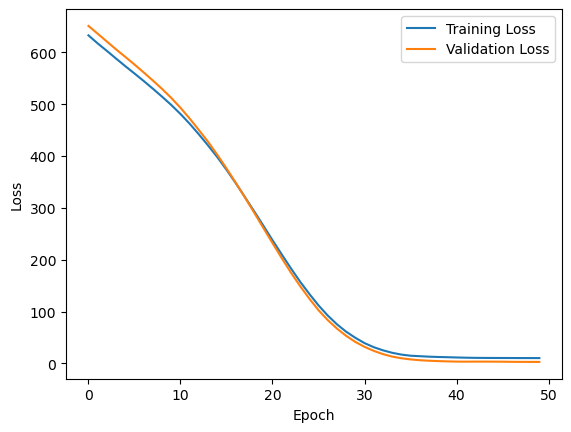

1/1 [==============================] - 0s 344ms/step


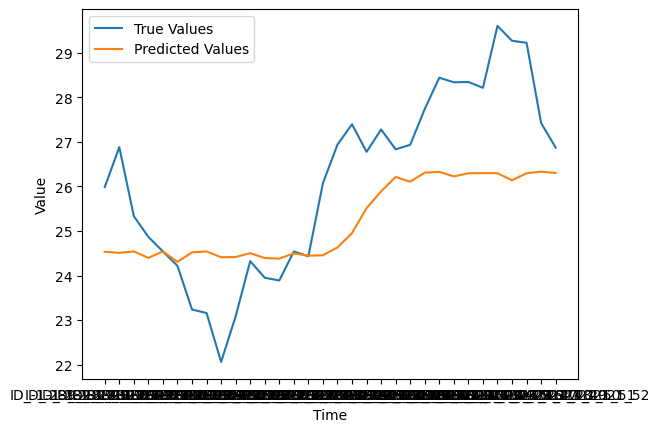

(49, 67)
2/2 [==============================] - 1s 15ms/step
LAT_LONG:  -1.938_31.362
Epoch 1/50
3/3 [==============================] - 4s 232ms/step - loss: 0.0107 - mse: 0.0107 - accuracy: 0.0000e+00 - val_loss: 0.0052 - val_mse: 0.0052 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 0.0076 - mse: 0.0076 - accuracy: 0.0000e+00 - val_loss: 0.0032 - val_mse: 0.0032 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 0.0063 - mse: 0.0063 - accuracy: 0.0000e+00 - val_loss: 0.0042 - val_mse: 0.0042 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 31ms/step - loss: 0.0046 - mse: 0.0046 - accuracy: 0.0000e+00 - val_loss: 0.0038 - val_mse: 0.0038 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 34ms/step - loss: 0.0051 - mse: 0.0051 - accuracy: 0.0000e+00 - val_loss: 0.0037 - val_mse: 0.0037 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [==

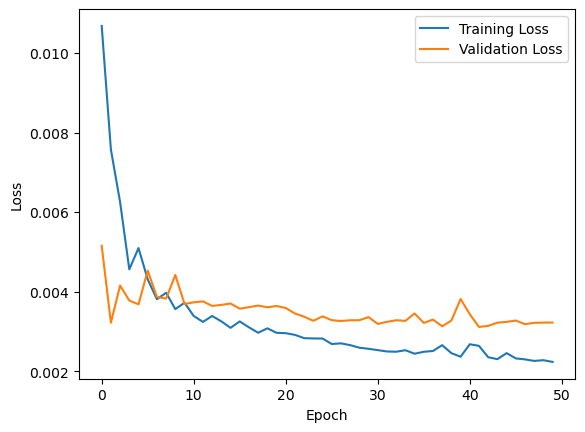

1/1 [==============================] - 0s 322ms/step


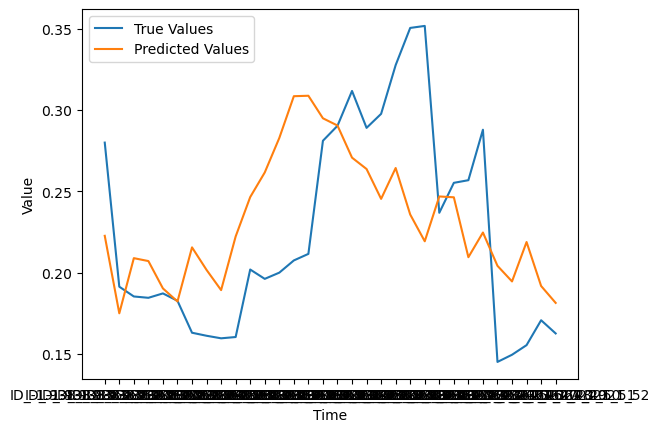

(49, 67)
2/2 [==============================] - 1s 5ms/step
LAT_LONG:  -2.772_30.928
Epoch 1/50
3/3 [==============================] - 2s 250ms/step - loss: 1335.2108 - mse: 1335.2108 - accuracy: 0.0000e+00 - val_loss: 1516.4818 - val_mse: 1516.4818 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 1317.8823 - mse: 1317.8823 - accuracy: 0.0000e+00 - val_loss: 1501.8247 - val_mse: 1501.8247 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 32ms/step - loss: 1305.2719 - mse: 1305.2719 - accuracy: 0.0000e+00 - val_loss: 1489.7509 - val_mse: 1489.7509 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 1294.2480 - mse: 1294.2480 - accuracy: 0.0000e+00 - val_loss: 1479.0413 - val_mse: 1479.0413 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 1284.5828 - mse: 1284.5828 - accuracy: 0.0000e+00 - val_loss: 1468.7324 - val_m

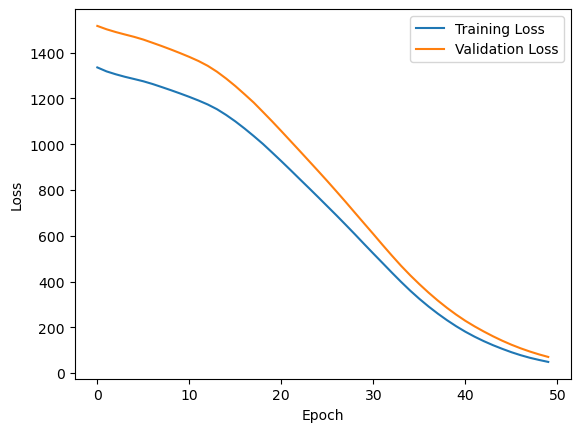

1/1 [==============================] - 0s 390ms/step


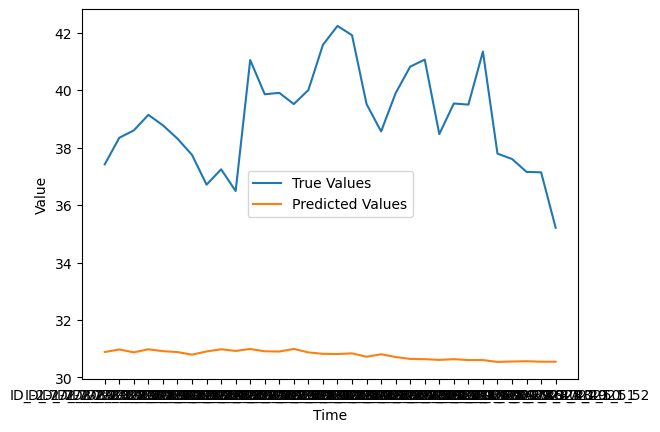

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -3.095_29.505
Epoch 1/50
3/3 [==============================] - 3s 471ms/step - loss: 24.5331 - mse: 24.5331 - accuracy: 0.0000e+00 - val_loss: 20.0026 - val_mse: 20.0026 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 30ms/step - loss: 23.1640 - mse: 23.1640 - accuracy: 0.0000e+00 - val_loss: 18.8101 - val_mse: 18.8101 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 21.9444 - mse: 21.9444 - accuracy: 0.0000e+00 - val_loss: 17.7956 - val_mse: 17.7956 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 20.9292 - mse: 20.9292 - accuracy: 0.0000e+00 - val_loss: 16.7859 - val_mse: 16.7859 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 19.7530 - mse: 19.7530 - accuracy: 0.0000e+00 - val_loss: 15.5790 - val_mse: 15.5790 - val_accuracy: 0.0000e+00

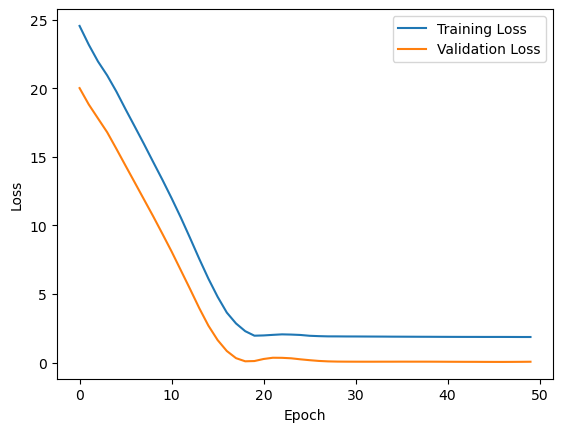

1/1 [==============================] - 0s 365ms/step


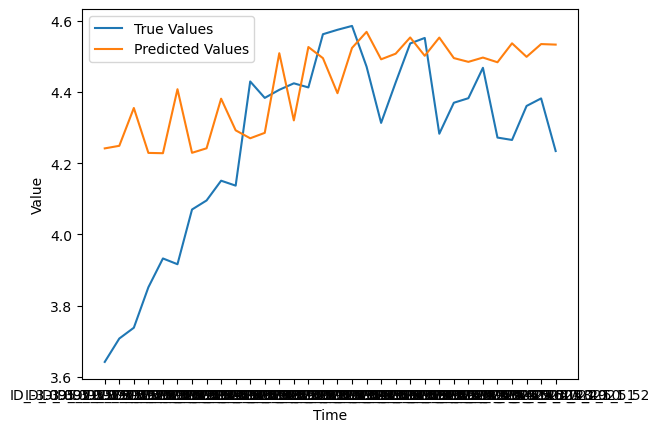

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -1.77_29.13
Epoch 1/50
3/3 [==============================] - 2s 258ms/step - loss: 25155.7773 - mse: 25155.7773 - accuracy: 0.0000e+00 - val_loss: 25737.4922 - val_mse: 25737.4922 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 25074.9219 - mse: 25074.9219 - accuracy: 0.0000e+00 - val_loss: 25656.3008 - val_mse: 25656.3008 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 25000.5938 - mse: 25000.5918 - accuracy: 0.0000e+00 - val_loss: 25583.4004 - val_mse: 25583.4004 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 24930.7227 - mse: 24930.7227 - accuracy: 0.0000e+00 - val_loss: 25511.7773 - val_mse: 25511.7773 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 24859.4004 - mse: 24859.4023 - accuracy: 0.0000e+00 - val_loss: 2

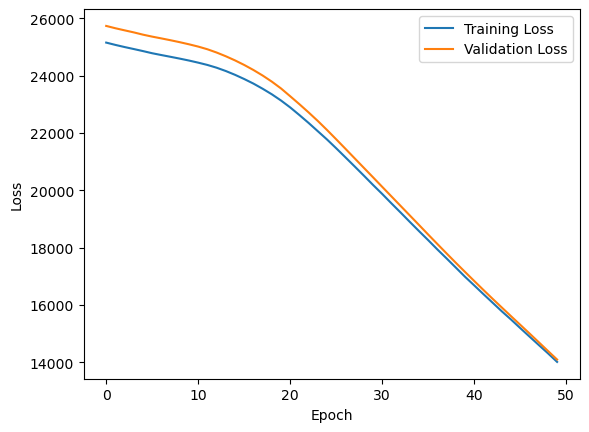

1/1 [==============================] - 0s 383ms/step


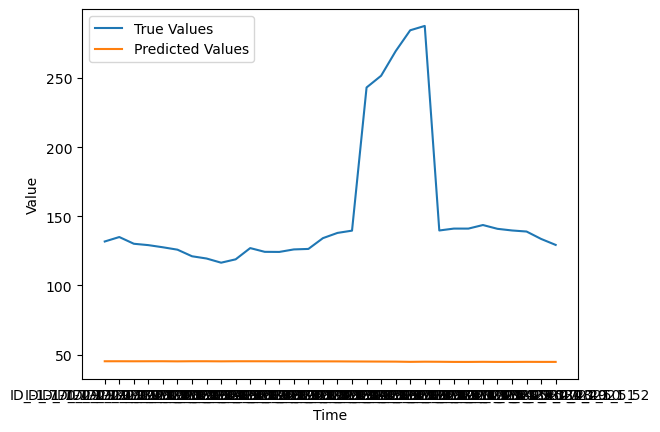

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.676_28.724
Epoch 1/50
3/3 [==============================] - 2s 259ms/step - loss: 536.8135 - mse: 536.8135 - accuracy: 0.0000e+00 - val_loss: 537.5925 - val_mse: 537.5925 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 520.5359 - mse: 520.5359 - accuracy: 0.0000e+00 - val_loss: 521.2325 - val_mse: 521.2325 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 504.7098 - mse: 504.7098 - accuracy: 0.0000e+00 - val_loss: 505.5282 - val_mse: 505.5282 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 489.1729 - mse: 489.1729 - accuracy: 0.0000e+00 - val_loss: 489.5965 - val_mse: 489.5965 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 34ms/step - loss: 473.4395 - mse: 473.4395 - accuracy: 0.0000e+00 - val_loss: 473.5454 - val_mse: 473.5454 - val_

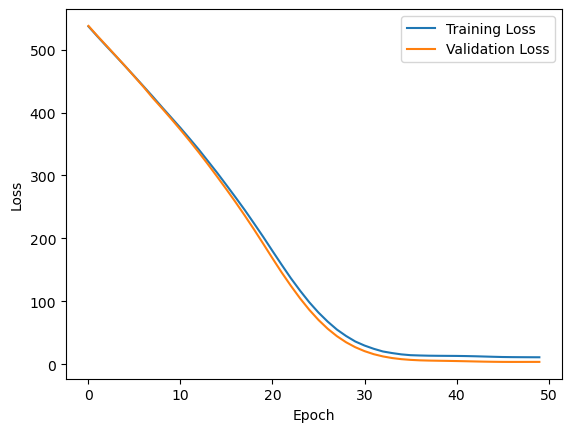

1/1 [==============================] - 1s 529ms/step


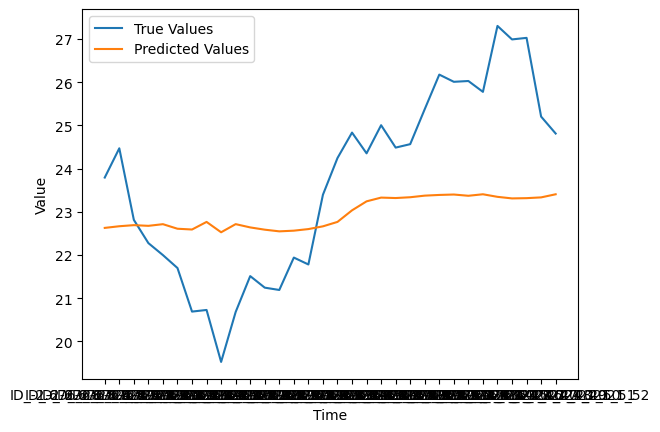

(49, 67)
2/2 [==============================] - 1s 6ms/step
LAT_LONG:  -3.028_28.872
Epoch 1/50
3/3 [==============================] - 3s 214ms/step - loss: 2260.6714 - mse: 2260.6714 - accuracy: 0.0000e+00 - val_loss: 2444.2651 - val_mse: 2444.2651 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 35ms/step - loss: 2229.0901 - mse: 2229.0901 - accuracy: 0.0000e+00 - val_loss: 2408.4277 - val_mse: 2408.4277 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 32ms/step - loss: 2193.7725 - mse: 2193.7725 - accuracy: 0.0000e+00 - val_loss: 2373.0166 - val_mse: 2373.0166 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 2159.8552 - mse: 2159.8552 - accuracy: 0.0000e+00 - val_loss: 2339.4277 - val_mse: 2339.4277 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 2127.9473 - mse: 2127.9473 - accuracy: 0.0000e+00 - val_loss: 2307.5562 - val_m

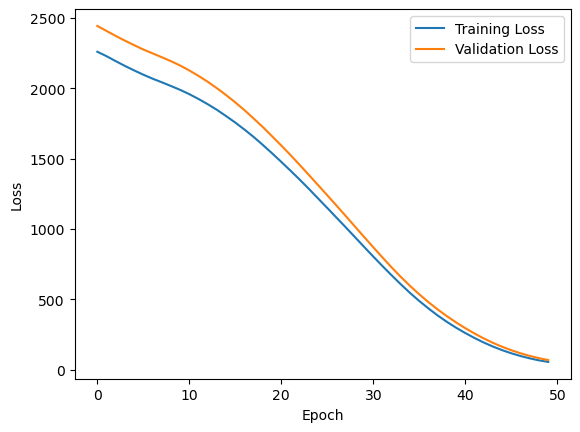

1/1 [==============================] - 0s 321ms/step


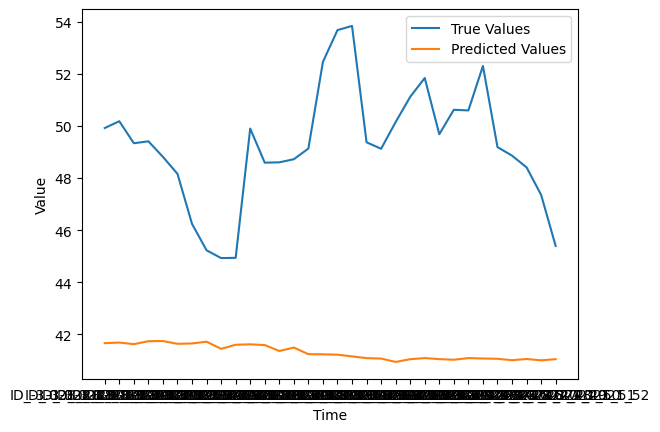

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.847_28.753
Epoch 1/50
3/3 [==============================] - 2s 239ms/step - loss: 1.9685 - mse: 1.9685 - accuracy: 0.0000e+00 - val_loss: 1.1804 - val_mse: 1.1804 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 31ms/step - loss: 1.4129 - mse: 1.4129 - accuracy: 0.0000e+00 - val_loss: 0.7857 - val_mse: 0.7857 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 35ms/step - loss: 1.0426 - mse: 1.0426 - accuracy: 0.0000e+00 - val_loss: 0.5109 - val_mse: 0.5109 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 34ms/step - loss: 0.7687 - mse: 0.7687 - accuracy: 0.0000e+00 - val_loss: 0.3028 - val_mse: 0.3028 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 27ms/step - loss: 0.5517 - mse: 0.5517 - accuracy: 0.0000e+00 - val_loss: 0.1664 - val_mse: 0.1664 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

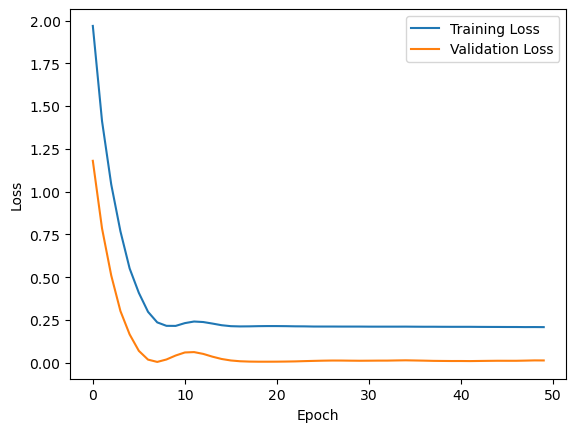

1/1 [==============================] - 0s 378ms/step


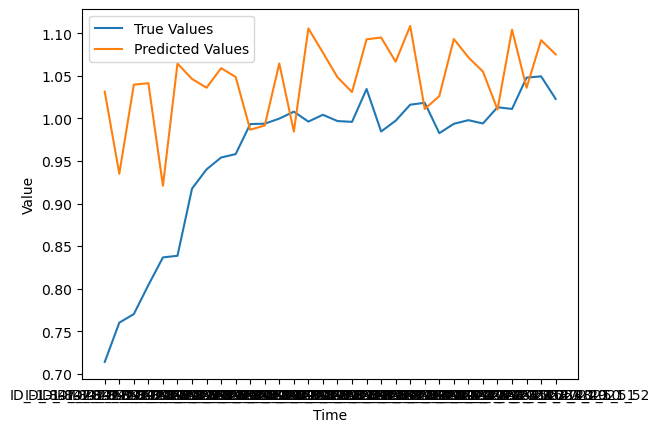

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.07_29.23
Epoch 1/50
3/3 [==============================] - 4s 235ms/step - loss: 4.6243 - mse: 4.6243 - accuracy: 0.0000e+00 - val_loss: 2.3199 - val_mse: 2.3199 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 3.4238 - mse: 3.4238 - accuracy: 0.0000e+00 - val_loss: 1.4993 - val_mse: 1.4993 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 2.6028 - mse: 2.6028 - accuracy: 0.0000e+00 - val_loss: 0.9994 - val_mse: 0.9994 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 31ms/step - loss: 2.0738 - mse: 2.0738 - accuracy: 0.0000e+00 - val_loss: 0.6333 - val_mse: 0.6333 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 1.6641 - mse: 1.6641 - accuracy: 0.0000e+00 - val_loss: 0.3709 - val_mse: 0.3709 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [=====

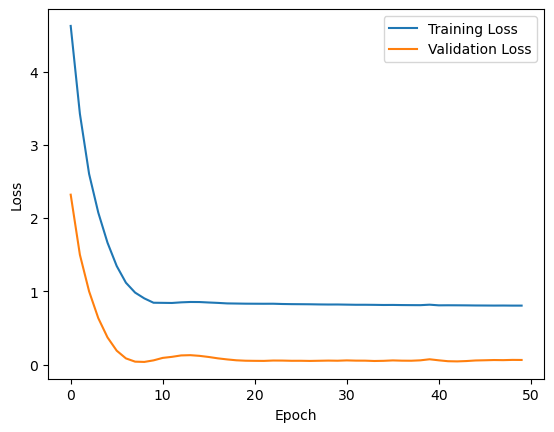

1/1 [==============================] - 0s 360ms/step


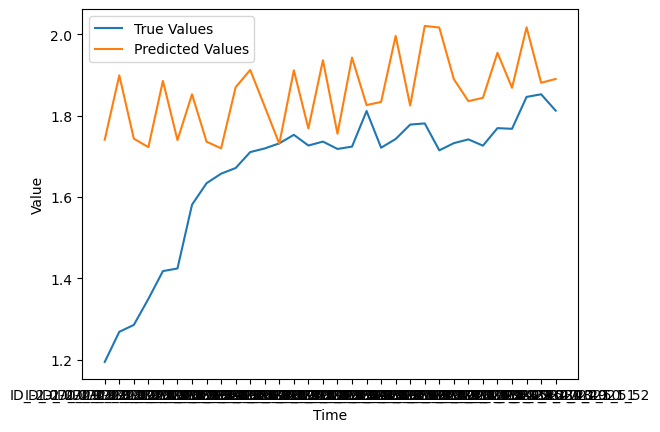

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.851_30.249
Epoch 1/50
3/3 [==============================] - 3s 205ms/step - loss: 3016.7490 - mse: 3016.7490 - accuracy: 0.0000e+00 - val_loss: 3237.1826 - val_mse: 3237.1826 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 2979.6821 - mse: 2979.6821 - accuracy: 0.0000e+00 - val_loss: 3202.5808 - val_mse: 3202.5808 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 2946.6023 - mse: 2946.6023 - accuracy: 0.0000e+00 - val_loss: 3168.9133 - val_mse: 3168.9133 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 2914.0078 - mse: 2914.0078 - accuracy: 0.0000e+00 - val_loss: 3134.1089 - val_mse: 3134.1089 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 35ms/step - loss: 2880.9541 - mse: 2880.9541 - accuracy: 0.0000e+00 - val_loss: 3101.2471 - val_m

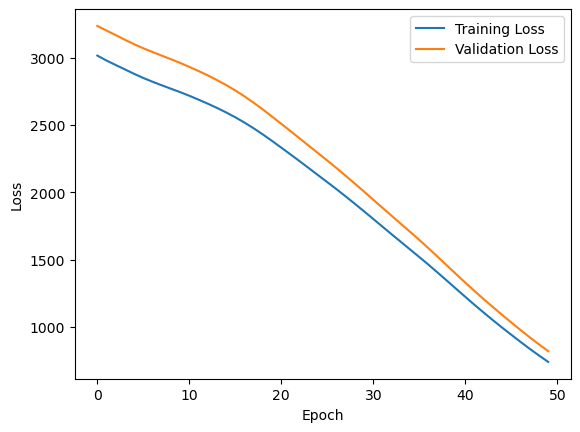

1/1 [==============================] - 0s 378ms/step


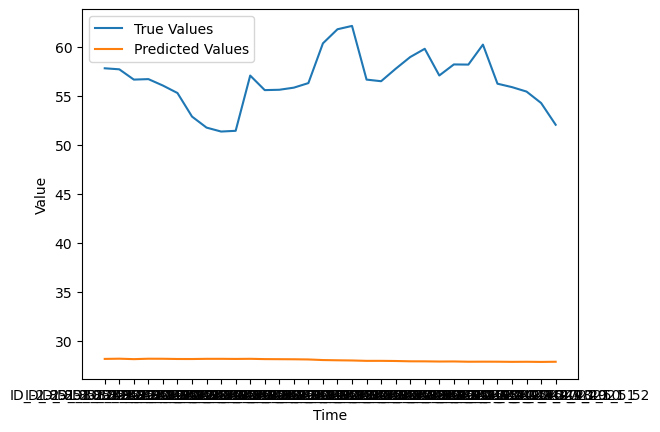

(49, 67)
2/2 [==============================] - 1s 14ms/step
LAT_LONG:  -2.935_29.565
Epoch 1/50
3/3 [==============================] - 5s 417ms/step - loss: 6338.4912 - mse: 6338.4912 - accuracy: 0.0000e+00 - val_loss: 5944.3125 - val_mse: 5944.3125 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 49ms/step - loss: 6271.8594 - mse: 6271.8594 - accuracy: 0.0000e+00 - val_loss: 5877.7783 - val_mse: 5877.7783 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 55ms/step - loss: 6204.2007 - mse: 6204.2007 - accuracy: 0.0000e+00 - val_loss: 5812.8911 - val_mse: 5812.8911 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 63ms/step - loss: 6138.1821 - mse: 6138.1821 - accuracy: 0.0000e+00 - val_loss: 5746.1260 - val_mse: 5746.1260 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 91ms/step - loss: 6071.0283 - mse: 6071.0283 - accuracy: 0.0000e+00 - val_loss: 5672.3843 - val_

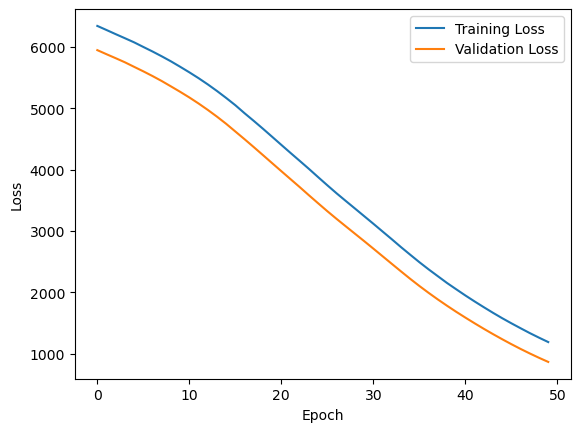

1/1 [==============================] - 0s 430ms/step


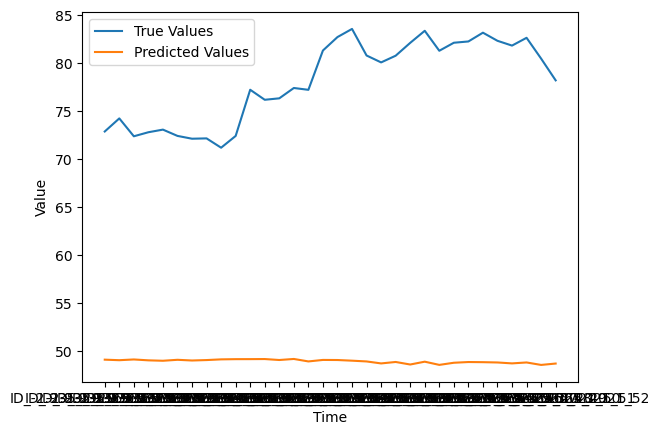

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.237_30.763
Epoch 1/50
3/3 [==============================] - 2s 297ms/step - loss: 603.7646 - mse: 603.7646 - accuracy: 0.0000e+00 - val_loss: 554.0365 - val_mse: 554.0365 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 588.0198 - mse: 588.0198 - accuracy: 0.0000e+00 - val_loss: 538.2239 - val_mse: 538.2239 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 573.7476 - mse: 573.7476 - accuracy: 0.0000e+00 - val_loss: 526.1320 - val_mse: 526.1320 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 562.1100 - mse: 562.1100 - accuracy: 0.0000e+00 - val_loss: 515.5616 - val_mse: 515.5616 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 35ms/step - loss: 551.6321 - mse: 551.6321 - accuracy: 0.0000e+00 - val_loss: 504.9488 - val_mse: 504.9488 - val_

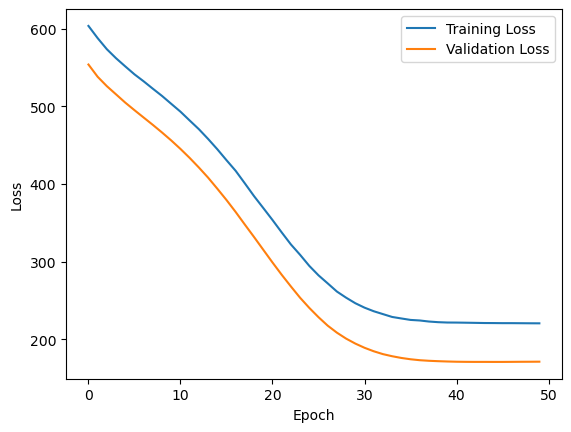

1/1 [==============================] - 0s 369ms/step


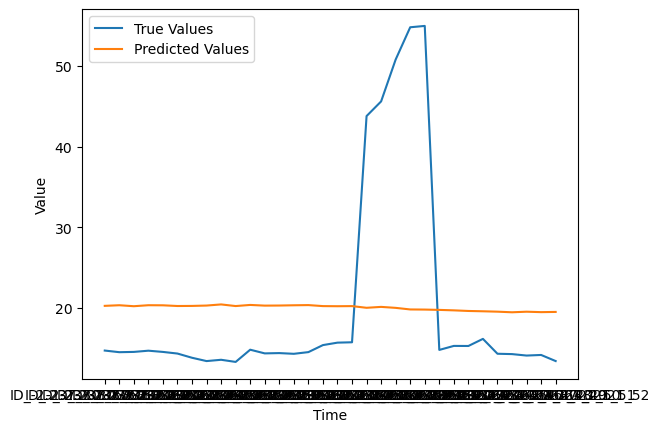

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.555_29.145
Epoch 1/50
3/3 [==============================] - 2s 217ms/step - loss: 21.3766 - mse: 21.3766 - accuracy: 0.0000e+00 - val_loss: 18.4588 - val_mse: 18.4588 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 32ms/step - loss: 19.2653 - mse: 19.2653 - accuracy: 0.0000e+00 - val_loss: 16.5442 - val_mse: 16.5442 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 34ms/step - loss: 17.4262 - mse: 17.4262 - accuracy: 0.0000e+00 - val_loss: 14.7699 - val_mse: 14.7699 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 33ms/step - loss: 15.6172 - mse: 15.6172 - accuracy: 0.0000e+00 - val_loss: 13.1651 - val_mse: 13.1651 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 38ms/step - loss: 14.2182 - mse: 14.2182 - accuracy: 0.0000e+00 - val_loss: 11.8080 - val_mse: 11.8080 - val_accuracy: 0.0000e+00

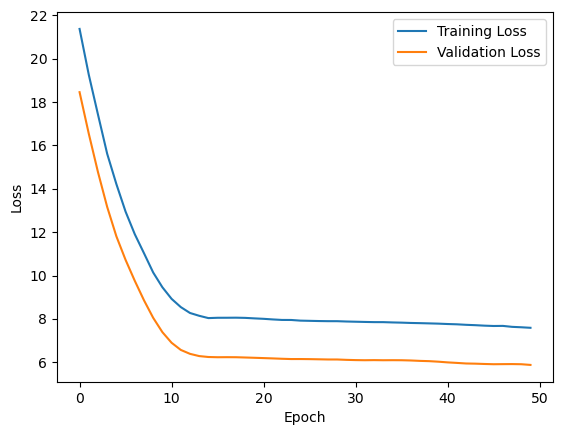

1/1 [==============================] - 0s 377ms/step


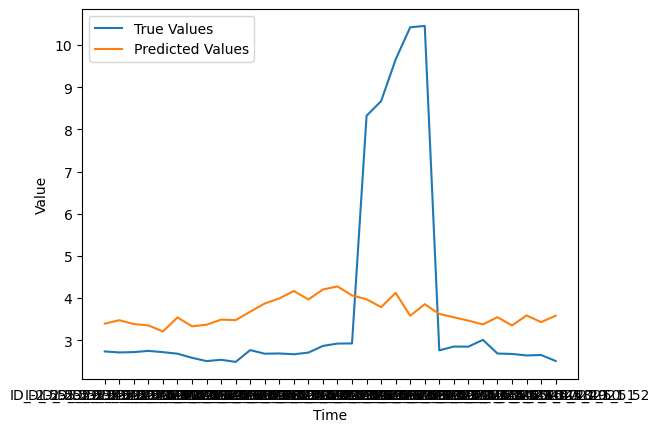

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.491_29.309
Epoch 1/50
3/3 [==============================] - 2s 248ms/step - loss: 24646.9258 - mse: 24646.9258 - accuracy: 0.0000e+00 - val_loss: 25435.9375 - val_mse: 25435.9375 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 40ms/step - loss: 24566.2402 - mse: 24566.2402 - accuracy: 0.0000e+00 - val_loss: 25353.1211 - val_mse: 25353.1211 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 38ms/step - loss: 24481.6758 - mse: 24481.6758 - accuracy: 0.0000e+00 - val_loss: 25264.9766 - val_mse: 25264.9766 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 24393.8262 - mse: 24393.8262 - accuracy: 0.0000e+00 - val_loss: 25180.7070 - val_mse: 25180.7070 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 37ms/step - loss: 24310.7051 - mse: 24310.7051 - accuracy: 0.0000e+00 - val_loss:

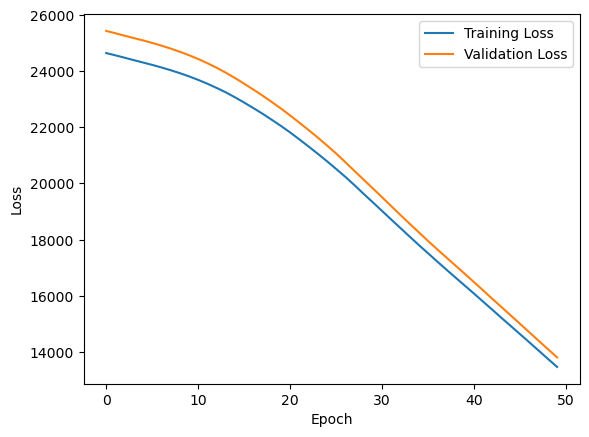

1/1 [==============================] - 1s 549ms/step


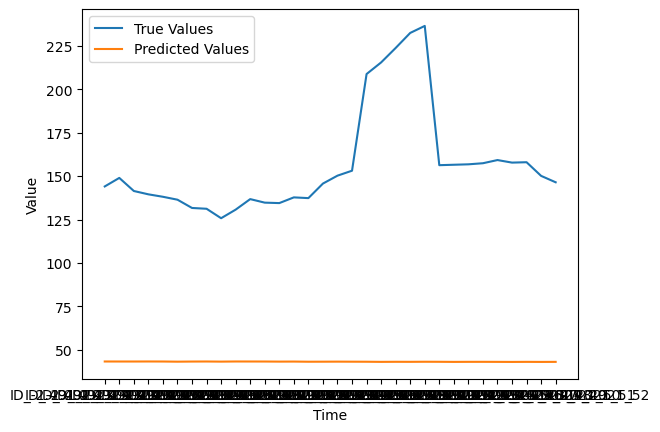

(49, 67)
2/2 [==============================] - 1s 7ms/step
LAT_LONG:  -1.804_31.196
Epoch 1/50
3/3 [==============================] - 4s 703ms/step - loss: 33617.6992 - mse: 33617.6992 - accuracy: 0.0000e+00 - val_loss: 34796.3242 - val_mse: 34796.3242 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 46ms/step - loss: 33490.3047 - mse: 33490.3047 - accuracy: 0.0000e+00 - val_loss: 34668.8203 - val_mse: 34668.8203 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 34ms/step - loss: 33375.7148 - mse: 33375.7148 - accuracy: 0.0000e+00 - val_loss: 34564.6602 - val_mse: 34564.6602 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 66ms/step - loss: 33277.6758 - mse: 33277.6758 - accuracy: 0.0000e+00 - val_loss: 34471.8828 - val_mse: 34471.8828 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 53ms/step - loss: 33191.6719 - mse: 33191.6719 - accuracy: 0.0000e+00 - val_loss:

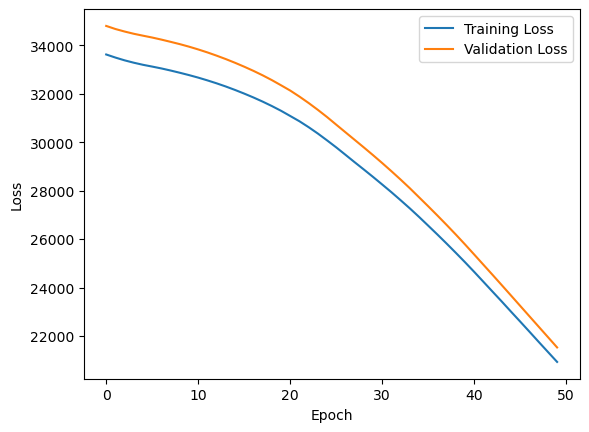

1/1 [==============================] - 0s 411ms/step


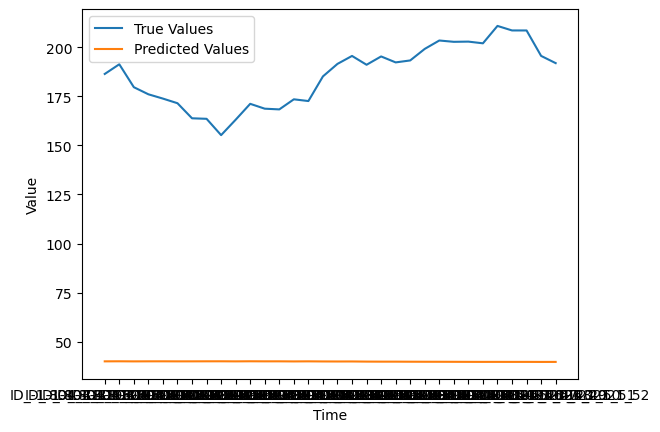

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.451_28.249
Epoch 1/50
3/3 [==============================] - 3s 318ms/step - loss: 7.6390 - mse: 7.6390 - accuracy: 0.0000e+00 - val_loss: 3.8238 - val_mse: 3.8238 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 38ms/step - loss: 6.1940 - mse: 6.1940 - accuracy: 0.0000e+00 - val_loss: 2.7639 - val_mse: 2.7639 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 39ms/step - loss: 5.0230 - mse: 5.0230 - accuracy: 0.0000e+00 - val_loss: 1.8434 - val_mse: 1.8434 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 38ms/step - loss: 4.0373 - mse: 4.0373 - accuracy: 0.0000e+00 - val_loss: 1.1362 - val_mse: 1.1362 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 36ms/step - loss: 3.2223 - mse: 3.2223 - accuracy: 0.0000e+00 - val_loss: 0.6286 - val_mse: 0.6286 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

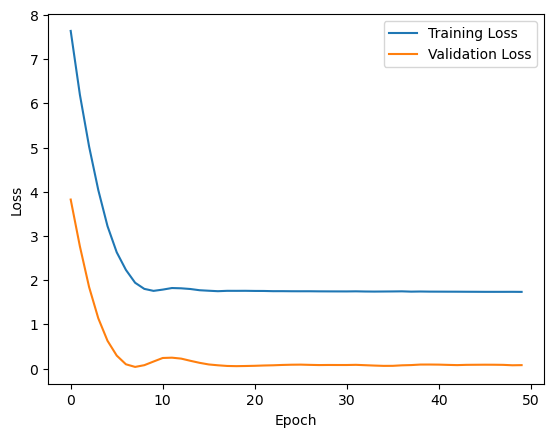

1/1 [==============================] - 0s 416ms/step


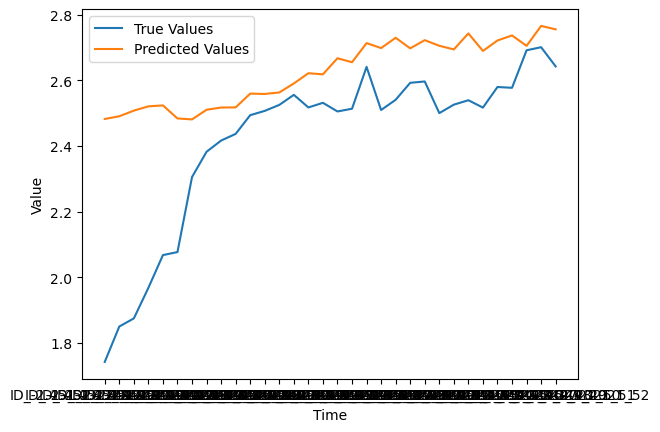

(49, 67)
2/2 [==============================] - 1s 7ms/step
LAT_LONG:  -2.313_29.787
Epoch 1/50
3/3 [==============================] - 3s 239ms/step - loss: 7090.8916 - mse: 7090.8916 - accuracy: 0.0000e+00 - val_loss: 7334.6685 - val_mse: 7334.6685 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 35ms/step - loss: 7056.6104 - mse: 7056.6104 - accuracy: 0.0000e+00 - val_loss: 7304.1895 - val_mse: 7304.1895 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 54ms/step - loss: 7025.5088 - mse: 7025.5088 - accuracy: 0.0000e+00 - val_loss: 7270.5127 - val_mse: 7270.5127 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 40ms/step - loss: 6990.5405 - mse: 6990.5405 - accuracy: 0.0000e+00 - val_loss: 7232.4053 - val_mse: 7232.4053 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 6952.7017 - mse: 6952.7017 - accuracy: 0.0000e+00 - val_loss: 7193.0796 - val_m

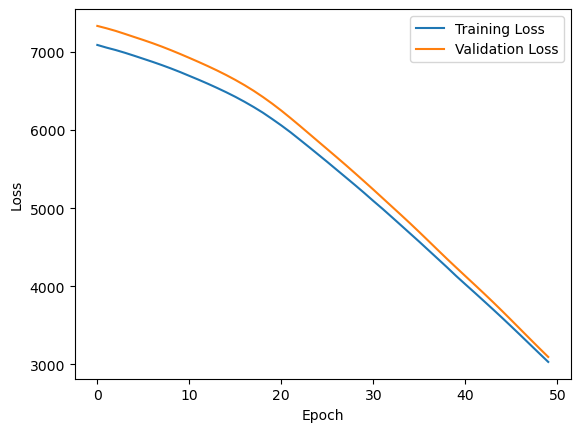

1/1 [==============================] - 0s 363ms/step


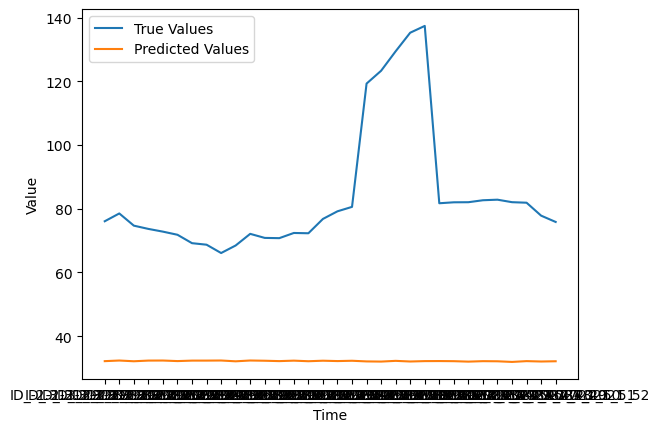

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.051_29.949
Epoch 1/50
3/3 [==============================] - 3s 217ms/step - loss: 16500.0391 - mse: 16500.0391 - accuracy: 0.0000e+00 - val_loss: 15961.4863 - val_mse: 15961.4863 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 16387.1094 - mse: 16387.1094 - accuracy: 0.0000e+00 - val_loss: 15857.3682 - val_mse: 15857.3682 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 16285.0137 - mse: 16285.0137 - accuracy: 0.0000e+00 - val_loss: 15755.0439 - val_mse: 15755.0439 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 16180.2363 - mse: 16180.2363 - accuracy: 0.0000e+00 - val_loss: 15647.9707 - val_mse: 15647.9707 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 16072.8877 - mse: 16072.8877 - accuracy: 0.0000e+00 - val_loss:

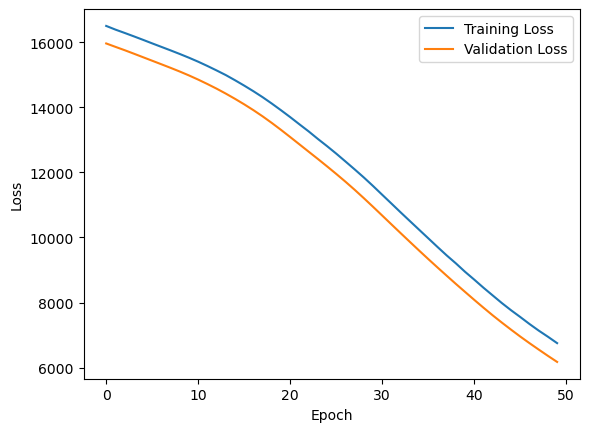

1/1 [==============================] - 0s 350ms/step


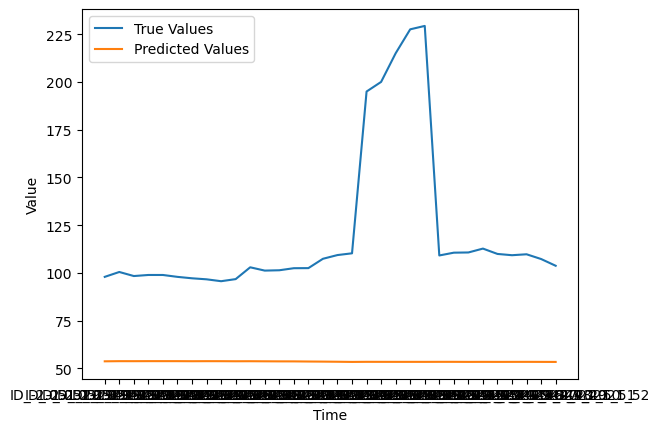

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.986_29.114
Epoch 1/50
3/3 [==============================] - 2s 264ms/step - loss: 0.6798 - mse: 0.6798 - accuracy: 0.0000e+00 - val_loss: 0.3890 - val_mse: 0.3890 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 30ms/step - loss: 0.2720 - mse: 0.2720 - accuracy: 0.0000e+00 - val_loss: 0.1241 - val_mse: 0.1241 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 0.0728 - mse: 0.0728 - accuracy: 0.0000e+00 - val_loss: 0.0221 - val_mse: 0.0221 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 27ms/step - loss: 0.0084 - mse: 0.0084 - accuracy: 0.0000e+00 - val_loss: 0.0020 - val_mse: 0.0020 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 0.0095 - mse: 0.0095 - accuracy: 0.0000e+00 - val_loss: 0.0162 - val_mse: 0.0162 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

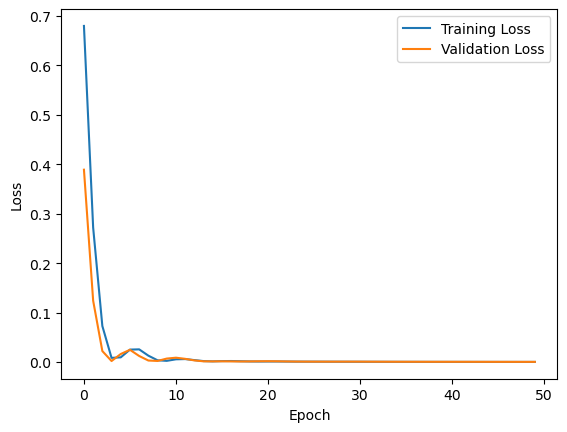

1/1 [==============================] - 0s 351ms/step


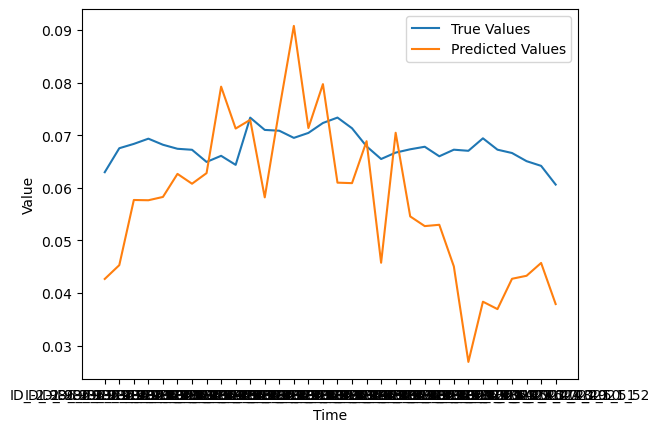

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -2.858_28.642
Epoch 1/50
3/3 [==============================] - 2s 240ms/step - loss: 3.0062 - mse: 3.0062 - accuracy: 0.0000e+00 - val_loss: 3.1170 - val_mse: 3.1170 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 30ms/step - loss: 2.1560 - mse: 2.1560 - accuracy: 0.0000e+00 - val_loss: 2.3280 - val_mse: 2.3280 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 29ms/step - loss: 1.5562 - mse: 1.5562 - accuracy: 0.0000e+00 - val_loss: 1.7528 - val_mse: 1.7528 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 1.1228 - mse: 1.1228 - accuracy: 0.0000e+00 - val_loss: 1.2966 - val_mse: 1.2966 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 0.7771 - mse: 0.7771 - accuracy: 0.0000e+00 - val_loss: 0.8673 - val_mse: 0.8673 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

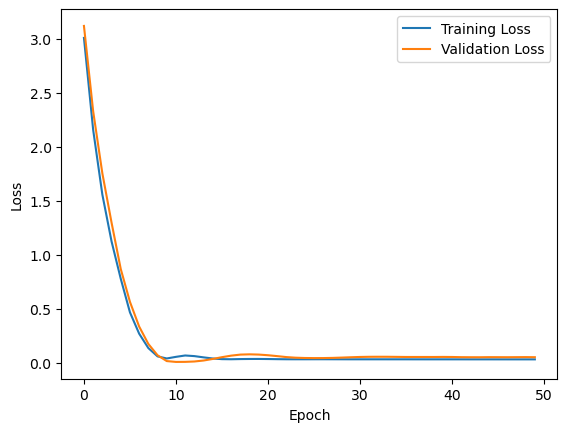

1/1 [==============================] - 0s 333ms/step


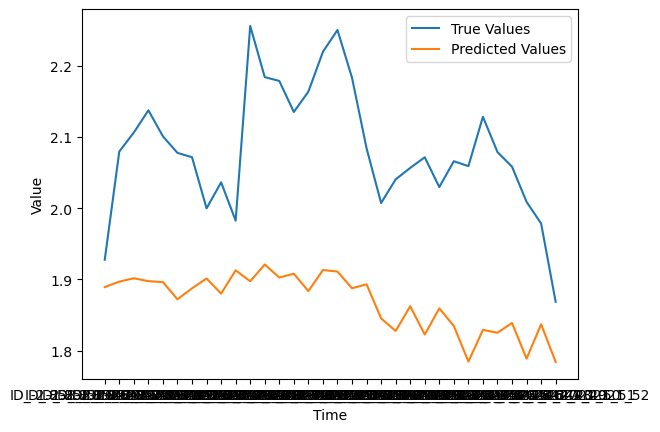

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.412_31.188
Epoch 1/50
3/3 [==============================] - 2s 215ms/step - loss: 11687.8105 - mse: 11687.8105 - accuracy: 0.0000e+00 - val_loss: 13811.4180 - val_mse: 13811.4180 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 35ms/step - loss: 11623.1465 - mse: 11623.1465 - accuracy: 0.0000e+00 - val_loss: 13755.6875 - val_mse: 13755.6875 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 11577.6641 - mse: 11577.6641 - accuracy: 0.0000e+00 - val_loss: 13712.8418 - val_mse: 13712.8418 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 11538.0908 - mse: 11538.0908 - accuracy: 0.0000e+00 - val_loss: 13670.3770 - val_mse: 13670.3770 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 35ms/step - loss: 11498.0850 - mse: 11498.0850 - accuracy: 0.0000e+00 - val_loss:

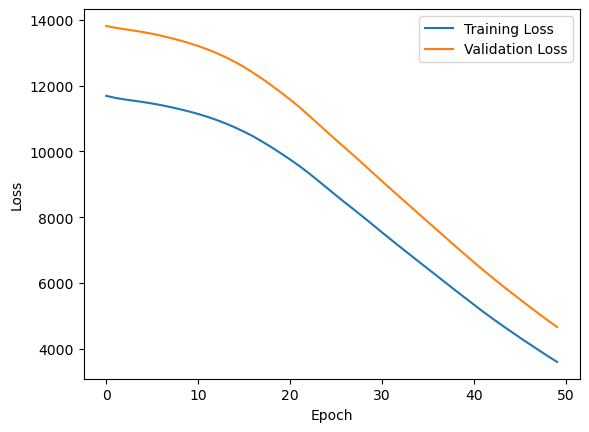

1/1 [==============================] - 0s 315ms/step


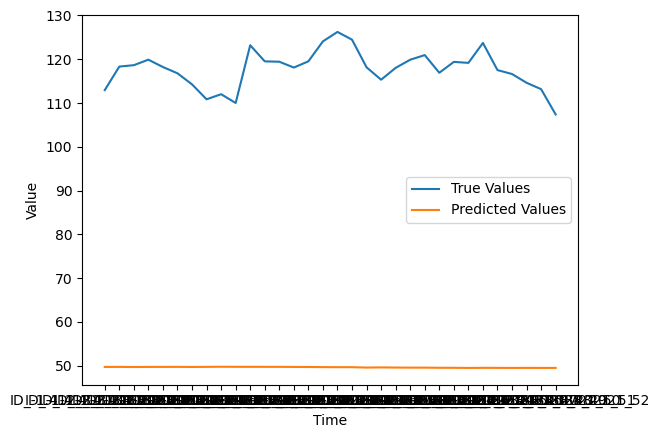

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.911_29.389
Epoch 1/50
3/3 [==============================] - 2s 227ms/step - loss: 6931.4873 - mse: 6931.4873 - accuracy: 0.0000e+00 - val_loss: 6820.8511 - val_mse: 6820.8511 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 30ms/step - loss: 6880.1602 - mse: 6880.1602 - accuracy: 0.0000e+00 - val_loss: 6769.2998 - val_mse: 6769.2998 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 6828.2197 - mse: 6828.2197 - accuracy: 0.0000e+00 - val_loss: 6714.8740 - val_mse: 6714.8740 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 6773.3511 - mse: 6773.3511 - accuracy: 0.0000e+00 - val_loss: 6658.1533 - val_mse: 6658.1533 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 6715.7578 - mse: 6715.7578 - accuracy: 0.0000e+00 - val_loss: 6600.6191 - val_m

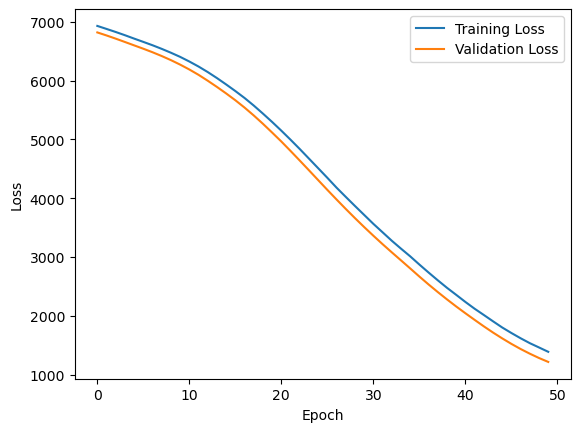

1/1 [==============================] - 0s 329ms/step


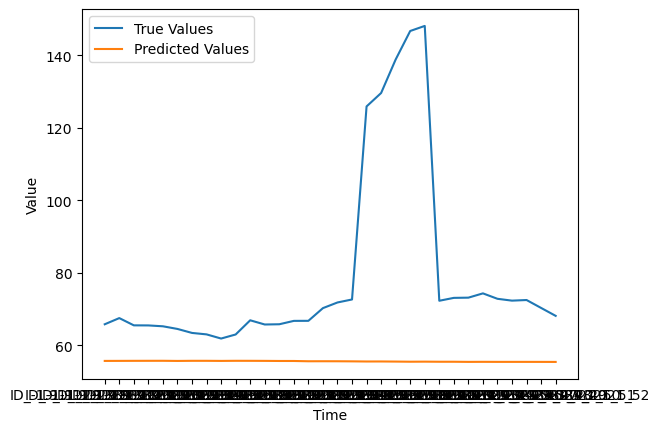

(49, 67)
2/2 [==============================] - 0s 9ms/step
LAT_LONG:  -1.877_28.523
Epoch 1/50
3/3 [==============================] - 3s 506ms/step - loss: 0.2841 - mse: 0.2841 - accuracy: 0.0000e+00 - val_loss: 0.0238 - val_mse: 0.0238 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 0.1328 - mse: 0.1328 - accuracy: 0.0000e+00 - val_loss: 0.0109 - val_mse: 0.0109 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 0.1332 - mse: 0.1332 - accuracy: 0.0000e+00 - val_loss: 0.0549 - val_mse: 0.0549 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 0.1584 - mse: 0.1584 - accuracy: 0.0000e+00 - val_loss: 0.0594 - val_mse: 0.0594 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 0.1508 - mse: 0.1508 - accuracy: 0.0000e+00 - val_loss: 0.0327 - val_mse: 0.0327 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

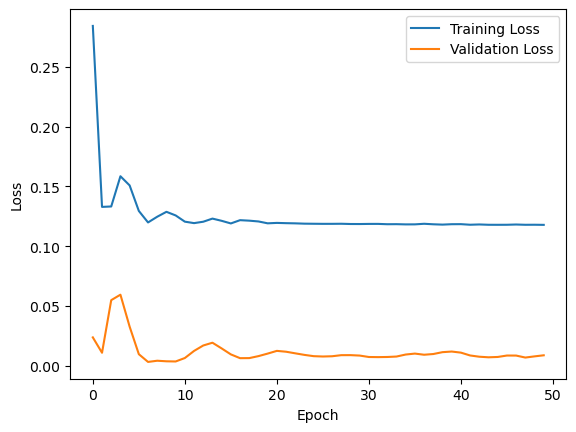

1/1 [==============================] - 0s 335ms/step


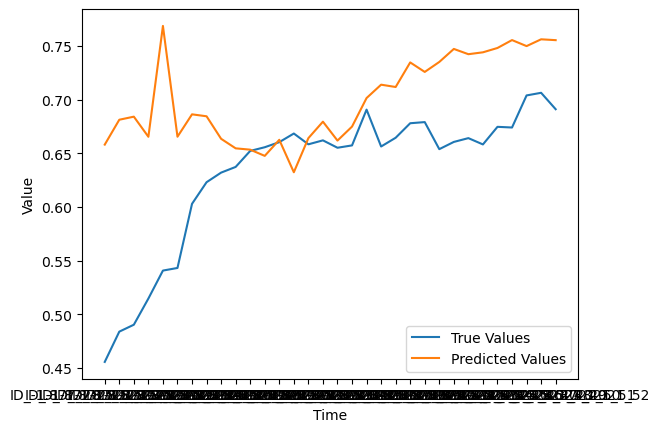

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -1.45_29.35
Epoch 1/50
3/3 [==============================] - 2s 245ms/step - loss: 342.6659 - mse: 342.6659 - accuracy: 0.0000e+00 - val_loss: 341.4199 - val_mse: 341.4199 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 329.9005 - mse: 329.9005 - accuracy: 0.0000e+00 - val_loss: 330.6711 - val_mse: 330.6711 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 319.8192 - mse: 319.8192 - accuracy: 0.0000e+00 - val_loss: 321.2619 - val_mse: 321.2619 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 310.5031 - mse: 310.5031 - accuracy: 0.0000e+00 - val_loss: 311.8571 - val_mse: 311.8571 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 301.0839 - mse: 301.0839 - accuracy: 0.0000e+00 - val_loss: 302.1324 - val_mse: 302.1324 - val_ac

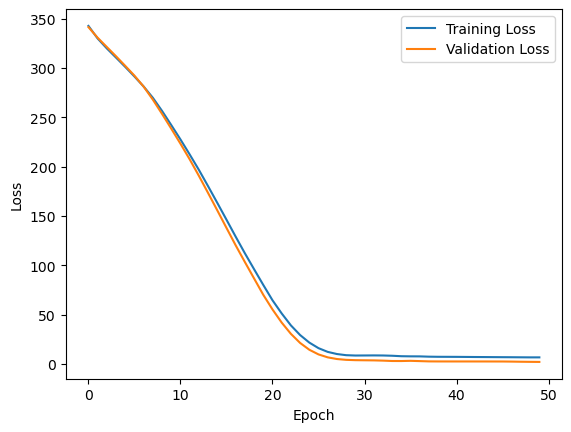

1/1 [==============================] - 0s 353ms/step


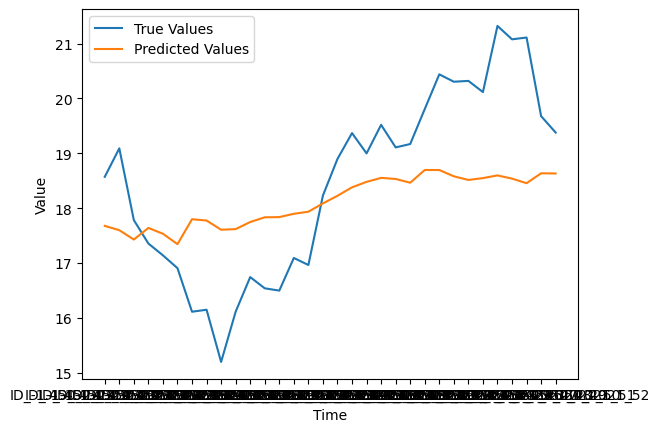

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.076_28.724
Epoch 1/50
3/3 [==============================] - 2s 228ms/step - loss: 0.5287 - mse: 0.5287 - accuracy: 0.0000e+00 - val_loss: 0.2049 - val_mse: 0.2049 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 29ms/step - loss: 0.2717 - mse: 0.2717 - accuracy: 0.0000e+00 - val_loss: 0.0555 - val_mse: 0.0555 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 33ms/step - loss: 0.1314 - mse: 0.1314 - accuracy: 0.0000e+00 - val_loss: 0.0042 - val_mse: 0.0042 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 0.0814 - mse: 0.0814 - accuracy: 0.0000e+00 - val_loss: 0.0212 - val_mse: 0.0212 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 34ms/step - loss: 0.0929 - mse: 0.0929 - accuracy: 0.0000e+00 - val_loss: 0.0526 - val_mse: 0.0526 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

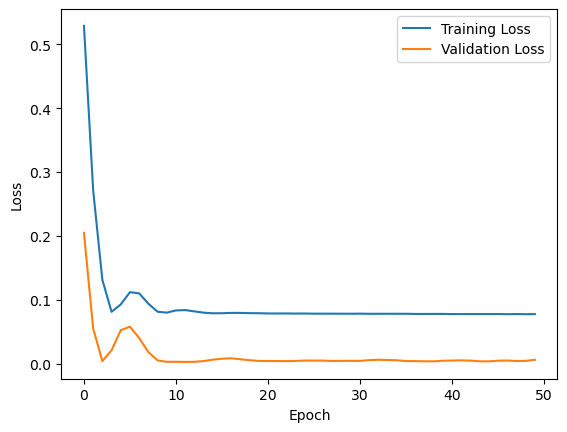

1/1 [==============================] - 0s 339ms/step


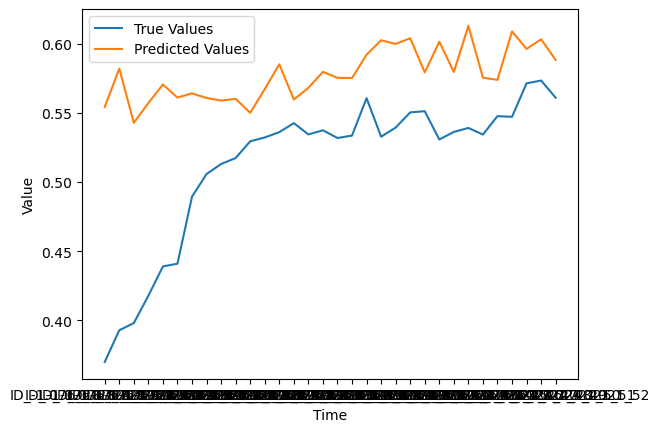

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.929_29.771
Epoch 1/50
3/3 [==============================] - 2s 189ms/step - loss: 1641.2504 - mse: 1641.2504 - accuracy: 0.0000e+00 - val_loss: 1782.5498 - val_mse: 1782.5498 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 30ms/step - loss: 1610.9796 - mse: 1610.9796 - accuracy: 0.0000e+00 - val_loss: 1750.6991 - val_mse: 1750.6991 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 29ms/step - loss: 1582.6479 - mse: 1582.6479 - accuracy: 0.0000e+00 - val_loss: 1725.0183 - val_mse: 1725.0183 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 1557.7113 - mse: 1557.7113 - accuracy: 0.0000e+00 - val_loss: 1697.1030 - val_mse: 1697.1030 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 1532.8060 - mse: 1532.8060 - accuracy: 0.0000e+00 - val_loss: 1674.0771 - val_m

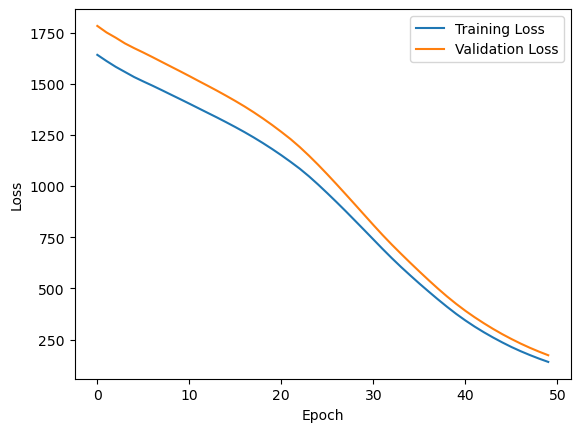

1/1 [==============================] - 0s 326ms/step


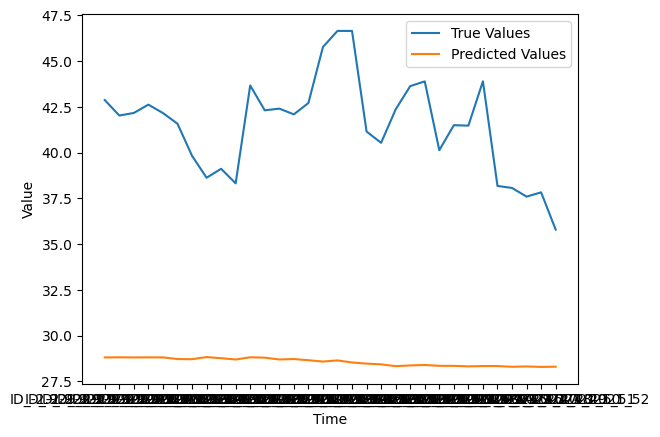

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.482_30.618
Epoch 1/50
3/3 [==============================] - 2s 320ms/step - loss: 2523.9636 - mse: 2523.9636 - accuracy: 0.0000e+00 - val_loss: 1643.8584 - val_mse: 1643.8584 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 30ms/step - loss: 2502.1033 - mse: 2502.1035 - accuracy: 0.0000e+00 - val_loss: 1625.0101 - val_mse: 1625.0101 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 2480.5996 - mse: 2480.5994 - accuracy: 0.0000e+00 - val_loss: 1606.4148 - val_mse: 1606.4148 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 2459.6230 - mse: 2459.6230 - accuracy: 0.0000e+00 - val_loss: 1588.2062 - val_mse: 1588.2062 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 2439.8479 - mse: 2439.8479 - accuracy: 0.0000e+00 - val_loss: 1570.4883 - val_m

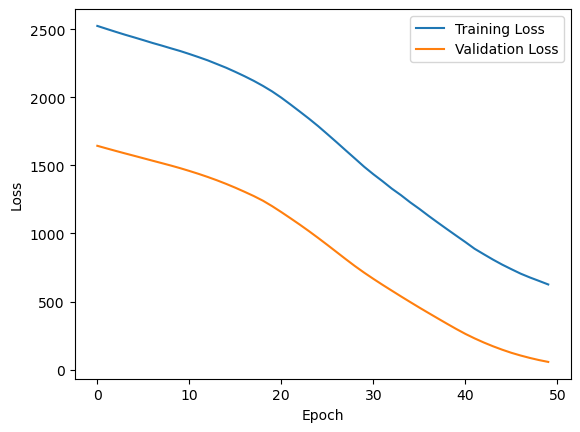

1/1 [==============================] - 0s 324ms/step


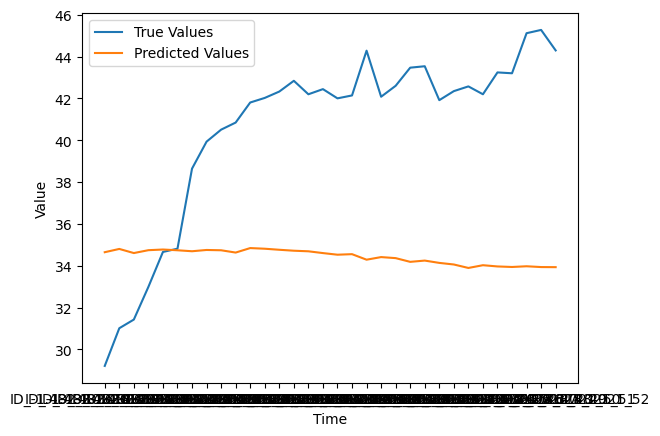

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.951_28.649
Epoch 1/50
3/3 [==============================] - 2s 244ms/step - loss: 11.6663 - mse: 11.6663 - accuracy: 0.0000e+00 - val_loss: 8.1168 - val_mse: 8.1168 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 31ms/step - loss: 9.3113 - mse: 9.3113 - accuracy: 0.0000e+00 - val_loss: 6.1841 - val_mse: 6.1841 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 29ms/step - loss: 7.4321 - mse: 7.4321 - accuracy: 0.0000e+00 - val_loss: 4.6924 - val_mse: 4.6924 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 31ms/step - loss: 5.9955 - mse: 5.9955 - accuracy: 0.0000e+00 - val_loss: 3.5926 - val_mse: 3.5926 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 4.8583 - mse: 4.8583 - accuracy: 0.0000e+00 - val_loss: 2.7100 - val_mse: 2.7100 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [=

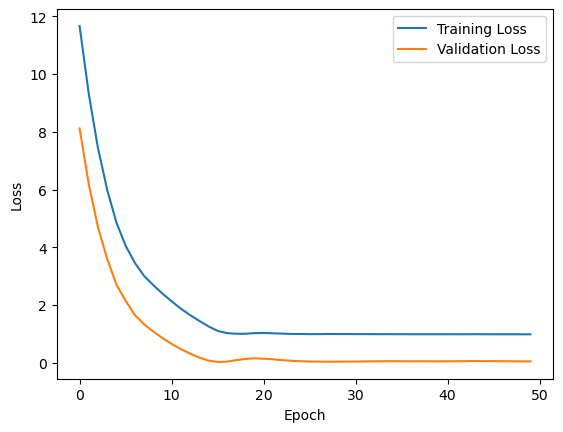

1/1 [==============================] - 0s 328ms/step


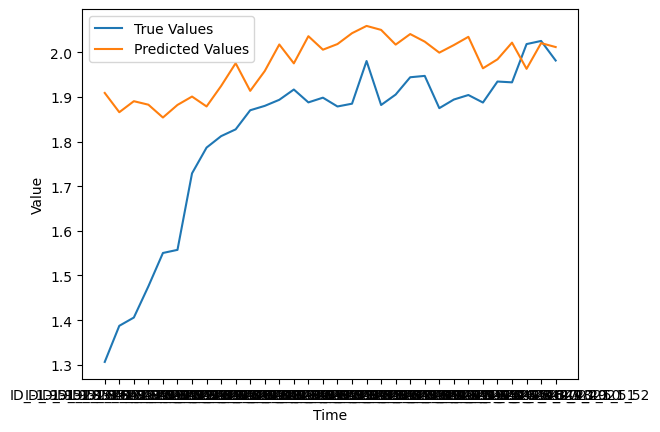

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -0.727_30.573
Epoch 1/50
3/3 [==============================] - 2s 243ms/step - loss: 12080.1064 - mse: 12080.1064 - accuracy: 0.0000e+00 - val_loss: 12648.1758 - val_mse: 12648.1758 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 32ms/step - loss: 12018.8623 - mse: 12018.8623 - accuracy: 0.0000e+00 - val_loss: 12588.2812 - val_mse: 12588.2812 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 11963.0791 - mse: 11963.0791 - accuracy: 0.0000e+00 - val_loss: 12540.3398 - val_mse: 12540.3398 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 11916.1299 - mse: 11916.1299 - accuracy: 0.0000e+00 - val_loss: 12494.8789 - val_mse: 12494.8789 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 11872.8457 - mse: 11872.8457 - accuracy: 0.0000e+00 - val_loss:

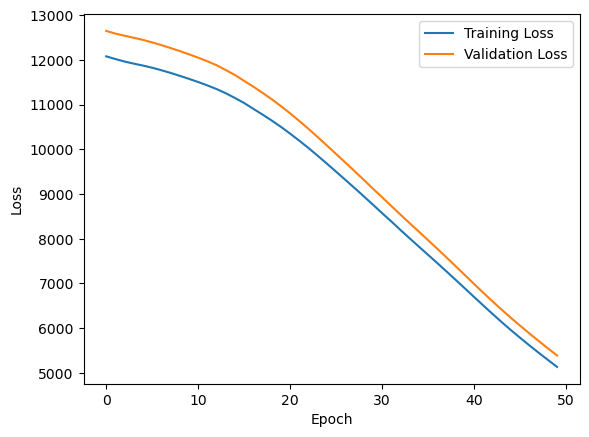

1/1 [==============================] - 0s 317ms/step


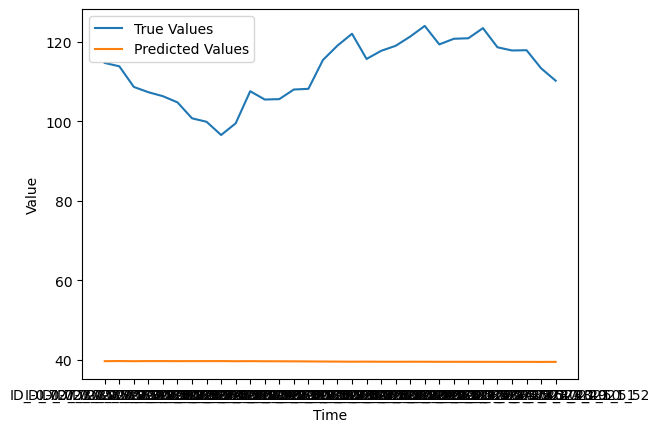

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.036_28.964
Epoch 1/50
3/3 [==============================] - 2s 250ms/step - loss: 28.9707 - mse: 28.9707 - accuracy: 0.0000e+00 - val_loss: 27.4374 - val_mse: 27.4374 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 27ms/step - loss: 25.3999 - mse: 25.3999 - accuracy: 0.0000e+00 - val_loss: 23.9659 - val_mse: 23.9659 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 28ms/step - loss: 22.0362 - mse: 22.0362 - accuracy: 0.0000e+00 - val_loss: 20.6977 - val_mse: 20.6977 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 28ms/step - loss: 19.2147 - mse: 19.2147 - accuracy: 0.0000e+00 - val_loss: 18.3527 - val_mse: 18.3527 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 29ms/step - loss: 17.1588 - mse: 17.1588 - accuracy: 0.0000e+00 - val_loss: 16.4121 - val_mse: 16.4121 - val_accuracy: 0.0000e+00

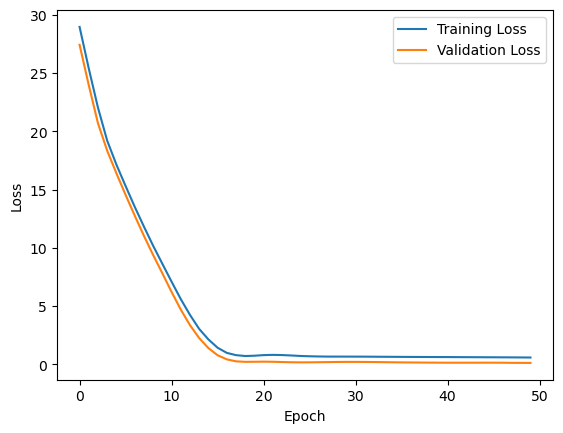

1/1 [==============================] - 0s 304ms/step


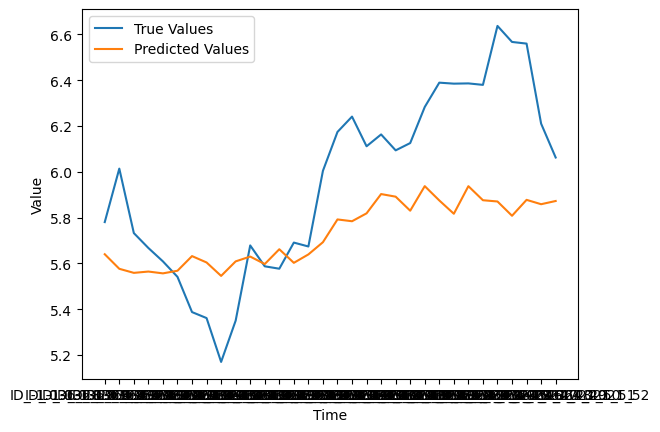

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -2.817_29.783
Epoch 1/50
3/3 [==============================] - 3s 457ms/step - loss: 684.1628 - mse: 684.1628 - accuracy: 0.0000e+00 - val_loss: 741.6825 - val_mse: 741.6825 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 679.0338 - mse: 679.0338 - accuracy: 0.0000e+00 - val_loss: 735.9977 - val_mse: 735.9977 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 30ms/step - loss: 673.2632 - mse: 673.2632 - accuracy: 0.0000e+00 - val_loss: 729.5990 - val_mse: 729.5990 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 666.8757 - mse: 666.8757 - accuracy: 0.0000e+00 - val_loss: 723.4629 - val_mse: 723.4629 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 661.2018 - mse: 661.2018 - accuracy: 0.0000e+00 - val_loss: 717.7363 - val_mse: 717.7363 - val_

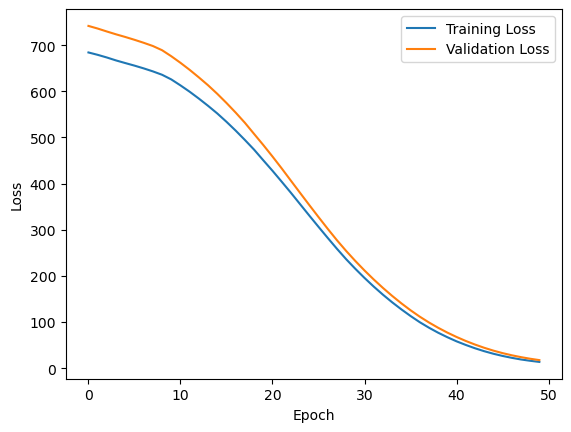

1/1 [==============================] - 0s 313ms/step


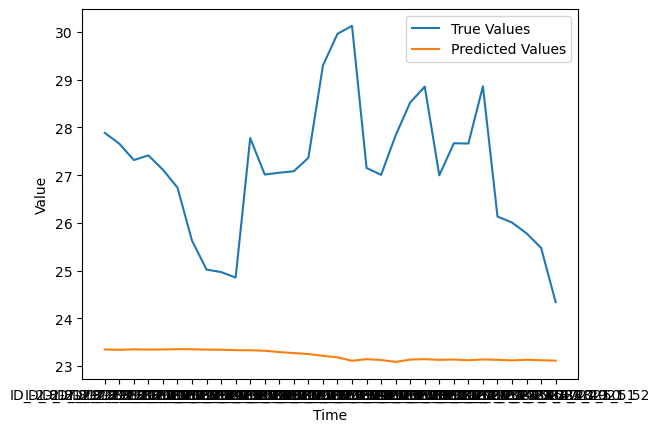

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -2.846_28.454
Epoch 1/50
3/3 [==============================] - 3s 405ms/step - loss: 1.1806 - mse: 1.1806 - accuracy: 0.0000e+00 - val_loss: 0.1727 - val_mse: 0.1727 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 44ms/step - loss: 0.5591 - mse: 0.5591 - accuracy: 0.0000e+00 - val_loss: 0.0147 - val_mse: 0.0147 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 51ms/step - loss: 0.4081 - mse: 0.4081 - accuracy: 0.0000e+00 - val_loss: 0.1374 - val_mse: 0.1374 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 88ms/step - loss: 0.5223 - mse: 0.5223 - accuracy: 0.0000e+00 - val_loss: 0.2239 - val_mse: 0.2239 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 68ms/step - loss: 0.5359 - mse: 0.5359 - accuracy: 0.0000e+00 - val_loss: 0.1534 - val_mse: 0.1534 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

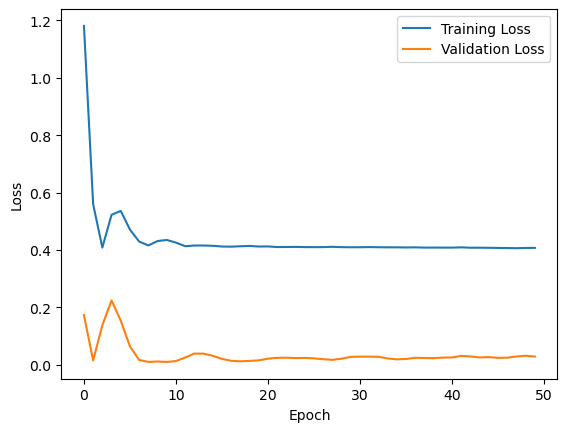

1/1 [==============================] - 0s 429ms/step


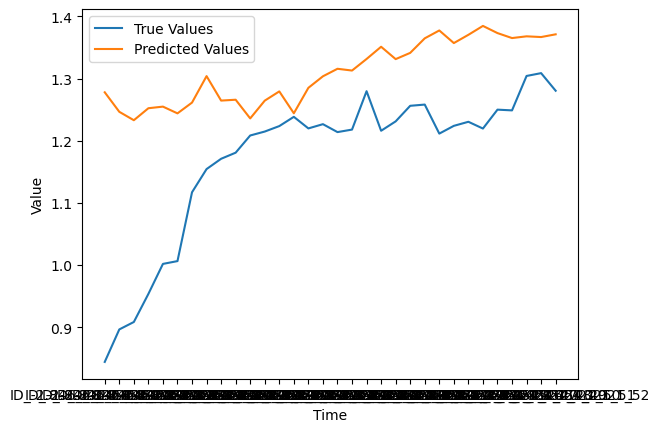

(49, 67)
2/2 [==============================] - 1s 8ms/step
LAT_LONG:  -2.812_30.488
Epoch 1/50
3/3 [==============================] - 3s 287ms/step - loss: 1796.5807 - mse: 1796.5807 - accuracy: 0.0000e+00 - val_loss: 2145.0989 - val_mse: 2145.0989 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 35ms/step - loss: 1767.2013 - mse: 1767.2013 - accuracy: 0.0000e+00 - val_loss: 2113.1628 - val_mse: 2113.1628 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 34ms/step - loss: 1738.9191 - mse: 1738.9191 - accuracy: 0.0000e+00 - val_loss: 2081.2095 - val_mse: 2081.2095 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 36ms/step - loss: 1709.4891 - mse: 1709.4891 - accuracy: 0.0000e+00 - val_loss: 2046.4158 - val_mse: 2046.4158 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 36ms/step - loss: 1678.1166 - mse: 1678.1166 - accuracy: 0.0000e+00 - val_loss: 2007.2039 - val_m

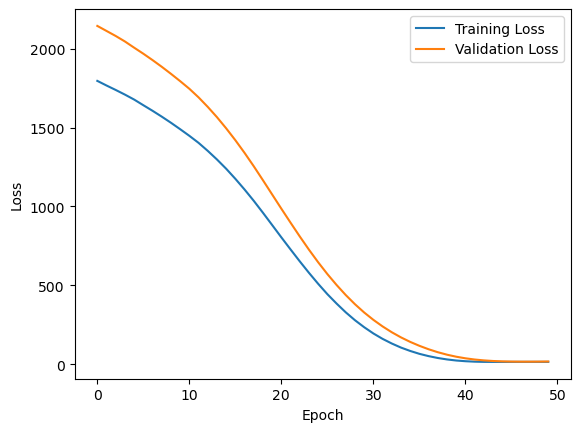

1/1 [==============================] - 1s 522ms/step


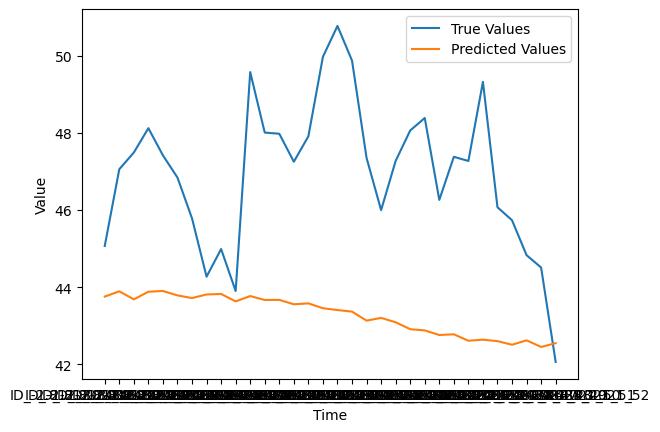

(49, 67)
2/2 [==============================] - 1s 6ms/step
LAT_LONG:  -0.905_29.995
Epoch 1/50
3/3 [==============================] - 4s 239ms/step - loss: 4132.9712 - mse: 4132.9712 - accuracy: 0.0000e+00 - val_loss: 4521.1768 - val_mse: 4521.1768 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 36ms/step - loss: 4086.3076 - mse: 4086.3074 - accuracy: 0.0000e+00 - val_loss: 4474.7041 - val_mse: 4474.7041 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 34ms/step - loss: 4042.0952 - mse: 4042.0952 - accuracy: 0.0000e+00 - val_loss: 4427.8779 - val_mse: 4427.8779 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 31ms/step - loss: 3998.6904 - mse: 3998.6904 - accuracy: 0.0000e+00 - val_loss: 4390.3369 - val_mse: 4390.3369 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 3965.1226 - mse: 3965.1226 - accuracy: 0.0000e+00 - val_loss: 4357.3145 - val_m

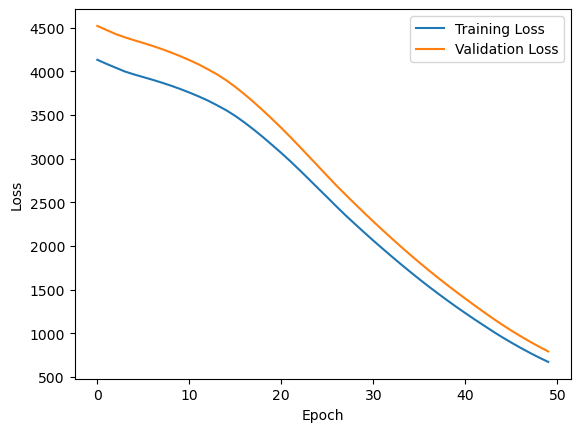

1/1 [==============================] - 0s 436ms/step


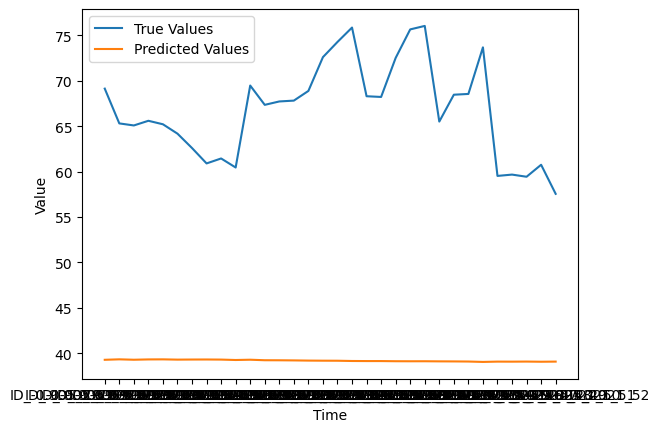

(49, 67)
2/2 [==============================] - 0s 8ms/step
LAT_LONG:  -0.963_30.237
Epoch 1/50
3/3 [==============================] - 4s 288ms/step - loss: 726.8896 - mse: 726.8896 - accuracy: 0.0000e+00 - val_loss: 837.8184 - val_mse: 837.8184 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 59ms/step - loss: 717.6377 - mse: 717.6377 - accuracy: 0.0000e+00 - val_loss: 827.8675 - val_mse: 827.8675 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 59ms/step - loss: 708.3394 - mse: 708.3394 - accuracy: 0.0000e+00 - val_loss: 817.9852 - val_mse: 817.9852 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 58ms/step - loss: 699.0683 - mse: 699.0683 - accuracy: 0.0000e+00 - val_loss: 807.4988 - val_mse: 807.4988 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 64ms/step - loss: 689.2821 - mse: 689.2821 - accuracy: 0.0000e+00 - val_loss: 795.6443 - val_mse: 795.6443 - val_

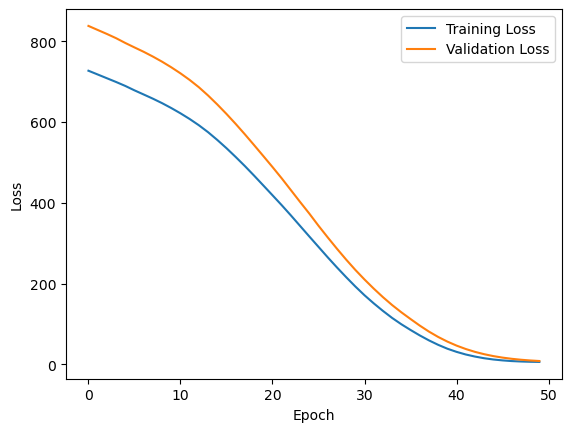

1/1 [==============================] - 0s 438ms/step


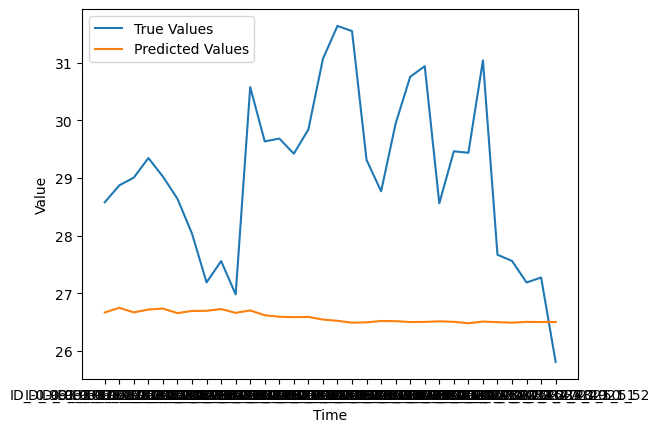

(49, 67)
2/2 [==============================] - 1s 13ms/step
LAT_LONG:  -1.092_31.108
Epoch 1/50
3/3 [==============================] - 4s 477ms/step - loss: 52.6177 - mse: 52.6177 - accuracy: 0.0000e+00 - val_loss: 30.9355 - val_mse: 30.9355 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 41ms/step - loss: 47.8209 - mse: 47.8209 - accuracy: 0.0000e+00 - val_loss: 26.9691 - val_mse: 26.9691 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 36ms/step - loss: 43.2643 - mse: 43.2643 - accuracy: 0.0000e+00 - val_loss: 22.8154 - val_mse: 22.8154 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 48ms/step - loss: 38.3925 - mse: 38.3925 - accuracy: 0.0000e+00 - val_loss: 18.8194 - val_mse: 18.8194 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 40ms/step - loss: 33.9690 - mse: 33.9690 - accuracy: 0.0000e+00 - val_loss: 15.1727 - val_mse: 15.1727 - val_accuracy: 0.0000e+0

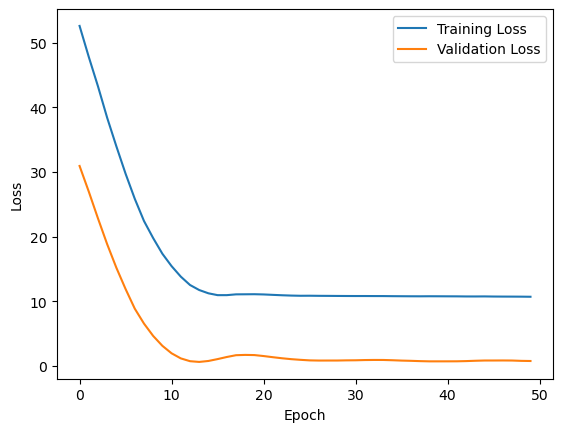

1/1 [==============================] - 0s 405ms/step


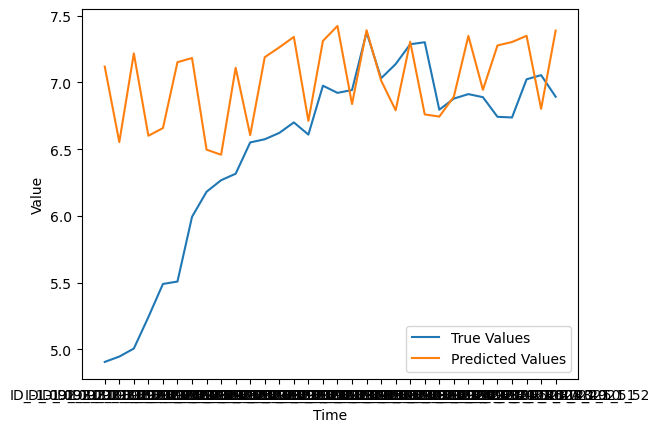

(49, 67)
2/2 [==============================] - 1s 5ms/step
LAT_LONG:  -1.173_30.727
Epoch 1/50
3/3 [==============================] - 3s 250ms/step - loss: 8423.7227 - mse: 8423.7227 - accuracy: 0.0000e+00 - val_loss: 8565.0625 - val_mse: 8565.0625 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 33ms/step - loss: 8381.8311 - mse: 8381.8311 - accuracy: 0.0000e+00 - val_loss: 8526.0020 - val_mse: 8526.0020 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 8343.8564 - mse: 8343.8564 - accuracy: 0.0000e+00 - val_loss: 8488.7480 - val_mse: 8488.7480 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 39ms/step - loss: 8307.4453 - mse: 8307.4453 - accuracy: 0.0000e+00 - val_loss: 8451.8945 - val_mse: 8451.8945 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 42ms/step - loss: 8271.1895 - mse: 8271.1895 - accuracy: 0.0000e+00 - val_loss: 8414.5352 - val_m

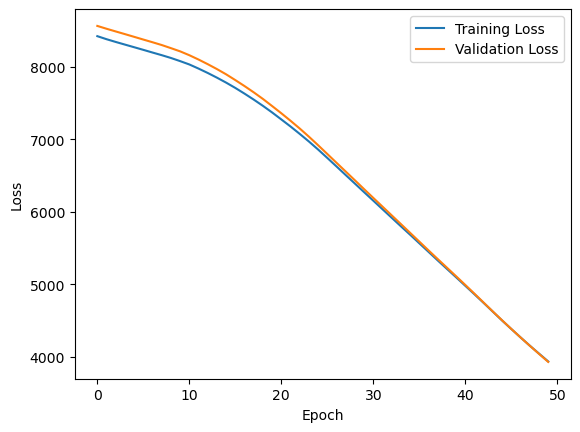

1/1 [==============================] - 0s 452ms/step


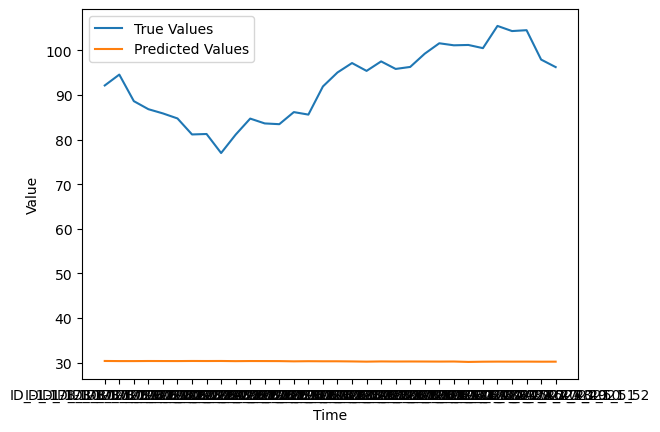

(49, 67)
2/2 [==============================] - 1s 10ms/step
LAT_LONG:  -1.852_29.948
Epoch 1/50
3/3 [==============================] - 3s 248ms/step - loss: 14340.6729 - mse: 14340.6738 - accuracy: 0.0000e+00 - val_loss: 13606.6465 - val_mse: 13606.6465 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 39ms/step - loss: 14275.5732 - mse: 14275.5732 - accuracy: 0.0000e+00 - val_loss: 13546.1777 - val_mse: 13546.1777 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 38ms/step - loss: 14219.3848 - mse: 14219.3848 - accuracy: 0.0000e+00 - val_loss: 13500.6328 - val_mse: 13500.6328 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 36ms/step - loss: 14173.9072 - mse: 14173.9072 - accuracy: 0.0000e+00 - val_loss: 13455.4072 - val_mse: 13455.4072 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 33ms/step - loss: 14126.2461 - mse: 14126.2461 - accuracy: 0.0000e+00 - val_loss

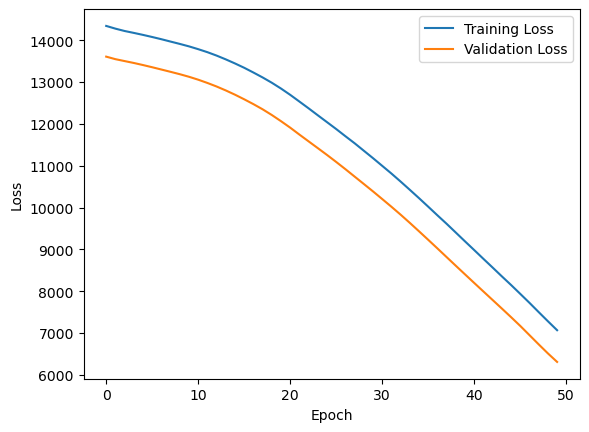

1/1 [==============================] - 0s 331ms/step


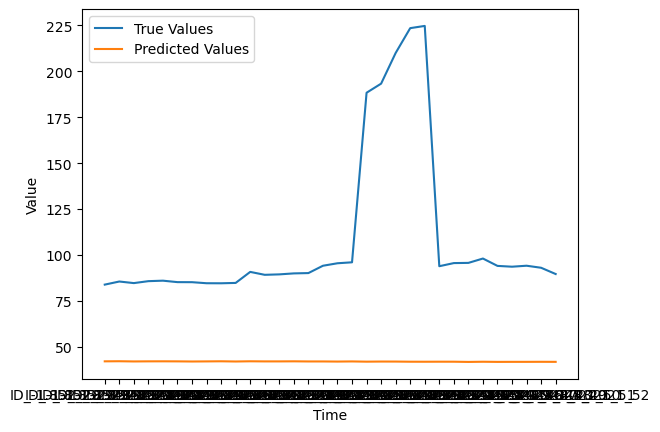

(49, 67)
2/2 [==============================] - 0s 7ms/step
LAT_LONG:  -1.583_28.517
Epoch 1/50
3/3 [==============================] - 4s 532ms/step - loss: 0.1311 - mse: 0.1311 - accuracy: 0.0000e+00 - val_loss: 0.0163 - val_mse: 0.0163 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 37ms/step - loss: 0.0736 - mse: 0.0736 - accuracy: 0.0000e+00 - val_loss: 0.0028 - val_mse: 0.0028 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 42ms/step - loss: 0.0576 - mse: 0.0576 - accuracy: 0.0000e+00 - val_loss: 0.0122 - val_mse: 0.0122 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 34ms/step - loss: 0.0612 - mse: 0.0612 - accuracy: 0.0000e+00 - val_loss: 0.0225 - val_mse: 0.0225 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 0.0666 - mse: 0.0666 - accuracy: 0.0000e+00 - val_loss: 0.0214 - val_mse: 0.0214 - val_accuracy: 0.0000e+00
Epoch 6/50
3/3 [===

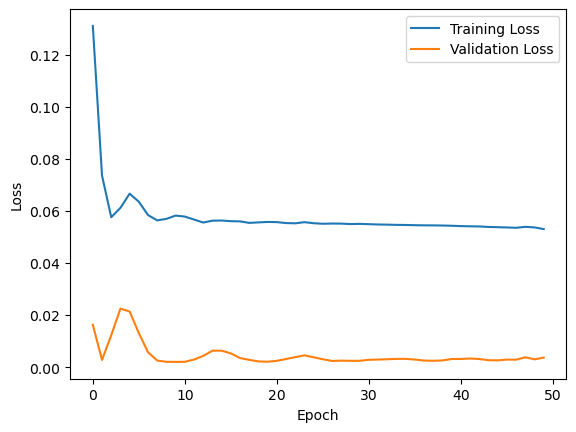

1/1 [==============================] - 0s 390ms/step


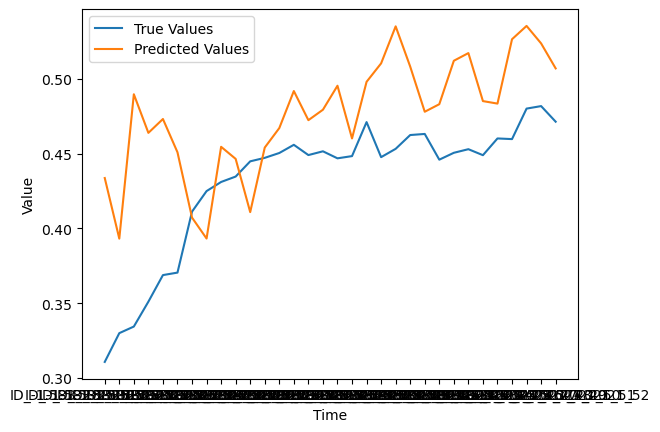

(49, 67)
2/2 [==============================] - 1s 5ms/step
LAT_LONG:  -2.162_30.138
Epoch 1/50
3/3 [==============================] - 2s 236ms/step - loss: 13446.5137 - mse: 13446.5137 - accuracy: 0.0000e+00 - val_loss: 13555.5244 - val_mse: 13555.5244 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 13395.4580 - mse: 13395.4580 - accuracy: 0.0000e+00 - val_loss: 13504.5332 - val_mse: 13504.5332 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 31ms/step - loss: 13344.6885 - mse: 13344.6885 - accuracy: 0.0000e+00 - val_loss: 13454.4590 - val_mse: 13454.4590 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 13296.0859 - mse: 13296.0859 - accuracy: 0.0000e+00 - val_loss: 13409.1104 - val_mse: 13409.1104 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 30ms/step - loss: 13250.3467 - mse: 13250.3467 - accuracy: 0.0000e+00 - val_loss:

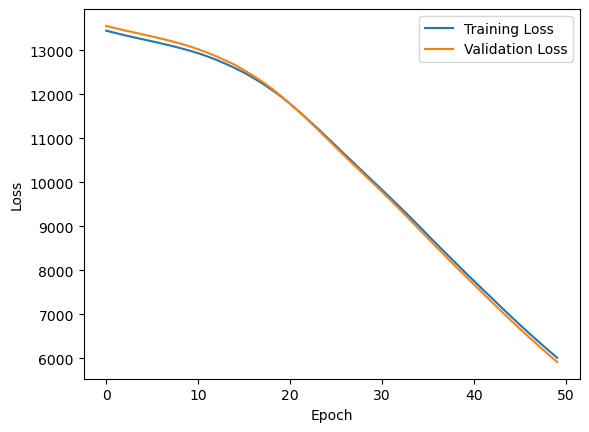

1/1 [==============================] - 0s 445ms/step


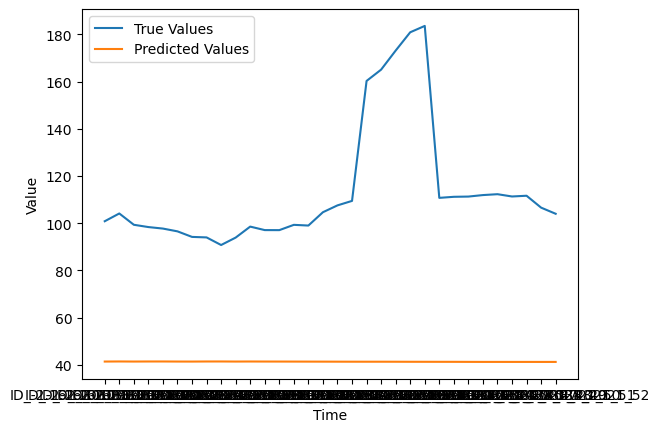

(49, 67)
2/2 [==============================] - 1s 10ms/step
LAT_LONG:  -1.534_30.366
Epoch 1/50
3/3 [==============================] - 4s 375ms/step - loss: 22584.3984 - mse: 22584.3984 - accuracy: 0.0000e+00 - val_loss: 23582.3242 - val_mse: 23582.3242 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 35ms/step - loss: 22496.9414 - mse: 22496.9414 - accuracy: 0.0000e+00 - val_loss: 23489.7949 - val_mse: 23489.7949 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 33ms/step - loss: 22406.8145 - mse: 22406.8145 - accuracy: 0.0000e+00 - val_loss: 23398.2422 - val_mse: 23398.2422 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 22316.8008 - mse: 22316.8008 - accuracy: 0.0000e+00 - val_loss: 23306.0469 - val_mse: 23306.0469 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 28ms/step - loss: 22228.4121 - mse: 22228.4121 - accuracy: 0.0000e+00 - val_loss

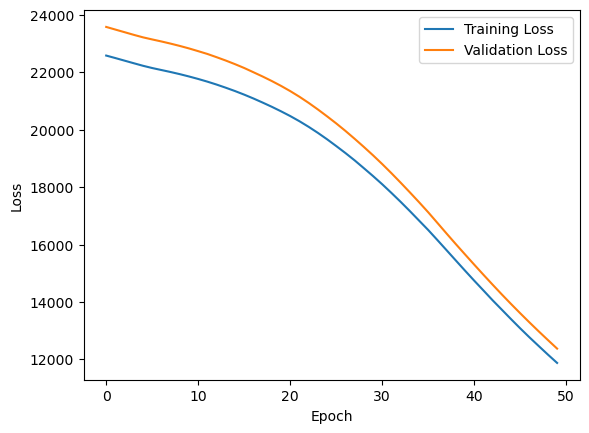

1/1 [==============================] - 0s 402ms/step


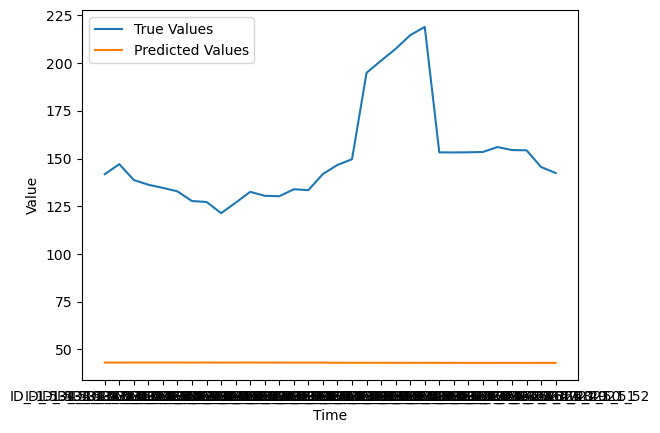

(49, 67)
2/2 [==============================] - 0s 5ms/step
LAT_LONG:  -2.879_30.621
Epoch 1/50
3/3 [==============================] - 3s 506ms/step - loss: 19804.9160 - mse: 19804.9160 - accuracy: 0.0000e+00 - val_loss: 20669.8945 - val_mse: 20669.8945 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 32ms/step - loss: 19738.9023 - mse: 19738.9023 - accuracy: 0.0000e+00 - val_loss: 20602.3711 - val_mse: 20602.3711 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 32ms/step - loss: 19673.1309 - mse: 19673.1309 - accuracy: 0.0000e+00 - val_loss: 20533.3711 - val_mse: 20533.3711 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 30ms/step - loss: 19607.0273 - mse: 19607.0273 - accuracy: 0.0000e+00 - val_loss: 20464.1738 - val_mse: 20464.1738 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 31ms/step - loss: 19544.2500 - mse: 19544.2500 - accuracy: 0.0000e+00 - val_loss:

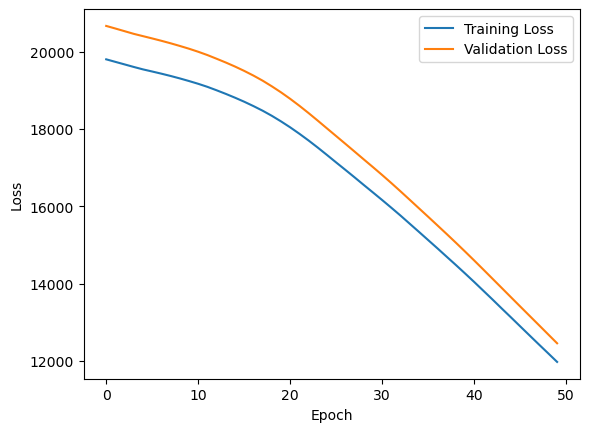

1/1 [==============================] - 0s 444ms/step


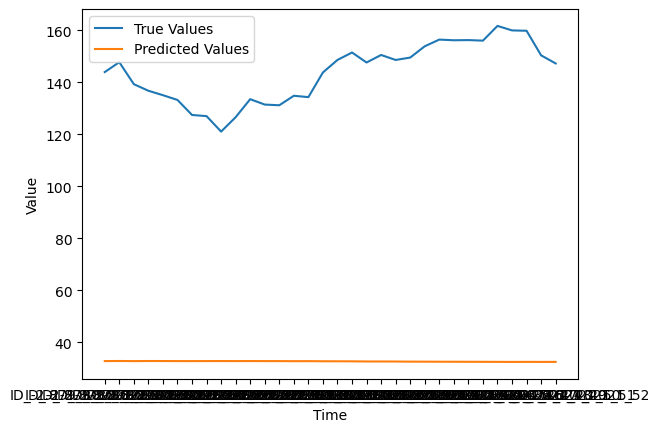

(49, 67)
2/2 [==============================] - 1s 10ms/step
LAT_LONG:  -2.985_30.415
Epoch 1/50
3/3 [==============================] - 3s 205ms/step - loss: 61560.2227 - mse: 61560.2227 - accuracy: 0.0000e+00 - val_loss: 64485.1016 - val_mse: 64485.1016 - val_accuracy: 0.0000e+00
Epoch 2/50
3/3 [==============================] - 0s 28ms/step - loss: 61459.1367 - mse: 61459.1367 - accuracy: 0.0000e+00 - val_loss: 64383.5547 - val_mse: 64383.5547 - val_accuracy: 0.0000e+00
Epoch 3/50
3/3 [==============================] - 0s 27ms/step - loss: 61366.6914 - mse: 61366.6914 - accuracy: 0.0000e+00 - val_loss: 64298.1953 - val_mse: 64298.1953 - val_accuracy: 0.0000e+00
Epoch 4/50
3/3 [==============================] - 0s 29ms/step - loss: 61285.5391 - mse: 61285.5391 - accuracy: 0.0000e+00 - val_loss: 64213.7930 - val_mse: 64213.7930 - val_accuracy: 0.0000e+00
Epoch 5/50
3/3 [==============================] - 0s 34ms/step - loss: 61202.4961 - mse: 61202.4961 - accuracy: 0.0000e+00 - val_loss

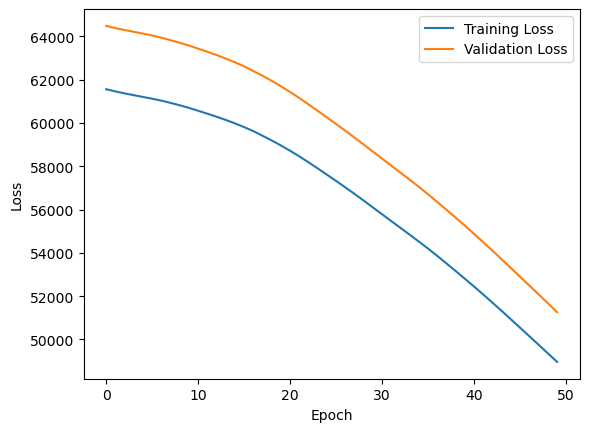

1/1 [==============================] - 0s 372ms/step


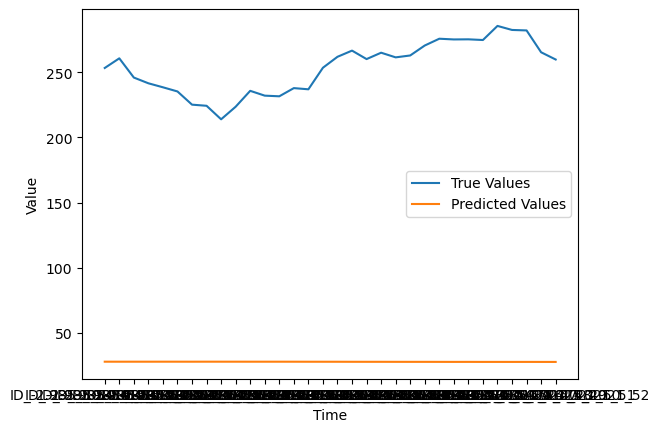

(49, 67)
2/2 [==============================] - 0s 6ms/step
LAT_LONG:  -1.274_29.926
Epoch 1/50


In [32]:
%%time
LSTMModel(train, test)


In [ ]:
Y1_df.shape

(147, 1)

In [ ]:
Y1_df

,emission
ID_LAT_LON_YEAR_WEEK,
ID_-2.443_28.657_2022_00,0.894836
ID_-2.443_28.657_2022_01,0.812076
ID_-2.443_28.657_2022_02,0.813861
ID_-2.443_28.657_2022_03,0.904424
ID_-2.443_28.657_2022_04,0.911904
...,...
ID_-2.342_29.458_2022_44,0.908526
ID_-2.342_29.458_2022_45,0.939466
ID_-2.342_29.458_2022_46,0.877868


In [ ]:
Y1_df.index[0], Y1_df.index[49]

('ID_-2.443_28.657_2022_00', 'ID_-1.004_31.396_2022_00')

In [32]:
z= list()
for i in Y1_df.index:
    z.append(i[:16])

In [33]:
set(z)

{'ID_-0.801_29.499',
 'ID_-0.986_30.214',
 'ID_-1.482_30.618',
 'ID_-1.911_29.389',
 'ID_-2.335_29.665',
 'ID_-2.740_29.660',
 'ID_-2.751_29.249',
 'ID_-2.859_29.041',
 'ID_-3.023_30.177'}